# Projet 7: Implémentez un modèle de scoring (analyse exploratoire)

La société "Prêt à dépenser" propose des **crédits à la consommation** pour des personnes ayant **peu ou pas du tout d'historique de prêt**.

Elle souhaite mettre en œuvre un outil de “**scoring crédit**” pour:
- calculer la **probabilité qu’un client rembourse son crédit**
- **classifier** la demande en **crédit accordé ou refusé**
- en faisant preuve de **transparence** vis à vis des décisions d'octroi de crédit

L'algorithme de classification va s’appuyer sur des sources de données variées:
- données comportementales
- données provenant d'autres institutions financières
- etc

Il nous est demandé de développer un **dashboard interactif** pour que les chargés de relation client puissent à la fois:
- expliquer de façon la plus transparente possible les décisions d’octroi de crédit
- mais également permettre à leurs clients de disposer de leurs informations personnelles et de les explorer facilement


**Mission:**
- Construire un modèle de scoring qui donnera une prédiction sur la probabilité de faillite d'un client de façon automatique
- Construire un dashboard interactif à destination des gestionnaires de la relation client permettant d'interpréter les prédictions faites par le modèle, et d’améliorer la connaissance client des chargés de relation client
- Mettre en production le modèle de scoring de prédiction à l’aide d’une API, ainsi que le dashboard interactif qui appelle l’API pour les prédictions

Afin de faciliter l'analyse exploratoire, la préparation des données et le feature engineering nécessaires à l'élaboration du modèle de scoring, nous nous baserons sur les kernels suivants que nous détaillerons et adapterons si nécessaire:

https://www.kaggle.com/code/jsaguiar/lightgbm-with-simple-features/script
https://www.kaggle.com/code/willkoehrsen/start-here-a-gentle-introduction#Exploratory-Data-Analysis

## Table des matières: <a class="anchor" id="0"></a>

1. [Import des librairies et configurations générales](#library)
2. [Chargement et connaissance des données](#load)
    1. [Les données - vue d'ensemble](#data_ens)
    2. [application_train.csv](#app_train)
    3. [bureau.csv et bureau_balance.csv](#bureau)
    4. [previous_application.csv](#previous)
    5. [POS_CASH_balance.csv](#cash)
    6. [installments_payments.csv](#install)
    7. [credit_card_balance.csv](#credit_card)
3. [Fonction de preprocessing et assemblage des datasets](#preprocess)
    1. [Derniers retraitements](#retraitements)
    2. [Fonction avec retraitement NaN](#main_nan)

## Import des librairies et configurations générales <a class="anchor" id="library"></a>

In [1]:
# builtin
import os
import time
from os import listdir

# data
import numpy as np
import pandas as pd

# Fonctions personnelles
import fct_eda
import fct_preprocessing

# Update Fonctions personnelles
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

# viz
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns

# stats
from scipy.stats import chi2_contingency #Chi2
import pingouin as pg # Test Chi2 d'independance
from scipy.stats import kruskal # Test non paramétrique à la place de l'ANOVA

# models
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import OneHotEncoder, LabelEncoder

import gc
from contextlib import contextmanager

import warnings
warnings.filterwarnings('ignore')
# warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
# Configuration Pandas
pd_option_dictionary = {
    'display.max_rows': 500,
    'display.max_column': 200,
    'display.width': 300,
    'display.precision': 4,
    'display.max_colwidth': None,
    'display.float_format' : '{:.2f}'.format,
}

for pat, value in pd_option_dictionary.items():
    pd.set_option(pat, value)

## Chargement et connaissance des données <a class="anchor" id="load"></a>

Nous allons dans un premier temps charger les différents fichiers mis à notre disposition afin de comprendre nos données, les nettoyer si nécessaire, mener une analyse exploratoire puis fusionner les différentes tables entre-elles afin d'avoir une table unique qui nous permettra de créer le dashboard.

### Les données - vue d'ensemble <a class="anchor" id="data_ens"></a>

In [3]:
# Liste des fichiers à disposition
list(os.listdir('data'))

['application_test.csv',
 'application_train.csv',
 'bureau.csv',
 'bureau_balance.csv',
 'credit_card_balance.csv',
 'HomeCredit_columns_description.csv',
 'installments_payments.csv',
 'Matrice.PNG',
 'matrice_confusion.xlsx',
 'POS_CASH_balance.csv',
 'previous_application.csv',
 'sample_submission.csv',
 '~$matrice_confusion.xlsx']

**Relations entre les tables**
![Archi](img/archi.png)

### application_train.csv <a class="anchor" id="app_train"></a>

*Informations sur le prêt et le demandeur au moment de la demande (Prêt à dépenser)*

#### Principales statistiques

Table principale divisée en deux fichiers:

- un pour le **Train** (avec TARGET)
- un pour le **Test** (sans TARGET)

Données statiques pour toutes les applications. **Une ligne représente un prêt dans notre échantillon de données**.

Seul le train set nous intéresse car il possède la target. Le test set est utilisé uniquement pour la soumission à Kaggle et ne sera pas utilisé ici.

In [4]:
# Chargement du dataset
app_train = pd.read_csv('data/application_train.csv',
                        sep=',',
                        encoding='utf-8')

In [5]:
# Description des colonnes
col_desc = pd.read_csv('data/HomeCredit_columns_description.csv',
                       sep=',',
                       encoding='unicode_escape')

col_desc[col_desc['Table'] == 'application_{train|test}.csv']

,Unnamed: 0,Table,Row,Description,Special
0,1,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_{train|test}.csv,TARGET,"Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)",NaN
2,5,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,7,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN
5,8,application_{train|test}.csv,FLAG_OWN_REALTY,Flag if client owns a house or flat,NaN
6,9,application_{train|test}.csv,CNT_CHILDREN,Number of children the client has,NaN
7,10,application_{train|test}.csv,AMT_INCOME_TOTAL,Income of the client,NaN
8,11,application_{train|test}.csv,AMT_CREDIT,Credit amount of the loan,NaN
9,12,application_{train|test}.csv,AMT_ANNUITY,Loan annuity,NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.00,406597.50,24700.50,351000.00,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.02,-9461,-637,-3648.00,-2120,NaN,1,1,0,1,1,0,Laborers,1.00,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.08,0.26,0.14,0.02,0.04,0.97,0.62,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,0.03,0.04,0.97,0.63,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,0.03,0.04,0.97,0.62,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,reg oper account,block of flats,0.01,"Stone, brick",No,2.00,2.00,2.00,2.00,-1134.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,1.00
1,100003,0,Cash loans,F,N,N,0,270000.00,1293502.50,35698.50,1129500.00,Family,State servant,Higher education,Married,House / apartment,0.00,-16765,-1188,-1186.00,-291,NaN,1,1,0,1,1,0,Core staff,2.00,1,1,MONDAY,11,0,0,0,0,0,0,School,0.31,0.62,NaN,0.10,0.05,0.99,0.80,0.06,0.08,0.03,0.29,0.33,0.01,0.08,0.05,0.00,0.01,0.09,0.05,0.99,0.80,0.05,0.08,0.03,0.29,0.33,0.01,0.08,0.06,0.00,0.00,0.10,0.05,0.99,0.80,0.06,0.08,0.03,0.29,0.33,0.01,0.08,0.06,0.00,0.01,reg oper account,block of flats,0.07,Block,No,1.00,0.00,1.00,0.00,-828.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,0.00
2,100004,0,Revolving loans,M,Y,Y,0,67500.00,135000.00,6750.00,135000.00,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.01,-19046,-225,-4260.00,-2531,26.00,1,1,1,1,1,0,Laborers,1.00,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.56,0.73,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,-815.00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.0

-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
307506,456251,0,Cash loans,M,N,N,0,157500.00,254700.00,27558.00,225000.00,Unaccompanied,Working,Secondary / secondary special,Separated,With parents,0.03,-9327,-236,-8456.00,-1982,NaN,1,1,0,1,0,0,Sales staff,1.00,1,1,THURSDAY,15,0,0,0,0,0,0,Services,0.15,0.68,NaN,0.20,0.09,0.99,0.83,0.02,0.22,0.10,0.60,0.27,0.06,0.15,0.20,0.08,0.11,0.10,0.02,0.98,0.71,0.02,0.08,0.03,0.46,0.04,0.01,0.09,0.09,0.00,0.01,0.20,0.09,0.99,0.83,0.02,0.22,0.10,0.60,0.27,0.06,0.15,0.20,0.08,0.11,reg oper account,block of flats,0.29,"Stone, brick",No,0.00,0.00,0.00,0.00,-273.00,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307507,456252,0,Cash loans,F,N,Y,0,72000.00,269550.00,12001.50,225000.00,Unaccompanied,Pensioner,Secondary / secondary special,Widow,House / apartment,0.03,-20775,365243,-4388.00,-4090,NaN,1,0,0,1,1,0,NaN,1.00,2,2,MONDAY,8,0,0,0,0,0,0,XNA,NaN,0.12,NaN,0.02,0.04,0.97,0.63,0.00,0.00,0.10,0.08,0.12,0.06,0.02,0.03,0.00,0.00,0.03,0.05,0.97,0.64,0.00,0.00,0.10,0.08,0.12,0.06,0.02,0.03,0.00,0.00,0.03,0.04,0.97,0.63,0.00,0.00,0.10,0.08,0.12,0.06,0.02,0.03,0.00,0.00,reg oper account,block of flats,0.02,"Stone, brick",No,0.00,0.00,0.00,0.00,0.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307508,456253,0,Cash loans,F,N,Y,0,153000.00,677664.00,29979.00,585000.00,Unaccompanied,Working,Higher education,Separated,House / apartment,0.01,-14966,-7921,-6737.00,-5150,NaN,1,1,0,1,0,1,Managers,1.00,3,3,THURSDAY,9,0,0,0,0,1,1,School,0.74,0.54,0.22,0.10,0.09,0.98,0.75,0.01,0.00,0.21,0.17,0.21,NaN,0.08,0.93,0.00,0.00,0.10,0.09,0.98,0.76,0.01,0.00,0.21,0.17,0.21,NaN,0.09,0.97,0.00,0.00,0.10,0.09,0.98,0.75,0.01,0.00,0.21,0.17,0.21,NaN,0.09,0.94,0.00,0.00,reg oper account,block of flats,0.80,Panel,No,6.00,0.00,6.00,0.00,-1909.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 307511
Nombre de colonnes: 122
Nombre total de NaN du dataset: 9152465
% total de NaN du dataset: 24.4%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


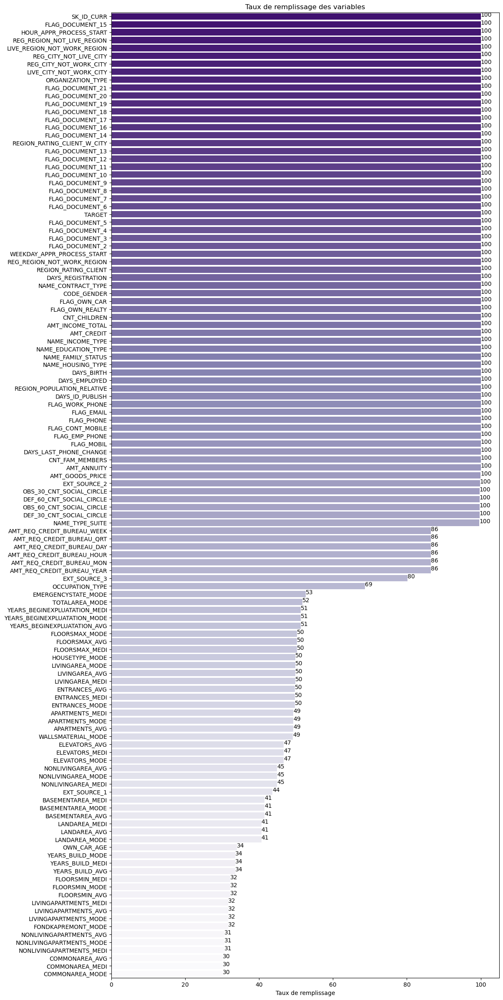

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_CURR,int64,100002,307511,307511,100.00,307511,100.00,0,0.00
1,TARGET,int64,1,307511,2,0.00,307511,100.00,0,0.00
2,NAME_CONTRACT_TYPE,object,Cash loans,307511,2,0.00,307511,100.00,0,0.00
3,CODE_GENDER,object,M,307511,3,0.00,307511,100.00,0,0.00
4,FLAG_OWN_CAR,object,N,307511,2,0.00,307511,100.00,0,0.00
5,FLAG_OWN_REALTY,object,Y,307511,2,0.00,307511,100.00,0,0.00
6,CNT_CHILDREN,int64,0,307511,15,0.00,307511,100.00,0,0.00
7,AMT_INCOME_TOTAL,float64,202500.00,307511,2548,0.83,307511,100.00,0,0.00
8,AMT_CREDIT,float64,406597.50,307511,5603,1.82,307511,100.00,0,0.00
9,AMT_ANNUITY,float64,24700.50,307511,13672,4.45,307499,100.00,12,0.00


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [6]:
fig = plt.figure(figsize=(12, 30))
app_train_desc = fct_eda.describe_stat(app_train, fig = fig)

#### Traitement des données manquantes

Nous allons imputer les données manquantes de différentes manières:
- **suppression** des variables avec plus de **30% de données manquantes**
- pour les **variables corrélées entre elles** que nous repérerons à l'aide de la matrice de corrélation, nous utiliserons l'algorithme **iterative imputer**
- lorsque le pourcentage de valeurs manquantes est relativement **faible** (<=20%), nous imputerons par la **médiane** pour les variables quantitatives et par le **mode** pour les variables qualitatives

Pour nous assurer que nos méthodes sont cohérentes, nous analyserons les **distributions** avant et après imputations.

<div class="alert alert-block alert-warning">
    <p>Suppression des variables avec 30% ou plus de NaN</p>
</div>

In [7]:
# Suppression des variables avec 30% ou plus de NaN
app_train_nan = fct_eda.tx_rempl_min(app_train, 70)
fct_eda.nan_a_retraiter(app_train_nan)

,Tx_rempl,nb_NaN,dtypes
DAYS_LAST_PHONE_CHANGE,100.00,1,float64
CNT_FAM_MEMBERS,100.00,2,float64
AMT_ANNUITY,100.00,12,float64
AMT_GOODS_PRICE,99.91,278,float64
EXT_SOURCE_2,99.79,660,float64
DEF_60_CNT_SOCIAL_CIRCLE,99.67,1021,float64
OBS_30_CNT_SOCIAL_CIRCLE,99.67,1021,float64
DEF_30_CNT_SOCIAL_CIRCLE,99.67,1021,float64
OBS_60_CNT_SOCIAL_CIRCLE,99.67,1021,float64
NAME_TYPE_SUITE,99.58,1292,object


<div class="alert alert-block alert-warning">
    <p>iterative imputer pour les variables corrélées entre-elles</p>
</div>

In [8]:
# Variables quantitatives
col_quanti_cont = app_train_nan.select_dtypes(exclude=['object']).columns.tolist()

liste_var_a_tester = fct_eda.pairs_corr(app_train_nan, col_quanti_cont, seuil = 0.5)

,correlation
pairs,
"(OBS_60_CNT_SOCIAL_CIRCLE, OBS_30_CNT_SOCIAL_CIRCLE)",1.00
"(AMT_GOODS_PRICE, AMT_CREDIT)",0.99
"(REGION_RATING_CLIENT, REGION_RATING_CLIENT_W_CITY)",0.95
"(CNT_CHILDREN, CNT_FAM_MEMBERS)",0.88
"(LIVE_REGION_NOT_WORK_REGION, REG_REGION_NOT_WORK_REGION)",0.86
"(DEF_30_CNT_SOCIAL_CIRCLE, DEF_60_CNT_SOCIAL_CIRCLE)",0.86
"(LIVE_CITY_NOT_WORK_CITY, REG_CITY_NOT_WORK_CITY)",0.83
"(AMT_ANNUITY, AMT_GOODS_PRICE)",0.78
"(AMT_CREDIT, AMT_ANNUITY)",0.77


<div class="alert alert-block alert-success">
    <p>A noter: ces pairs de variables étant fortement corrélées, il faudra penser à ne pas les prendre toutes dans notre modèle.</p>
</div>

In [9]:
app_train_imp = app_train_nan.copy()

In [10]:
# Affectation des résultats de l'iterative imputer dans les variables concernées
app_train_imp['OBS_30_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']])[:,0]
app_train_imp['OBS_60_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']])[:,1]

app_train_imp['AMT_GOODS_PRICE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['AMT_GOODS_PRICE', 'AMT_CREDIT']])[:,0]

app_train_imp['CNT_FAM_MEMBERS'] = fct_eda.iterative_imputer_function(
    app_train_imp[['CNT_FAM_MEMBERS', 'CNT_CHILDREN']])[:,0]

app_train_imp['DEF_60_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['DEF_60_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE']])[:,0]
app_train_imp['DEF_30_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['DEF_60_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE']])[:,1]

app_train_imp['AMT_GOODS_PRICE'] = fct_eda.iterative_imputer_function(
    app_train_imp[['AMT_GOODS_PRICE', 'AMT_ANNUITY']])[:,0]
app_train_imp['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
    app_train_imp[['AMT_GOODS_PRICE', 'AMT_ANNUITY']])[:,1]

app_train_imp['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
    app_train_imp[['AMT_CREDIT', 'AMT_ANNUITY']])[:,1]

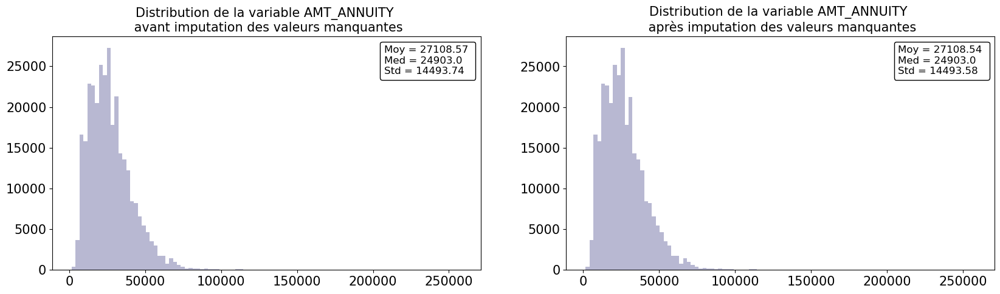

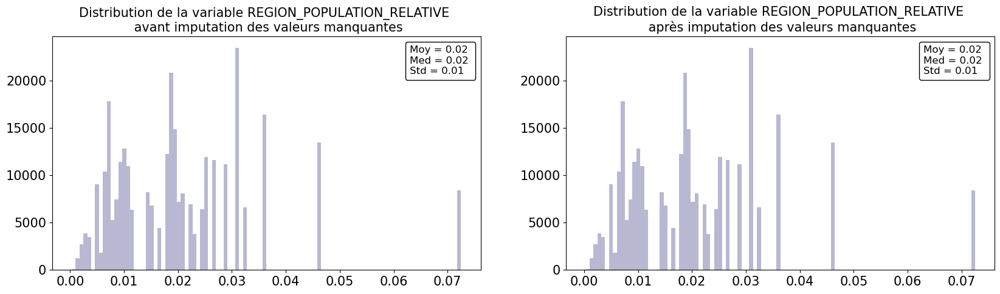

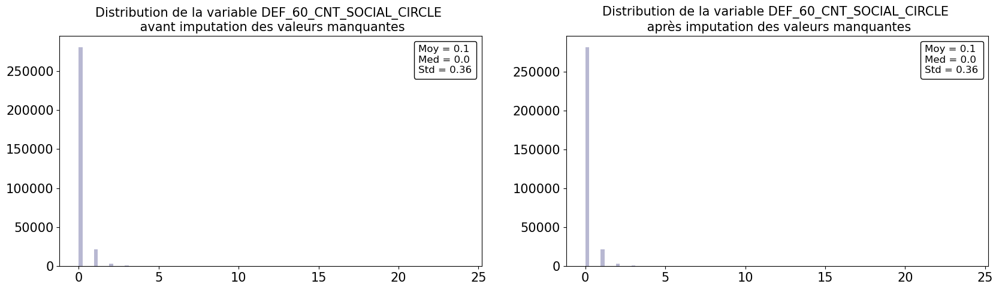

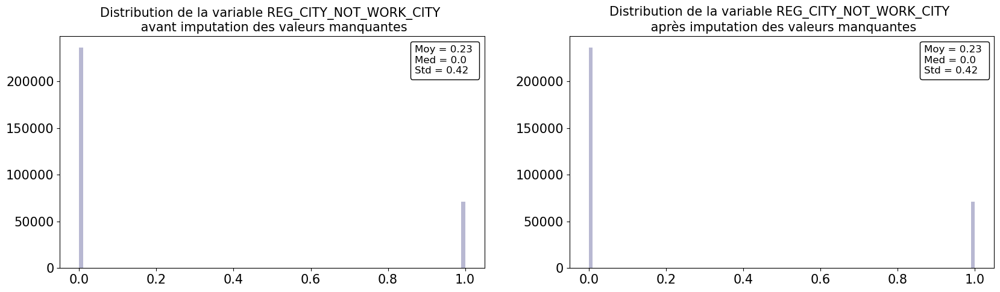

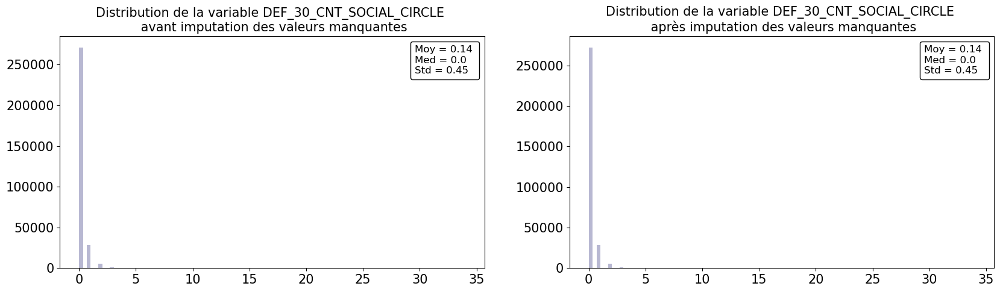

...

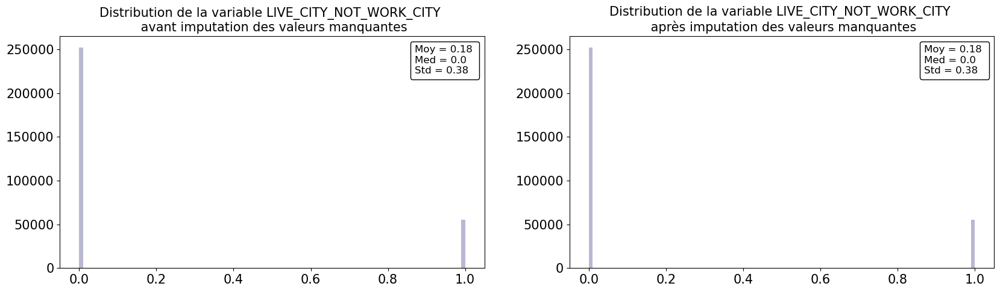

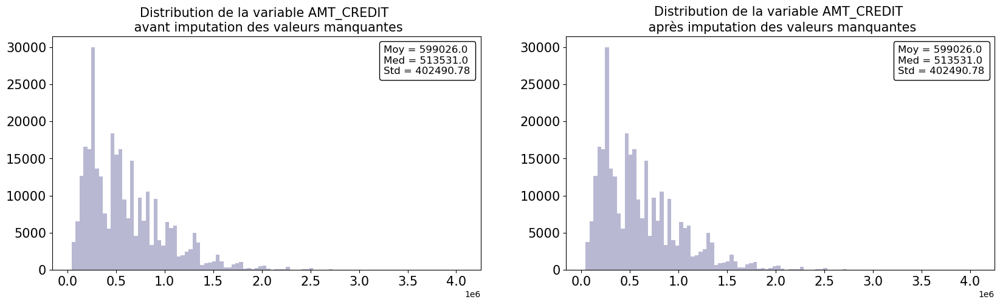

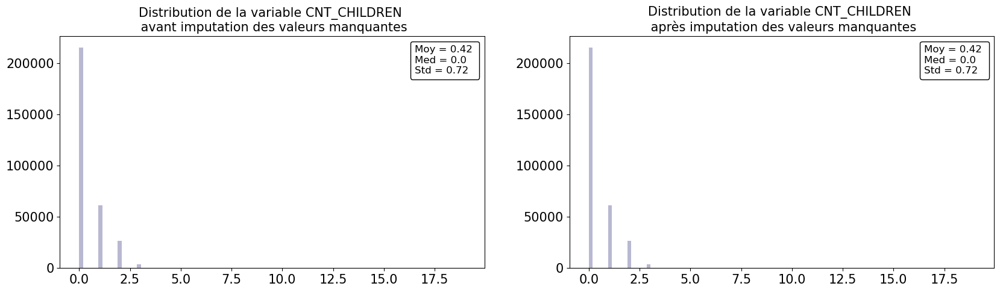

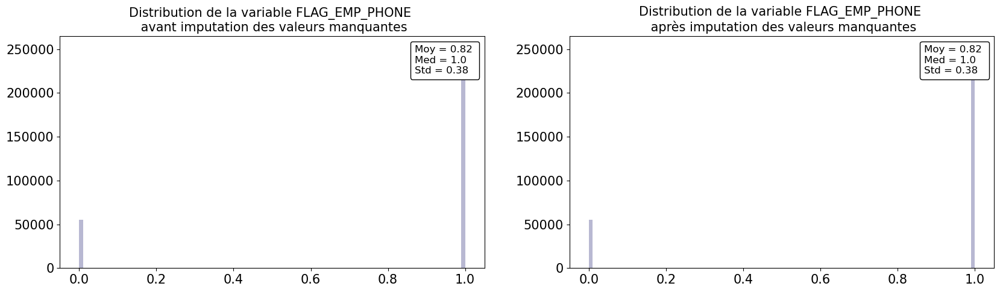

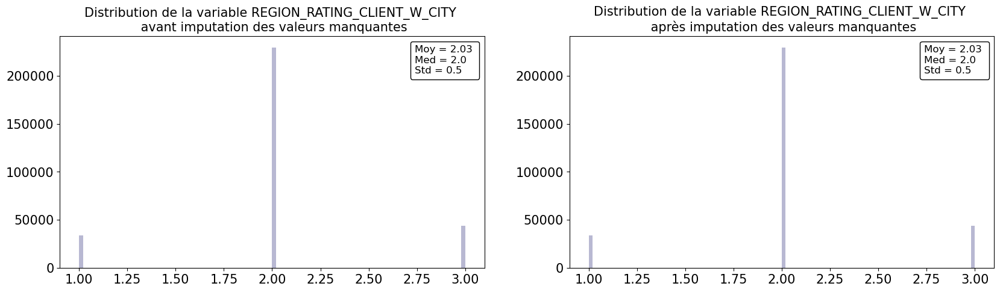

In [11]:
list_var_imp = liste_var_a_tester

for var in list_var_imp:
    fct_eda.distrib_imput_nan_quanti(app_train_nan, var, app_train_imp)

Les distributions de nos variables avant et après imputation des valeurs manquantes par iterative imputer sont similaires, nous validons cette méthode.

<div class="alert alert-block alert-warning">
    <p>Médiane et mode pour variables avec taux de remplissage > 80% (hors variable TARGET)</p>
</div>

In [12]:
app_train_med = app_train_imp.copy()

In [13]:
df_nan = fct_eda.nan_a_retraiter(app_train_med)

In [14]:
# Colonnes impactées
col_med = df_nan[(df_nan['Tx_rempl']>80) & 
                 (df_nan['dtypes'] == 'float64') &
                 (~ df_nan.index.str.contains('TARGET'))].index.tolist()

# Imputation des variables par la médiane
for col in col_med:
    app_train_med[col] = app_train_med[col].fillna(app_train_med[col].median())

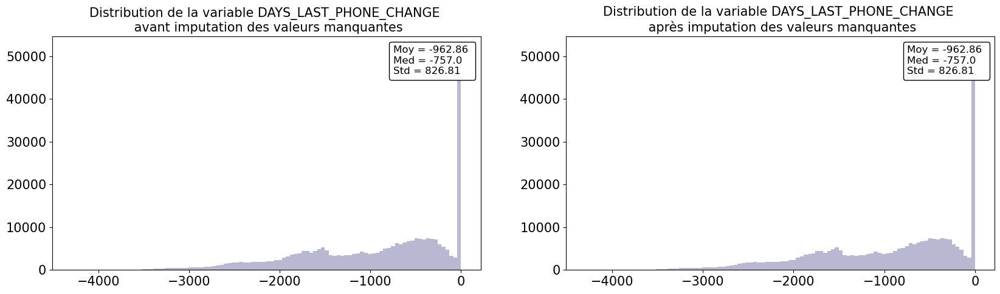

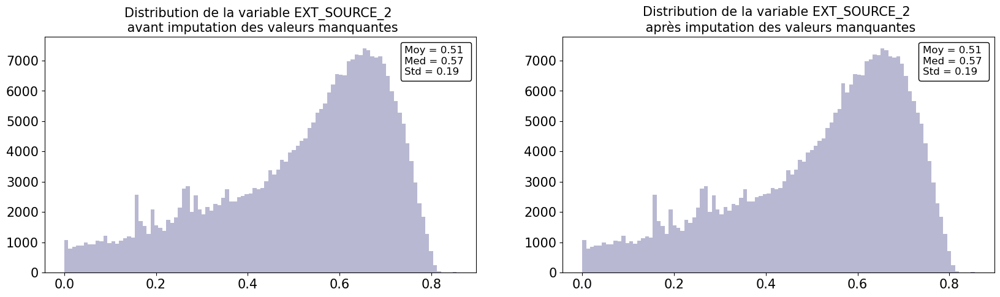

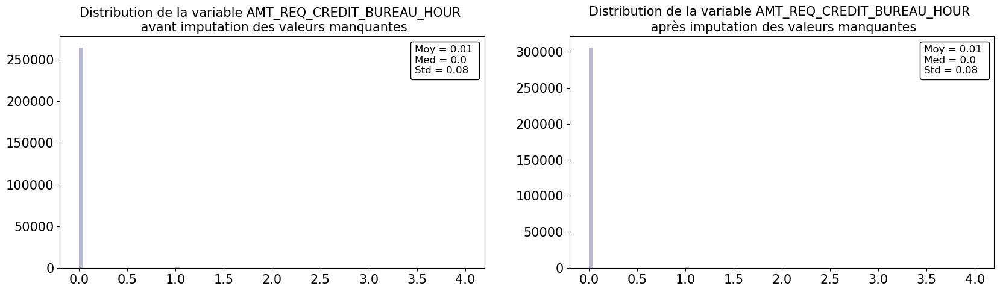

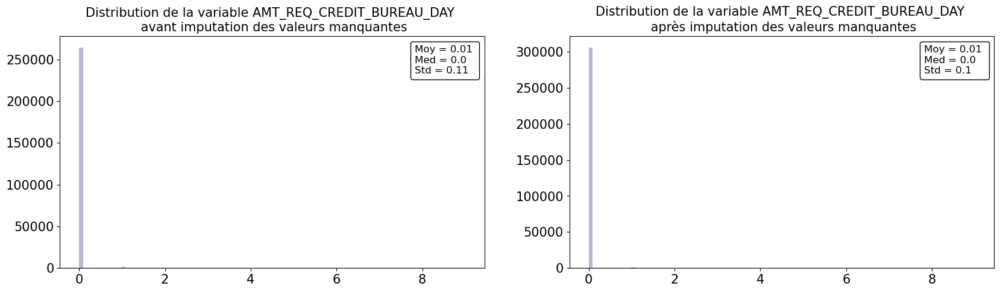

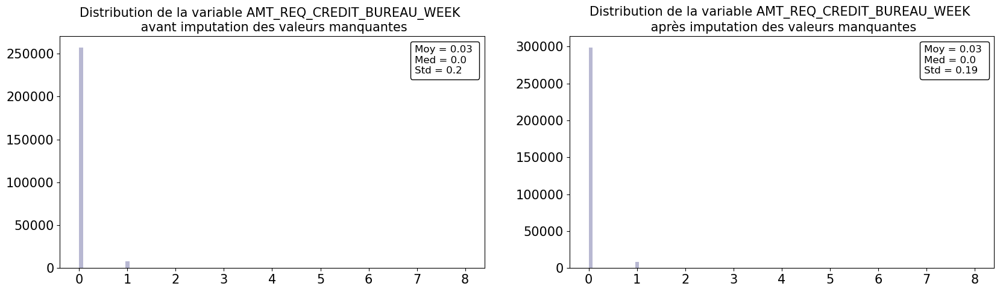

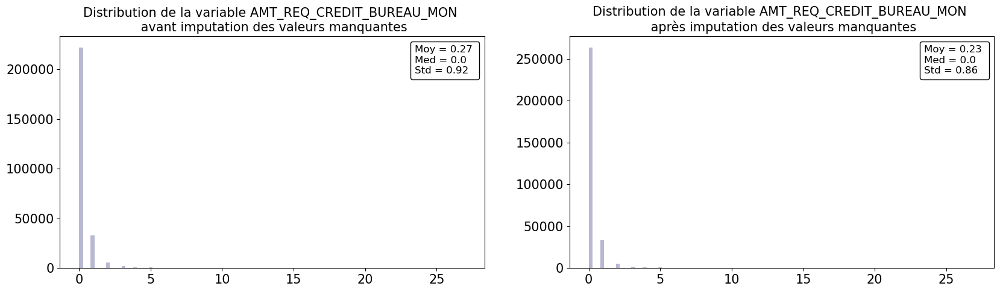

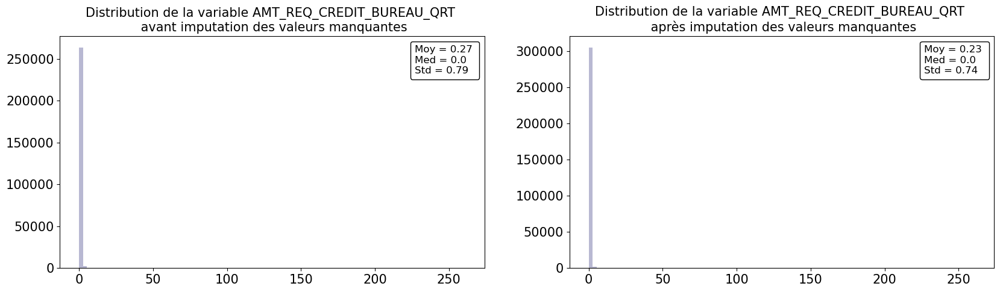

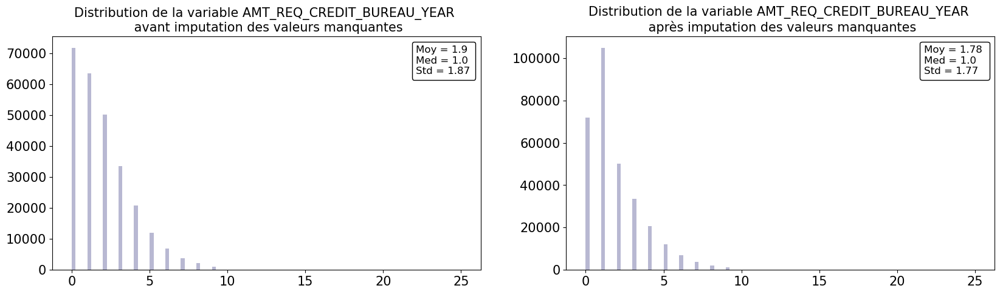

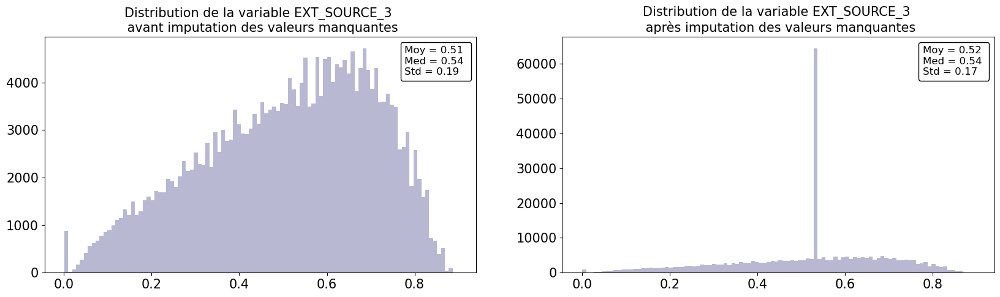

In [15]:
for var in col_med:
    fct_eda.distrib_imput_nan_quanti(app_train_imp, var, app_train_med)

La distribution des variables "EXT_SOURCE_3" et "AMT_REQ_CREDIT_BUREAU_YEAR" après imputation des valeurs manquantes a changé, nous ne conservons pas ces deux variables pour la suite de notre analyse.

In [16]:
del app_train_med['AMT_REQ_CREDIT_BUREAU_YEAR']
del app_train_med['EXT_SOURCE_3']

In [17]:
# Imputation de la variable NAME_TYPE_SUITE par le mode
app_train_med['NAME_TYPE_SUITE'] = app_train_med['NAME_TYPE_SUITE'].fillna(app_train_med['NAME_TYPE_SUITE'].mode()[0])

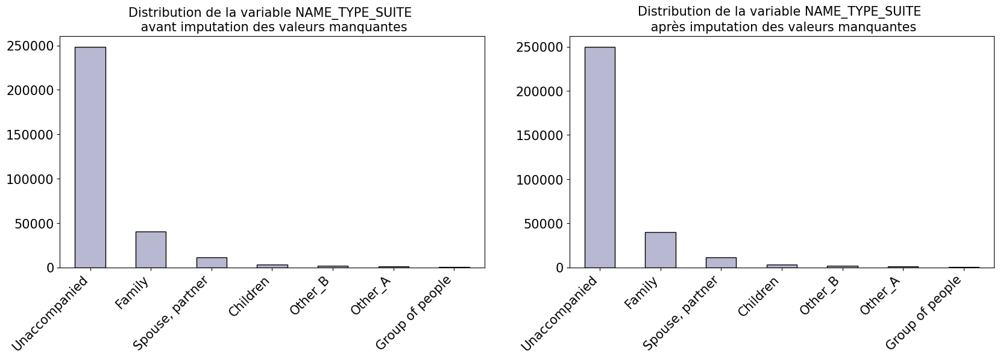

In [18]:
fct_eda.distrib_imput_nan_quali(app_train_imp, 'NAME_TYPE_SUITE', app_train_med)

In [19]:
del app_train
del app_train_imp
del app_train_nan

#### Analyses univariées

In [20]:
app_train_desc = app_train_med.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [21]:
liste_col_quanti = app_train_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique()
liste_col_quanti = liste_col_quanti[liste_col_quanti>2].index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [22]:
len(liste_col_quanti)

25

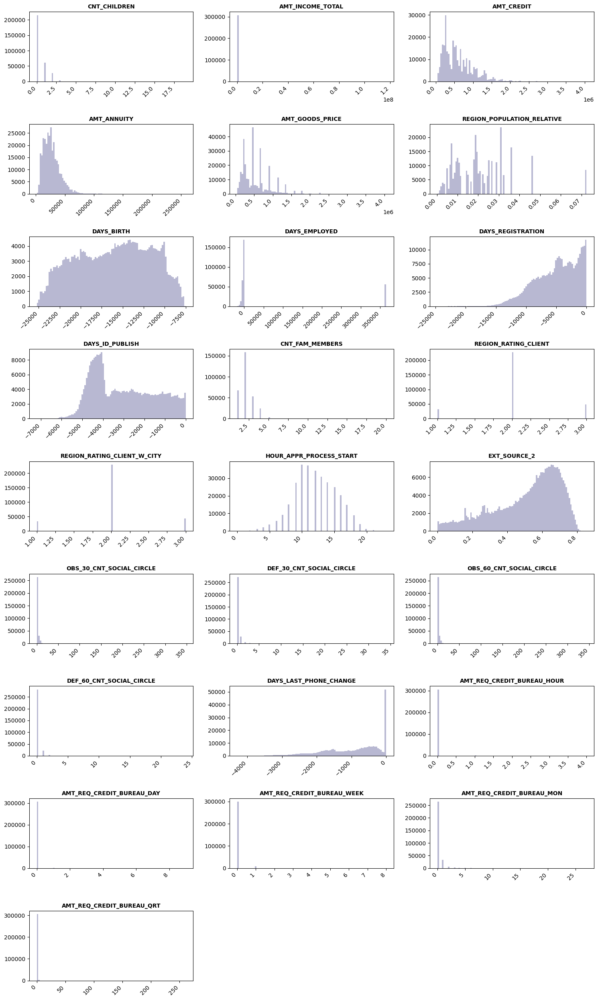

In [23]:
fig = plt.figure(figsize=(15,25))
fct_eda.univariate_plots_hist(app_train_desc, liste_col_quanti, 9, 3, 100, fig=fig)

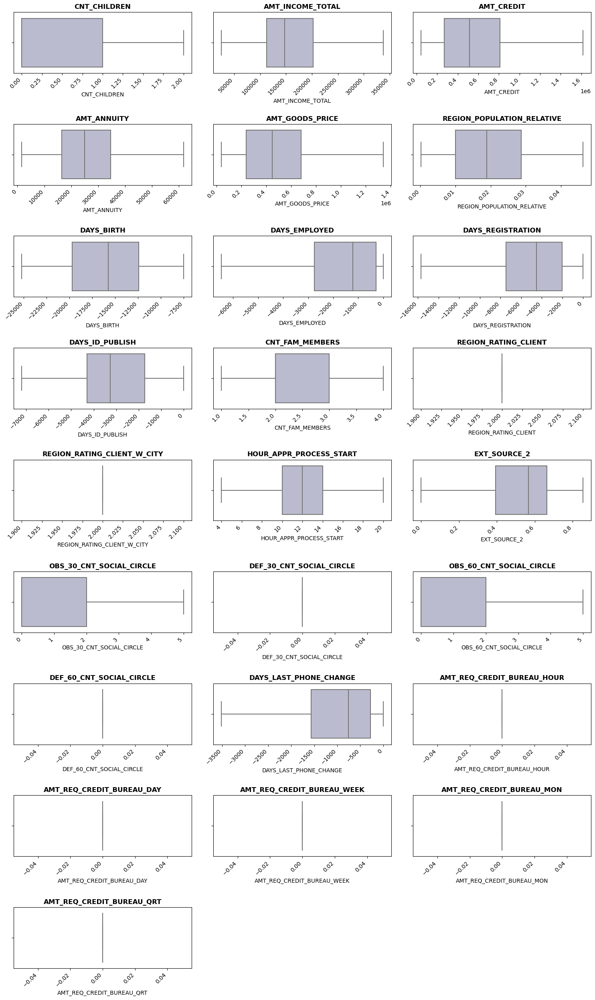

In [24]:
fig = plt.figure(figsize=(15,25))
fct_eda.univariate_plots_box(app_train_desc, liste_col_quanti, 9, 3, fig, False)

Les modalités sous représentées des variables discrètes CNT_CHILDREN et CNT_FAM_MEMBERS vont être regroupées et traitées comme des variables catégorielles:

In [25]:
app_train_desc['CNT_CHILDREN'].value_counts()

0     215371
1      61119
2      26749
3       3717
4        429
5         84
6         21
7          7
14         3
8          2
9          2
12         2
10         2
19         2
11         1
Name: CNT_CHILDREN, dtype: int64

In [26]:
app_train_desc.loc[app_train_desc['CNT_CHILDREN'] == 0, 'CNT_CHILDREN'] = 'No child'
app_train_desc.loc[app_train_desc['CNT_CHILDREN'] == 1, 'CNT_CHILDREN'] = 'One child'
app_train_desc.loc[app_train_desc['CNT_CHILDREN'] == 2, 'CNT_CHILDREN'] = 'Two children'
app_train_desc['CNT_CHILDREN'] = np.where(~app_train_desc['CNT_CHILDREN'].isin(['No child',
                                                                                'One child',
                                                                                'Two children']),
                                          '> Three children',
                                          app_train_desc['CNT_CHILDREN'])

In [27]:
app_train_desc['CNT_FAM_MEMBERS'].value_counts()

2.00     158357
1.00      67847
3.00      52601
4.00      24697
5.00       3478
6.00        408
7.00         81
8.00         20
9.00          6
10.00         3
1.69          2
14.00         2
12.00         2
20.00         2
16.00         2
13.00         1
15.00         1
11.00         1
Name: CNT_FAM_MEMBERS, dtype: int64

In [28]:
# Suppression des 2 valeurs à 1.69
app_train_desc = app_train_desc[~((app_train_desc['CNT_FAM_MEMBERS'] < 2) &
                                  (app_train_desc['CNT_FAM_MEMBERS'] > 1))]

In [29]:
app_train_desc.loc[app_train_desc['CNT_FAM_MEMBERS'] == 1, 'CNT_FAM_MEMBERS_RANGE'] = '1 pers'
app_train_desc.loc[app_train_desc['CNT_FAM_MEMBERS'] == 2, 'CNT_FAM_MEMBERS_RANGE'] = '2 pers'
app_train_desc.loc[app_train_desc['CNT_FAM_MEMBERS'] == 3, 'CNT_FAM_MEMBERS_RANGE'] = '3 pers'
app_train_desc['CNT_FAM_MEMBERS_RANGE'] = np.where(~app_train_desc['CNT_FAM_MEMBERS_RANGE'].isin(['1 pers',
                                                                                      '2 pers',
                                                                                      '3 pers']),
                                                   '> 4 pers',
                                                   app_train_desc['CNT_FAM_MEMBERS_RANGE'])

Pour faciliter la lecture des variables en jours, nous allons les transformer en années puis créer une variable par "range" d'effectifs à peu près similaires lorsque nécessaire:

In [30]:
# Age du client
app_train_desc['AGE'] = round(app_train_desc['DAYS_BIRTH'] / 365 * -1, 0)
del app_train_desc['DAYS_BIRTH']

In [31]:
app_train_desc['AGE'].describe()

count   307509.00
mean        43.94
std         11.96
min         21.00
25%         34.00
50%         43.00
75%         54.00
max         69.00
Name: AGE, dtype: float64

In [32]:
# Discrétisation
app_train_desc.loc[app_train_desc['AGE'] <= 30, 'AGE_RANGE'] = '< 30 YEARS OLD'

app_train_desc.loc[(app_train_desc['AGE'] > 30) & (app_train_desc['AGE'] <= 50),
                   'AGE_RANGE'] = 'BETWEEN 31 AND 50 YEARS OLD'

app_train_desc.loc[app_train_desc['AGE'] > 50, 'AGE_RANGE'] = '> 50 YEARS OLD'

In [33]:
# Ancienneté du client à son poste actuel
app_train_desc['YEARS_EMPLOYED'] = round(app_train_desc['DAYS_EMPLOYED'] / 365 * -1, 2)
del app_train_desc['DAYS_EMPLOYED']

In [34]:
app_train_desc['YEARS_EMPLOYED'].describe()

count   307509.00
mean      -174.84
std        387.06
min      -1000.67
25%          0.79
50%          3.33
75%          7.56
max         49.07
Name: YEARS_EMPLOYED, dtype: float64

Regardons de plus près les variables inférieures à 0:

In [35]:
app_train_desc[app_train_desc['YEARS_EMPLOYED'] < 0]['NAME_INCOME_TYPE'].unique()

array(['Pensioner', 'Unemployed'], dtype=object)

Il s'agit des personnes qui ne travaillent pas ou plus: retraités et sans emploi. Nous allons également discrétiser cette variable:

In [36]:
# On affecte la valeur -1 aux retraités et sans emploi
app_train_desc.loc[app_train_desc['YEARS_EMPLOYED'] == -1000.67, 'YEARS_EMPLOYED'] = -1

In [37]:
# Discrétisation
app_train_desc.loc[app_train_desc['YEARS_EMPLOYED'] <= 0, 'YEARS_EMPLOYED_RANGE'] = 'Pensioner/Unemployed'
app_train_desc.loc[(app_train_desc['YEARS_EMPLOYED'] > 0) & (app_train_desc['YEARS_EMPLOYED'] <= 3),
                   'YEARS_EMPLOYED_RANGE'] = '3 years or less'
app_train_desc.loc[(app_train_desc['YEARS_EMPLOYED'] > 3) & (app_train_desc['YEARS_EMPLOYED'] <= 8),
                   'YEARS_EMPLOYED_RANGE'] = 'Betwwen 3 and 8 years'
app_train_desc.loc[app_train_desc['YEARS_EMPLOYED'] > 8, 'YEARS_EMPLOYED_RANGE'] = 'More than 8 years'

In [38]:
# Nb années avant la demande où le client a modifié son enregistrement
app_train_desc['YEARS_REGISTRATION'] = round(app_train_desc['DAYS_REGISTRATION'] / 365 * -1, 0)
del app_train_desc['DAYS_REGISTRATION']

In [39]:
app_train_desc['YEARS_REGISTRATION'].describe()

count   307509.00
mean        13.66
std          9.66
min          0.00
25%          6.00
50%         12.00
75%         20.00
max         68.00
Name: YEARS_REGISTRATION, dtype: float64

In [40]:
# Discrétisation
app_train_desc.loc[app_train_desc['YEARS_REGISTRATION'] <= 6, 'YEARS_REGISTRATION_RANGE'] = '< 6 YEARS'

app_train_desc.loc[(app_train_desc['YEARS_REGISTRATION'] > 6) & (app_train_desc['YEARS_REGISTRATION'] <= 12),
                   'YEARS_REGISTRATION_RANGE'] = 'BETWEEN 6 AND 12 YEARS'

app_train_desc.loc[(app_train_desc['YEARS_REGISTRATION'] > 12) & (app_train_desc['YEARS_REGISTRATION'] <= 20),
                   'YEARS_REGISTRATION_RANGE'] = 'BETWEEN 13 AND 20 YEARS'

app_train_desc.loc[app_train_desc['YEARS_REGISTRATION'] > 20, 'YEARS_REGISTRATION_RANGE'] = '> 20 YEARS'

In [41]:
# Heure où le client a demandé son prêt
app_train_desc.loc[app_train_desc['HOUR_APPR_PROCESS_START'] < 8,'HOUR_APPR_PROCESS_START_RANGE'] = 'Evening/Night'
app_train_desc.loc[(app_train_desc['HOUR_APPR_PROCESS_START'] >= 8) & (app_train_desc['HOUR_APPR_PROCESS_START'] <= 12),
                   'HOUR_APPR_PROCESS_START_RANGE'] = 'Morning'
app_train_desc.loc[(app_train_desc['HOUR_APPR_PROCESS_START'] > 12) & (app_train_desc['HOUR_APPR_PROCESS_START'] <= 14),
                   'HOUR_APPR_PROCESS_START_RANGE'] = 'Lunch Break'
app_train_desc.loc[(app_train_desc['HOUR_APPR_PROCESS_START'] > 14) & (app_train_desc['HOUR_APPR_PROCESS_START'] <= 19),
                   'HOUR_APPR_PROCESS_START_RANGE'] = 'Afternoon'
app_train_desc.loc[app_train_desc['HOUR_APPR_PROCESS_START'] > 19, 'HOUR_APPR_PROCESS_START_RANGE'] = 'Evening/Night'

In [42]:
# Nb années avant la demande où le client a changé son document d'identité
app_train_desc['YEARS_ID_PUBLISH'] = round(app_train_desc['DAYS_ID_PUBLISH'] / 365 * -1, 2)
del app_train_desc['DAYS_ID_PUBLISH']

In [43]:
app_train_desc['YEARS_ID_PUBLISH'].describe()

count   307509.00
mean         8.20
std          4.14
min          0.00
25%          4.71
50%          8.92
75%         11.78
max         19.72
Name: YEARS_ID_PUBLISH, dtype: float64

In [44]:
# Discrétisation
app_train_desc.loc[app_train_desc['YEARS_ID_PUBLISH'] <= 5, 'YEARS_ID_PUBLISH_RANGE'] = '< 5 YEARS'

app_train_desc.loc[(app_train_desc['YEARS_ID_PUBLISH'] > 5) & (app_train_desc['YEARS_ID_PUBLISH'] <= 9),
                   'YEARS_ID_PUBLISH_RANGE'] = 'BETWEEN 5 AND 9 YEARS'

app_train_desc.loc[(app_train_desc['YEARS_ID_PUBLISH'] > 9) & (app_train_desc['YEARS_ID_PUBLISH'] <= 12),
                   'YEARS_ID_PUBLISH_RANGE'] = 'BETWEEN 10 AND 12 YEARS'

app_train_desc.loc[app_train_desc['YEARS_ID_PUBLISH'] > 12, 'YEARS_ID_PUBLISH_RANGE'] = '> 12 YEARS'

In [45]:
# Nb années avant la demande où le client a changé son numéro de téléphone
app_train_desc['YEARS_LAST_PHONE_CHANGE'] = round(app_train_desc['DAYS_LAST_PHONE_CHANGE'] / 365 * -1, 2)
del app_train_desc['DAYS_LAST_PHONE_CHANGE']

In [46]:
app_train_desc['YEARS_LAST_PHONE_CHANGE'].describe()

count   307509.00
mean         2.64
std          2.27
min         -0.00
25%          0.75
50%          2.07
75%          4.30
max         11.76
Name: YEARS_LAST_PHONE_CHANGE, dtype: float64

In [47]:
# Discrétisation
app_train_desc.loc[app_train_desc['YEARS_LAST_PHONE_CHANGE'] <= 1, 'YEARS_LAST_PHONE_CHANGE_RANGE'] = '< 1 YEAR'

app_train_desc.loc[(app_train_desc['YEARS_LAST_PHONE_CHANGE'] > 1) & (app_train_desc['YEARS_LAST_PHONE_CHANGE'] <= 2),
                   'YEARS_LAST_PHONE_CHANGE_RANGE'] = 'BETWEEN 1 AND 2 YEARS'

app_train_desc.loc[(app_train_desc['YEARS_LAST_PHONE_CHANGE'] > 2) & (app_train_desc['YEARS_LAST_PHONE_CHANGE'] <= 4),
                   'YEARS_LAST_PHONE_CHANGE_RANGE'] = 'BETWEEN 2 AND 4 YEARS'

app_train_desc.loc[app_train_desc['YEARS_LAST_PHONE_CHANGE'] > 4, 'YEARS_LAST_PHONE_CHANGE_RANGE'] = '> 4 YEARS'

In [48]:
liste_col_quanti = app_train_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique()
liste_col_quanti = liste_col_quanti[liste_col_quanti>2].index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR', 'AGE_RANGE', 'YEARS_REGISTRATION_RANGE', 
                          'YEARS_ID_PUBLISH_RANGE', 'YEARS_LAST_PHONE_CHANGE_RANGE',
                          'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [49]:
app_train_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
AMT_INCOME_TOTAL,307509.00,168796.90,237123.37,25650.00,112500.00,147150.00,202500.00,117000000.00
AMT_CREDIT,307509.00,599025.80,402492.06,45000.00,270000.00,513531.00,808650.00,4050000.00
AMT_ANNUITY,307509.00,27108.51,14493.62,1615.50,16524.00,24903.00,34596.00,258025.50
AMT_GOODS_PRICE,307509.00,538134.22,369419.23,40500.00,238500.00,450000.00,679500.00,4050000.00
REGION_POPULATION_RELATIVE,307509.00,0.02,0.01,0.00,0.01,0.02,0.03,0.07
CNT_FAM_MEMBERS,307509.00,2.15,0.91,1.00,2.00,2.00,3.00,20.00
HOUR_APPR_PROCESS_START,307509.00,12.06,3.27,0.00,10.00,12.00,14.00,23.00
EXT_SOURCE_2,307509.00,0.51,0.19,0.00,0.39,0.57,0.66,0.85
OBS_30_CNT_SOCIAL_CIRCLE,307509.00,1.42,2.40,0.00,0.00,0.00,2.00,348.00
DEF_30_CNT_SOCIAL_CIRCLE,307509.00,0.14,0.45,0.00,0.00,0.00,0.00,34.00


Nous **conservons les outliers** qui dans les cas d'identification de défaut de paiement peuvent nous être très utiles pour différencier les bons des moins bons payeurs. En effet le cas d'une personne avec de très hauts revenus doit être pris en compte et non écarté de notre modèle.

In [50]:
liste_col_quali = app_train_desc.select_dtypes(exclude='float')
liste_col_quali = liste_col_quali.nunique()
liste_col_quali = liste_col_quali[liste_col_quali>=2].index.tolist()
liste_col_quali_suppr = ['SK_ID_CURR', 'TARGET', 'HOUR_APPR_PROCESS_START']

liste_col_quali = [elem for elem in liste_col_quali if elem not in liste_col_quali_suppr]

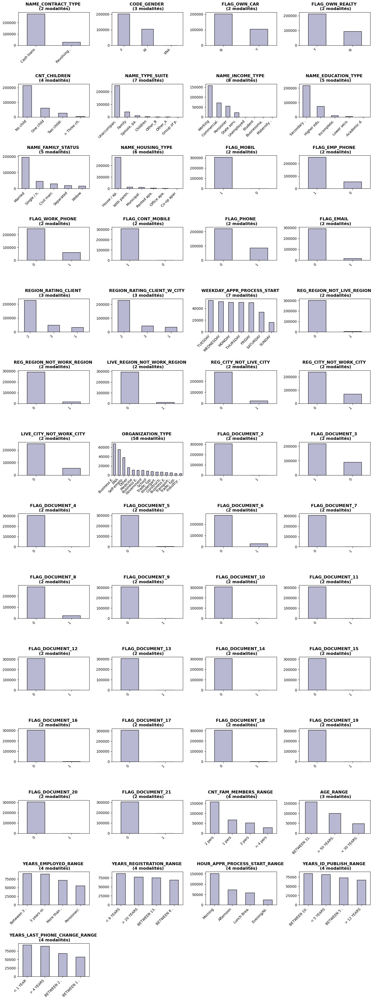

In [51]:
fig = plt.figure(figsize=(15, 40))
fct_eda.categ_distrib_plot(app_train_desc, liste_col_quali, 14, 4, fig = fig)

Nous remarquons un genre **XNA** comportant uniquement 4 observations. Nous les supprimons.

In [52]:
app_train_desc['CODE_GENDER'].value_counts()

F      202447
M      105058
XNA         4
Name: CODE_GENDER, dtype: int64

In [53]:
app_train_desc = app_train_desc[app_train_desc['CODE_GENDER'].isin(["F", "M"])]

Nous allons également regrouper certaines modalités afin de diminuer leur nombre:

In [54]:
app_train_desc['NAME_TYPE_SUITE'].value_counts()

Unaccompanied      249813
Family              40148
Spouse, partner     11370
Children             3267
Other_B              1770
Other_A               866
Group of people       271
Name: NAME_TYPE_SUITE, dtype: int64

In [55]:
dico_name_type_suite = {'Unaccompanied' : 'Unaccompanied',
                        'Family': 'Family',
                        'Spouse, partner': 'Family',
                        'Children': 'Family',
                        'Other_B': 'Other',
                        'Other_A': 'Other',
                        'Group of people': 'Other'}

app_train_desc['NAME_TYPE_SUITE'] = app_train_desc['NAME_TYPE_SUITE'].map(dico_name_type_suite)

In [56]:
app_train_desc['NAME_INCOME_TYPE'].value_counts()

Working                 158771
Commercial associate     71614
Pensioner                55362
State servant            21703
Unemployed                  22
Student                     18
Businessman                 10
Maternity leave              5
Name: NAME_INCOME_TYPE, dtype: int64

In [57]:
dico_name_income_type = {'Working' : 'Private worker',
                        'Commercial associate': 'Commercial associate',
                        'Pensioner': 'Pensioner/Student/Unemployed',
                        'State servant': 'Public worker',
                        'Unemployed': 'Pensioner/Student/Unemployed',
                        'Student': 'Pensioner/Student/Unemployed',
                        'Businessman': 'Other',
                        'Maternity leave': 'Pensioner/Student/Unemployed'}

app_train_desc['NAME_INCOME_TYPE'] = app_train_desc['NAME_INCOME_TYPE'].map(dico_name_income_type)

In [58]:
app_train_desc['NAME_EDUCATION_TYPE'].value_counts()

Secondary / secondary special    218389
Higher education                  74861
Incomplete higher                 10276
Lower secondary                    3815
Academic degree                     164
Name: NAME_EDUCATION_TYPE, dtype: int64

In [59]:
dico_name_education_type = {'Secondary / secondary special' : 'Lower Secondary & Secondary',
                            'Higher education': 'Higher education',
                            'Incomplete higher': 'Incomplete higher',
                            'Lower secondary': 'Lower Secondary & Secondary',
                            'Academic degree': 'Higher education',}

app_train_desc['NAME_EDUCATION_TYPE'] = app_train_desc['NAME_EDUCATION_TYPE'].map(dico_name_education_type)

In [60]:
app_train_desc['NAME_FAMILY_STATUS'].value_counts()

Married                 196429
Single / not married     45444
Civil marriage           29774
Separated                19770
Widow                    16088
Name: NAME_FAMILY_STATUS, dtype: int64

In [61]:
# Suppression des 2 unknown
app_train_desc = app_train_desc[~app_train_desc['NAME_FAMILY_STATUS'].isin(["Unknown"])]

In [62]:
dico_name_family_status = {'Married' : 'Married',
                           'Single / not married': 'Not Married',
                           'Civil marriage': 'Married',
                           'Separated': 'Separated',
                           'Widow': 'Widow',}

app_train_desc['NAME_FAMILY_STATUS'] = app_train_desc['NAME_FAMILY_STATUS'].map(dico_name_family_status)

In [63]:
app_train_desc['NAME_HOUSING_TYPE'].value_counts()

House / apartment      272864
With parents            14840
Municipal apartment     11181
Rented apartment         4881
Office apartment         2617
Co-op apartment          1122
Name: NAME_HOUSING_TYPE, dtype: int64

In [64]:
dico_name_housing_type = {'House / apartment' : 'Owner',
                          'With parents': 'No or low rent',
                          'Municipal apartment': 'No or low rent',
                          'Rented apartment': 'Tenant',
                          'Office apartment': 'No or low rent',
                          'Co-op apartment':'Tenant'}

app_train_desc['NAME_HOUSING_TYPE'] = app_train_desc['NAME_HOUSING_TYPE'].map(dico_name_housing_type)

In [65]:
app_train_desc['WEEKDAY_APPR_PROCESS_START'].value_counts()

TUESDAY      53900
WEDNESDAY    51934
MONDAY       50714
THURSDAY     50589
FRIDAY       50335
SATURDAY     33852
SUNDAY       16181
Name: WEEKDAY_APPR_PROCESS_START, dtype: int64

In [66]:
dico_weekday_process = {'TUESDAY' : 'working days',
                        'WEDNESDAY': 'working days',
                        'MONDAY': 'working days',
                        'THURSDAY': 'working days',
                        'FRIDAY': 'working days',
                        'SATURDAY':'week end',
                        'SUNDAY':'week end'}

app_train_desc['WEEKDAY_APPR_PROCESS_START'] = app_train_desc['WEEKDAY_APPR_PROCESS_START'].map(dico_weekday_process)

In [67]:
app_train_desc['ORGANIZATION_TYPE'].value_counts()

Business Entity Type 3    67992
XNA                       55374
Self-employed             38412
Other                     16683
Medicine                  11192
Business Entity Type 2    10552
Government                10404
School                     8893
Trade: type 7              7831
Kindergarten               6879
Construction               6721
Business Entity Type 1     5983
Transport: type 4          5398
Trade: type 3              3492
Industry: type 9           3368
Industry: type 3           3277
Security                   3247
Housing                    2958
Industry: type 11          2704
Military                   2634
Bank                       2507
Agriculture                2454
Police                     2341
Transport: type 2          2204
Postal                     2157
Security Ministries        1974
Trade: type 2              1900
Restaurant                 1811
Services                   1575
University                 1327
Industry: type 7           1307
Transpor

In [68]:
dico_orga_type = {'Industry: type 6' : 'Industry',
                  'Industry: type 13':'Industry',
                  'Industry: type 8':'Industry',
                  'Industry: type 5':'Industry',
                  'Industry: type 10':'Industry',
                  'Industry: type 12':'Industry',
                  'Industry: type 2':'Industry',
                  'Industry: type 9':'Industry',
                  'Industry: type 3':'Industry',
                  'Industry: type 7':'Industry',
                  'Industry: type 1':'Industry',
                  'Industry: type 4':'Industry',
                  'Industry: type 11':'Industry',
                  'Business Entity Type 3':'Business Entity',
                  'Business Entity Type 2':'Business Entity',
                  'Business Entity Type 1':'Business Entity',
                  'Transport: type 1':'Transport',
                  'Transport: type 2':'Transport',
                  'Transport: type 3':'Transport',
                  'Transport: type 4':'Transport',
                  'Trade: type 7':'Trade',
                  'Trade: type 4':'Trade',
                  'Trade: type 5':'Trade',
                  'Trade: type 1':'Trade',
                  'Trade: type 6':'Trade',
                  'Trade: type 3':'Trade',
                  'Trade: type 2':'Trade',
                  'Bank':'Bank/Insurance',
                  'Insurance':'Bank/Insurance',
                  'School': 'School/University/Kindergarten',
                  'University': 'School/University/Kindergarten',
                  'Kindergarten': 'School/University/Kindergarten',
                  'Government': 'Government/Military/Security Ministries', 
                  'Military': 'Government/Military/Security Ministries', 
                  'Security Ministries': 'Government/Military/Security Ministries',
                  'Telecom':'Telecom',
                  'Mobile':'Telecom',
                  'Electricity':'Electricity/Construction',
                  'Construction':'Electricity/Construction',
                  'Services': 'Services',
                  'Advertising': 'Services',
                  'Legal Services': 'Services',
                  'Hotel':'Hotel/Restaurant',
                  'Restaurant':'Hotel/Restaurant',
                  'Cleaning':'Cleaning/Housing',
                  'Housing':'Cleaning/Housing',
                  'Medicine':'Medical',
                  'Emergency':'Medical',
                  'Security':'Police/Security',
                  'Police':'Police/Security',
                  'Religion':'Other',
                  'Other':'Other',
                  'XNA':'Other',
                  'Self-employed':'Self-employed',
                  'Postal':'Postal',
                  'Agriculture':'Agriculture',
                  'Culture':'Culture',
                  'Realtor':'Realtor',}

app_train_desc['ORGANIZATION_TYPE'] = app_train_desc['ORGANIZATION_TYPE'].map(dico_orga_type)

<div class="alert alert-block alert-warning">
    <p>TARGET</p>
</div>

Si l'on se réfère au fichier de description des colonnes:
- **1** => clients a des difficultés de paiement, il a eu un retard de paiement de plus de X jours sur au moins une des Y premières échéances du prêt dans notre échantillon (**défaillant**)
- **0** => tous les autres cas (**non défaillant**)	

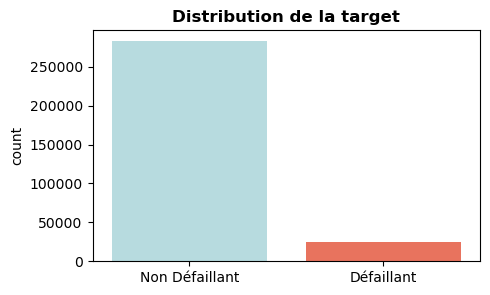

In [69]:
# Distribution de la target
plt.figure(figsize=(5,3))
sns.countplot(x = 'TARGET', data = app_train_desc, palette=['powderblue', 'tomato'])
plt.title('Distribution de la target', fontweight='bold', fontsize = 12)
x = [0, 1]
plt.xticks(x, ['Non Défaillant', 'Défaillant'])
plt.xlabel('');

In [70]:
app_train_desc['TARGET'].value_counts()

0    282680
1     24825
Name: TARGET, dtype: int64

<div class="alert alert-block alert-success">
    <p>A noter: Le jeu de données est déséquilibré avec beaucoup plus de non défaillants (>230K) que de défaillants (environ 22K). Il faudra en tenir compte lors de l'élaboration de notre modèle.</p>
</div>

#### Analyses bivariées / multivariées

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

Lors de l'analyse univariée des variables quantitatives, nous avons remarqué que leur distribution n'était pas proche d'une distribution Normale. Nous allons donc étudier leur **corrélation de Spearman** (et non pas Pearson) qui est une méthode **non paramétrique** basée sur les rangs. 

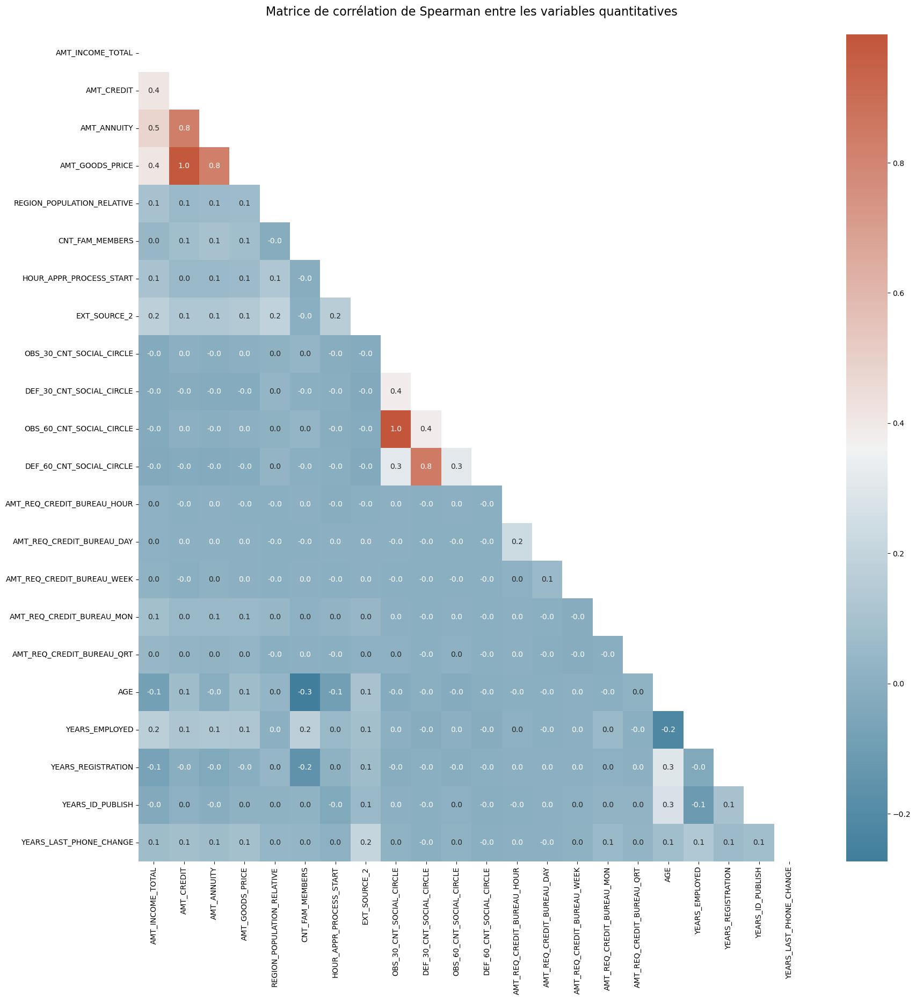

In [71]:
# Corrélation
corr = app_train_desc[liste_col_quanti].corr('spearman')

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(20, 20))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation de Spearman entre les variables quantitatives\n", fontsize=16);

Lorsque deux variables sont fortement corrélées (> 0.6), nous n'en conserverons qu'une pour la suite de l'analyse afin **d'éviter la multicolinéarité**. Lors de la visualisation des boxplots, nous définirons la plus différenciante entre:
- AMT_ANNUITY et AMT_CREDIT
- AMT_GOODS_PRICE et AMT_CREDIT
- AMT_GOODS_PRICE et AMT_ANNUITY
- OBS_60_CNT_SOCIAL_CIRCLE et OBS_30_CNT_SOCIAL_CIRCLE
- DEF_60_CNT_SOCIAL_CIRCLE et DEF_30_CNT_SOCIAL_CIRCLE

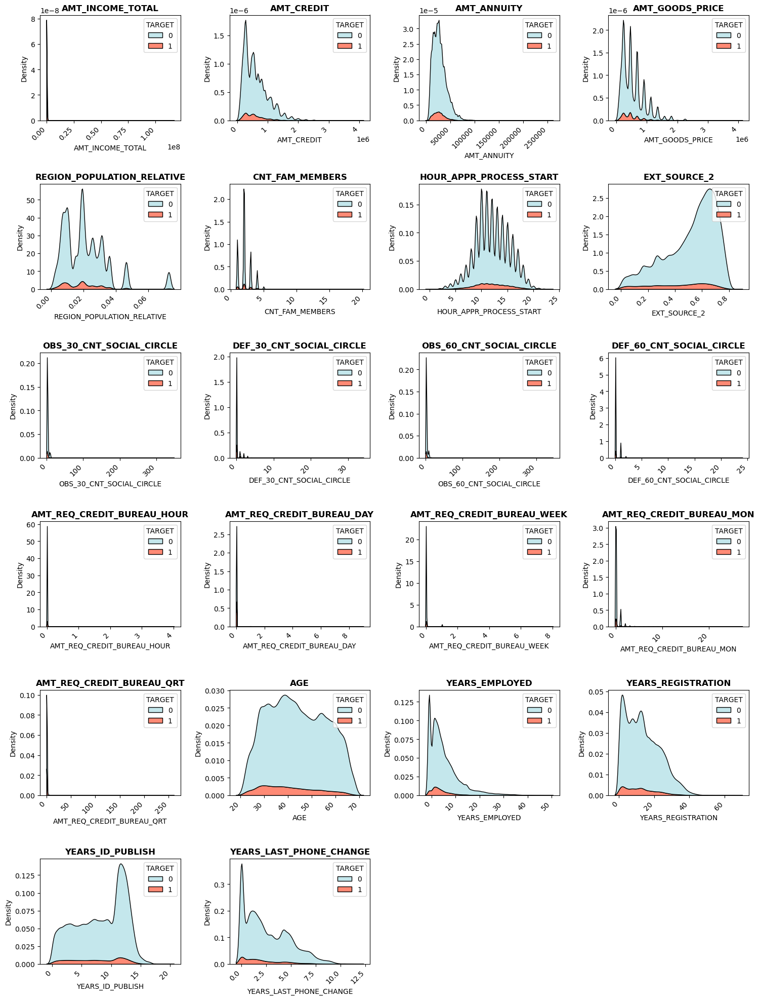

In [72]:
palette=['powderblue', 'tomato']

fct_eda.bivariate_kdeplots(app_train_desc, 'TARGET',
                           liste_col_quanti,
                           6, 4, palette = palette)

Le jeu de données étant déséquilibré en défaveur des défaillants, nous allons faire un focus sur ces derniers avec d'essayer d'identifier un "profil type" et de mieux visualiser les données.

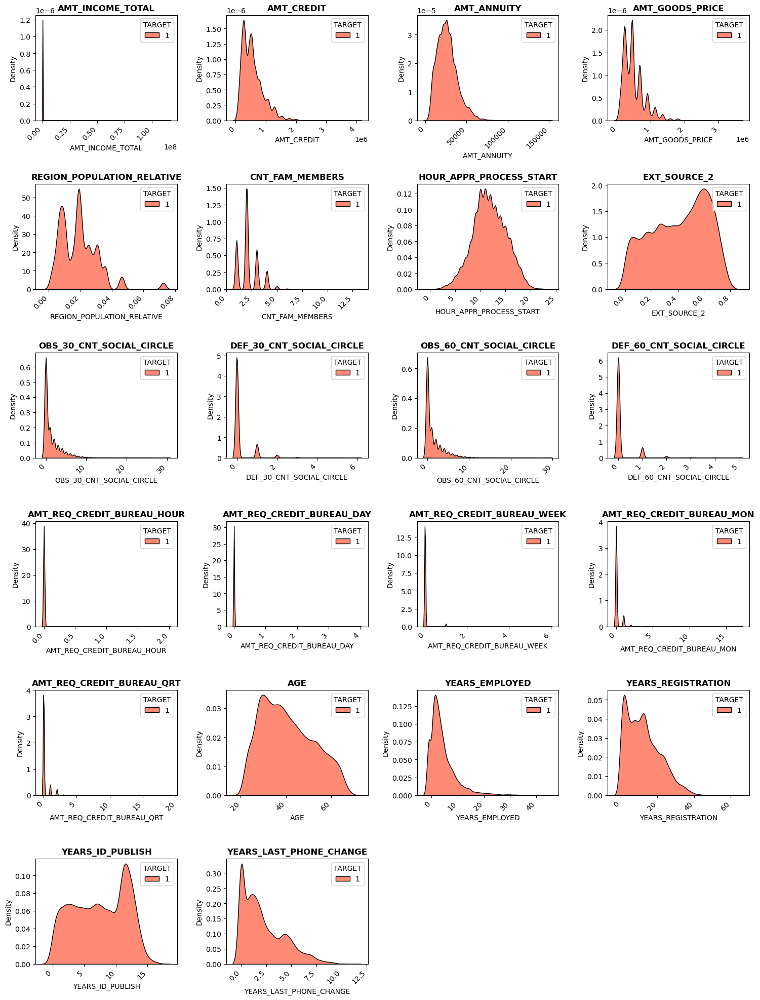

In [73]:
fct_eda.bivariate_kdeplots(app_train_desc[app_train_desc['TARGET'] == 1],
                           'TARGET',
                           liste_col_quanti,
                           6, 4,
                           palette = ['tomato'])

Afin de repérer les variables les plus différenciantes, la visualisation via boxplot reste la plus appropriée. Elle va nous permettre de séléctionner les variables qui semblent influencer le plus la target.

Pour savoir si l'on peut prédire correctement la target par nos variables quantitatives, notre modèle doit parvenir à expliquer un gros pourcentage des variations des données. Si c'est le cas, cela signifie que les variables quantitatives et la variable cible sont fortement corrélées.

Le test applicable est l'ANOVA à un facteur de comparaison de plus de deux positions. Les conditions d'utilisation de ce test sont:
- les valeurs de chaque échantillon doivent être normalement distribuées
- les variances doivent être égales Les hypothèses sont:
- H0: μ1 = μ2 = ... = μk
- HA : ] (i,j) tel que μi = μj
- alpha = 0.05

Cependant, comme nous savons que nos données ne sont pas normalement distribuées, nous utiliserons le test non paramétrique de **Kruskall-Wallis** qui est un test sur la **moyenne des rangs**.

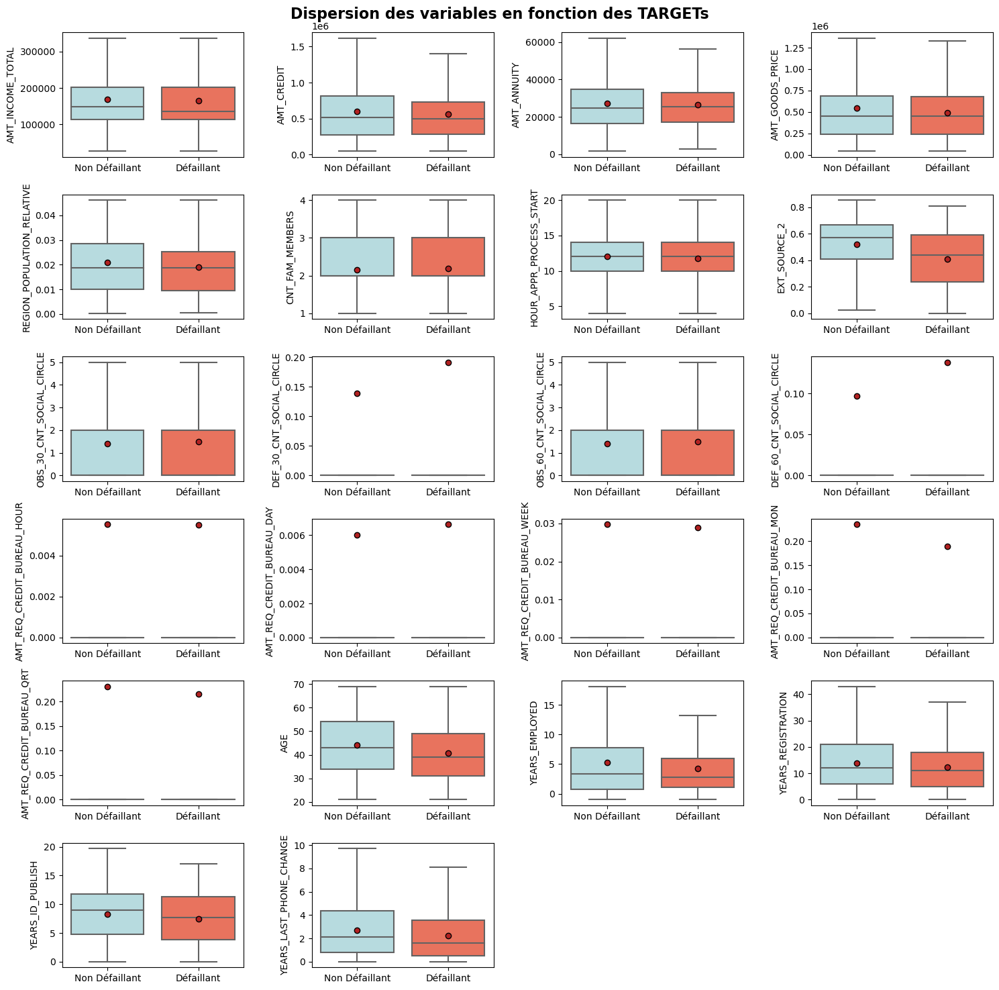

In [74]:
fig = plt.figure(figsize=(15,15))
fct_eda.bivariate_plots_box(app_train_desc, 'TARGET', liste_col_quanti, 6, 4, fig)

In [75]:
def Kruskal_Wallis_test(data, liste_var_quanti, var_quali):
    print('Test non paramétrique de Kruskal Wallis: ')
    print()
    for nutri in liste_var_quanti:
        kstat, pval = kruskal(*[group[nutri].values for name, group in data.groupby(var_quali)])
        print(f'Variable {nutri} par {var_quali}')
        if pval <= 0.05:
            print(f"pvaleur: {pval} < 0.05 => on rejette H0, les médianes entre les {var_quali} sont différentes")
        else:
            print(f"pvaleur: {pval} > 0.05 => on accepte H0, les médianes entre les {var_quali} sont identiques")
        print('-----------------------------------------------------------------------------------')

In [76]:
Kruskal_Wallis_test(app_train_desc, liste_col_quanti, 'TARGET')

Test non paramétrique de Kruskal Wallis: 

Variable AMT_INCOME_TOTAL par TARGET
pvaleur: 1.0517131185144232e-23 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable AMT_CREDIT par TARGET
pvaleur: 2.3504197846611414e-22 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable AMT_ANNUITY par TARGET
pvaleur: 0.9672599187686464 > 0.05 => on accepte H0, les médianes entre les TARGET sont identiques
-----------------------------------------------------------------------------------
Variable AMT_GOODS_PRICE par TARGET
pvaleur: 4.261530460732926e-68 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable REGION_POPULATION_RELATIVE par TARGET
pvaleur: 2.0892696852225422e

Grâce à la visualisation par boxplot, au calcul du coefficient de Spearman ainsi qu'au test non paramétrique de Kruskal_Wallis nous pouvons supprimer les variables suivantes:
- AMT_ANNUITY (à conserver car sera utilisé lors du feature engineering)
- AMT_REQ_CREDIT_BUREAU_HOUR
- AMT_REQ_CREDIT_BUREAU_WEEK
- AMT_REQ_CREDIT_BUREAU_DAY
- AMT_REQ_CREDIT_BUREAU_MON
- AMT_REQ_CREDIT_BUREAU_QRT
- OBS_60_CNT_SOCIAL_CIRCLE
- DEF_60_CNT_SOCIAL_CIRCLE

In [77]:
var_quanti_a_suppr = ['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_DAY',
                      'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
                      'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE']

<div class="alert alert-block alert-warning">
    <p>Variables qualitatives et target</p>
</div>

Pour tester l'association entre nos variables qualitatives et la taget, le test applicable est le test du Chi2. Les conditions d'utilisation de ce test sont:
- chaque effectif du tableau doit être supérieur ou égal à 5

Les hypothèses sont:
- H0: indépendance entre les 2 variables qualitatives
- HA: association entre les 2 variables qualitatives
- alpha = 0.05

Nous ne conserverons pas les variables indépendantes:

NAME_CONTRACT_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.183380632598739e-65 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


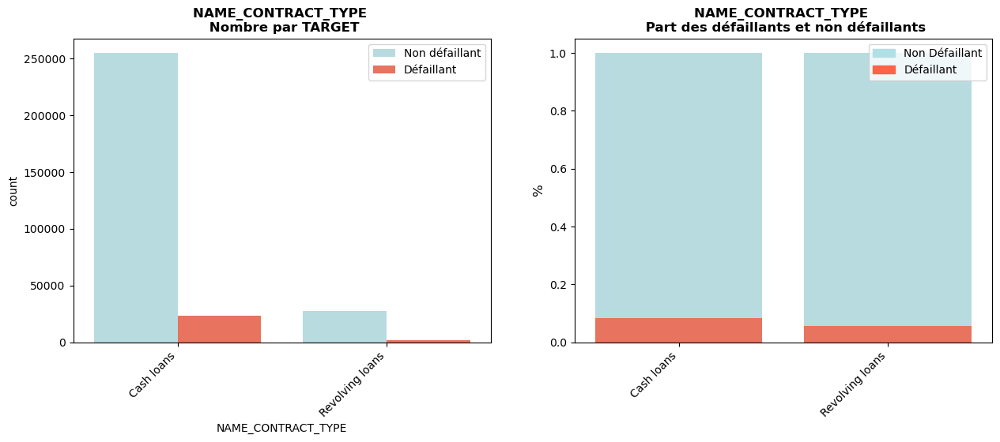

CODE_GENDER vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 4.342688928926844e-202 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


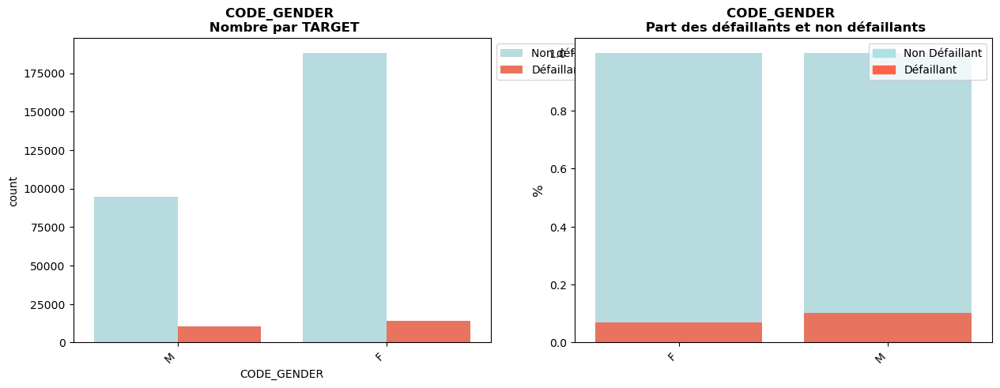

FLAG_OWN_CAR vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 9.324729616319597e-34 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


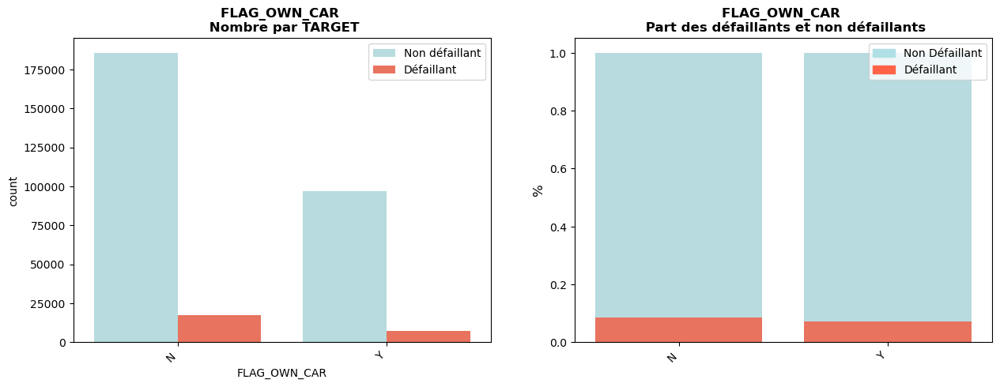

FLAG_OWN_REALTY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0006734141715202391 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


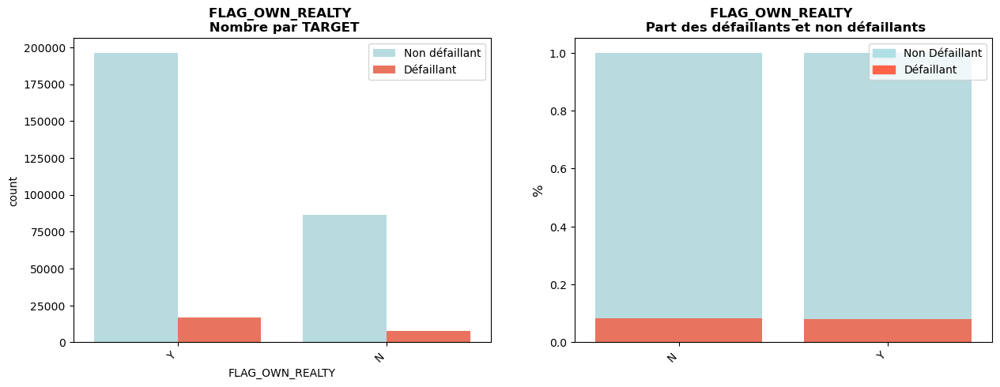

CNT_CHILDREN vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 4.6594194785587487e-29 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


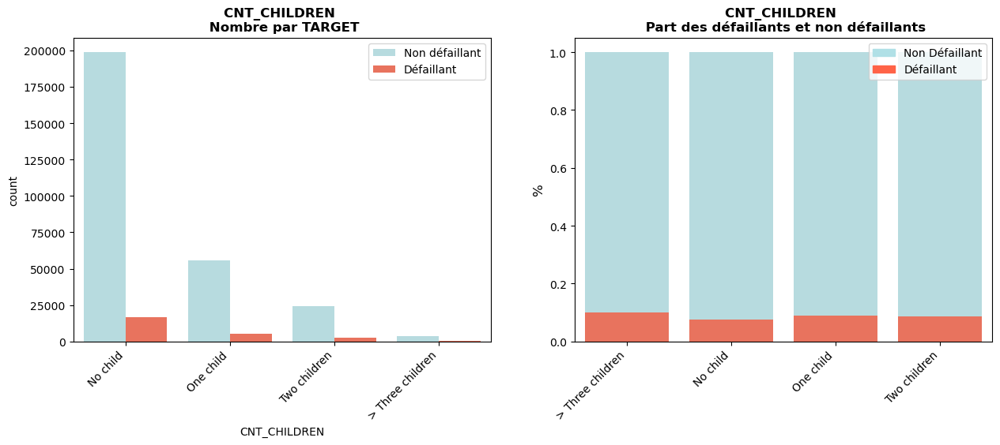

NAME_TYPE_SUITE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 5.348761768530639e-07 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


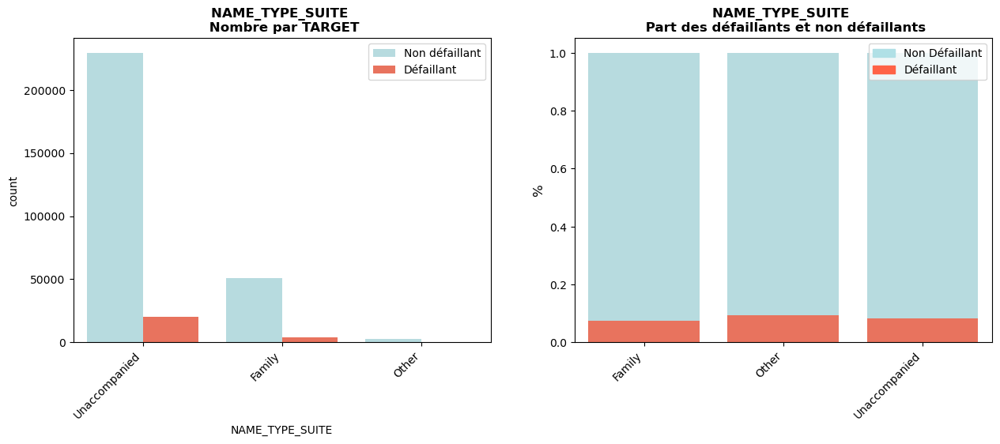

NAME_INCOME_TYPE vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 4.6351821473059006e-262 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


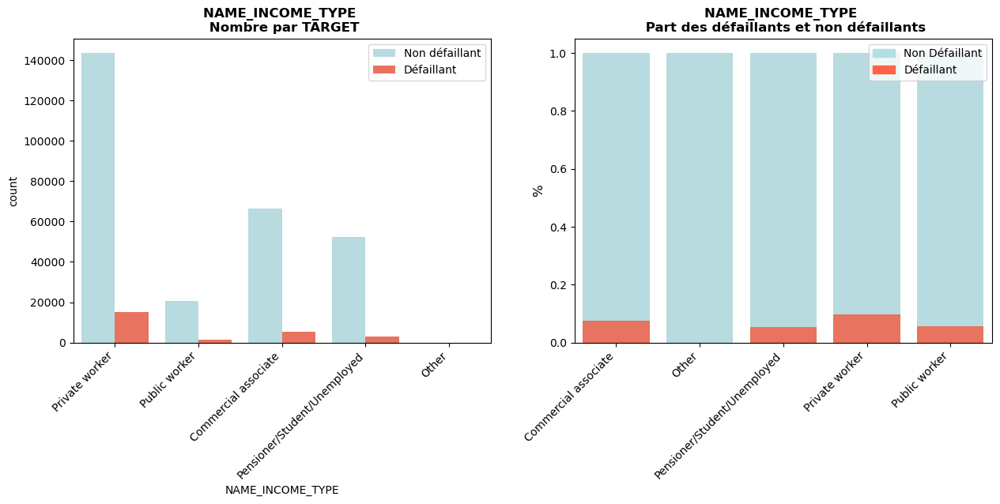

NAME_EDUCATION_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 4.184917928712192e-217 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


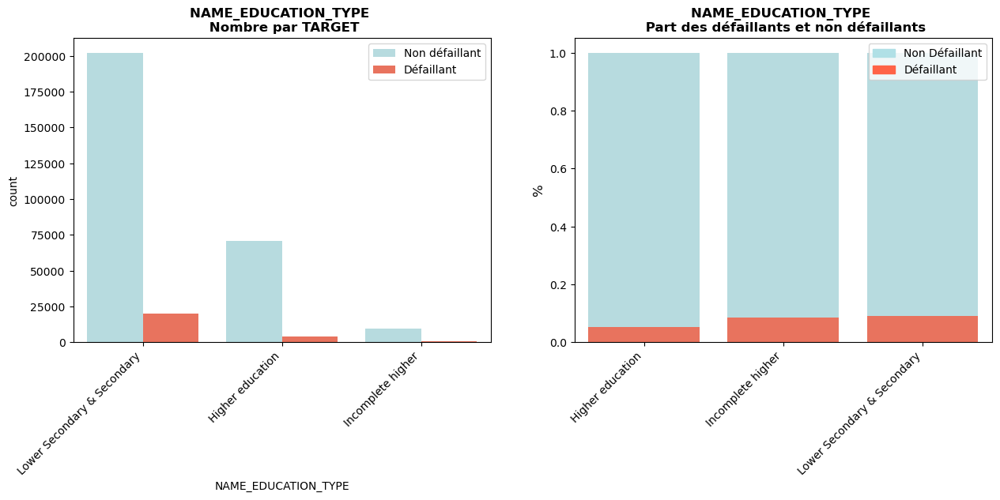

NAME_FAMILY_STATUS vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 4.1768519499512373e-66 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


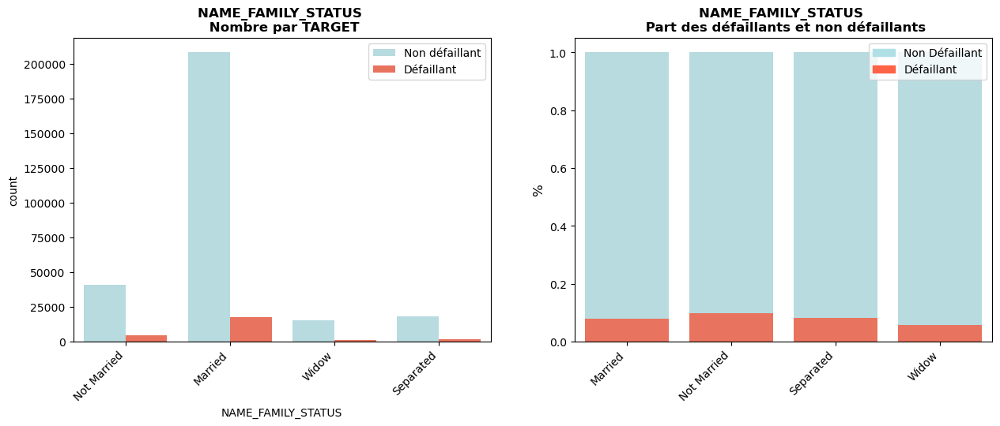

NAME_HOUSING_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.910194079210902e-58 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


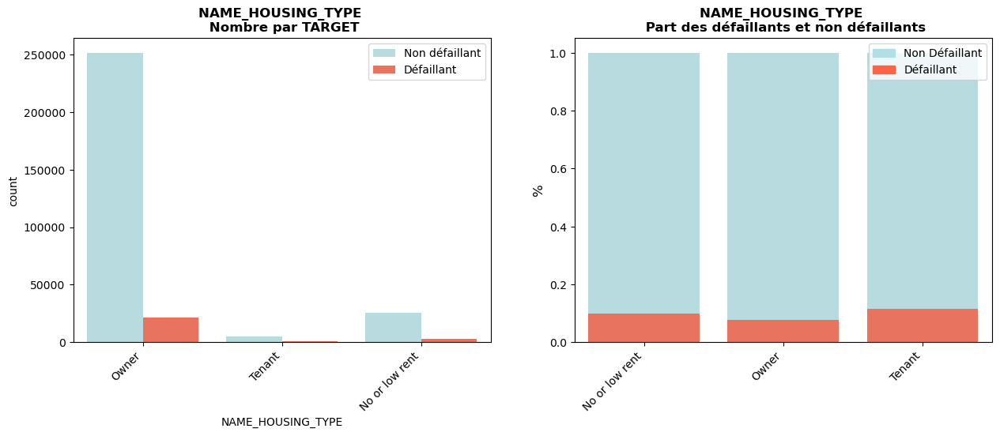

FLAG_MOBIL vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.12379090634452292 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


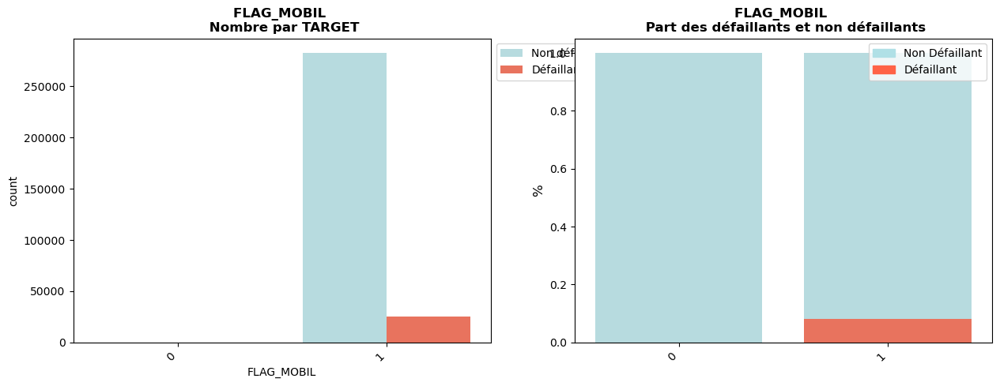

FLAG_EMP_PHONE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 2.4460829392311824e-143 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


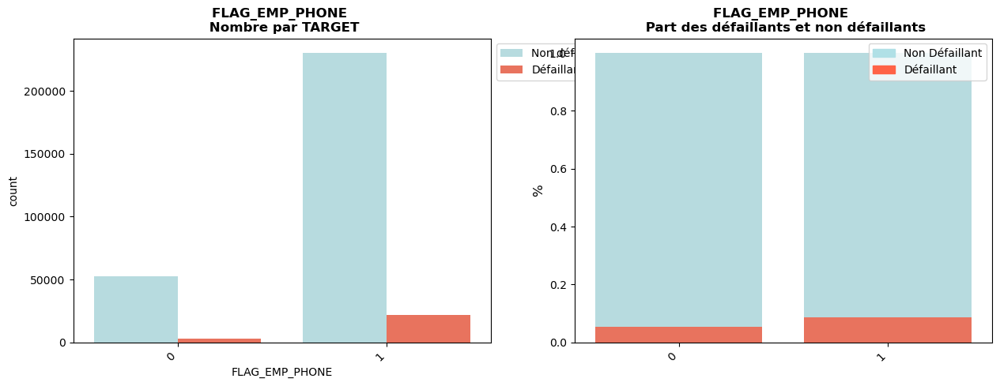

FLAG_WORK_PHONE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 2.4532482943237683e-56 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


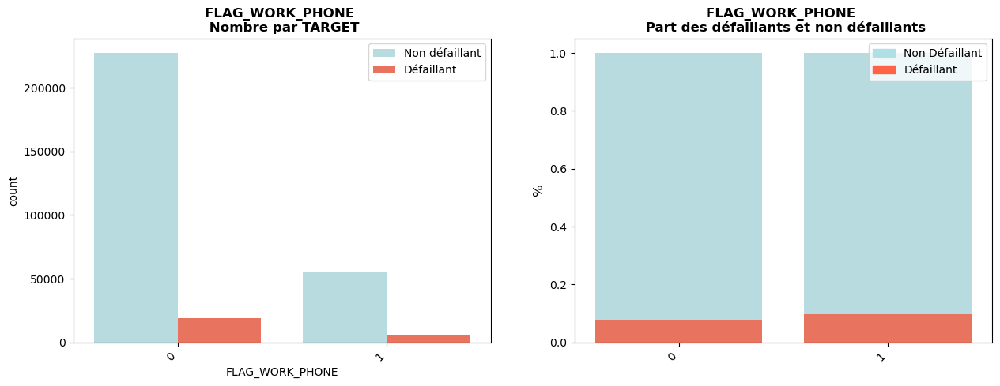

FLAG_CONT_MOBILE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.8975901625319193 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


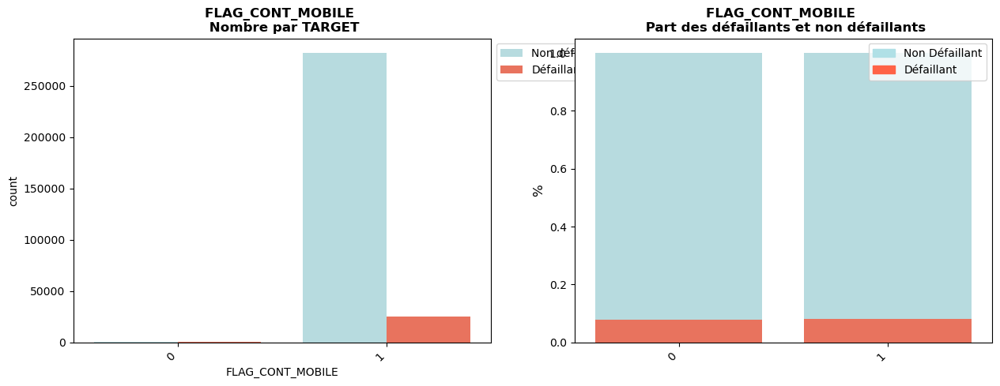

FLAG_PHONE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 9.976654859666912e-40 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


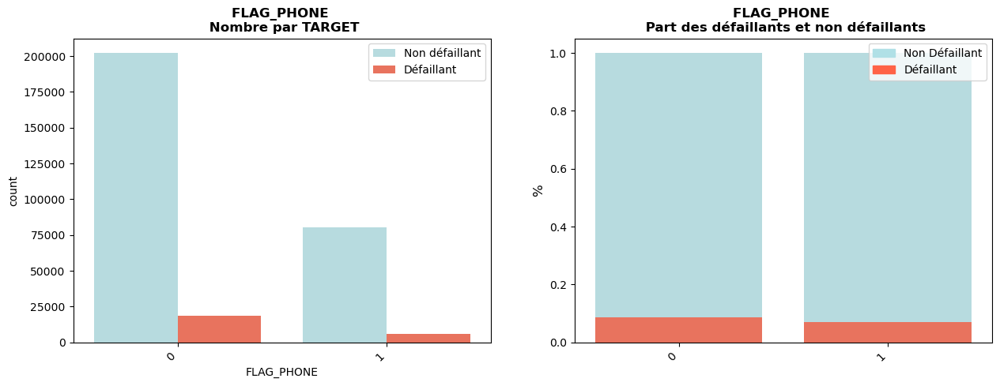

FLAG_EMAIL vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.336272032904839 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


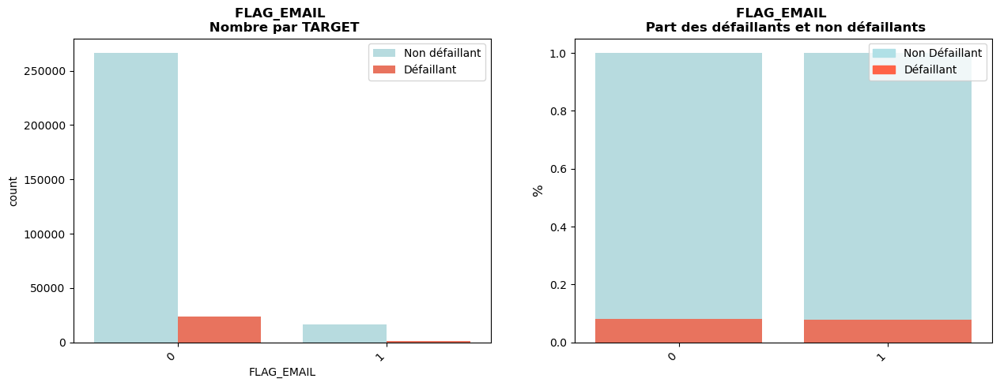

REGION_RATING_CLIENT vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.7925303802791614e-232 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


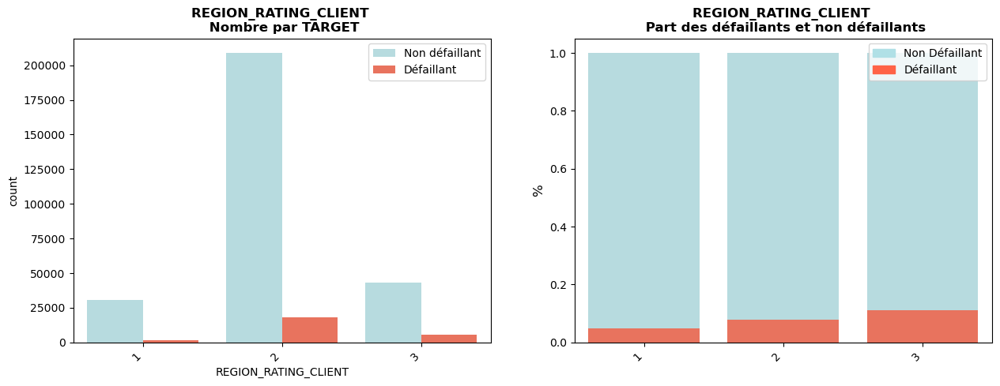

REGION_RATING_CLIENT_W_CITY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 4.930129314011382e-249 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


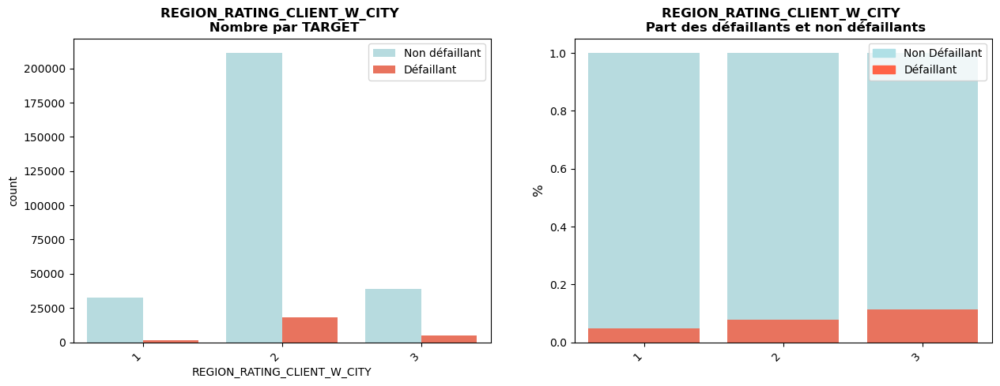

WEEKDAY_APPR_PROCESS_START vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.12436451180273343 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


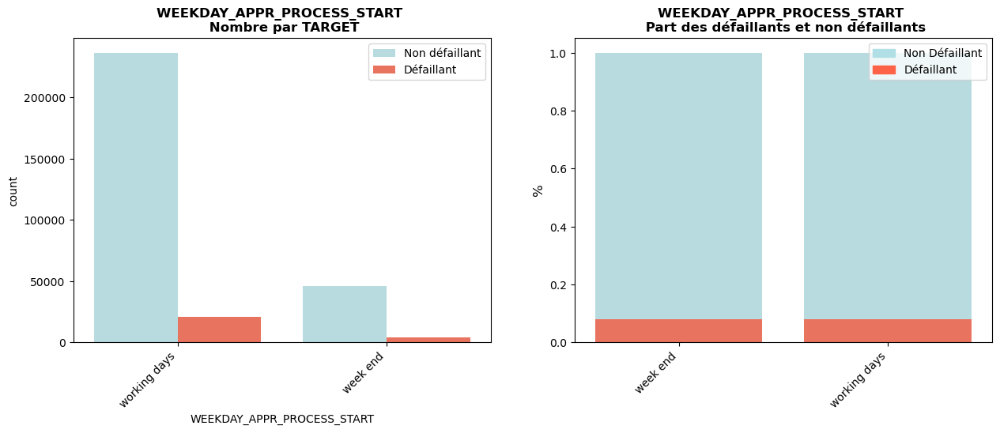

REG_REGION_NOT_LIVE_REGION vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.002180049283931109 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


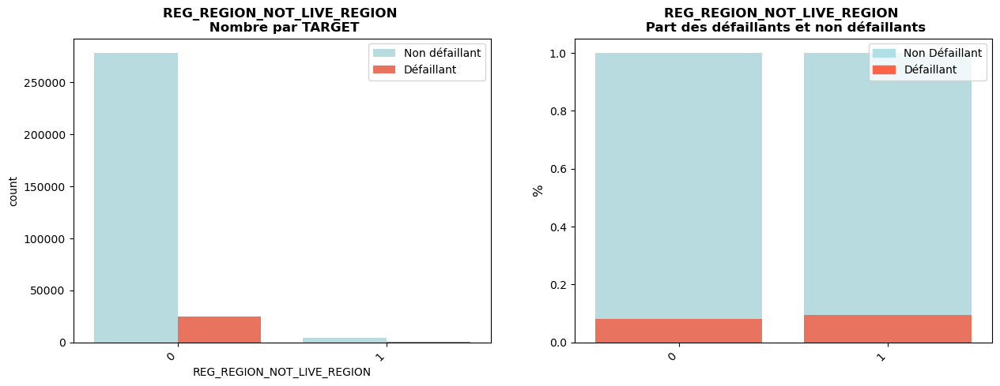

REG_REGION_NOT_WORK_REGION vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0001249309740259711 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


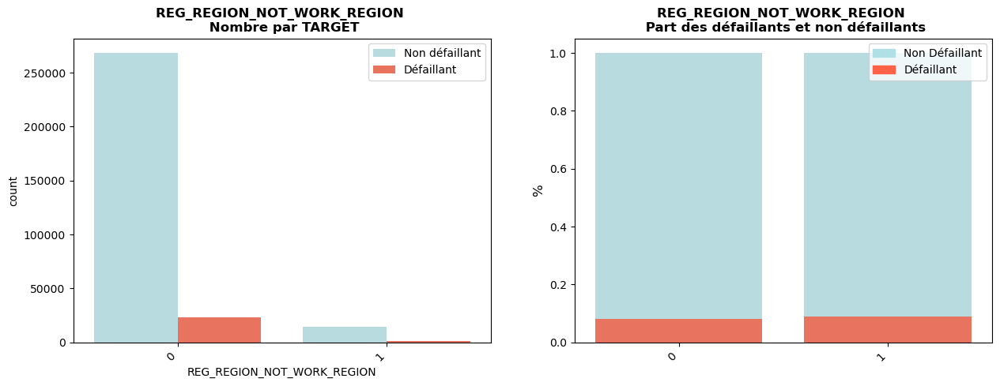

LIVE_REGION_NOT_WORK_REGION vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.12142065580361755 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


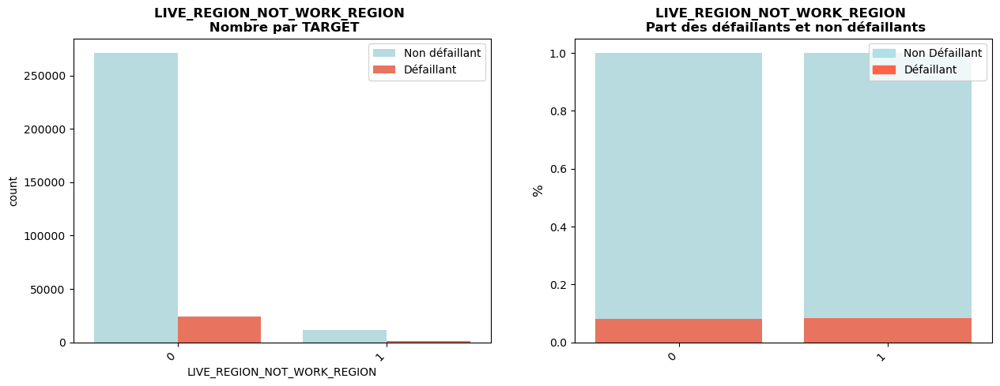

REG_CITY_NOT_LIVE_CITY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.1056659713402193e-133 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


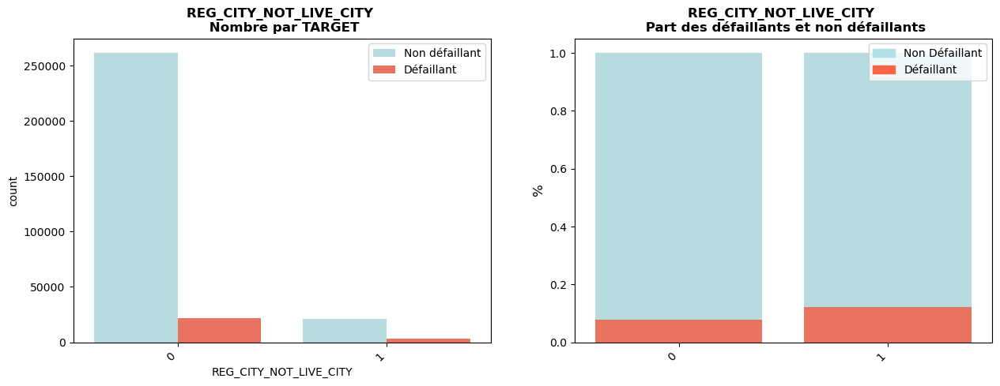

REG_CITY_NOT_WORK_CITY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 8.098458689312927e-176 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


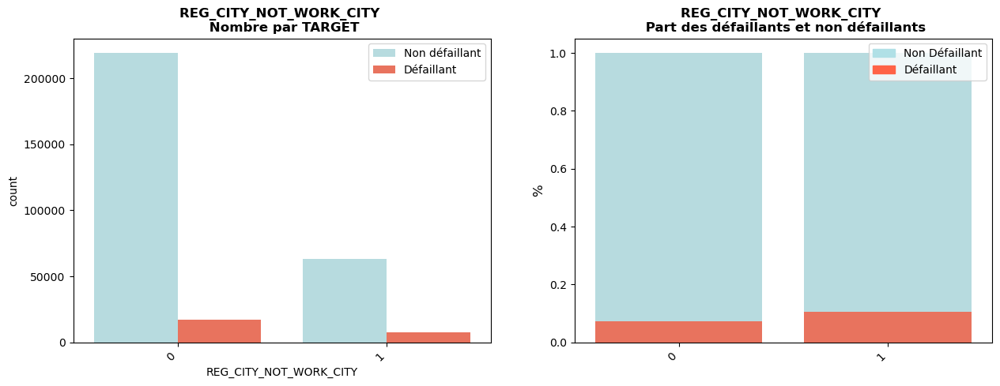

LIVE_CITY_NOT_WORK_CITY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.2652715303860048e-72 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


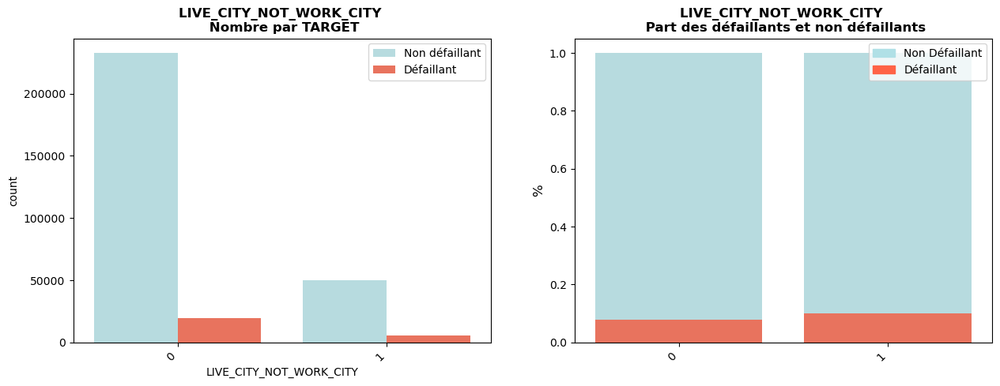

ORGANIZATION_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 4.9427624733785196e-241 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


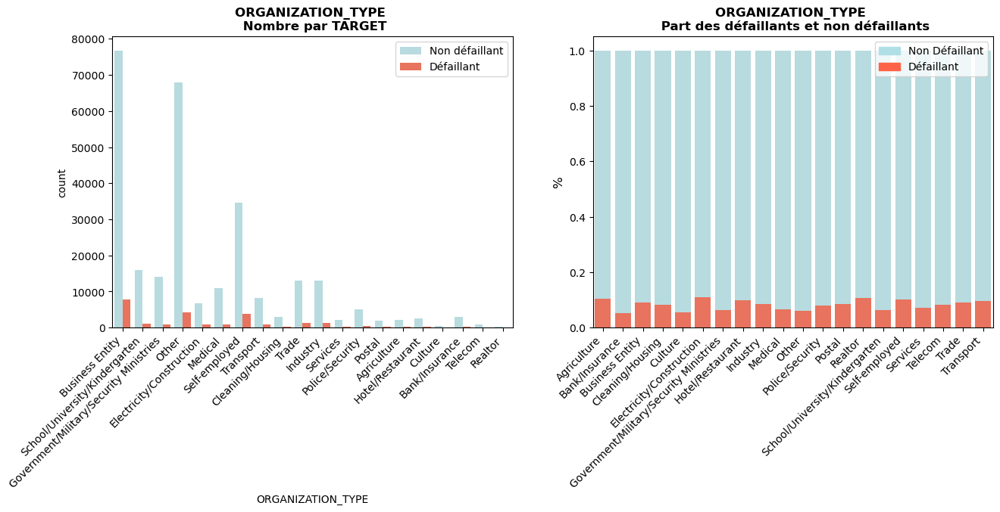

FLAG_DOCUMENT_2 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.01259927482959382 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


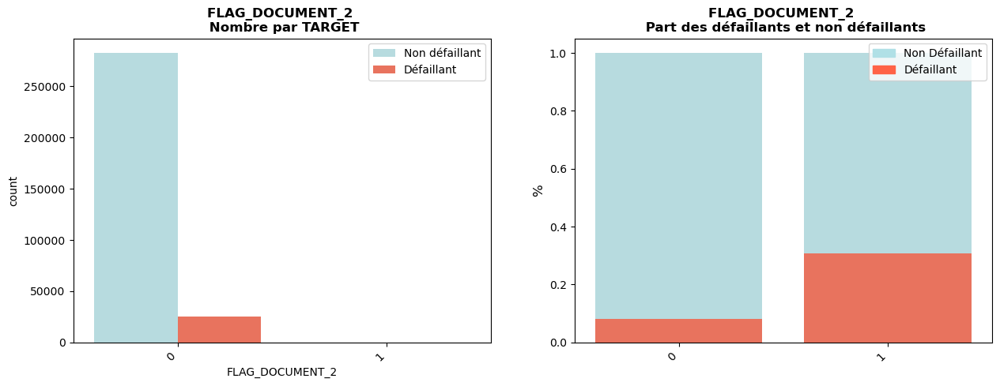

FLAG_DOCUMENT_3 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 2.0808090848972867e-133 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


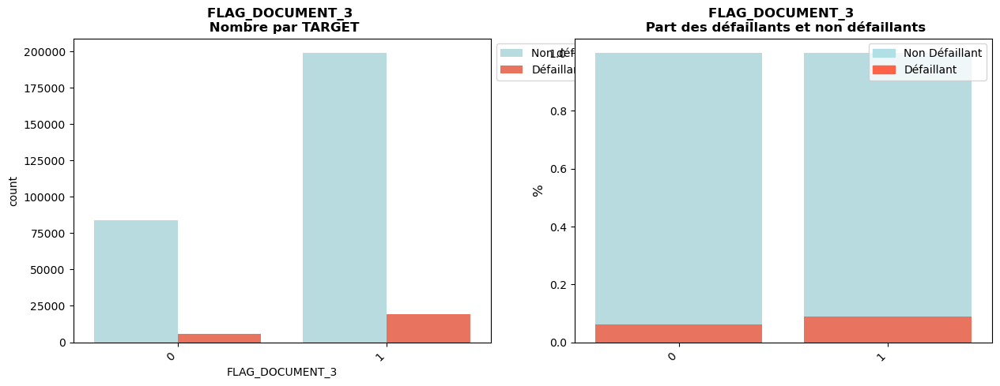

FLAG_DOCUMENT_4 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.2649836519281585 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


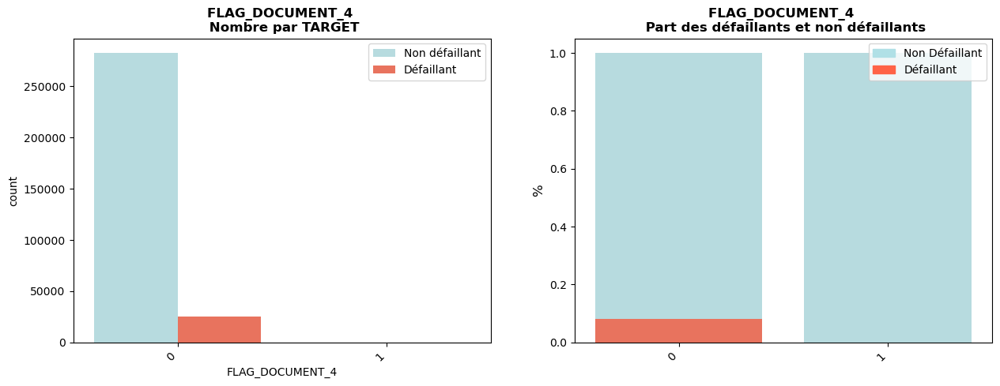

FLAG_DOCUMENT_5 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.8854894189121636 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


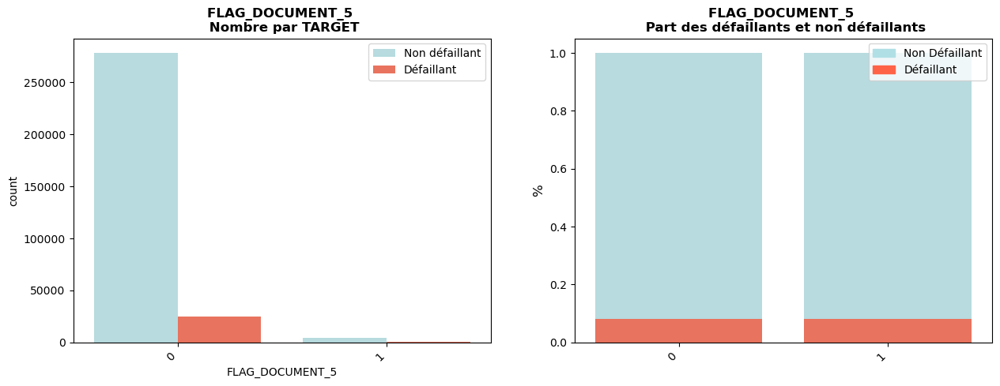

FLAG_DOCUMENT_6 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.4060005161324698e-56 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


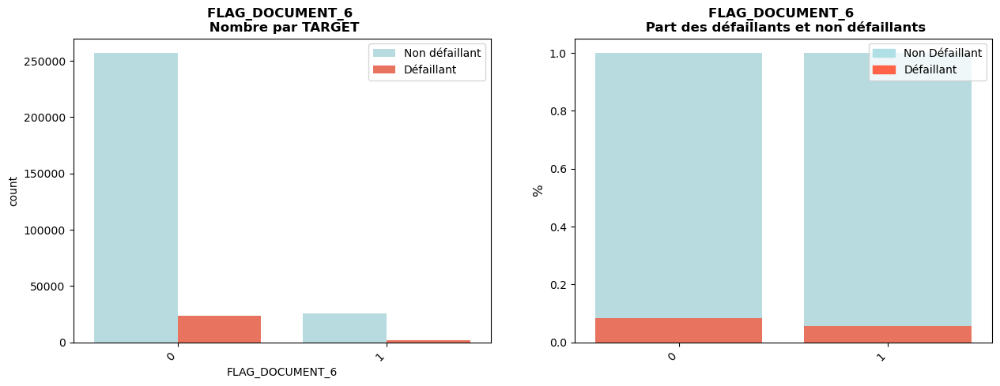

FLAG_DOCUMENT_7 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.5687107138398293 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


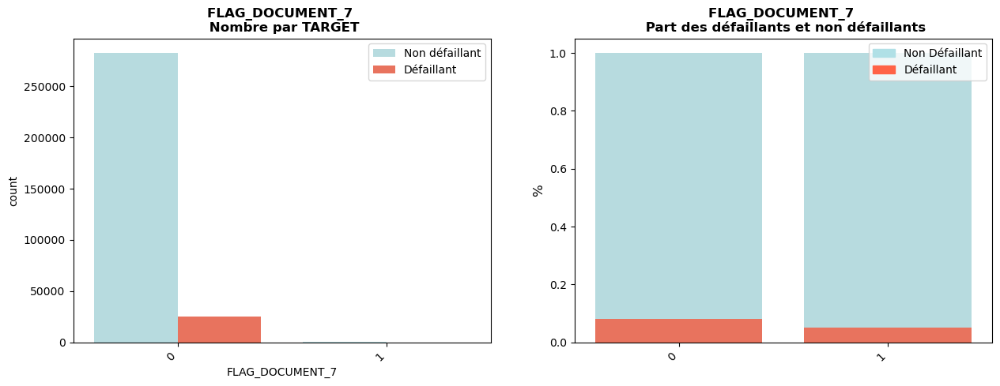

FLAG_DOCUMENT_8 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 8.687480769936474e-06 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


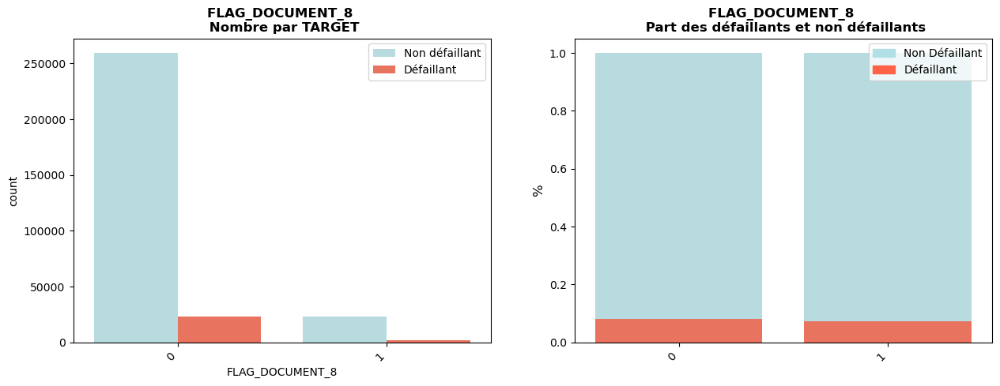

FLAG_DOCUMENT_9 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.018244490129122312 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


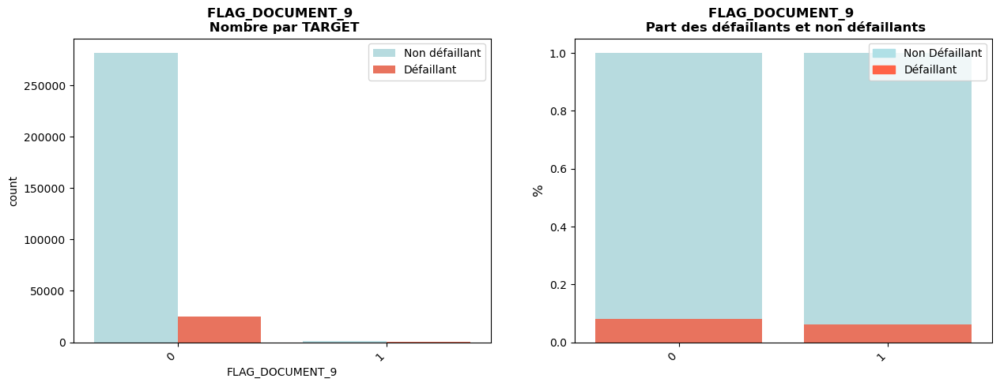

FLAG_DOCUMENT_10 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.9280167091537015 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


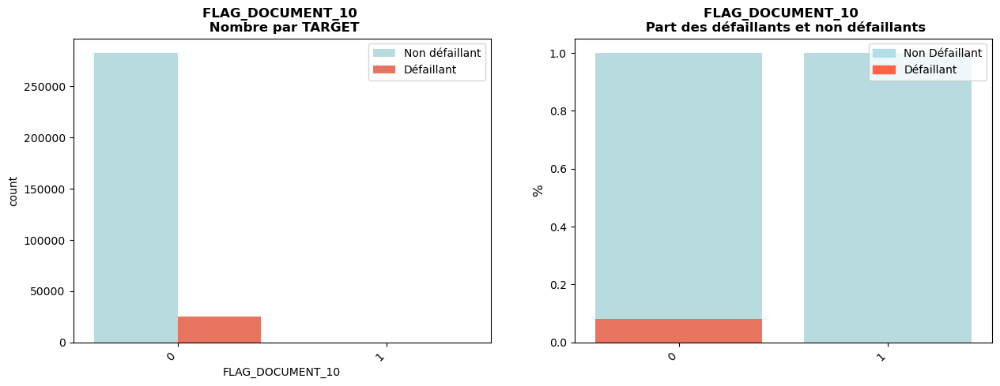

FLAG_DOCUMENT_11 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.021877448018197753 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


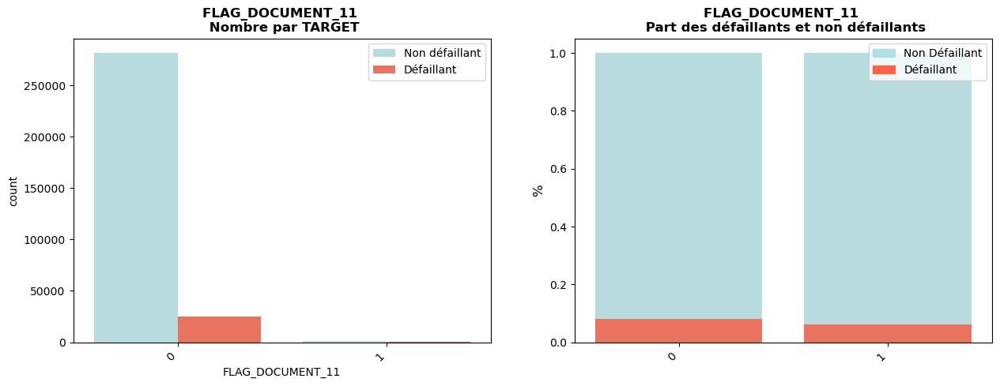

FLAG_DOCUMENT_12 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.37954774313530326 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


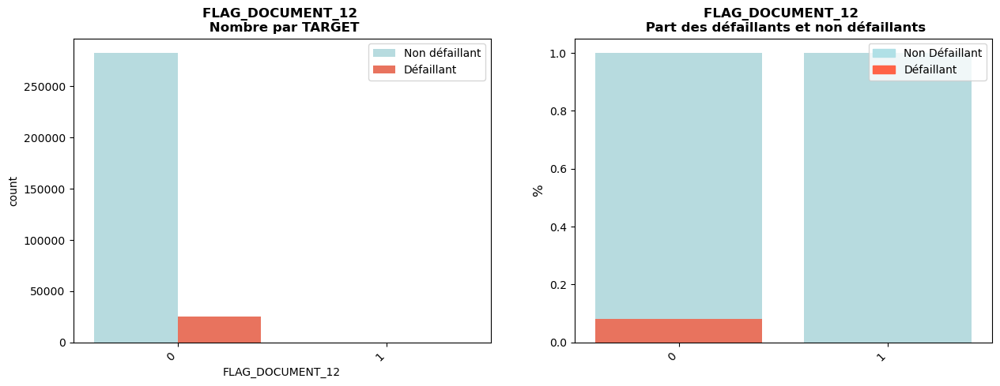

FLAG_DOCUMENT_13 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.919945542069421e-10 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


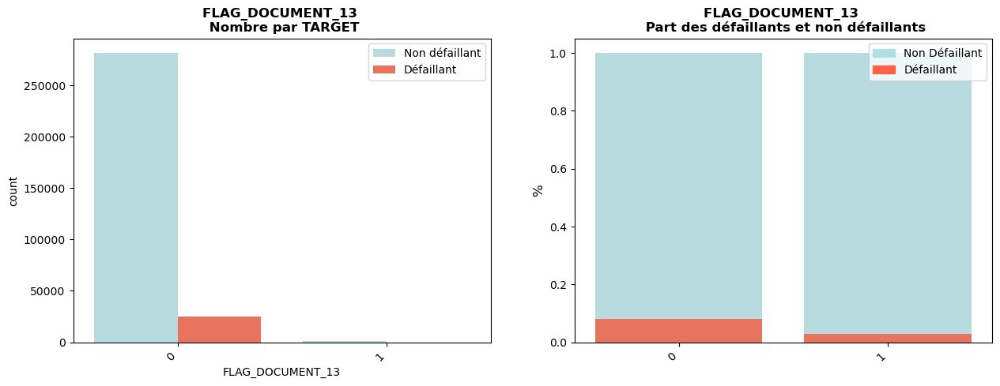

FLAG_DOCUMENT_14 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 2.1371287194183328e-07 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


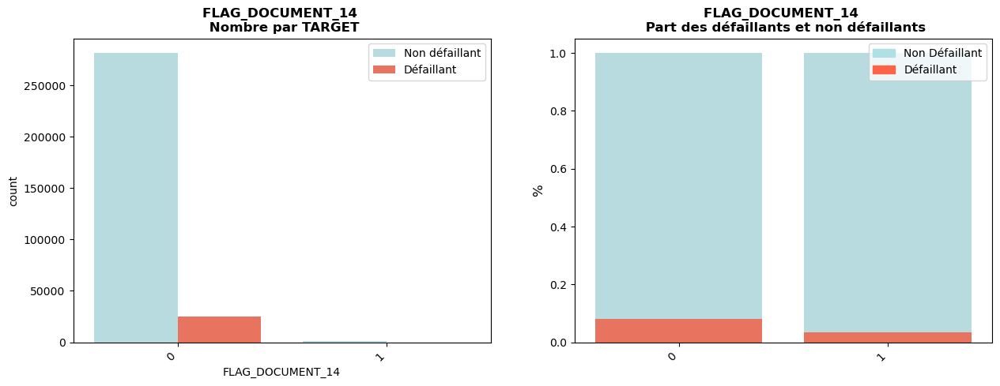

FLAG_DOCUMENT_15 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.000416939074021059 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


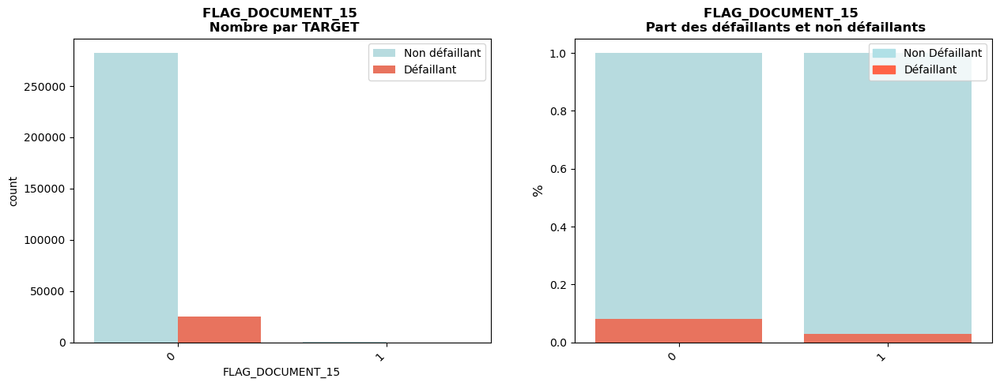

FLAG_DOCUMENT_16 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.4778650441387606e-10 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


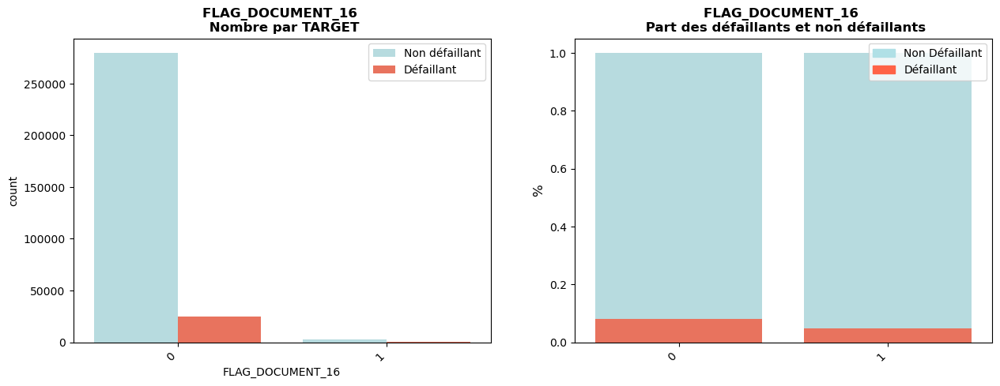

FLAG_DOCUMENT_17 vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.09485820804884244 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


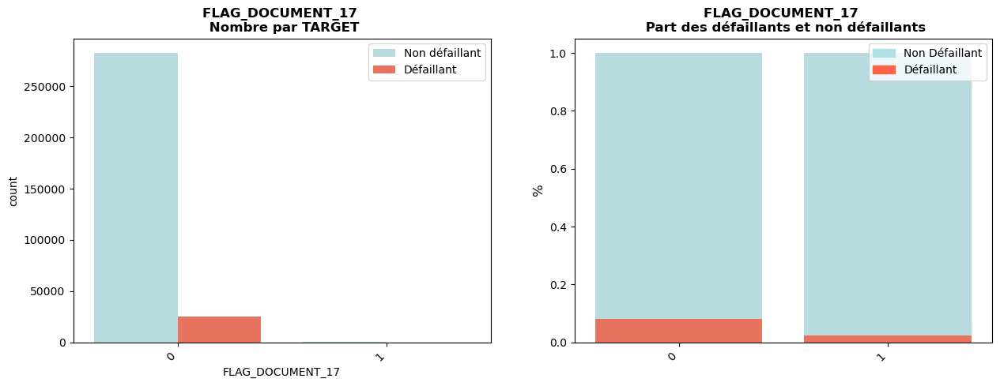

FLAG_DOCUMENT_18 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.2239186289028256e-05 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


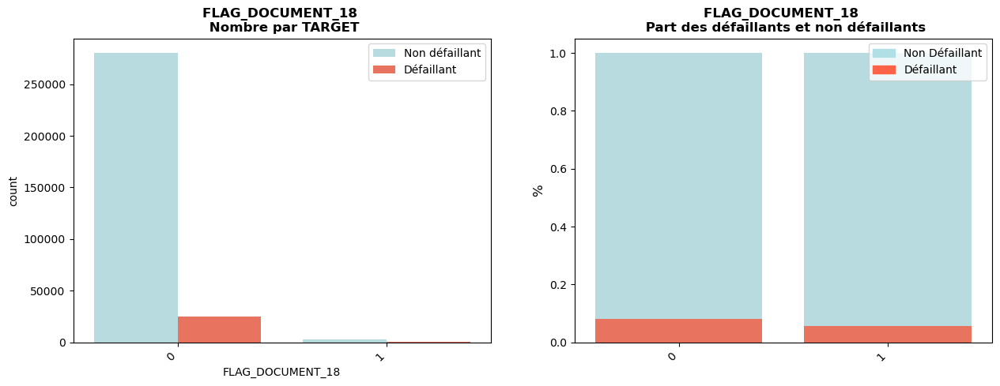

FLAG_DOCUMENT_19 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.5371367814374053 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


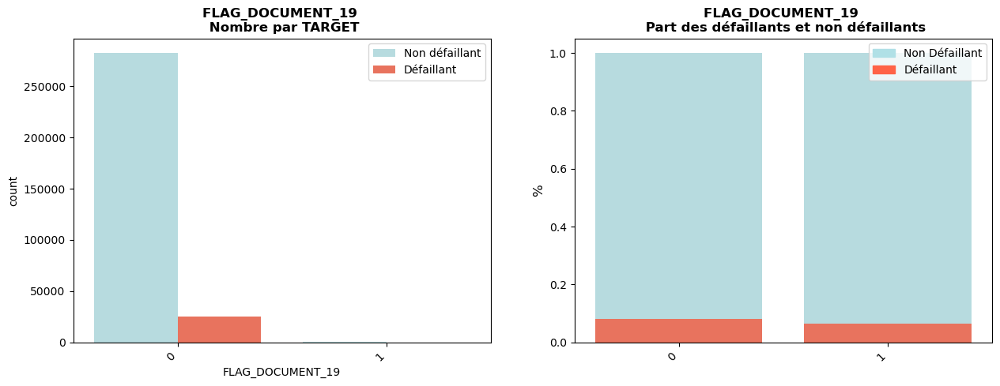

FLAG_DOCUMENT_20 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.0 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


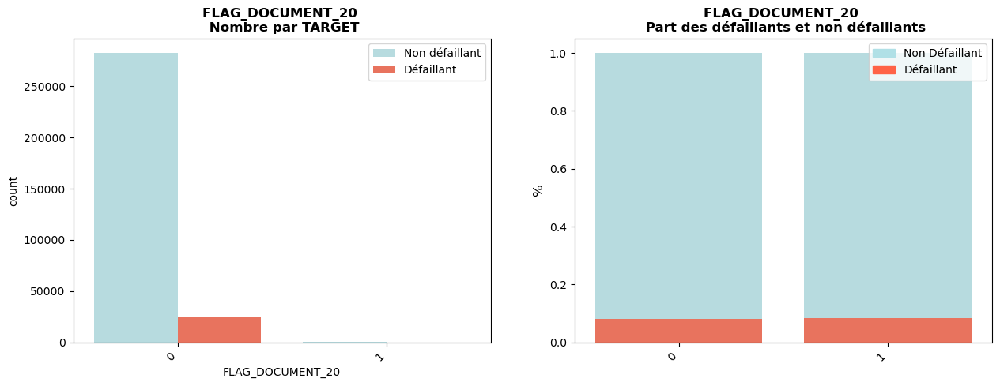

FLAG_DOCUMENT_21 vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0607082304126473 > 0.05 => on accepte H0, les variables sont indépendantes
-------------------------------------------------------------------


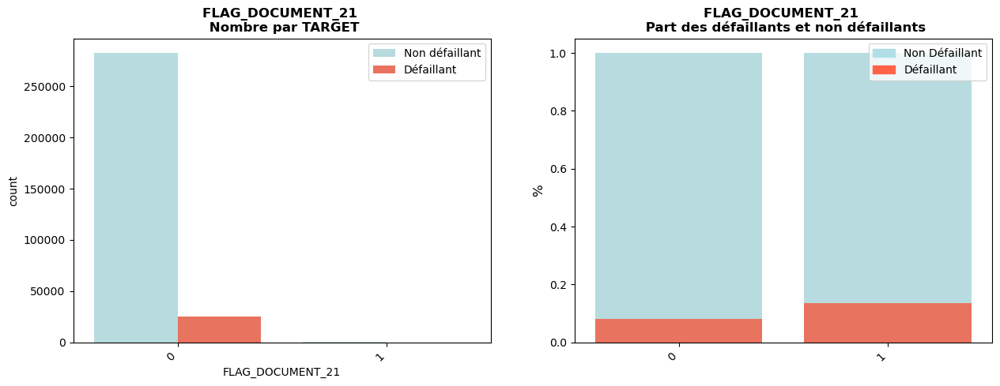

CNT_FAM_MEMBERS_RANGE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.3474754079988368e-24 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


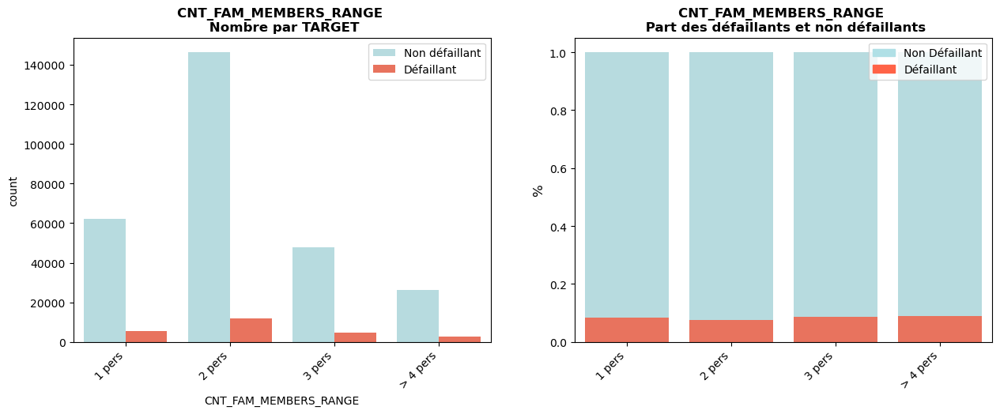

AGE_RANGE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


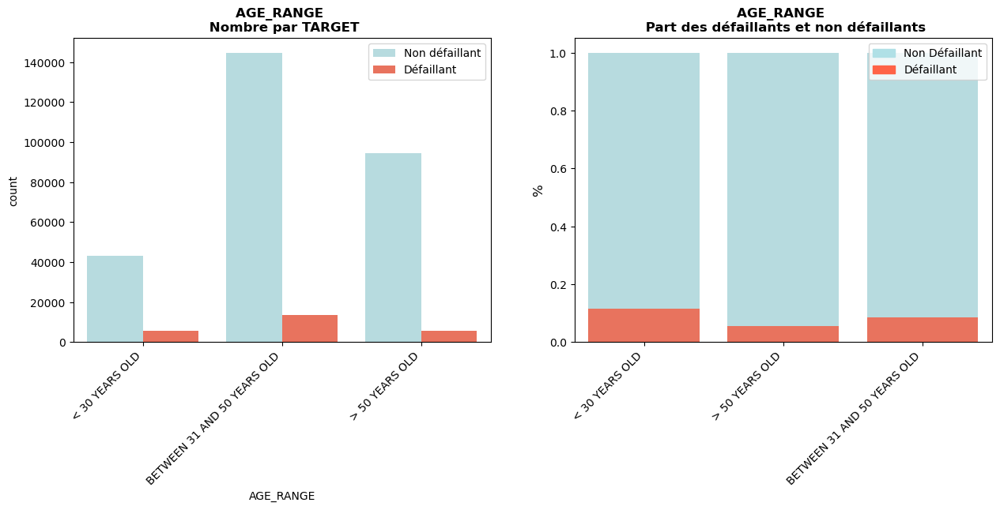

YEARS_EMPLOYED_RANGE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


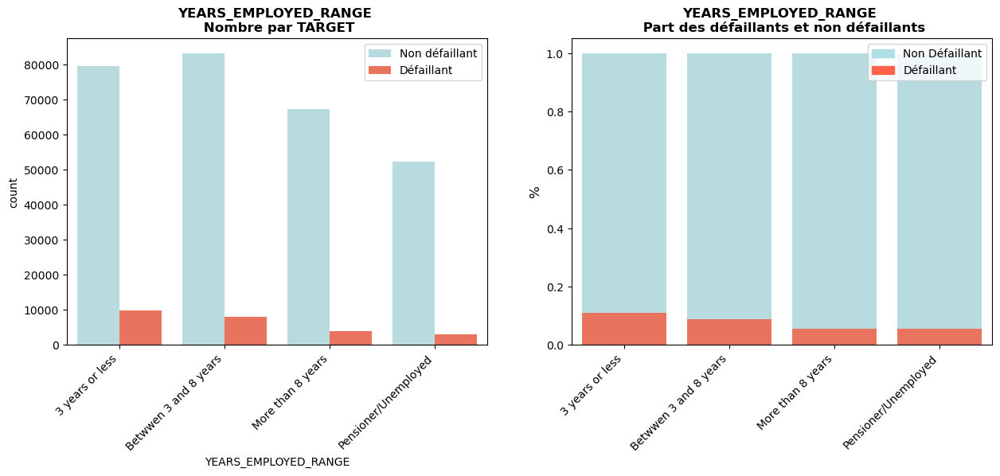

YEARS_REGISTRATION_RANGE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 7.378712912400304e-105 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


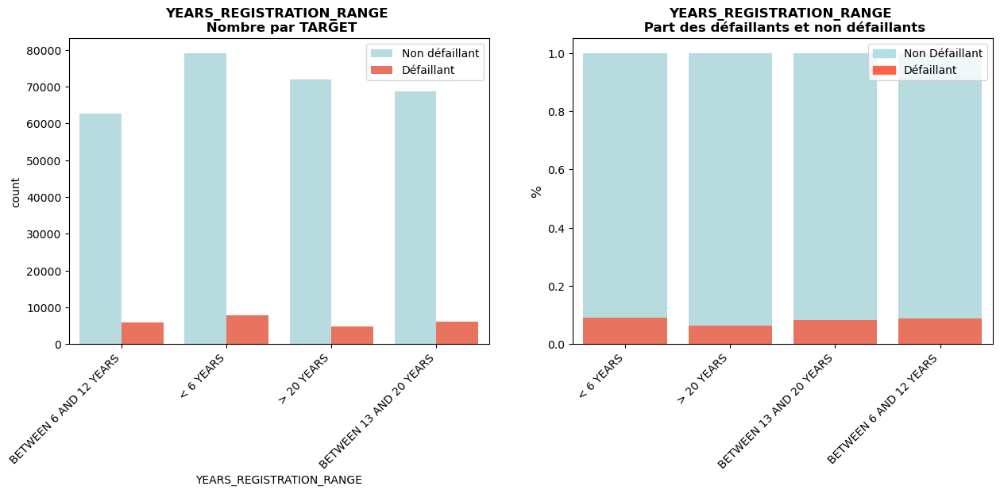

HOUR_APPR_PROCESS_START_RANGE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 8.029766237643896e-41 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


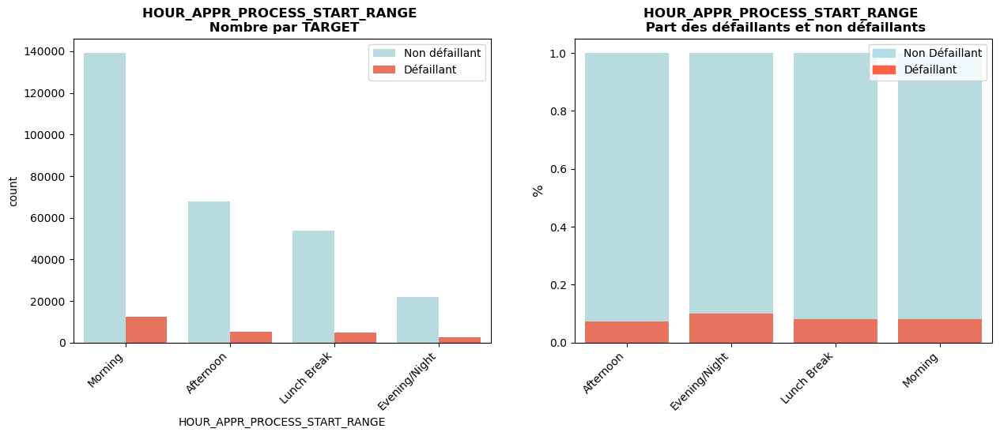

YEARS_ID_PUBLISH_RANGE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 3.7013616797719504e-173 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


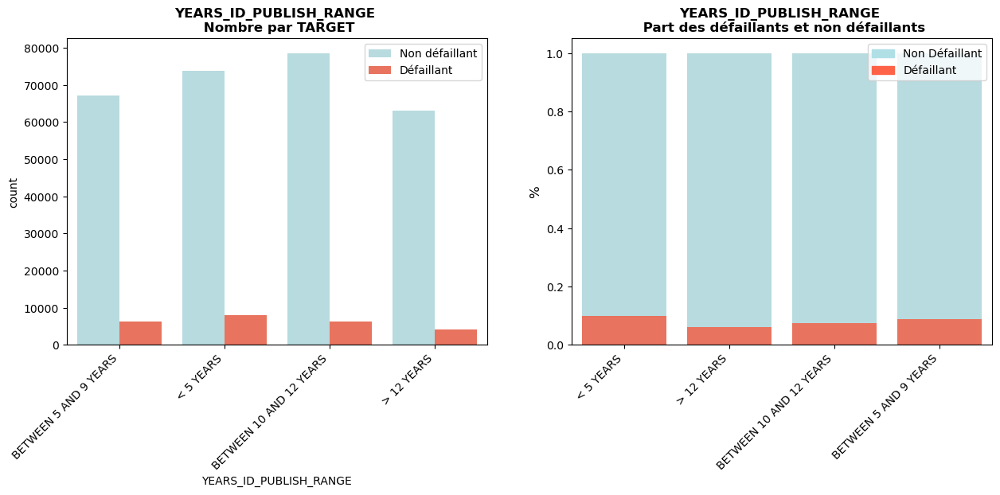

YEARS_LAST_PHONE_CHANGE_RANGE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 7.868888976967641e-203 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


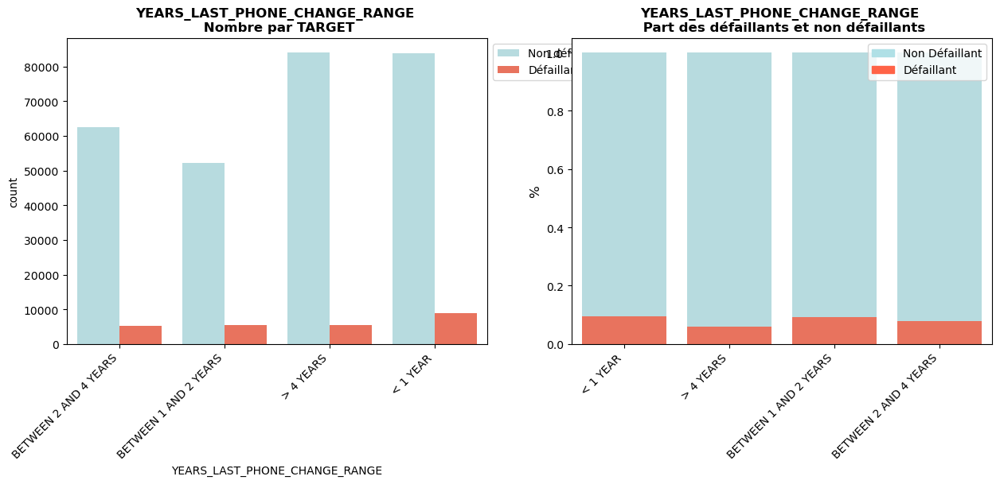

In [78]:
for var in liste_col_quali:
    fct_eda.bivariate_barplots_categ(app_train_desc, var, 'TARGET')

L'association des variables qualitatives avec la target ayant été testée via Chi2, nous ne conserverons pas les variables dépendantes ci-dessous:
- FLAG_MOBIL
- FLAG_CONT_MOBILE
- FLAG_EMAIL
- WEEKDAY_APPR_PROCESS_START
- LIVE_REGION_NOT_WORK_REGION
- FLAG_DOCUMENT_4
- FLAG_DOCUMENT_5
- FLAG_DOCUMENT_7
- FLAG_DOCUMENT_10
- FLAG_DOCUMENT_12
- FLAG_DOCUMENT_17
- FLAG_DOCUMENT_19
- FLAG_DOCUMENT_20
- FLAG_DOCUMENT_21

In [79]:
var_quali_a_suppr = ['FLAG_MOBIL', 'FLAG_CONT_MOBILE', 'FLAG_EMAIL', 'WEEKDAY_APPR_PROCESS_START', 
                     'LIVE_REGION_NOT_WORK_REGION', 'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_7',
                     'FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_12', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_19', 
                     'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21']

In [80]:
var_suppr = var_quanti_a_suppr + var_quali_a_suppr

In [81]:
app_train_desc = app_train_desc.drop(var_suppr, axis=1)

#### Feature engineering

Nous pouvons déduire de nouvelles variables à partir des données existantes dans le dataset. Ce procédé s'appelle le feature engineering. Il s'agit de créer de nouvelles variables qui seront utilisées en apprentissage supervisé. En effet, pour que les algorithmes de Machine Learning fonctionnent bien sur de nouvelles données, il peut être nécessaire de créer et entrainer de nouvelles variables. Voici une sélection de variables qui peuvent être créées grâce à nos données, qui seraient **facilement explicables** aux clients par les chargés de clientèle et qui sont généralement utilisées par les banques pour la décision d'octroi ou non d'un crédit:

- **CREDIT_DURATION** durée du crédit. Plus on s'endette dans la durée, plus la banque prend un risque en prêtant de l’argent.
- **DEBT_RATIO**: taux d'endettement => somme des mensualités de remboursement de crédit versées chaque mois, rapportée aux revenus. Ce taux d’endettement ne doit pas être supérieur à 35%
- **PAYMENT_RATE**: part de l'annuité dans le montant du crédit
- **INCOME_PER_PERSON**: revenu par personne
- **INCOME_CREDIT_PERC**: part du revenu dans le crédit
- **CREDIT_GOODS_PERC**: pourcentage du crédit par rapport au montant du bien acheté

https://www.hellopret.fr/courtier-immobilier/acceptation-credit-immobilier/

In [82]:
app_train_desc['CREDIT_DURATION'] = app_train_desc['AMT_CREDIT'] / app_train_desc['AMT_ANNUITY']
app_train_desc['DEBT_RATIO'] = app_train_desc['AMT_ANNUITY'] / app_train_desc['AMT_INCOME_TOTAL']
app_train_desc['PAYMENT_RATE'] = app_train_desc['AMT_ANNUITY'] / app_train_desc['AMT_CREDIT']
app_train_desc['INCOME_PER_PERSON'] = app_train_desc['AMT_INCOME_TOTAL'] / app_train_desc['CNT_FAM_MEMBERS']
app_train_desc['INCOME_CREDIT_PERC'] = app_train_desc['AMT_INCOME_TOTAL'] / app_train_desc['AMT_CREDIT']
app_train_desc['CREDIT_GOODS_PERC'] = app_train_desc['AMT_CREDIT'] / app_train_desc['AMT_GOODS_PRICE']

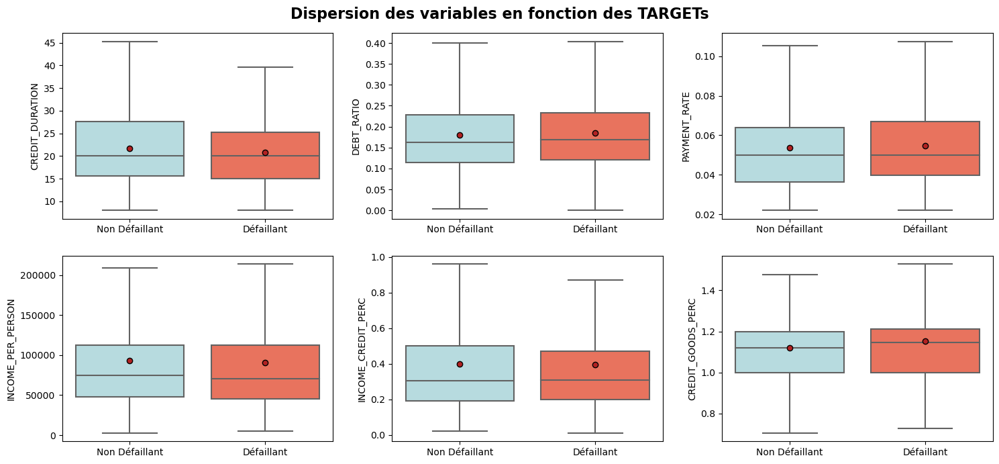

In [83]:
new_list_var_quanti = ['CREDIT_DURATION', 'DEBT_RATIO', 'PAYMENT_RATE', 
                       'INCOME_PER_PERSON', 'INCOME_CREDIT_PERC', 'CREDIT_GOODS_PERC']

fig = plt.figure(figsize=(15,7))
fct_eda.bivariate_plots_box(app_train_desc, 'TARGET', new_list_var_quanti, 2, 3, fig)

<div class="alert alert-block alert-warning">
    <p>UPDATE</p>
</div>

Ces nouvelles variables sont plus intéressantes que les variables initiales qui ne représentaient pas vraiment de tendance. Ici, les écarts entre non défaillants et défaillants sont plus significatifs. Les variables métiers sur la durée du crédit, le taux d'endettement et le revenu par personne vont être discrétisées en fonction des règles métier.

In [84]:
app_train_desc[['CREDIT_DURATION', 'DEBT_RATIO', 'PAYMENT_RATE', 'INCOME_PER_PERSON',
                'INCOME_CREDIT_PERC', 'CREDIT_GOODS_PERC']].describe().T

,count,mean,std,min,25%,50%,75%,max
CREDIT_DURATION,307505.00,21.61,7.82,8.04,15.61,20.00,27.10,45.31
DEBT_RATIO,307505.00,0.18,0.09,0.00,0.11,0.16,0.23,1.88
PAYMENT_RATE,307505.00,0.05,0.02,0.02,0.04,0.05,0.06,0.12
INCOME_PER_PERSON,307505.00,93106.08,101373.92,2812.50,47250.00,75000.00,112500.00,39000000.00
INCOME_CREDIT_PERC,307505.00,0.40,0.51,0.01,0.19,0.31,0.50,208.00
CREDIT_GOODS_PERC,307505.00,1.12,0.12,0.15,1.00,1.12,1.20,6.00


- Critère 1 : La **durée du prêt** (CREDIT_DURATION)

Plus le client s'endette dans la durée plus la banque prend un risque. De plus, s'endetter sur le long terme est plus onéreux (taux d'intérêt plus importants).

In [85]:
# Durée du crédit
app_train_desc.loc[app_train_desc['CREDIT_DURATION'] < 15,'CREDIT_DURATION_RANGE'] = 'SHORT < 15 Years'

app_train_desc.loc[(app_train_desc['CREDIT_DURATION'] >= 15) & (app_train_desc['CREDIT_DURATION'] <= 20),
                   'CREDIT_DURATION_RANGE'] = 'MEDIUM BETWEEN 15 & 20 Years'

app_train_desc.loc[app_train_desc['CREDIT_DURATION'] > 20, 'CREDIT_DURATION_RANGE'] = 'LONG > 20 Years'

In [86]:
app_train_desc['CREDIT_DURATION_RANGE'].value_counts()

LONG > 20 Years                 150393
MEDIUM BETWEEN 15 & 20 Years     86642
SHORT < 15 Years                 70470
Name: CREDIT_DURATION_RANGE, dtype: int64

- Critère 2 : Le **taux d'endettement** (DEBT_RATIO)

Il faut un taux d'endettement inférieur à 35%. Il correspond à la part de revenu consacré au remboursement du prêt.
Le salaire doit être 3 fois supérieur à la mensualité de l'emprunt. Nous remarquons qu'en moyenne il est largement inférieur aux 35% demandés.

In [87]:
# Taux d'endettement
app_train_desc.loc[app_train_desc['DEBT_RATIO'] < 0.15,'DEBT_RATIO_RANGE'] = 'VERY LOW < 15'

app_train_desc.loc[(app_train_desc['DEBT_RATIO'] >= 0.15) & (app_train_desc['DEBT_RATIO'] <= 0.20),
                   'DEBT_RATIO_RANGE'] = 'LOW BETWEEN 15 & 20'

app_train_desc.loc[(app_train_desc['DEBT_RATIO'] > 0.20) & (app_train_desc['DEBT_RATIO'] <= 0.35),
                   'DEBT_RATIO_RANGE'] = 'MEDIUM BETWEEN 21 & 35'

app_train_desc.loc[app_train_desc['DEBT_RATIO'] > 0.35, 'DEBT_RATIO_RANGE'] = 'VERY HIGH > 35%'

In [88]:
app_train_desc['DEBT_RATIO_RANGE'].value_counts()

VERY LOW < 15             132459
MEDIUM BETWEEN 21 & 35     88553
LOW BETWEEN 15 & 20        69986
VERY HIGH > 35%            16507
Name: DEBT_RATIO_RANGE, dtype: int64

- Critère 3 : Les **revenus** (INCOME_PER_PERSON)

Un client ayant de hauts revenus peut se voir accorder un taux d'endettement plus important.

In [89]:
# Revenus par personne
app_train_desc.loc[app_train_desc['INCOME_PER_PERSON'] < 45000,'INCOME_PER_PERSON_RANGE'] = 'LOW < 45K'

app_train_desc.loc[(app_train_desc['INCOME_PER_PERSON'] >= 45000) & (app_train_desc['INCOME_PER_PERSON'] <= 75000),
                   'INCOME_PER_PERSON_RANGE'] = 'MEDIUM BETWEEN 45K & 75K'


app_train_desc.loc[app_train_desc['INCOME_PER_PERSON'] > 75000, 'INCOME_PER_PERSON_RANGE'] = 'HIGH > 75K'

In [90]:
app_train_desc['INCOME_PER_PERSON_RANGE'].value_counts()

HIGH > 75K                  152217
MEDIUM BETWEEN 45K & 75K     99925
LOW < 45K                    55363
Name: INCOME_PER_PERSON_RANGE, dtype: int64

In [91]:
app_train_desc.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_11,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_18,CNT_FAM_MEMBERS_RANGE,AGE,AGE_RANGE,YEARS_EMPLOYED,YEARS_EMPLOYED_RANGE,YEARS_REGISTRATION,YEARS_REGISTRATION_RANGE,HOUR_APPR_PROCESS_START_RANGE,YEARS_ID_PUBLISH,YEARS_ID_PUBLISH_RANGE,YEARS_LAST_PHONE_CHANGE,YEARS_LAST_PHONE_CHANGE_RANGE,CREDIT_DURATION,DEBT_RATIO,PAYMENT_RATE,INCOME_PER_PERSON,INCOME_CREDIT_PERC,CREDIT_GOODS_PERC,CREDIT_DURATION_RANGE,DEBT_RATIO_RANGE,INCOME_PER_PERSON_RANGE
0,100002,1,Cash loans,M,N,Y,No child,202500.00,406597.50,24700.50,351000.00,Unaccompanied,Private worker,Lower Secondary & Secondary,Not Married,Owner,0.02,1,0,1,1.00,2,2,10,0,0,0,0,0,Business Entity,0.26,2.00,2.00,0,1,0,0,0,0,0,0,0,0,0,1 pers,26.00,< 30 YEARS OLD,1.75,3 years or less,10.00,BETWEEN 6 AND 12 YEARS,Morning,5.81,BETWEEN 5 AND 9 YEARS,3.11,BETWEEN 2 AND 4 YEARS,16.46,0.12,0.06,202500.00,0.50,1.16,MEDIUM BETWEEN 15 & 20 Years,VERY LOW < 15,HIGH > 75K
1,100003,0,Cash loans,F,N,N,No child,270000.00,1293502.50,35698.50,1129500.00,Family,Public worker,Higher education,Married,Owner,0.00,1,0,1,2.00,1,1,11,0,0,0,0,0,School/University/Kindergarten,0.62,1.00,0.00,0,1,0,0,0,0,0,0,0,0,0,2 pers,46.00,BETWEEN 31 AND 50 YEARS OLD,3.25,Betwwen 3 and 8 years,3.00,< 6 YEARS,Morning,0.80,< 5 YEARS,2.27,BETWEEN 2 AND 4 YEARS,36.23,0.13,0.03,135000.00,0.21,1.15,LONG > 20 Years,VERY LOW < 15,HIGH > 75K
2,100004,0,Revolving loans,M,Y,Y,No child,67500.00,135000.00,6750.00,135000.00,Unaccompanied,Private worker,Lower Secondary & Secondary,Not Married,Owner,0.01,1,1,1,1.00,2,2,9,0,0,0,0,0,Government/Military/Security Ministries,0.56,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,1 pers,52.00,> 50 YEARS OLD,0.62,3 years or less,12.00,BETWEEN 6 AND 12 YEARS,Morning,6.93,BETWEEN 5 AND 9 YEARS,2.23,BETWEEN 2 AND 4 YEARS,20.00,0.10,0.05,67500.00,0.50,1.00,MEDIUM BETWEEN 15 & 20 Years,VERY LOW < 15,MEDIUM BETWEEN 45K & 75K
3,100006,0,Cash loans,F,N,Y,No child,135000.00,312682.50,29686.50,297000.00,Unaccompanied,Private worker,Lower Secondary & Secondary,Married,Owner,0.01,1,0,0,2.00,2,2,17,0,0,0,0,0,Business Entity,0.65,2.00,0.00,0,1,0,0,0,0,0,0,0,0,0,2 pers,52.00,> 50 YEARS OLD,8.33,More than 8 years,27.00,> 20 YEARS,Afternoon,6.68,BETWEEN 5 AND 9 YEARS,1.69,BETWEEN 1 AND 2 YEARS,10.53,0.22,0.09,67500.00,0.43,1.05,SHORT < 15 Years,MEDIUM BETWEEN 21 & 35,MEDIUM BETWEEN 45K & 75K
4,100007,0,Cash loans,M,N,Y,No child,121500.00,513000.00,21865.50,513000.00,Unaccompanied,Private worker,Lower Secondary & Secondary,Not Married,Owner,0.03,1,0,0,1.00,2,2,11,0,0,0,1,1,Other,0.32,0.00,0.00,0,0,0,1,0,0,0,0,0,0,0,1 pers,55.00,> 50 YEARS OLD,8.32,More than 8 years,12.00,BETWEEN 6 AND 12 YEARS,Morning,9.47,BETWEEN 10 AND 12 YEARS,3.03,BETWEEN 2 AND 4 YEARS,23.46,0.18,0.04,121500.00,0.24,1.00,LONG > 20 Years,LOW BETWEEN 15 & 20,HIGH > 75K


In [92]:
app_train_desc.isna().sum().sort_values(ascending = False)

SK_ID_CURR                       0
FLAG_DOCUMENT_2                  0
FLAG_DOCUMENT_6                  0
FLAG_DOCUMENT_8                  0
FLAG_DOCUMENT_9                  0
FLAG_DOCUMENT_11                 0
FLAG_DOCUMENT_13                 0
FLAG_DOCUMENT_14                 0
FLAG_DOCUMENT_15                 0
FLAG_DOCUMENT_16                 0
FLAG_DOCUMENT_18                 0
CNT_FAM_MEMBERS_RANGE            0
AGE                              0
AGE_RANGE                        0
YEARS_EMPLOYED                   0
YEARS_EMPLOYED_RANGE             0
YEARS_REGISTRATION               0
YEARS_REGISTRATION_RANGE         0
HOUR_APPR_PROCESS_START_RANGE    0
YEARS_ID_PUBLISH                 0
YEARS_ID_PUBLISH_RANGE           0
YEARS_LAST_PHONE_CHANGE          0
YEARS_LAST_PHONE_CHANGE_RANGE    0
CREDIT_DURATION                  0
DEBT_RATIO                       0
PAYMENT_RATE                     0
INCOME_PER_PERSON                0
INCOME_CREDIT_PERC               0
CREDIT_GOODS_PERC   

In [93]:
app_train_desc = app_train_desc.set_index('SK_ID_CURR')
app_train_desc.shape

(307505, 64)

#### Fonction de preprocessing

In [94]:
def preprocess_app_train():
    '''Fonction de preprocessing du dataset application_train:
    traitement des données manquantes, traitement des outliers et des modalités,
    feature engineering
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    # Chargement du dataset
    app_train = pd.read_csv('data/application_train.csv',
                            sep=',',
                            encoding='utf-8')


    # Traitement des données manquantes
        
    ## Suppression des variables avec 30% ou plus de NaN
    app_train = fct_eda.tx_rempl_min(app_train, 70)
        
    ## iterative imputer pour les variables corrélées entre-elles
    app_train['OBS_30_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
        app_train[['OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']])[:,0]
    app_train['OBS_60_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
        app_train[['OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE']])[:,1]
    app_train['AMT_GOODS_PRICE'] = fct_eda.iterative_imputer_function(
        app_train[['AMT_GOODS_PRICE', 'AMT_CREDIT']])[:,0]
    app_train['CNT_FAM_MEMBERS'] = fct_eda.iterative_imputer_function(
        app_train[['CNT_FAM_MEMBERS', 'CNT_CHILDREN']])[:,0]
    app_train['DEF_60_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
        app_train[['DEF_60_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE']])[:,0]
    app_train['DEF_30_CNT_SOCIAL_CIRCLE'] = fct_eda.iterative_imputer_function(
        app_train[['DEF_60_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE']])[:,1]
    app_train['AMT_GOODS_PRICE'] = fct_eda.iterative_imputer_function(
        app_train[['AMT_GOODS_PRICE', 'AMT_ANNUITY']])[:,0]
    app_train['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
        app_train[['AMT_GOODS_PRICE', 'AMT_ANNUITY']])[:,1]
    app_train['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
        app_train[['AMT_CREDIT', 'AMT_ANNUITY']])[:,1]
        
    ## Médiane et mode pour variables avec taux de NaN > 80% (hors variable TARGET)
    df_nan = fct_eda.nan_a_retraiter(app_train)
    col_med = df_nan[(df_nan['Tx_rempl']>80) & 
                     (df_nan['dtypes'] == 'float64') &
                     (~ df_nan.index.str.contains('TARGET'))].index.tolist()
    for col in col_med:
        app_train[col] = app_train[col].fillna(app_train[col].median())
    del app_train['AMT_REQ_CREDIT_BUREAU_YEAR']
    del app_train['EXT_SOURCE_3']
    app_train['NAME_TYPE_SUITE'] = app_train['NAME_TYPE_SUITE'].fillna(app_train['NAME_TYPE_SUITE'].mode()[0])

    
    # Traitements var quanti
    
    ## Nombre d'enfants
    app_train.loc[app_train['CNT_CHILDREN'] == 0, 'CNT_CHILDREN'] = 'No child'
    app_train.loc[app_train['CNT_CHILDREN'] == 1, 'CNT_CHILDREN'] = 'One child'
    app_train.loc[app_train['CNT_CHILDREN'] == 2, 'CNT_CHILDREN'] = 'Two children'
    app_train['CNT_CHILDREN'] = np.where(~app_train['CNT_CHILDREN'].isin(['No child',
                                                                          'One child',
                                                                          'Two children']),
                                         '> Three children',
                                         app_train['CNT_CHILDREN'])
    
    ## Nombre de membres dans la famille
    app_train = app_train[~((app_train['CNT_FAM_MEMBERS'] < 2) & (app_train['CNT_FAM_MEMBERS'] > 1))]
    app_train.loc[app_train['CNT_FAM_MEMBERS'] == 1, 'CNT_FAM_MEMBERS_RANGE'] = '1 pers'
    app_train.loc[app_train['CNT_FAM_MEMBERS'] == 2, 'CNT_FAM_MEMBERS_RANGE'] = '2 pers'
    app_train.loc[app_train['CNT_FAM_MEMBERS'] == 3, 'CNT_FAM_MEMBERS_RANGE'] = '3 pers'
    app_train['CNT_FAM_MEMBERS_RANGE'] = np.where(~app_train['CNT_FAM_MEMBERS_RANGE'].isin(['1 pers',
                                                                                            '2 pers',
                                                                                            '3 pers']),
                                                  '> 4 pers',
                                                  app_train['CNT_FAM_MEMBERS_RANGE'])

    ## Age du client
    app_train['AGE'] = round(app_train['DAYS_BIRTH'] / 365 * -1, 0)
    del app_train['DAYS_BIRTH']
    app_train.loc[app_train['AGE'] <= 30, 'AGE_RANGE'] = '< 30 YEARS OLD'
    app_train.loc[(app_train['AGE'] > 30) & (app_train['AGE'] <= 50),
                  'AGE_RANGE'] = 'BETWEEN 31 AND 50 YEARS OLD'
    app_train.loc[app_train['AGE'] > 50, 'AGE_RANGE'] = '> 50 YEARS OLD'

    ## Ancienneté du client à son poste actuel
    app_train['YEARS_EMPLOYED'] = round(app_train['DAYS_EMPLOYED'] / 365 * -1, 2)
    del app_train['DAYS_EMPLOYED']
            # On affecte la valeur -1 aux retraités et sans emploi
    app_train.loc[app_train['YEARS_EMPLOYED'] == -1000.67, 'YEARS_EMPLOYED'] = -1
            # Discrétisation
    app_train.loc[app_train['YEARS_EMPLOYED'] <= 0, 'YEARS_EMPLOYED_RANGE'] = 'Pensioner/Unemployed'
    app_train.loc[(app_train['YEARS_EMPLOYED'] > 0) & (app_train['YEARS_EMPLOYED'] <= 3),
                   'YEARS_EMPLOYED_RANGE'] = '3 years or less'
    app_train.loc[(app_train['YEARS_EMPLOYED'] > 3) & (app_train['YEARS_EMPLOYED'] <= 8),
                   'YEARS_EMPLOYED_RANGE'] = 'Betwwen 3 and 8 years'
    app_train.loc[app_train['YEARS_EMPLOYED'] > 8, 'YEARS_EMPLOYED_RANGE'] = 'More than 8 years'


    ## Nb années avant la demande où le client a modifié son enregistrement
    app_train['YEARS_REGISTRATION'] = round(app_train['DAYS_REGISTRATION'] / 365 * -1, 0)
    del app_train['DAYS_REGISTRATION']
    app_train.loc[app_train['YEARS_REGISTRATION'] <= 6, 'YEARS_REGISTRATION_RANGE'] = '< 6 YEARS'

    app_train.loc[(app_train['YEARS_REGISTRATION'] > 6) & (app_train['YEARS_REGISTRATION'] <= 12),
                  'YEARS_REGISTRATION_RANGE'] = 'BETWEEN 6 AND 12 YEARS'

    app_train.loc[(app_train['YEARS_REGISTRATION'] > 12) & (app_train['YEARS_REGISTRATION'] <= 20),
                  'YEARS_REGISTRATION_RANGE'] = 'BETWEEN 13 AND 20 YEARS'

    app_train.loc[app_train['YEARS_REGISTRATION'] > 20, 'YEARS_REGISTRATION_RANGE'] = '> 20 YEARS'
    

    ## Heure où le client a demandé son prêt
    app_train.loc[app_train['HOUR_APPR_PROCESS_START'] < 8,'HOUR_APPR_PROCESS_START_RANGE'] = 'Evening/Night'
    app_train.loc[(app_train['HOUR_APPR_PROCESS_START'] >= 8) & (app_train['HOUR_APPR_PROCESS_START'] <= 12),
                  'HOUR_APPR_PROCESS_START_RANGE'] = 'Morning'
    app_train.loc[(app_train['HOUR_APPR_PROCESS_START'] > 12) & (app_train['HOUR_APPR_PROCESS_START'] <= 14),
                   'HOUR_APPR_PROCESS_START_RANGE'] = 'Lunch Break'
    app_train.loc[(app_train['HOUR_APPR_PROCESS_START'] > 14) & (app_train['HOUR_APPR_PROCESS_START'] <= 19),
                   'HOUR_APPR_PROCESS_START_RANGE'] = 'Afternoon'
    app_train.loc[app_train['HOUR_APPR_PROCESS_START'] > 19, 'HOUR_APPR_PROCESS_START_RANGE'] = 'Evening/Night'

    ## Nb années avant la demande où le client a changé son document d'identité
    app_train['YEARS_ID_PUBLISH'] = round(app_train['DAYS_ID_PUBLISH'] / 365 * -1, 2)
    del app_train['DAYS_ID_PUBLISH']
    app_train.loc[app_train['YEARS_ID_PUBLISH'] <= 5, 'YEARS_ID_PUBLISH_RANGE'] = '< 5 YEARS'

    app_train.loc[(app_train['YEARS_ID_PUBLISH'] > 5) & (app_train['YEARS_ID_PUBLISH'] <= 9),
                  'YEARS_ID_PUBLISH_RANGE'] = 'BETWEEN 5 AND 9 YEARS'

    app_train.loc[(app_train['YEARS_ID_PUBLISH'] > 9) & (app_train['YEARS_ID_PUBLISH'] <= 12),
                  'YEARS_ID_PUBLISH_RANGE'] = 'BETWEEN 10 AND 12 YEARS'

    app_train.loc[app_train['YEARS_ID_PUBLISH'] > 12, 'YEARS_ID_PUBLISH_RANGE'] = '> 12 YEARS'

    ## Nb années avant la demande où le client a changé son numéro de téléphone
    app_train['YEARS_LAST_PHONE_CHANGE'] = round(app_train['DAYS_LAST_PHONE_CHANGE'] / 365 * -1, 2)
    del app_train['DAYS_LAST_PHONE_CHANGE']
    app_train.loc[app_train['YEARS_LAST_PHONE_CHANGE'] <= 1, 'YEARS_LAST_PHONE_CHANGE_RANGE'] = '< 1 YEAR'

    app_train.loc[(app_train['YEARS_LAST_PHONE_CHANGE'] > 1) & (app_train['YEARS_LAST_PHONE_CHANGE'] <= 2),
                  'YEARS_LAST_PHONE_CHANGE_RANGE'] = 'BETWEEN 1 AND 2 YEARS'

    app_train.loc[(app_train['YEARS_LAST_PHONE_CHANGE'] > 2) & (app_train['YEARS_LAST_PHONE_CHANGE'] <= 4),
                  'YEARS_LAST_PHONE_CHANGE_RANGE'] = 'BETWEEN 2 AND 4 YEARS'

    app_train.loc[app_train['YEARS_LAST_PHONE_CHANGE'] > 4, 'YEARS_LAST_PHONE_CHANGE_RANGE'] = '> 4 YEARS'

    
    # Traitements modalités var quali
    app_train = app_train[app_train['CODE_GENDER'].isin(["F", "M"])]
    
    dico_name_type_suite = {'Unaccompanied' : 'Unaccompanied',
                            'Family': 'Family',
                            'Spouse, partner': 'Family',
                            'Children': 'Family',
                            'Other_B': 'Other',
                            'Other_A': 'Other',
                            'Group of people': 'Other'}
    app_train['NAME_TYPE_SUITE'] = app_train['NAME_TYPE_SUITE'].map(dico_name_type_suite)

    dico_name_income_type = {'Working' : 'Private worker',
                             'Commercial associate': 'Commercial associate',
                             'Pensioner': 'Pensioner/Student/Unemployed',
                             'State servant': 'Public worker',
                             'Unemployed': 'Pensioner/Student/Unemployed',
                             'Student': 'Pensioner/Student/Unemployed',
                             'Businessman': 'Other',
                             'Maternity leave': 'Pensioner/Student/Unemployed'}
    app_train['NAME_INCOME_TYPE'] = app_train['NAME_INCOME_TYPE'].map(dico_name_income_type)


    dico_name_education_type = {'Secondary / secondary special' : 'Lower Secondary & Secondary',
                                'Higher education': 'Higher education',
                                'Incomplete higher': 'Incomplete higher',
                                'Lower secondary': 'Lower Secondary & Secondary',
                                'Academic degree': 'Higher education',}
    app_train['NAME_EDUCATION_TYPE'] = app_train['NAME_EDUCATION_TYPE'].map(dico_name_education_type)
    app_train = app_train[~app_train['NAME_FAMILY_STATUS'].isin(["Unknown"])]

    dico_name_family_status = {'Married' : 'Married',
                               'Single / not married': 'Not Married',
                               'Civil marriage': 'Married',
                               'Separated': 'Separated',
                               'Widow': 'Widow',}
    app_train['NAME_FAMILY_STATUS'] = app_train['NAME_FAMILY_STATUS'].map(dico_name_family_status)

    dico_name_housing_type = {'House / apartment' : 'Owner',
                              'With parents': 'No or low rent',
                              'Municipal apartment': 'No or low rent',
                              'Rented apartment': 'Tenant',
                              'Office apartment': 'No or low rent',
                              'Co-op apartment':'Tenant'}
    app_train['NAME_HOUSING_TYPE'] = app_train['NAME_HOUSING_TYPE'].map(dico_name_housing_type)

    dico_weekday_process = {'TUESDAY' : 'working days',
                            'WEDNESDAY': 'working days',
                            'MONDAY': 'working days',
                            'THURSDAY': 'working days',
                            'FRIDAY': 'working days',
                            'SATURDAY':'week end',
                            'SUNDAY':'week end'}
    app_train['WEEKDAY_APPR_PROCESS_START'] = app_train['WEEKDAY_APPR_PROCESS_START'].map(dico_weekday_process)


    dico_orga_type = {'Industry: type 6' : 'Industry',
                      'Industry: type 13':'Industry',
                      'Industry: type 8':'Industry',
                      'Industry: type 5':'Industry',
                      'Industry: type 10':'Industry',
                      'Industry: type 12':'Industry',
                      'Industry: type 2':'Industry',
                      'Industry: type 9':'Industry',
                      'Industry: type 3':'Industry',
                      'Industry: type 7':'Industry',
                      'Industry: type 1':'Industry',
                      'Industry: type 4':'Industry',
                      'Industry: type 11':'Industry',
                      'Business Entity Type 3':'Business Entity',
                      'Business Entity Type 2':'Business Entity',
                      'Business Entity Type 1':'Business Entity',
                      'Transport: type 1':'Transport',
                      'Transport: type 2':'Transport',
                      'Transport: type 3':'Transport',
                      'Transport: type 4':'Transport',
                      'Trade: type 7':'Trade',
                      'Trade: type 4':'Trade',
                      'Trade: type 5':'Trade',
                      'Trade: type 1':'Trade',
                      'Trade: type 6':'Trade',
                      'Trade: type 3':'Trade',
                      'Trade: type 2':'Trade',
                      'Bank':'Bank/Insurance',
                      'Insurance':'Bank/Insurance',
                      'School': 'School/University/Kindergarten',
                      'University': 'School/University/Kindergarten',
                      'Kindergarten': 'School/University/Kindergarten',
                      'Government': 'Government/Military/Security Ministries', 
                      'Military': 'Government/Military/Security Ministries', 
                      'Security Ministries': 'Government/Military/Security Ministries',
                      'Telecom':'Telecom',
                      'Mobile':'Telecom',
                      'Electricity':'Electricity/Construction',
                      'Construction':'Electricity/Construction',
                      'Services': 'Services',
                      'Advertising': 'Services',
                      'Legal Services': 'Services',
                      'Hotel':'Hotel/Restaurant',
                      'Restaurant':'Hotel/Restaurant',
                      'Cleaning':'Cleaning/Housing',
                      'Housing':'Cleaning/Housing',
                      'Medicine':'Medical',
                      'Emergency':'Medical',
                      'Security':'Police/Security',
                      'Police':'Police/Security',
                      'Religion':'Other',
                      'Other':'Other',
                      'XNA':'Other',
                      'Self-employed':'Self-employed',
                      'Postal':'Postal',
                      'Agriculture':'Agriculture',
                      'Culture':'Culture',
                      'Realtor':'Realtor',}
    app_train['ORGANIZATION_TYPE'] = app_train['ORGANIZATION_TYPE'].map(dico_orga_type)


    var_quanti_a_suppr = ['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_DAY',
                          'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
                          'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE']
    var_quali_a_suppr = ['FLAG_MOBIL', 'FLAG_CONT_MOBILE', 'FLAG_EMAIL', 'WEEKDAY_APPR_PROCESS_START', 
                         'LIVE_REGION_NOT_WORK_REGION', 'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_7',
                         'FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_12', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_19', 
                         'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21']
    var_suppr = var_quanti_a_suppr + var_quali_a_suppr
    app_train = app_train.drop(var_suppr, axis=1)

    # Feature engineering
    app_train['CREDIT_DURATION'] = app_train['AMT_CREDIT'] / app_train['AMT_ANNUITY']
    app_train['DEBT_RATIO'] = app_train['AMT_ANNUITY'] / app_train['AMT_INCOME_TOTAL']
    app_train['PAYMENT_RATE'] = app_train['AMT_ANNUITY'] / app_train['AMT_CREDIT']
    app_train['INCOME_PER_PERSON'] = app_train['AMT_INCOME_TOTAL'] / app_train['CNT_FAM_MEMBERS']
    app_train['INCOME_CREDIT_PERC'] = app_train['AMT_INCOME_TOTAL'] / app_train['AMT_CREDIT']
    app_train['CREDIT_GOODS_PERC'] = app_train['AMT_CREDIT'] / app_train['AMT_GOODS_PRICE']
    
    ## Durée du crédit
    app_train.loc[app_train['CREDIT_DURATION'] < 15,'CREDIT_DURATION_RANGE'] = 'SHORT < 15 Years'

    app_train.loc[(app_train['CREDIT_DURATION'] >= 15) & (app_train['CREDIT_DURATION'] <= 20),
                       'CREDIT_DURATION_RANGE'] = 'MEDIUM BETWEEN 15 & 20 Years'

    app_train.loc[app_train['CREDIT_DURATION'] > 20, 'CREDIT_DURATION_RANGE'] = 'LONG > 20 Years'
    
    ## Taux d'endettement
    app_train.loc[app_train['DEBT_RATIO'] < 0.15,'DEBT_RATIO_RANGE'] = 'VERY LOW < 15'

    app_train.loc[(app_train['DEBT_RATIO'] >= 0.15) & (app_train['DEBT_RATIO'] <= 0.20),
                       'DEBT_RATIO_RANGE'] = 'LOW BETWEEN 15 & 20 Years'

    app_train.loc[(app_train['DEBT_RATIO'] > 0.20) & (app_train['DEBT_RATIO'] <= 0.35),
                       'DEBT_RATIO_RANGE'] = 'MEDIUM BETWEEN 21 & 35'

    app_train.loc[app_train['DEBT_RATIO'] > 0.35, 'DEBT_RATIO_RANGE'] = 'VERY HIGH > 35%'
    
    ## Revenus par personne
    app_train.loc[app_train['INCOME_PER_PERSON'] < 45000,'INCOME_PER_PERSON_RANGE'] = 'LOW < 45K'

    app_train.loc[(app_train['INCOME_PER_PERSON'] >= 45000) & (app_train['INCOME_PER_PERSON'] <= 75000),
                       'INCOME_PER_PERSON_RANGE'] = 'MEDIUM BETWEEN 45K & 75K'


    app_train.loc[app_train['INCOME_PER_PERSON'] > 75000, 'INCOME_PER_PERSON_RANGE'] = 'HIGH > 75K'
    
    app_train = app_train.set_index('SK_ID_CURR')

    del var_quanti_a_suppr, var_quali_a_suppr, var_suppr
    
    gc.collect()
    
    return app_train

In [95]:
preprocess_app_train().shape

(307505, 64)

### bureau.csv et bureau_balance.csv <a class="anchor" id="bureau"></a>

*Données sur les prêts accordés par d'autres institutions financières*

#### Principales statistiques

**Bureau**: cette table contient les données relatives aux **demandes de prêts antérieures** que le client a obtenus auprès **d'autres institutions de credit** et qui ont été communiquées à Credit Bureau. Pour chaque prêt dans application_train, il peut y avoir plusieurs lignes correspondant aux crédits antérieurs.

**Bureau_balance**: solde mensuel des crédits à Credit Bureau. Ce tableau comporte une ligne pour chaque mois de l'historique de chaque crédit antérieur signalé au bureau de crédit.

In [96]:
# Chargement des datasets
bureau = pd.read_csv('data/bureau.csv',
                     sep=',',
                     encoding='utf-8')

bureau_balance = pd.read_csv('data/bureau_balance.csv',
                             sep=',',
                             encoding='utf-8')

In [97]:
# Description des colonnes
col_desc[col_desc['Table'] == 'bureau.csv']

,Unnamed: 0,Table,Row,Description,Special
122,125,bureau.csv,SK_ID_CURR,"ID of loan in our sample - one loan in our sample can have 0,1,2 or more related previous credits in credit bureau",hashed
123,126,bureau.csv,SK_BUREAU_ID,Recoded ID of previous Credit Bureau credit related to our loan (unique coding for each loan application),hashed
124,127,bureau.csv,CREDIT_ACTIVE,Status of the Credit Bureau (CB) reported credits,NaN
125,128,bureau.csv,CREDIT_CURRENCY,Recoded currency of the Credit Bureau credit,recoded
126,129,bureau.csv,DAYS_CREDIT,How many days before current application did client apply for Credit Bureau credit,time only relative to the application
127,130,bureau.csv,CREDIT_DAY_OVERDUE,Number of days past due on CB credit at the time of application for related loan in our sample,NaN
128,131,bureau.csv,DAYS_CREDIT_ENDDATE,Remaining duration of CB credit (in days) at the time of application in Home Credit,time only relative to the application
129,132,bureau.csv,DAYS_ENDDATE_FACT,Days since CB credit ended at the time of application in Home Credit (only for closed credit),time only relative to the application
130,133,bureau.csv,AMT_CREDIT_MAX_OVERDUE,Maximal amount overdue on the Credit Bureau credit so far (at application date of loan in our sample),NaN
131,134,bureau.csv,CNT_CREDIT_PROLONG,How many times was the Credit Bureau credit prolonged,NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.00,-153.00,NaN,0,91323.00,0.00,NaN,0.00,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.00,NaN,NaN,0,225000.00,171342.00,NaN,0.00,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.00,NaN,NaN,0,464323.50,NaN,NaN,0.00,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.00,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.00,NaN,77674.50,0,2700000.00,NaN,NaN,0.00,Consumer credit,-21,NaN


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
1716423,259355,5057750,Active,currency 1,-44,0,-30.00,NaN,0.00,0,11250.00,11250.00,0.00,0.00,Microloan,-19,NaN
1716424,100044,5057754,Closed,currency 1,-2648,0,-2433.00,-2493.00,5476.50,0,38130.84,0.00,0.00,0.00,Consumer credit,-2493,NaN
1716425,100044,5057762,Closed,currency 1,-1809,0,-1628.00,-970.00,NaN,0,15570.00,NaN,NaN,0.00,Consumer credit,-967,NaN
1716426,246829,5057770,Closed,currency 1,-1878,0,-1513.00,-1513.00,NaN,0,36000.00,0.00,0.00,0.00,Consumer credit,-1508,NaN
1716427,246829,5057778,Closed,currency 1,-463,0,NaN,-387.00,NaN,0,22500.00,0.00,NaN,0.00,Microloan,-387,NaN


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 1716428
Nombre de colonnes: 17
Nombre total de NaN du dataset: 3939947
% total de NaN du dataset: 13.5%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


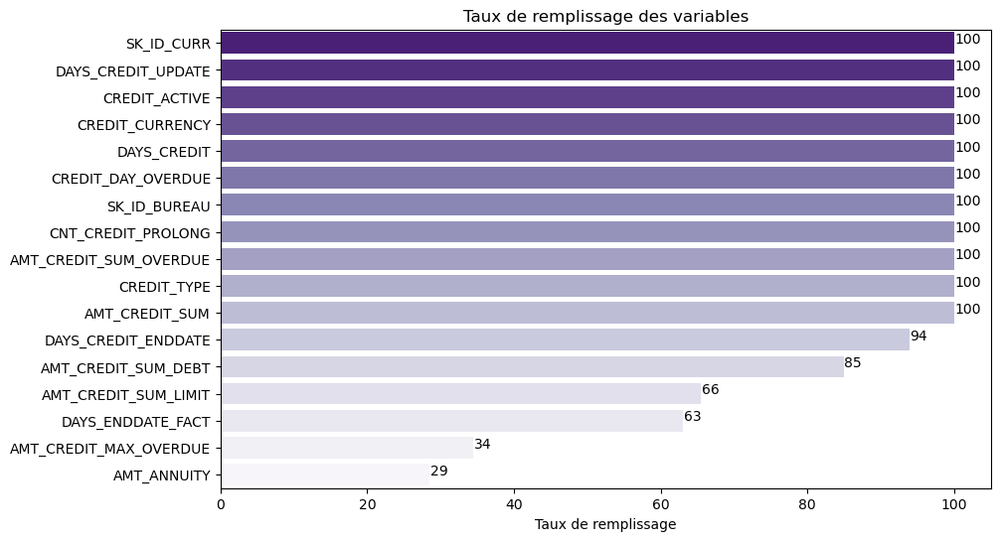

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_CURR,int64,215354,1716428,305811,17.82,1716428,100.00,0,0.00
1,SK_ID_BUREAU,int64,5714462,1716428,1716428,100.00,1716428,100.00,0,0.00
2,CREDIT_ACTIVE,object,Closed,1716428,4,0.00,1716428,100.00,0,0.00
3,CREDIT_CURRENCY,object,currency 1,1716428,4,0.00,1716428,100.00,0,0.00
4,DAYS_CREDIT,int64,-497,1716428,2923,0.17,1716428,100.00,0,0.00
5,CREDIT_DAY_OVERDUE,int64,0,1716428,942,0.05,1716428,100.00,0,0.00
6,DAYS_CREDIT_ENDDATE,float64,-153.00,1716428,14096,0.82,1610875,93.85,105553,6.15
7,DAYS_ENDDATE_FACT,float64,-153.00,1716428,2917,0.17,1082775,63.08,633653,36.92
8,AMT_CREDIT_MAX_OVERDUE,float64,77674.50,1716428,68251,3.98,591940,34.49,1124488,65.51
9,CNT_CREDIT_PROLONG,int64,0,1716428,10,0.00,1716428,100.00,0,0.00


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [98]:
plt.figure(figsize=(10, 6))
bureau_desc = fct_eda.describe_stat(bureau, fig = fig)

In [99]:
# Description des colonnes
col_desc[col_desc['Table'] == 'bureau_balance.csv']

,Unnamed: 0,Table,Row,Description,Special
139,142,bureau_balance.csv,SK_BUREAU_ID,Recoded ID of Credit Bureau credit (unique coding for each application) - use this to join to CREDIT_BUREAU table,hashed
140,143,bureau_balance.csv,MONTHS_BALANCE,Month of balance relative to application date (-1 means the freshest balance date),time only relative to the application
141,144,bureau_balance.csv,STATUS,"Status of Credit Bureau loan during the month (active, closed, DPD0-30, [C means closed, X means status unknown, 0 means no DPD, 1 means maximal did during month between 1-30, 2 means DPD 31-60, 5 means DPD 120+ or sold or written off ] )",NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
27299920,5041336,-47,X
27299921,5041336,-48,X
27299922,5041336,-49,X
27299923,5041336,-50,X
27299924,5041336,-51,X


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 27299925
Nombre de colonnes: 3
Nombre total de NaN du dataset: 0
% total de NaN du dataset: 0.0%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


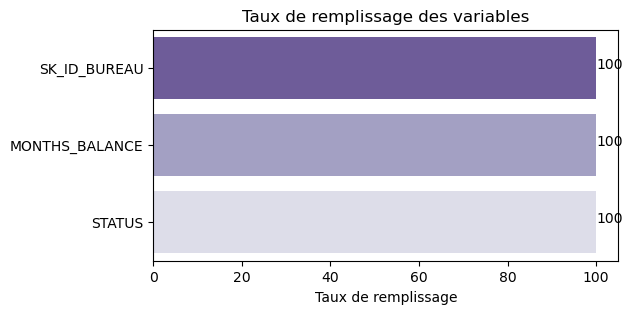

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_BUREAU,int64,5715448,27299925,817395,2.99,27299925,100.00,0,0.00
1,MONTHS_BALANCE,int64,0,27299925,97,0.00,27299925,100.00,0,0.00
2,STATUS,object,C,27299925,8,0.00,27299925,100.00,0,0.00


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [100]:
fig = plt.figure(figsize=(6, 3))
bureau_balance_desc = fct_eda.describe_stat(bureau_balance, fig = fig)

#### Preprocessing bureau_balance et merge avec bureau

Nous allons preprocesser en premier bureau_balance qui comporte beaucoup moins de variables. Il sera ensuite fusionné à la table bureau.

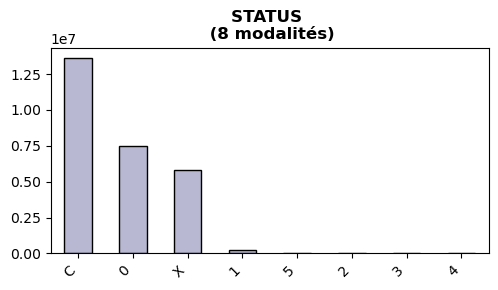

In [101]:
# Différentes modalités de la variable STATUS
fig = plt.figure(figsize=(5, 3))
fct_eda.categ_distrib_plot(bureau_balance, ['STATUS'], 1, 1, fig = fig)

In [102]:
bureau_balance['STATUS'].value_counts()

C    13646993
0     7499507
X     5810482
1      242347
5       62406
2       23419
3        8924
4        5847
Name: STATUS, dtype: int64

D'après le fichier de la description des colonnes, voici la définition des différents status:
- C = fermé
- X = inconnu
- 0 = pas de jours de retard
- 1 = max de 1 à 30 jours de retard au cours du mois
- 2 = entre 31 et 60 jours de retard
- 3 = entre 61 et 90 jours de retard
- 4 = entre 91 et 120 jours de retard
- 5 = plus de 120 jours de retard ou passé en pertes

Nous allons regrouper certaines modalités afin de diminuer leur nombre et les rendre un peu plus homogènes. Nous allons également en profiter pour les renommer afin de les rendre plus compréhensibles:

In [103]:
dico_status = {'C' : 'Closed',
               '0': 'No DPD',
               'X': 'Unknown',
               '1': 'Max 30 DPD',
               '2': 'Between 31 and 120 DPD',
               '3':'Between 31 and 120 DPD',
               '4':'Between 31 and 120 DPD',
               '5':'More than 120 DPD or written off'}
bureau_balance['STATUS'] = bureau_balance['STATUS'].map(dico_status)

Afin de faciliter les traitements, nous allons **agréger la table bureau_balance au niveau du SK_ID_BUREAU** afin de n'avoir qu'une ligne par crédit antérieur enregistré au Credit Bureau. Nous récupérerons le nombre (valeurs manquantes incluses) pour la variable MONTHS_BALANCE puis ferons la somme de la variable catégorielle STATUS que nous allons auparavant **One Hot encoder** afin de n'avoir que des entrées numériques par la suite:

In [104]:
# One Hot Encoder (modalités > 2)
bureau_balance_ohe, bureau_balance_cat = fct_eda.categories_encoder(bureau_balance, nan_as_category = False)
bureau_balance_ohe.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS_Between 31 and 120 DPD,STATUS_Closed,STATUS_Max 30 DPD,STATUS_More than 120 DPD or written off,STATUS_No DPD,STATUS_Unknown
0,5715448,0,0,1,0,0,0,0
1,5715448,-1,0,1,0,0,0,0
2,5715448,-2,0,1,0,0,0,0
3,5715448,-3,0,1,0,0,0,0
4,5715448,-4,0,1,0,0,0,0


In [105]:
# Dictionnaire des agrégations
bureau_balance_aggreg = {'MONTHS_BALANCE': ['size']}
for col in bureau_balance_cat:
        bureau_balance_aggreg[col] = ['sum']

In [106]:
bureau_balance_aggreg

{'MONTHS_BALANCE': ['size'],
 'STATUS_Between 31 and 120 DPD': ['sum'],
 'STATUS_Closed': ['sum'],
 'STATUS_Max 30 DPD': ['sum'],
 'STATUS_More than 120 DPD or written off': ['sum'],
 'STATUS_No DPD': ['sum'],
 'STATUS_Unknown': ['sum']}

In [107]:
# Groupe par SK_ID_BUREAU avec application du dictionnaire des agrégations
bureau_balance_ohe_gby = bureau_balance_ohe.groupby('SK_ID_BUREAU').agg(bureau_balance_aggreg)
bureau_balance_ohe_gby

,MONTHS_BALANCE,STATUS_Between 31 and 120 DPD,STATUS_Closed,STATUS_Max 30 DPD,STATUS_More than 120 DPD or written off,STATUS_No DPD,STATUS_Unknown
,size,sum,sum,sum,sum,sum,sum
SK_ID_BUREAU,,,,,,,
5001709,97,0,86,0,0,0,11
5001710,83,0,48,0,0,5,30
5001711,4,0,0,0,0,3,1
5001712,19,0,9,0,0,10,0
5001713,22,0,0,0,0,0,22
...,...,...,...,...,...,...,...
6842884,48,0,20,0,0,9,19
6842885,24,0,0,0,12,12,0


In [108]:
# Renommage des colonnes pour éviter les niveaux multiples
bureau_balance_ohe_gby.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bureau_balance_ohe_gby.columns.tolist()])
bureau_balance_ohe_gby

,MONTHS_BALANCE_SIZE,STATUS_Between 31 and 120 DPD_SUM,STATUS_Closed_SUM,STATUS_Max 30 DPD_SUM,STATUS_More than 120 DPD or written off_SUM,STATUS_No DPD_SUM,STATUS_Unknown_SUM
SK_ID_BUREAU,,,,,,,
5001709,97,0,86,0,0,0,11
5001710,83,0,48,0,0,5,30
5001711,4,0,0,0,0,3,1
5001712,19,0,9,0,0,10,0
5001713,22,0,0,0,0,0,22
...,...,...,...,...,...,...,...
6842884,48,0,20,0,0,9,19
6842885,24,0,0,0,12,12,0
6842886,33,0,25,0,0,8,0


In [109]:
bureau_balance_ohe_gby.isna().sum().sort_values(ascending = False)

MONTHS_BALANCE_SIZE                            0
STATUS_Between 31 and 120 DPD_SUM              0
STATUS_Closed_SUM                              0
STATUS_Max 30 DPD_SUM                          0
STATUS_More than 120 DPD or written off_SUM    0
STATUS_No DPD_SUM                              0
STATUS_Unknown_SUM                             0
dtype: int64

In [110]:
# Fusion de bureau et bureau balance et suppression de la variable SK_ID_BUREAU
bureau_bb = bureau.join(bureau_balance_ohe_gby, how = 'left', on = 'SK_ID_BUREAU')
bureau_bb.drop(['SK_ID_BUREAU'], axis = 1, inplace = True)

In [111]:
bureau_bb

,SK_ID_CURR,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY,MONTHS_BALANCE_SIZE,STATUS_Between 31 and 120 DPD_SUM,STATUS_Closed_SUM,STATUS_Max 30 DPD_SUM,STATUS_More than 120 DPD or written off_SUM,STATUS_No DPD_SUM,STATUS_Unknown_SUM
0,215354,Closed,currency 1,-497,0,-153.00,-153.00,NaN,0,91323.00,0.00,NaN,0.00,Consumer credit,-131,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,215354,Active,currency 1,-208,0,1075.00,NaN,NaN,0,225000.00,171342.00,NaN,0.00,Credit card,-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,215354,Active,currency 1,-203,0,528.00,NaN,NaN,0,464323.50,NaN,NaN,0.00,Consumer credit,-16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,215354,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.00,Credit card,-16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,215354,Active,currency 1,-629,0,1197.00,NaN,77674.50,0,2700000.00,NaN,NaN,0.00,Consumer credit,-21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1716423,259355,Active,currency 1,-44,0,-30.00,NaN,0.00,0,11250.00,11250.00,0.00,0.00,Microloan,-19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1716424,100044,Closed,currency 1,-2648,0,-2433.00,-2493.00,5476.50,0,38130.84,0.00,0.00,0.00,Consumer credit,-2493,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1716425,100044,Closed,currency 1,-1809,0,-1628.00,-970.00,NaN,0,15570.00,NaN,NaN,0.00,Consumer credit,-967,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1716426,246829,Closed,currency 1,-1878,0,-1513.00,-1513.00,NaN,0,36000.00,0.00,0.00,0.00,Consumer credit,-1508,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Traitement des données manquantes

Nous allons imputer les données manquantes de différentes manières:
- **0** pour les variables **STATUS** et **MONTHS_BALANCE_SIZE**
- **suppression** des variables avec plus de **30% de données manquantes**
- lorsque le pourcentage de valeurs manquantes est relativement **faible** (<=30%), nous imputerons par la **médiane** pour les variables quantitatives.

Pour nous assurer que nos méthodes sont cohérentes, nous analyserons les **distributions** avant et après imputations.

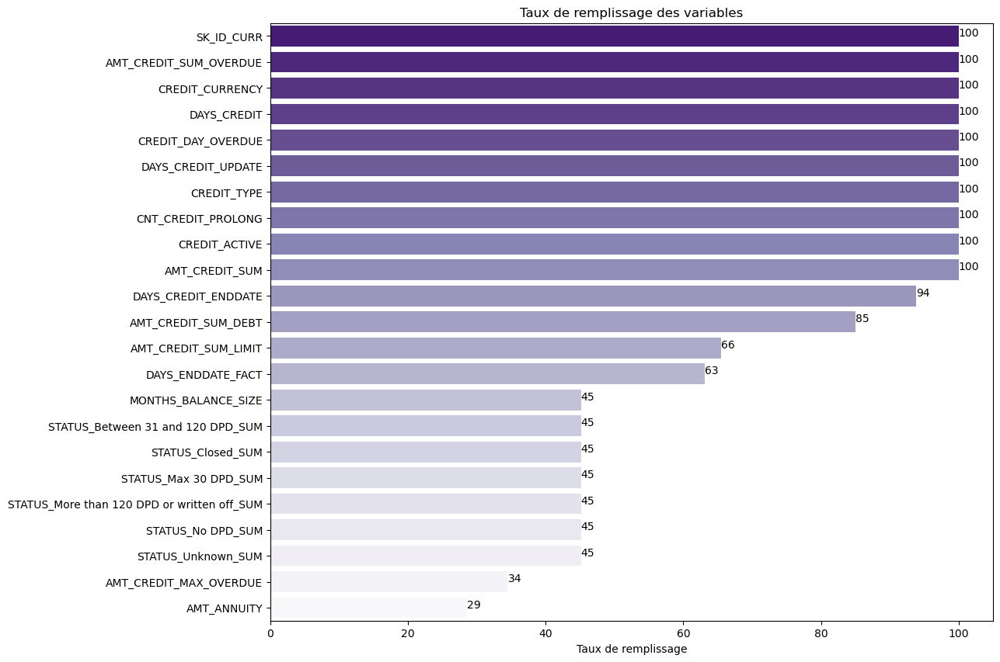

In [112]:
fig = plt.figure(figsize=(12, 10))
fct_eda.plot_tx_remplissage(bureau_bb, fig = fig)

<div class="alert alert-block alert-warning">
    <p>0 pour les variables STATUS et MONTHS_BALANCE_SIZE</p>
</div>

In [113]:
bureau_bb_mean = bureau_bb.copy()

In [114]:
for col in bureau_bb_mean.columns[bureau_bb_mean.columns.str.contains('STATUS')]:
    bureau_bb_mean[col] = bureau_bb_mean[col].fillna(0)

In [115]:
bureau_bb_mean['MONTHS_BALANCE_SIZE'] = bureau_bb_mean['MONTHS_BALANCE_SIZE'].fillna(0)

<div class="alert alert-block alert-warning">
    <p>Suppression des variables avec 30% ou plus de NaN</p>
</div>

In [116]:
# Suppression des variables avec 30% ou plus de NaN
bureau_bb_nan = fct_eda.tx_rempl_min(bureau_bb_mean, 70)
fct_eda.nan_a_retraiter(bureau_bb_nan)

,Tx_rempl,nb_NaN,dtypes
AMT_CREDIT_SUM,100.00,13,float64
DAYS_CREDIT_ENDDATE,93.85,105553,float64
AMT_CREDIT_SUM_DEBT,84.99,257669,float64


<div class="alert alert-block alert-warning">
    <p>Médiane pour variables avec taux de remplissage > 70%</p>
</div>

In [117]:
bureau_bb_med = bureau_bb_nan.copy()

In [118]:
df_nan = fct_eda.nan_a_retraiter(bureau_bb_med)
df_nan

,Tx_rempl,nb_NaN,dtypes
AMT_CREDIT_SUM,100.00,13,float64
DAYS_CREDIT_ENDDATE,93.85,105553,float64
AMT_CREDIT_SUM_DEBT,84.99,257669,float64


In [119]:
# Colonnes impactées
col_med = df_nan[(df_nan['Tx_rempl']>70) & 
                 (df_nan['dtypes'] == 'float64')].index.tolist()

# Imputation des variables par la médiane
for col in col_med:
    bureau_bb_med[col] = bureau_bb_med[col].fillna(bureau_bb_med[col].median())

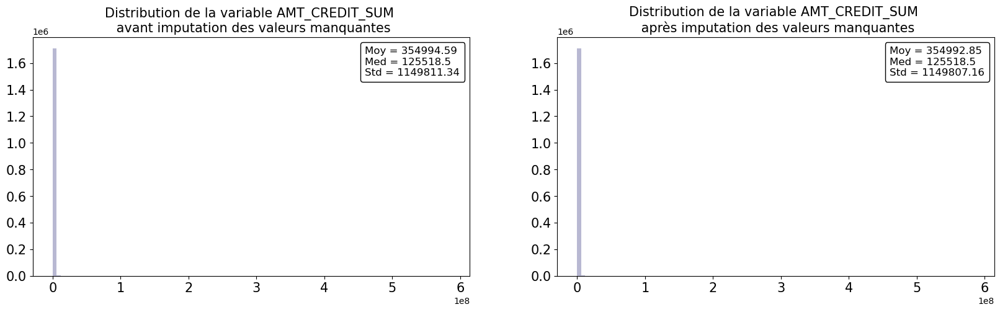

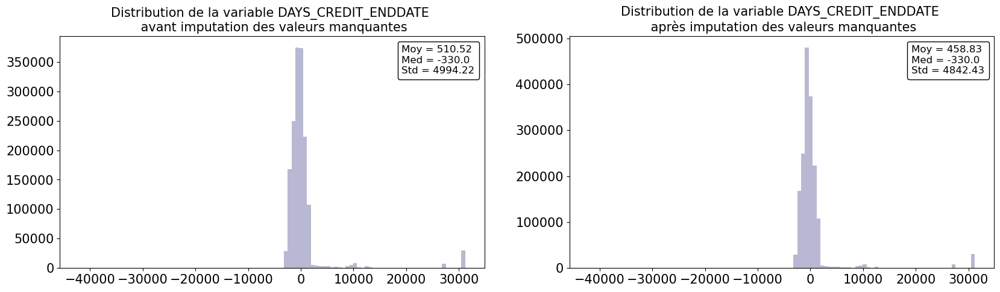

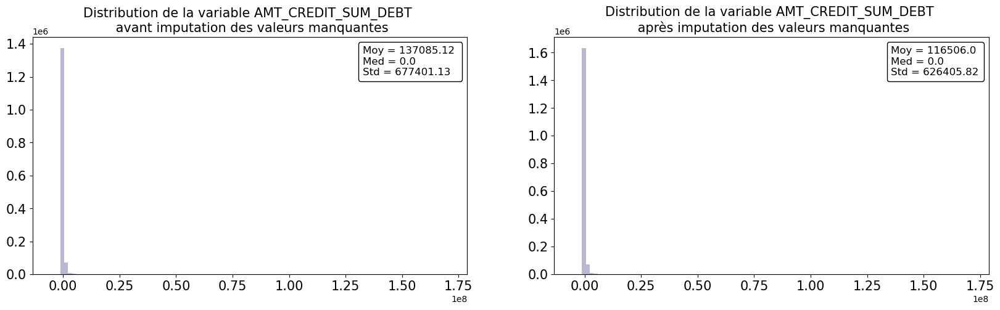

In [120]:
for var in col_med:
    fct_eda.distrib_imput_nan_quanti(bureau_bb_nan, var, bureau_bb_med)

Les distributions de nos variables avant et après imputation des valeurs manquantes par la médiane sont relativement similaires, nous validons cette méthode.

#### Analyses univariées

In [121]:
bureau_bb_desc = bureau_bb_med.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [122]:
liste_col_quanti = bureau_bb_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique()
liste_col_quanti = liste_col_quanti[liste_col_quanti>2].index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [123]:
len(liste_col_quanti)

15

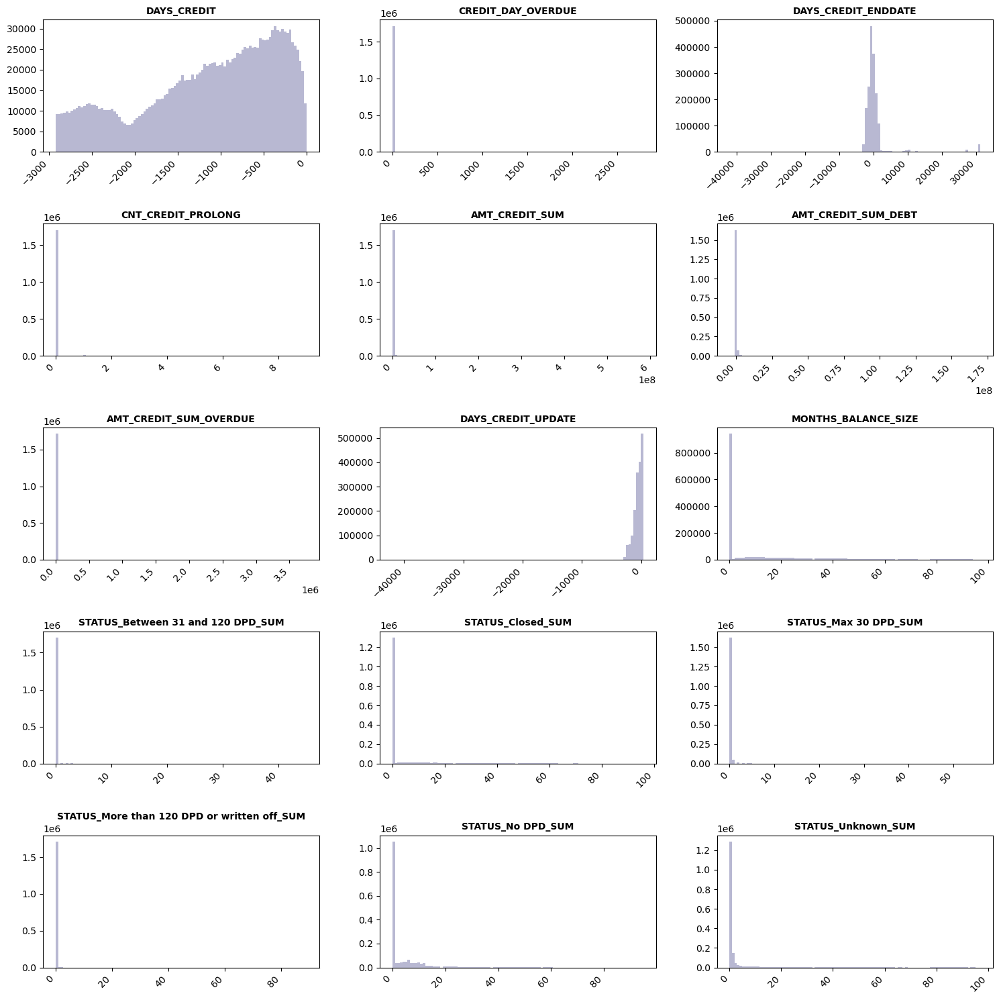

In [124]:
fig = plt.figure(figsize=(15,15))
fct_eda.univariate_plots_hist(bureau_bb_desc, liste_col_quanti, 5, 3, 100, fig=fig)

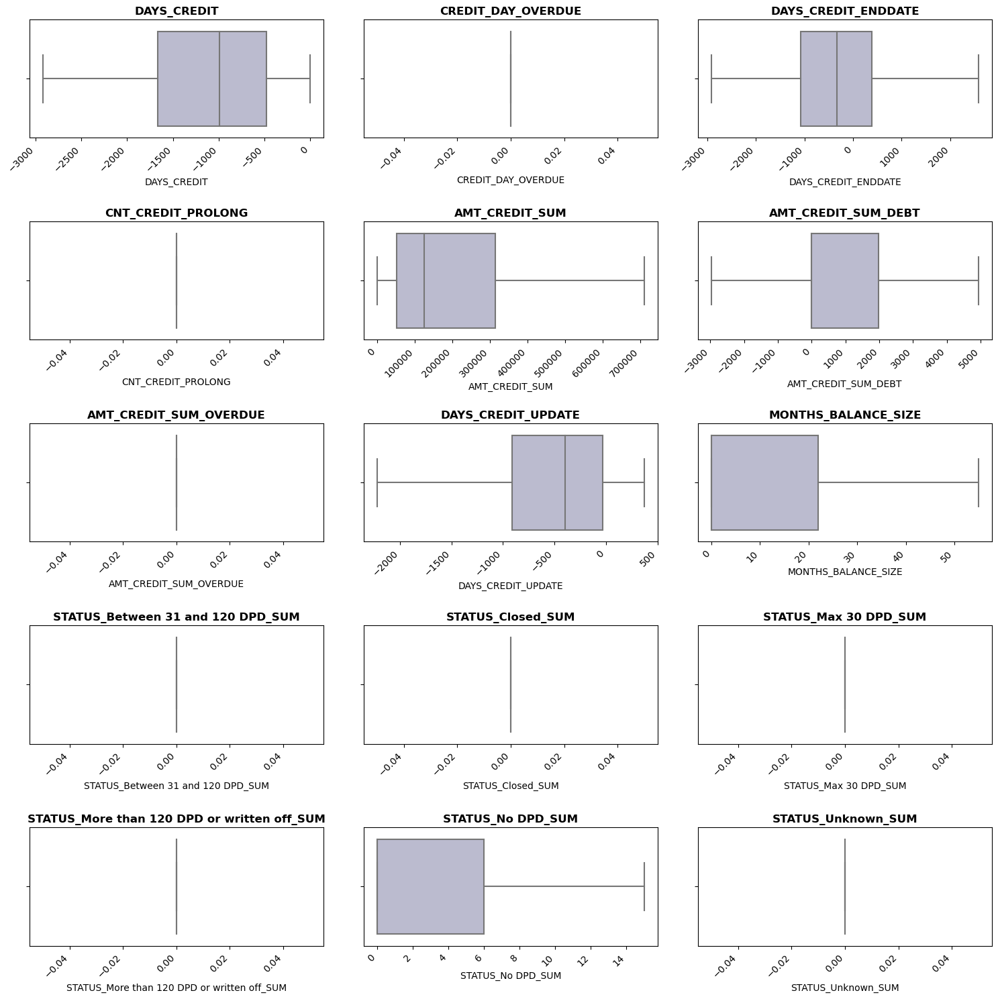

In [125]:
fig = plt.figure(figsize=(15,15))
fct_eda.univariate_plots_box(bureau_bb_desc, liste_col_quanti, 5, 3, fig, False)

In [126]:
bureau_bb_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
DAYS_CREDIT,1716428.00,-1142.11,795.16,-2922.00,-1666.00,-987.00,-474.00,0.00
CREDIT_DAY_OVERDUE,1716428.00,0.82,36.54,0.00,0.00,0.00,0.00,2792.00
DAYS_CREDIT_ENDDATE,1716428.00,458.83,4842.43,-42060.00,-1074.00,-330.00,389.00,31199.00
CNT_CREDIT_PROLONG,1716428.00,0.01,0.10,0.00,0.00,0.00,0.00,9.00
AMT_CREDIT_SUM,1716428.00,354992.85,1149807.16,0.00,51300.00,125518.50,315000.00,585000000.00
AMT_CREDIT_SUM_DEBT,1716428.00,116506.00,626405.82,-4705600.32,0.00,0.00,1975.50,170100000.00
AMT_CREDIT_SUM_OVERDUE,1716428.00,37.91,5937.65,0.00,0.00,0.00,0.00,3756681.00
DAYS_CREDIT_UPDATE,1716428.00,-593.75,720.75,-41947.00,-908.00,-395.00,-33.00,372.00
MONTHS_BALANCE_SIZE,1716428.00,14.09,22.14,0.00,0.00,0.00,22.00,97.00
STATUS_Between 31 and 120 DPD_SUM,1716428.00,0.02,0.28,0.00,0.00,0.00,0.00,45.00


Les variables CREDIT_DAY_OVERDUE, CNT_CREDIT_PROLONG, AMT_CREDIT_SUM_OVERDUE ayant toutes des quartiles à 0, nous les supprimons:

In [127]:
bureau_bb_desc.drop(['CREDIT_DAY_OVERDUE', 'CNT_CREDIT_PROLONG', 'AMT_CREDIT_SUM_OVERDUE'], axis = 1, inplace = True)

In [128]:
bureau_bb_desc.describe().T

,count,mean,std,min,25%,50%,75%,max
SK_ID_CURR,1716428.00,278214.93,102938.56,100001.00,188866.75,278055.00,367426.00,456255.00
DAYS_CREDIT,1716428.00,-1142.11,795.16,-2922.00,-1666.00,-987.00,-474.00,0.00
DAYS_CREDIT_ENDDATE,1716428.00,458.83,4842.43,-42060.00,-1074.00,-330.00,389.00,31199.00
AMT_CREDIT_SUM,1716428.00,354992.85,1149807.16,0.00,51300.00,125518.50,315000.00,585000000.00
AMT_CREDIT_SUM_DEBT,1716428.00,116506.00,626405.82,-4705600.32,0.00,0.00,1975.50,170100000.00
DAYS_CREDIT_UPDATE,1716428.00,-593.75,720.75,-41947.00,-908.00,-395.00,-33.00,372.00
MONTHS_BALANCE_SIZE,1716428.00,14.09,22.14,0.00,0.00,0.00,22.00,97.00
STATUS_Between 31 and 120 DPD_SUM,1716428.00,0.02,0.28,0.00,0.00,0.00,0.00,45.00
STATUS_Closed_SUM,1716428.00,6.73,15.78,0.00,0.00,0.00,0.00,96.00
STATUS_Max 30 DPD_SUM,1716428.00,0.13,0.87,0.00,0.00,0.00,0.00,56.00


Nous allons transformer les variables Days en Years pour faciliter la lecture et supprimer la variable DAYS_CREDIT_UPDATE qui n'apporte pas grand chose:

In [129]:
# Nb années avant la demande où le client a demandé un crédit auprès de Crédit Bureau
bureau_bb_desc['YEARS_CREDIT'] = round(bureau_bb_desc['DAYS_CREDIT'] / 365 * -1, 2)
del bureau_bb_desc['DAYS_CREDIT']

In [130]:
# Durée restante du crédit souscrit auprès de Credit Bureau en année au moment de l'application chez Home Credit
bureau_bb_desc['YEARS_CREDIT_ENDDATE'] = round(bureau_bb_desc['DAYS_CREDIT_ENDDATE'] / 365 * -1, 2)
del bureau_bb_desc['DAYS_CREDIT_ENDDATE']

In [131]:
del bureau_bb_desc['DAYS_CREDIT_UPDATE']

In [132]:
liste_col_quali = bureau_bb_desc.select_dtypes(include ='object').columns
len(liste_col_quali)

3

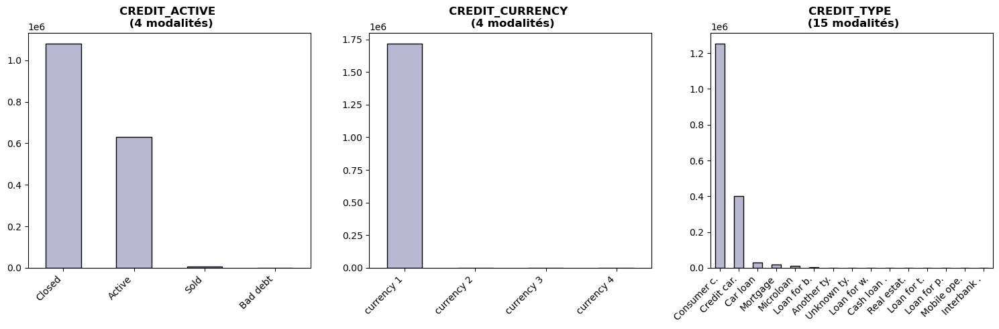

In [133]:
fig = plt.figure(figsize=(15, 5))
fct_eda.categ_distrib_plot(bureau_bb_desc, liste_col_quali, 1, 3, fig = fig)

Nous allons regrouper certaines catégories et supprimer la variable CREDIT_CURRENCY. En effet, la modalité currency 1 est très largement sur représentée.

In [134]:
# Suppression de la variable CREDIT_CURRENCY
del bureau_bb_desc['CREDIT_CURRENCY']

In [135]:
# Status des crédits déclarés par Bureau Crédit
bureau_bb_desc['CREDIT_ACTIVE'].value_counts()

Closed      1079273
Active       630607
Sold           6527
Bad debt         21
Name: CREDIT_ACTIVE, dtype: int64

In [136]:
dico_credit_active = {'Closed' : 'Closed',
                      'Active': 'Active',
                      'Sold': 'Sold / Bad Debt',
                      'Bad debt': 'Sold / Bad Debt'}

bureau_bb_desc['CREDIT_ACTIVE'] = bureau_bb_desc['CREDIT_ACTIVE'].map(dico_credit_active)

In [137]:
# Types de crédit
bureau_bb_desc['CREDIT_TYPE'].value_counts()

Consumer credit                                 1251615
Credit card                                      402195
Car loan                                          27690
Mortgage                                          18391
Microloan                                         12413
Loan for business development                      1975
Another type of loan                               1017
Unknown type of loan                                555
Loan for working capital replenishment              469
Cash loan (non-earmarked)                            56
Real estate loan                                     27
Loan for the purchase of equipment                   19
Loan for purchase of shares (margin lending)          4
Mobile operator loan                                  1
Interbank credit                                      1
Name: CREDIT_TYPE, dtype: int64

In [138]:
dico_credit_type = {'Consumer credit' : 'Consumer credit',
                    'Credit card': 'Credit card',
                    'Car loan': 'Car loan',
                    'Mortgage': 'Mortgage',
                    'Microloan': 'Microloan',
                    'Loan for business development': 'Other',
                    'Another type of loan': 'Other',
                    'Unknown type of loan': 'Other',
                    'Loan for working capital replenishment': 'Other',
                    'Cash loan (non-earmarked)': 'Other',
                    'Real estate loan': 'Other',
                    'Loan for the purchase of equipment': 'Other',
                    'Loan for purchase of shares (margin lending)': 'Other',
                    'Mobile operator loan': 'Other',
                    'Interbank credit': 'Other',}

bureau_bb_desc['CREDIT_TYPE'] = bureau_bb_desc['CREDIT_TYPE'].map(dico_credit_type)

#### Analyses bivariées / multivariées

Nous allons intégrer la variable TARGET afin de mieux comprendre quelles variables ont une influence sur la capacité à rembourser l'emprunt.

In [139]:
bureau_bb_desc = bureau_bb_desc.merge(app_train_desc.reset_index()[['SK_ID_CURR', 'TARGET']],
                                      on = 'SK_ID_CURR',
                                      how = 'left')

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

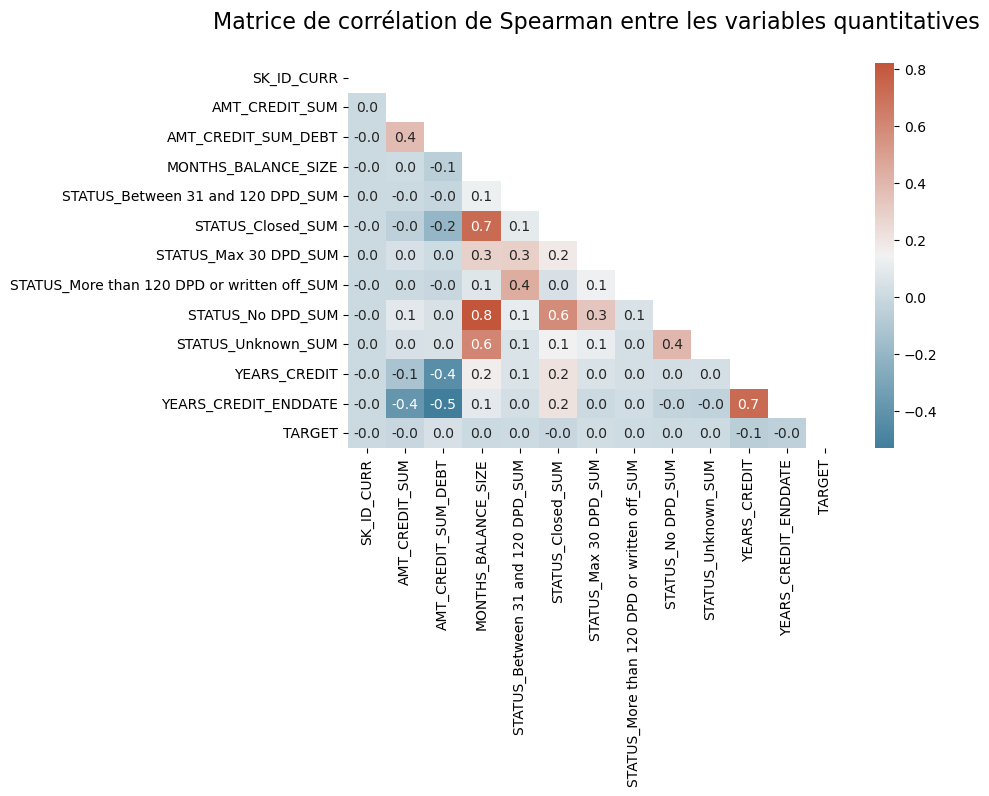

In [140]:
# Corrélation
corr = bureau_bb_desc.corr('spearman')

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(8,5))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation de Spearman entre les variables quantitatives\n", fontsize=16);

Certaines variables sont très corrélées entre-elles. Nous tâcherons de ne pas les rajouter toutes dans le modèle ou d'en créer de nouvelles à l'aide du feature engineering.
- MONTHS_BALANCE_SIZE et STATUS_Closed_SUM
- MONTHS_BALANCE_SIZE et STATUS_No DPD_SUM
- MONTHS_BALANCE_SIZE et STATUS_Unknown_SUM
- STATUS_Closed_SUM et STATUS_No DPD_SUM
- YEARS_CREDIT et YEARS_CREDIT_ENDDATE

In [141]:
liste_col_quanti = bureau_bb_desc.select_dtypes(exclude ='object').nunique().index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR', 'TARGET']
liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

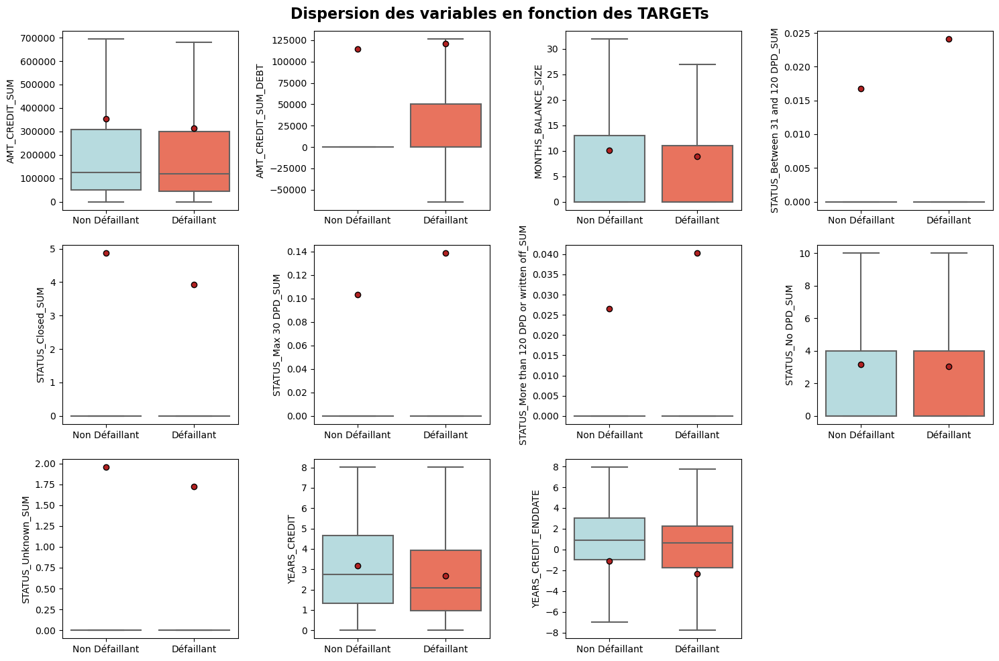

In [142]:
fig = plt.figure(figsize=(15,10))
fct_eda.bivariate_plots_box(bureau_bb_desc, 'TARGET', liste_col_quanti, 3, 4, fig)

In [143]:
Kruskal_Wallis_test(bureau_bb_desc, liste_col_quanti, 'TARGET')

Test non paramétrique de Kruskal Wallis: 

Variable AMT_CREDIT_SUM par TARGET
pvaleur: 1.1158857153585435e-32 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable AMT_CREDIT_SUM_DEBT par TARGET
pvaleur: 0.0 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable MONTHS_BALANCE_SIZE par TARGET
pvaleur: 0.03619518060873061 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable STATUS_Between 31 and 120 DPD_SUM par TARGET
pvaleur: 2.410262439130043e-19 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable STATUS_Closed_SUM par TARGET
pvaleur: 2.3997358144

Parmis les variables corrélées entre-elles, nous n'allons pas conserver les variables YEARS_CREDIT, STATUS_No DPD_SUM, STATUS_Unknown_SUM et MONTHS_BALANCE_SIZE

In [144]:
del bureau_bb_desc['YEARS_CREDIT']
del bureau_bb_desc['STATUS_No DPD_SUM']
del bureau_bb_desc['STATUS_Unknown_SUM']
del bureau_bb_desc['MONTHS_BALANCE_SIZE']

<div class="alert alert-block alert-warning">
    <p>Variables qualitatives et target</p>
</div>

In [145]:
liste_col_quali = bureau_bb_desc.select_dtypes(include ='object').columns

CREDIT_ACTIVE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


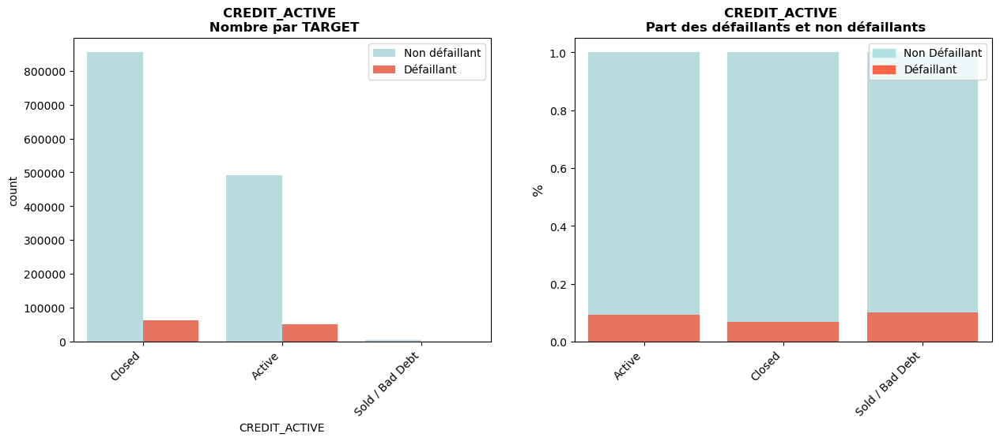

CREDIT_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


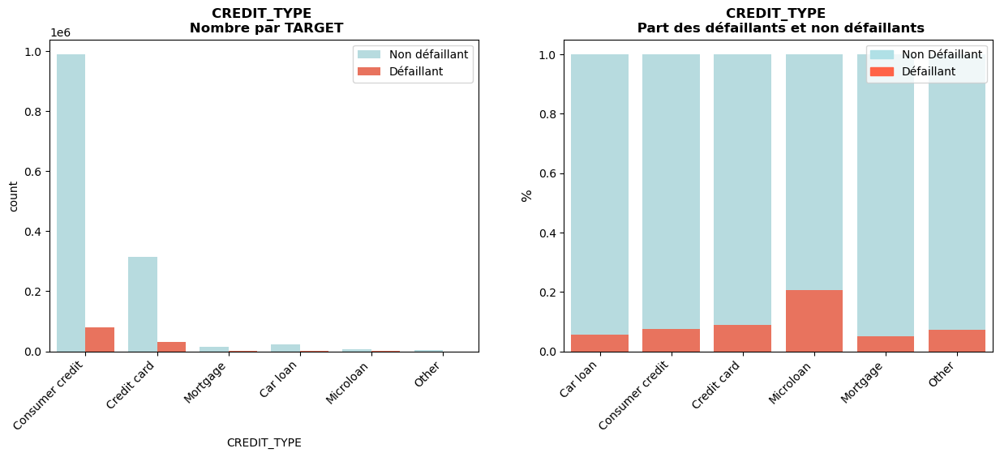

In [146]:
for var in liste_col_quali:
    fct_eda.bivariate_barplots_categ(bureau_bb_desc, var, 'TARGET')

L'association des variables qualitatives avec la target ayant été testée via Chi2, nous garderons pour le moment toutes les variables qualitatives.

In [147]:
# Suppression de la variable TARGET
del bureau_bb_desc['TARGET']

#### Feature engineering

Nous allons encoder nos variables catégorielles à l'aide du **One Hot Encoder (modalités > 2)** pour qu'elles puissent être traitées ensuite dans notre modèle de ML.

In [148]:
bureau_bb_feat, bureau_bb_feat_cat = fct_eda.categories_encoder(bureau_bb_desc, nan_as_category = False)
bureau_bb_feat.head()

,SK_ID_CURR,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,STATUS_Between 31 and 120 DPD_SUM,STATUS_Closed_SUM,STATUS_Max 30 DPD_SUM,STATUS_More than 120 DPD or written off_SUM,YEARS_CREDIT_ENDDATE,CREDIT_ACTIVE_Active,CREDIT_ACTIVE_Closed,CREDIT_ACTIVE_Sold / Bad Debt,CREDIT_TYPE_Car loan,CREDIT_TYPE_Consumer credit,CREDIT_TYPE_Credit card,CREDIT_TYPE_Microloan,CREDIT_TYPE_Mortgage,CREDIT_TYPE_Other
0,215354,91323.00,0.00,0.00,0.00,0.00,0.00,0.42,0,1,0,0,1,0,0,0,0
1,215354,225000.00,171342.00,0.00,0.00,0.00,0.00,-2.95,1,0,0,0,0,1,0,0,0
2,215354,464323.50,0.00,0.00,0.00,0.00,0.00,-1.45,1,0,0,0,1,0,0,0,0
3,215354,90000.00,0.00,0.00,0.00,0.00,0.00,0.90,1,0,0,0,0,1,0,0,0
4,215354,2700000.00,0.00,0.00,0.00,0.00,0.00,-3.28,1,0,0,0,1,0,0,0,0


Puisque nous avons **plusieurs lignes pour un même prêt de notre échantillon** correspondant au nombre de crédit que le client a eu à Crédit Bureau, nous allons regrouper notre table par SK_ID_CURR et agréger nos données:

In [149]:
# Actualisation de la liste des variables catégorielles de bureau_balance
bureau_balance_cat.remove('STATUS_No DPD')
bureau_balance_cat.remove('STATUS_Unknown')
bureau_balance_cat

['STATUS_Between 31 and 120 DPD',
 'STATUS_Closed',
 'STATUS_Max 30 DPD',
 'STATUS_More than 120 DPD or written off']

In [150]:
# Dictionnaire des agrégations
num_aggregations = {
        'AMT_CREDIT_SUM': ['sum', 'mean'],
        'AMT_CREDIT_SUM_DEBT': ['sum', 'mean'],
        'YEARS_CREDIT_ENDDATE': ['mean', 'max']
}


cat_aggregations = {}

for cat in bureau_bb_feat_cat:
    cat_aggregations[cat] = ['sum']
    
for cat in bureau_balance_cat:
    cat_aggregations[cat + "_SUM"] = ['sum']

In [151]:
# Groupe par SK_ID_CURR avec application du dictionnaire des agrégations
bureau_bb_feat_gby = bureau_bb_feat.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
bureau_bb_feat_gby

AMT_CREDIT_SUM            AMT_CREDIT_SUM_DEBT           YEARS_CREDIT_ENDDATE      CREDIT_ACTIVE_Active CREDIT_ACTIVE_Closed CREDIT_ACTIVE_Sold / Bad Debt CREDIT_TYPE_Car loan CREDIT_TYPE_Consumer credit CREDIT_TYPE_Credit card CREDIT_TYPE_Microloan CREDIT_TYPE_Mortgage  \
                      sum       mean                 sum      mean                 mean  max                  sum                  sum                           sum                  sum                         sum                     sum                   sum                  sum   
SK_ID_CURR                                                                                                                                                                                                                                                                                 
100001         1453365.00  207623.57           596686.50  85240.93                -0.23 3.64                    3                    4                             0                    0                           7                       0                     0                    0   
100002          865055.56  108131.95           245781.00  30722.62                 0.94 2.94                    2                    6                             0                    0                           4                       4                     0                    0   
100003         1017400.50  254350.12                0.00      0.00                 1.49 6.67                    1                    3                             0                    0                           2                       2                     0                    0   
100004          189037.80   94518.90                0.00      0.00                 1.34 1.63                    0                    2                             0                    0                           2                       0                     0                    0   
100005          657126.00  219042.00           568408.50 189469.50                -1.20 0.35                    2                    1                             0                    0                           2                       1                     0                    0   
...                   ...        ...                 ...       ...                  ...  ...                  ...                  ...                           ...                  ...                         ...                     ...                   ...                  ...   
456249         3693858.66  284142.97           163071.00  12543.92                 3.19 6.85                    2                   11                             0                    0                           9                       3                     0                    0   
456250         3086459.55 1028819.85          2232040.09 744013.36                -3.53 0.75                    2                    1                             0                    0                           2                       1                     0                    0   
456253         3960000.00  990000.00          1795833.00 448958.25                -0.77 0.52                    2                    2                             0                    0                           3                       1                     0                    0   
456254           45000.00   45000.00                0.00      0.00                 2.35 2.35                    0                    1                             0                    0                           1                       0                     0                    0   
456255         3801919.50  345629.05          1534913.01 139537.55                -8.85 3.41                    5                    6                             0                    0                           9                       2                     0                    0   

           CREDIT_TYPE_Other STATU

In [152]:
# Renommage des colonnes pour éviter les niveaux multiples
bureau_bb_feat_gby.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_bb_feat_gby.columns.tolist()])
bureau_bb_feat_gby

,BURO_AMT_CREDIT_SUM_SUM,BURO_AMT_CREDIT_SUM_MEAN,BURO_AMT_CREDIT_SUM_DEBT_SUM,BURO_AMT_CREDIT_SUM_DEBT_MEAN,BURO_YEARS_CREDIT_ENDDATE_MEAN,BURO_YEARS_CREDIT_ENDDATE_MAX,BURO_CREDIT_ACTIVE_Active_SUM,BURO_CREDIT_ACTIVE_Closed_SUM,BURO_CREDIT_ACTIVE_Sold / Bad Debt_SUM,BURO_CREDIT_TYPE_Car loan_SUM,BURO_CREDIT_TYPE_Consumer credit_SUM,BURO_CREDIT_TYPE_Credit card_SUM,BURO_CREDIT_TYPE_Microloan_SUM,BURO_CREDIT_TYPE_Mortgage_SUM,BURO_CREDIT_TYPE_Other_SUM,BURO_STATUS_Between 31 and 120 DPD_SUM_SUM,BURO_STATUS_Closed_SUM_SUM,BURO_STATUS_Max 30 DPD_SUM_SUM,BURO_STATUS_More than 120 DPD or written off_SUM_SUM
SK_ID_CURR,,,,,,,,,,,,,,,,,,,
100001,1453365.00,207623.57,596686.50,85240.93,-0.23,3.64,3,4,0,0,7,0,0,0,0,0.00,110.00,1.00,0.00
100002,865055.56,108131.95,245781.00,30722.62,0.94,2.94,2,6,0,0,4,4,0,0,0,0.00,23.00,27.00,0.00
100003,1017400.50,254350.12,0.00,0.00,1.49,6.67,1,3,0,0,2,2,0,0,0,0.00,0.00,0.00,0.00
100004,189037.80,94518.90,0.00,0.00,1.34,1.63,0,2,0,0,2,0,0,0,0,0.00,0.00,0.00,0.00
100005,657126.00,219042.00,568408.50,189469.50,-1.20,0.35,2,1,0,0,2,1,0,0,0,0.00,5.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
456249,3693858.66,284142.97,163071.00,12543.92,3.19,6.85,2,11,0,0,9,3,0,0,1,0.00,0.00,0.00,0.00
456250,3086459.55,1028819.85,2232040.09,744013.36,-3.53,0.75,2,1,0,0,2,1,0,0,0,0.00,25.00,0.00,0.00
456253,3960000.00,990000.00,1795833.00,448958.25,-0.77,0.52,2,2,0,0,3,1,0,0,0,0.00,57.00,0.00,0.00


In [153]:
bureau_bb_feat_gby.isna().sum().sort_values(ascending = False)

BURO_AMT_CREDIT_SUM_SUM                                 0
BURO_CREDIT_TYPE_Consumer credit_SUM                    0
BURO_STATUS_Max 30 DPD_SUM_SUM                          0
BURO_STATUS_Closed_SUM_SUM                              0
BURO_STATUS_Between 31 and 120 DPD_SUM_SUM              0
BURO_CREDIT_TYPE_Other_SUM                              0
BURO_CREDIT_TYPE_Mortgage_SUM                           0
BURO_CREDIT_TYPE_Microloan_SUM                          0
BURO_CREDIT_TYPE_Credit card_SUM                        0
BURO_CREDIT_TYPE_Car loan_SUM                           0
BURO_AMT_CREDIT_SUM_MEAN                                0
BURO_CREDIT_ACTIVE_Sold / Bad Debt_SUM                  0
BURO_CREDIT_ACTIVE_Closed_SUM                           0
BURO_CREDIT_ACTIVE_Active_SUM                           0
BURO_YEARS_CREDIT_ENDDATE_MAX                           0
BURO_YEARS_CREDIT_ENDDATE_MEAN                          0
BURO_AMT_CREDIT_SUM_DEBT_MEAN                           0
BURO_AMT_CREDI

In [154]:
bureau_bb_feat_gby.shape

(305811, 19)

#### Fonction de preprocessing

In [155]:
def preprocess_bureau_balance():
    '''Fonction de preprocessing des datasets bureau et bureau_balance:
    merge, traitement des données manquantes, traitement des outliers et des modalités,
    feature engineering
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    
    # Chargement des datasets
    bureau = pd.read_csv('data/bureau.csv', sep = ',', encoding='utf-8')
    bureau_balance = pd.read_csv('data/bureau_balance.csv', sep=',', encoding='utf-8')
    
    
    # Preprocessing bureau_balance
    dico_status = {'C' : 'Closed',
               '0': 'No DPD',
               'X': 'Unknown',
               '1': 'Max 30 DPD',
               '2': 'Between 31 and 120 DPD',
               '3':'Between 31 and 120 DPD',
               '4':'Between 31 and 120 DPD',
               '5':'More than 120 DPD or written off'}
    bureau_balance['STATUS'] = bureau_balance['STATUS'].map(dico_status)
    bureau_balance, bureau_balance_cat = fct_eda.categories_encoder(bureau_balance, nan_as_category = False)
        
    ## Agrégations
    bureau_balance_aggreg = {'MONTHS_BALANCE': ['size']}
    for col in bureau_balance_cat:
        bureau_balance_aggreg[col] = ['sum']
        
    ## Groupe par SK_ID_BUREAU avec application du dictionnaire des agrégations
    bureau_balance = bureau_balance.groupby('SK_ID_BUREAU').agg(bureau_balance_aggreg)
    
    ## Renommage des colonnes pour éviter les niveaux multiples
    bureau_balance.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bureau_balance.columns.tolist()])
    
    ## Fusion de bureau et bureau balance et suppression de la variable SK_ID_BUREAU
    bureau_bb = bureau.join(bureau_balance, how='left', on='SK_ID_BUREAU')
    bureau_bb.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    
    # Traitement des données manquantes
    
    ## 0 pour les variables STATUS et MONTHS_BALANCE_SIZE
    for col in bureau_bb.columns[bureau_bb.columns.str.contains('STATUS')]:
        bureau_bb[col] = bureau_bb[col].fillna(0)
    bureau_bb['MONTHS_BALANCE_SIZE'] = bureau_bb['MONTHS_BALANCE_SIZE'].fillna(0)
    
    ## Suppression des variables avec 30% ou plus de NaN
    bureau_bb_nan = fct_eda.tx_rempl_min(bureau_bb, 70)
    
    ## Médiane pour variables avec taux de remplissage > 70%
    df_nan = fct_eda.nan_a_retraiter(bureau_bb)
    col_med = df_nan[(df_nan['Tx_rempl']>70) & 
                 (df_nan['dtypes'] == 'float64')].index.tolist()
    for col in col_med:
        bureau_bb[col] = bureau_bb[col].fillna(bureau_bb[col].median())
    
    ## Suppression de variables
    bureau_bb.drop(['CREDIT_DAY_OVERDUE', 'CNT_CREDIT_PROLONG', 
                         'AMT_CREDIT_SUM_OVERDUE'], axis = 1, inplace = True)

    # Feature engineering
    
    ## Nb années avant la demande où le client a demandé un crédit auprès de Crédit Bureau
    bureau_bb['YEARS_CREDIT'] = round(bureau_bb['DAYS_CREDIT'] / 365 * -1, 2)
    del bureau_bb['DAYS_CREDIT']
    
    ## Durée restante du crédit souscrit auprès de Credit Bureau en année au moment 
    ## de l'application chez Home Credit
    bureau_bb['YEARS_CREDIT_ENDDATE'] = round(bureau_bb['DAYS_CREDIT_ENDDATE'] / 365 * -1, 2)
    del bureau_bb['DAYS_CREDIT_ENDDATE']
    del bureau_bb['DAYS_CREDIT_UPDATE']
    
    ## Suppression de la variable CREDIT_CURRENCY
    del bureau_bb['CREDIT_CURRENCY']

    dico_credit_active = {'Closed' : 'Closed',
                          'Active': 'Active',
                          'Sold': 'Sold / Bad Debt',
                          'Bad debt': 'Sold / Bad Debt'}
    
    ## Statuts des crédits déclarés par Bureau Crédit
    bureau_bb['CREDIT_ACTIVE'] = bureau_bb['CREDIT_ACTIVE'].map(dico_credit_active)
    
    ## Types de crédit
    dico_credit_type = {'Consumer credit' : 'Consumer credit',
                        'Credit card': 'Credit card',
                        'Car loan': 'Car loan',
                        'Mortgage': 'Mortgage',
                        'Microloan': 'Microloan',
                        'Loan for business development': 'Other',
                        'Another type of loan': 'Other',
                        'Unknown type of loan': 'Other',
                        'Loan for working capital replenishment': 'Other',
                        'Cash loan (non-earmarked)': 'Other',
                        'Real estate loan': 'Other',
                        'Loan for the purchase of equipment': 'Other',
                        'Loan for purchase of shares (margin lending)': 'Other',
                        'Mobile operator loan': 'Other',
                        'Interbank credit': 'Other',}
    bureau_bb['CREDIT_TYPE'] = bureau_bb['CREDIT_TYPE'].map(dico_credit_type)
    del bureau_bb['YEARS_CREDIT']
    del bureau_bb['STATUS_No DPD_SUM']
    del bureau_bb['STATUS_Unknown_SUM']
    del bureau_bb['MONTHS_BALANCE_SIZE']
    
    bureau_bb_feat, bureau_bb_feat_cat = fct_eda.categories_encoder(bureau_bb, nan_as_category = False)
    
    ## Actualisation de la liste des variables catégorielles de bureau_balance
    bureau_balance_cat.remove('STATUS_No DPD')
    bureau_balance_cat.remove('STATUS_Unknown')
    
    ## Dictionnaire des agrégations
    num_aggregations = {
        'AMT_CREDIT_SUM': ['sum', 'mean'],
        'AMT_CREDIT_SUM_DEBT': ['sum', 'mean'],
        'YEARS_CREDIT_ENDDATE': ['mean', 'max']
    }
    cat_aggregations = {}
    for cat in bureau_bb_feat_cat:
        cat_aggregations[cat] = ['sum']
    for cat in bureau_balance_cat:
        cat_aggregations[cat + "_SUM"] = ['sum']
        
    ## Groupe par SK_ID_CURR avec application du dictionnaire des agrégations
    bureau_bb_feat_gby = bureau_bb_feat.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    
    ## Renommage des colonnes pour éviter les niveaux multiples
    bureau_bb_feat_gby.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() 
                                           for e in bureau_bb_feat_gby.columns.tolist()])
    
    del bureau, bureau_balance, bureau_bb, bureau_bb_feat
    
    gc.collect()
    
    return bureau_bb_feat_gby

In [156]:
preprocess_bureau_balance().shape

(305811, 19)

### previous_application.csv <a class="anchor" id="previous"></a>

*Données sur les demandes de prêt précédentes (Prêt à dépenser)*

#### Principales statistiques

Cette table contient toutes les **anciennes demandes de prêt** à Prêt à Dépenser des clients que nous avons dans notre échantillon.

In [157]:
# Chargement du dataset
previous_app = pd.read_csv('data/previous_application.csv',
                           sep=',',
                           encoding='utf-8')

In [158]:
# Description des colonnes
col_desc[col_desc['Table'] == 'previous_application.csv']

,Unnamed: 0,Table,Row,Description,Special
173,176,previous_application.csv,SK_ID_PREV,"ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loan applications in Home Credit, previous application could, but not necessarily have to lead to credit)",hashed
174,177,previous_application.csv,SK_ID_CURR,ID of loan in our sample,hashed
175,178,previous_application.csv,NAME_CONTRACT_TYPE,"Contract product type (Cash loan, consumer loan [POS] ,...) of the previous application",NaN
176,179,previous_application.csv,AMT_ANNUITY,Annuity of previous application,NaN
177,180,previous_application.csv,AMT_APPLICATION,For how much credit did client ask on the previous application,NaN
178,181,previous_application.csv,AMT_CREDIT,"Final credit amount on the previous application. This differs from AMT_APPLICATION in a way that the AMT_APPLICATION is the amount for which the client initially applied for, but during our approval process he could have received different amount - AMT_CREDIT",NaN
179,182,previous_application.csv,AMT_DOWN_PAYMENT,Down payment on the previous application,NaN
180,183,previous_application.csv,AMT_GOODS_PRICE,Goods price of good that client asked for (if applicable) on the previous application,NaN
181,184,previous_application.csv,WEEKDAY_APPR_PROCESS_START,On which day of the week did the client apply for previous application,NaN
182,185,previous_application.csv,HOUR_APPR_PROCESS_START,Approximately at what day hour did the client apply for the previous application,rounded


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.43,17145.00,17145.00,0.00,17145.00,SATURDAY,15,Y,1,0.00,0.18,0.87,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.00,middle,POS mobile with interest,365243.00,-42.00,300.00,-42.00,-37.00,0.00
1,2802425,108129,Cash loans,25188.62,607500.00,679671.00,NaN,607500.00,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.00,low_action,Cash X-Sell: low,365243.00,-134.00,916.00,365243.00,365243.00,1.00
2,2523466,122040,Cash loans,15060.74,112500.00,136444.50,NaN,112500.00,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.00,high,Cash X-Sell: high,365243.00,-271.00,59.00,365243.00,365243.00,1.00
3,2819243,176158,Cash loans,47041.33,450000.00,470790.00,NaN,450000.00,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.00,middle,Cash X-Sell: middle,365243.00,-482.00,-152.00,-182.00,-177.00,1.00
4,1784265,202054,Cash loans,31924.40,337500.00,404055.00,NaN,337500.00,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.00,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
1670209,2300464,352015,Consumer loans,14704.29,267295.50,311400.00,0.00,267295.50,WEDNESDAY,12,Y,1,0.00,NaN,NaN,XAP,Approved,-544,Cash through the bank,XAP,NaN,Refreshed,Furniture,POS,XNA,Stone,43,Furniture,30.00,low_normal,POS industry with interest,365243.00,-508.00,362.00,-358.00,-351.00,0.00
1670210,2357031,334635,Consumer loans,6622.02,87750.00,64291.50,29250.00,87750.00,TUESDAY,15,Y,1,0.34,NaN,NaN,XAP,Approved,-1694,Cash through the bank,XAP,Unaccompanied,New,Furniture,POS,XNA,Stone,43,Furniture,12.00,middle,POS industry with interest,365243.00,-1604.00,-1274.00,-1304.00,-1297.00,0.00
1670211,2659632,249544,Consumer loans,11520.85,105237.00,102523.50,10525.50,105237.00,MONDAY,12,Y,1,0.10,NaN,NaN,XAP,Approved,-1488,Cash through the bank,XAP,"Spouse, partner",Repeater,Consumer Electronics,POS,XNA,Country-wide,1370,Consumer electronics,10.00,low_normal,POS household with interest,365243.00,-1457.00,-1187.00,-1187.00,-1181.00,0.00
1670212,2785582,400317,Cash loans,18821.52,180000.00,191880.00,NaN,180000.00,WEDNESDAY,9,Y,1,NaN,NaN,NaN,XNA,Approved,-1185,Cash through the bank,XAP,Family,Repeater,XNA,Cash,x-sell,AP+ (Cash loan),-1,XNA,12.00,low_normal,Cash X-Sell: low,365243.00,-1155.00,-825.00,-825.00,-817.00,1.00
1670213,2418762,261212,Cash loans,16431.30,360000.00,360000.00,NaN,360000.00,SUNDAY,10,Y,1,NaN,NaN,NaN,XNA,Approved,-1193,Cash through the bank,XAP,Family,Repeater,XNA,Cash,x-sell,AP+ (Cash loan),-1,XNA,48.00,middle,Cash X-Sell: middle,365243.00,-1163.00,247.00,-443.00,-423.00,0.00


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 1670214
Nombre de colonnes: 37
Nombre total de NaN du dataset: 11109336
% total de NaN du dataset: 17.98%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


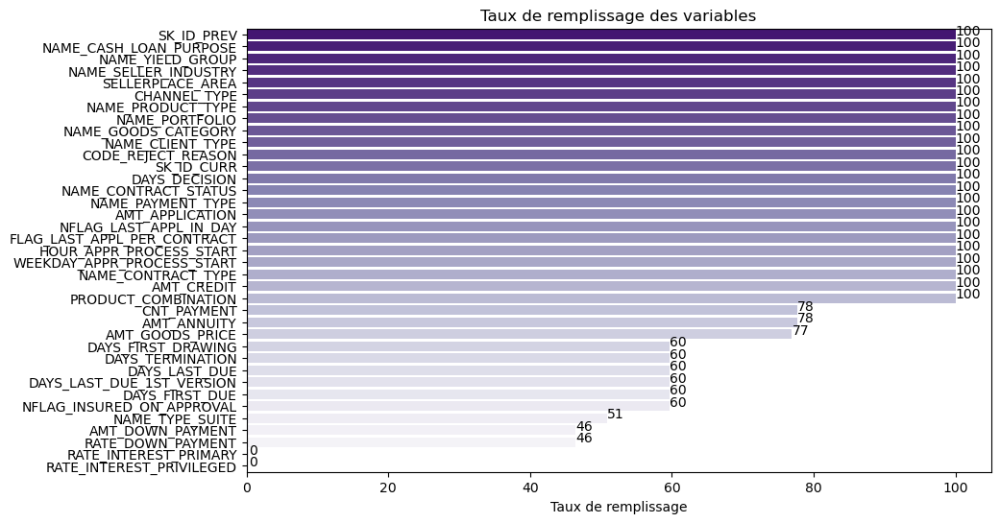

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_PREV,int64,2030495,1670214,1670214,100.00,1670214,100.00,0,0.00
1,SK_ID_CURR,int64,271877,1670214,338857,20.29,1670214,100.00,0,0.00
2,NAME_CONTRACT_TYPE,object,Consumer loans,1670214,4,0.00,1670214,100.00,0,0.00
3,AMT_ANNUITY,float64,1730.43,1670214,357959,21.43,1297979,77.71,372235,22.29
4,AMT_APPLICATION,float64,17145.00,1670214,93885,5.62,1670214,100.00,0,0.00
5,AMT_CREDIT,float64,17145.00,1670214,86803,5.20,1670213,100.00,1,0.00
6,AMT_DOWN_PAYMENT,float64,0.00,1670214,29278,1.75,774370,46.36,895844,53.64
7,AMT_GOODS_PRICE,float64,17145.00,1670214,93885,5.62,1284699,76.92,385515,23.08
8,WEEKDAY_APPR_PROCESS_START,object,SATURDAY,1670214,7,0.00,1670214,100.00,0,0.00
9,HOUR_APPR_PROCESS_START,int64,15,1670214,24,0.00,1670214,100.00,0,0.00


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [159]:
plt.figure(figsize=(10, 6))
previous_app_desc = fct_eda.describe_stat(previous_app, fig = fig)

#### Traitement des données manquantes

Nous allons imputer les données manquantes de différentes manières:
- **suppression** des variables avec plus de **30% de données manquantes**
- pour les **variables corrélées entre elles** que nous repérerons à l'aide de la matrice de corrélation, nous utiliserons l'algorithme **iterative imputer**
- lorsque le pourcentage de valeurs manquantes est relativement **faible** (<=30%), nous imputerons par la **médiane** pour les variables quantitatives et par le **mode** pour les variables qualitatives

Pour nous assurer que nos méthodes sont cohérentes, nous analyserons les **distributions** avant et après imputations.

<div class="alert alert-block alert-warning">
    <p>Suppression des variables avec 30% ou plus de NaN</p>
</div>

In [160]:
# Suppression des variables avec 30% ou plus de NaN
previous_app_nan = fct_eda.tx_rempl_min(previous_app, 70)
fct_eda.nan_a_retraiter(previous_app_nan)

,Tx_rempl,nb_NaN,dtypes
AMT_CREDIT,100.00,1,float64
PRODUCT_COMBINATION,99.98,346,object
CNT_PAYMENT,77.71,372230,float64
AMT_ANNUITY,77.71,372235,float64
AMT_GOODS_PRICE,76.92,385515,float64


<div class="alert alert-block alert-warning">
    <p>Iterative imputer pour les variables corrélées entre-elles</p>
</div>

In [161]:
# Variables quantitatives
col_quanti_cont = previous_app_nan.select_dtypes(exclude=['object']).columns.tolist()

liste_var_a_tester = fct_eda.pairs_corr(previous_app_nan, col_quanti_cont, seuil = 0.5)

,correlation
pairs,
"(AMT_APPLICATION, AMT_GOODS_PRICE)",1.00
"(AMT_GOODS_PRICE, AMT_CREDIT)",0.99
"(AMT_CREDIT, AMT_APPLICATION)",0.98
"(AMT_GOODS_PRICE, AMT_ANNUITY)",0.82
"(AMT_CREDIT, AMT_ANNUITY)",0.82
"(AMT_APPLICATION, AMT_ANNUITY)",0.81
"(CNT_PAYMENT, AMT_APPLICATION)",0.68
"(CNT_PAYMENT, AMT_CREDIT)",0.67
"(CNT_PAYMENT, AMT_GOODS_PRICE)",0.67


<div class="alert alert-block alert-success">
    <p>A noter: ces pairs de variables étant fortement corrélées, il faudra penser à ne pas les prendre toutes dans notre modèle.</p>
</div>

In [162]:
previous_app_imp = previous_app_nan.copy()

In [163]:
# Affectation des résultats de l'iterative imputer dans les variables concernées
previous_app_imp['AMT_CREDIT'] = fct_eda.iterative_imputer_function(
    previous_app_imp[['AMT_CREDIT', 'AMT_APPLICATION']])[:,0]

#previous_app_imp['CNT_PAYMENT'] = iterative_imputer_function(
#    previous_app_imp[['CNT_PAYMENT', 'AMT_APPLICATION']])[:,0]

previous_app_imp['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
    previous_app_imp[['AMT_ANNUITY', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
                      'AMT_APPLICATION', 'CNT_PAYMENT']])[:,0]

#previous_app_imp['AMT_GOODS_PRICE'] = iterative_imputer_function(
#    previous_app_imp[['AMT_GOODS_PRICE', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_ANNUITY']])[:,0]

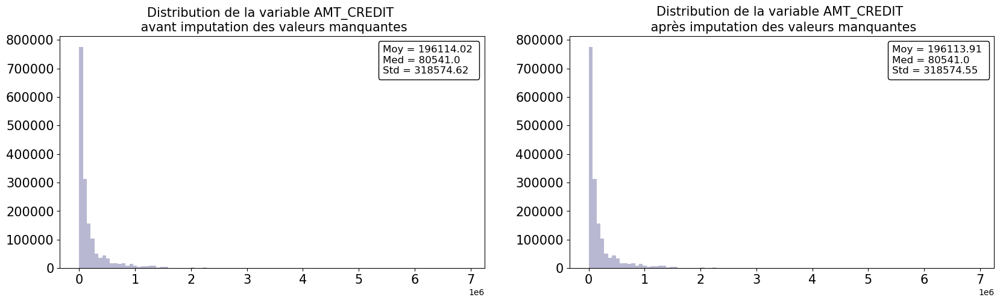

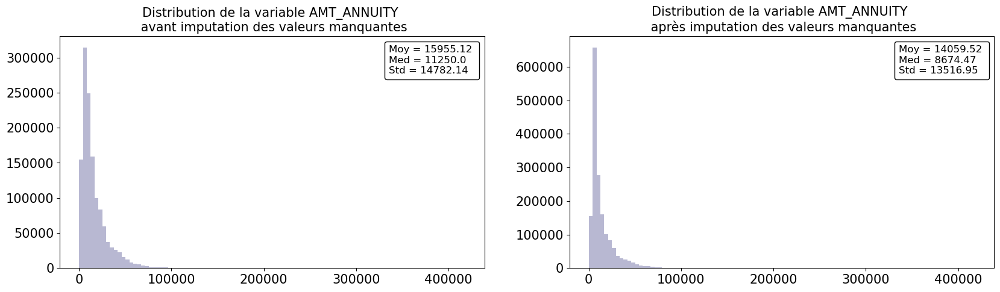

In [164]:
list_var_imp = ['AMT_CREDIT', 'AMT_ANNUITY']

for var in list_var_imp:
    fct_eda.distrib_imput_nan_quanti(previous_app_nan, var, previous_app_imp)

Les distributions de nos variables avant et après imputation des valeurs manquantes par iterative imputer sont relativement similaires, nous validons cette méthode.

<div class="alert alert-block alert-warning">
    <p>Médiane et mode pour variables avec taux de NaN > 70% (hors variable TARGET)</p>
</div>

In [165]:
previous_app_med = previous_app_imp.copy()

In [166]:
df_nan = fct_eda.nan_a_retraiter(previous_app_med)
df_nan

,Tx_rempl,nb_NaN,dtypes
PRODUCT_COMBINATION,99.98,346,object
CNT_PAYMENT,77.71,372230,float64
AMT_GOODS_PRICE,76.92,385515,float64


In [167]:
# Colonnes impactées
col_med = df_nan[(df_nan['Tx_rempl']>70) & 
                 (df_nan['dtypes'] == 'float64')].index.tolist()

# Imputation des variables par la médiane
for col in col_med:
    previous_app_med[col] = previous_app_med[col].fillna(previous_app_med[col].median())

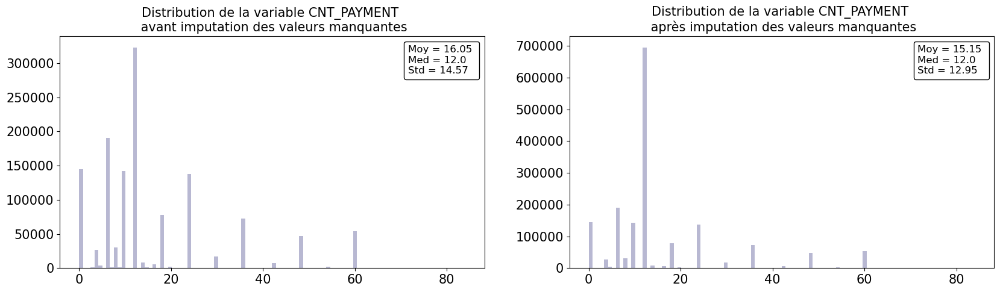

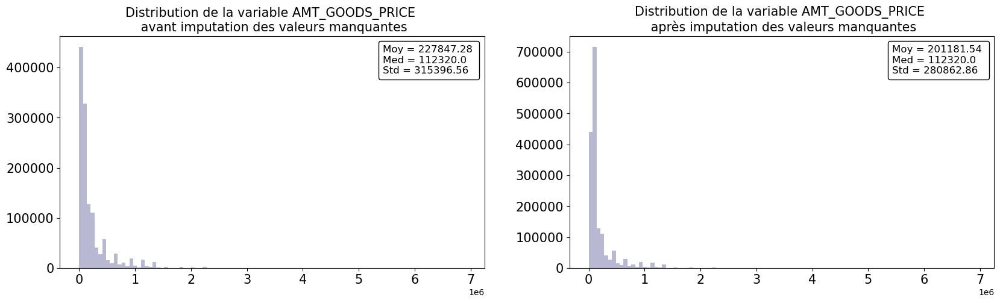

In [168]:
for var in col_med:
    fct_eda.distrib_imput_nan_quanti(previous_app_imp, var, previous_app_med)

Les distributions de nos variables avant et après imputation des valeurs manquantes par la médiane sont relativement similaires, nous validons cette méthode.

In [169]:
# Imputation de la variable NAME_TYPE_SUITE par le mode
previous_app_med['PRODUCT_COMBINATION'] = previous_app_med['PRODUCT_COMBINATION'].fillna(
    previous_app_med['PRODUCT_COMBINATION'].mode()[0])

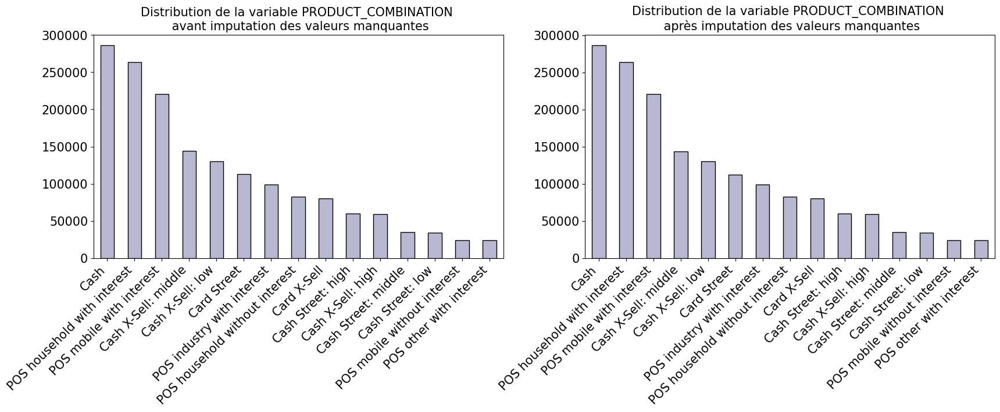

In [170]:
fct_eda.distrib_imput_nan_quali(previous_app_imp, 'PRODUCT_COMBINATION', previous_app_med)

In [171]:
del previous_app, previous_app_desc, previous_app_nan, previous_app_imp

#### Analyses univariées

In [172]:
previous_app_desc = previous_app_med.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [173]:
liste_col_quanti = previous_app_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique().index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR', 'SK_ID_PREV']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [174]:
len(liste_col_quanti)

9

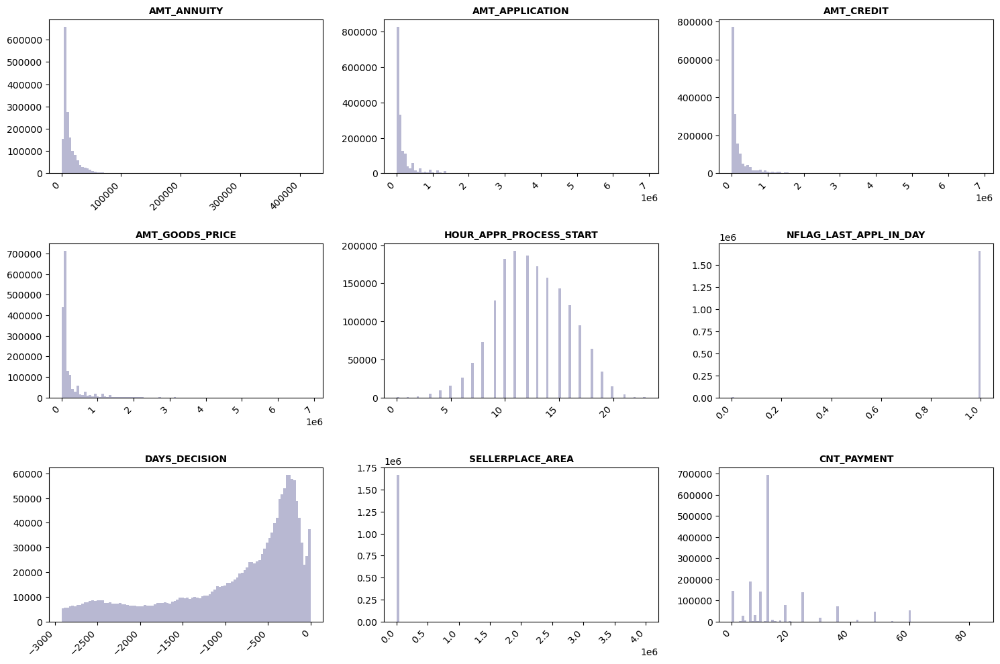

In [175]:
fig = plt.figure(figsize=(15,10))
fct_eda.univariate_plots_hist(previous_app_desc, liste_col_quanti, 3, 3, 100, fig=fig)

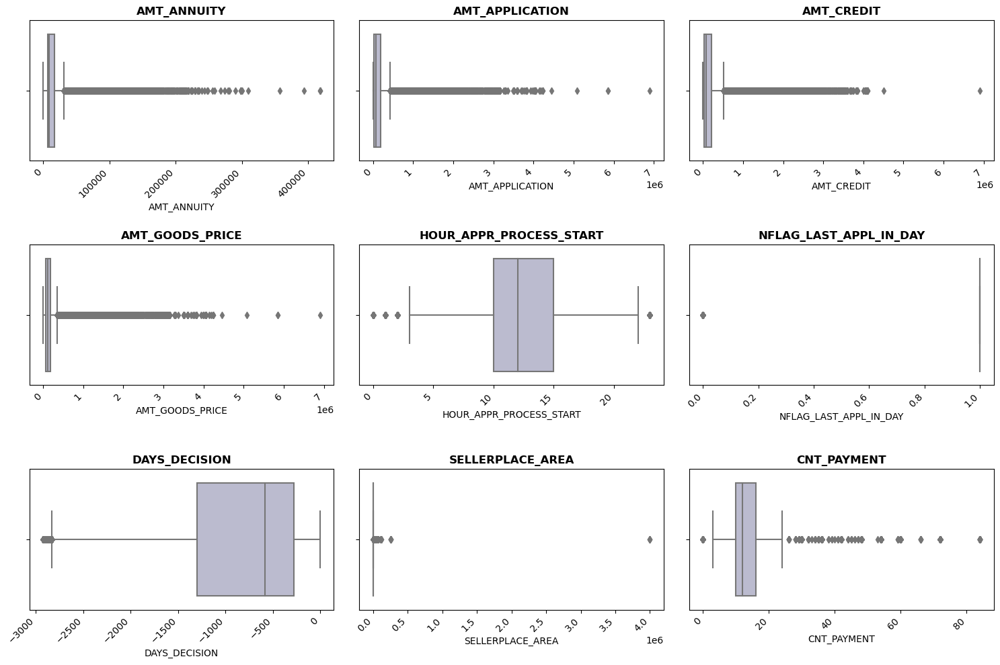

In [176]:
fig = plt.figure(figsize=(15,10))
fct_eda.univariate_plots_box(previous_app_desc, liste_col_quanti, 3, 3, fig, True)

In [177]:
previous_app_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
AMT_ANNUITY,1670214.00,14059.52,13516.95,0.00,7175.99,8674.47,16842.10,418058.15
AMT_APPLICATION,1670214.00,175233.86,292779.76,0.00,18720.00,71046.00,180360.00,6905160.00
AMT_CREDIT,1670214.00,196113.91,318574.55,0.00,24160.50,80541.00,216418.50,6905160.00
AMT_GOODS_PRICE,1670214.00,201181.54,280862.86,0.00,67500.00,112320.00,180405.00,6905160.00
HOUR_APPR_PROCESS_START,1670214.00,12.48,3.33,0.00,10.00,12.00,15.00,23.00
NFLAG_LAST_APPL_IN_DAY,1670214.00,1.00,0.06,0.00,1.00,1.00,1.00,1.00
DAYS_DECISION,1670214.00,-880.68,779.10,-2922.00,-1300.00,-581.00,-280.00,-1.00
SELLERPLACE_AREA,1670214.00,313.95,7127.44,-1.00,-1.00,3.00,82.00,4000000.00
CNT_PAYMENT,1670214.00,15.15,12.95,0.00,10.00,12.00,16.00,84.00


Nous allons supprimer les variables suivantes qui ne nous semblent pas avoir de grand intérêt dans cet exerice:
- SELLERPLACE_AREA (lieu de la demande précédente)
- NFLAG_LAST_APPL_IN_DAY (si la demande est la dernière de la journée)

In [178]:
del previous_app_desc['SELLERPLACE_AREA']
del previous_app_desc['NFLAG_LAST_APPL_IN_DAY']

In [179]:
# Nb d'années depuis la demande précédente
previous_app_desc['YEARS_DECISION'] = round(previous_app_desc['DAYS_DECISION'] / 365 * -1, 2)
del previous_app_desc['DAYS_DECISION']

In [180]:
liste_col_quali = previous_app_desc.select_dtypes(include='object').columns

In [181]:
len(liste_col_quali)

15

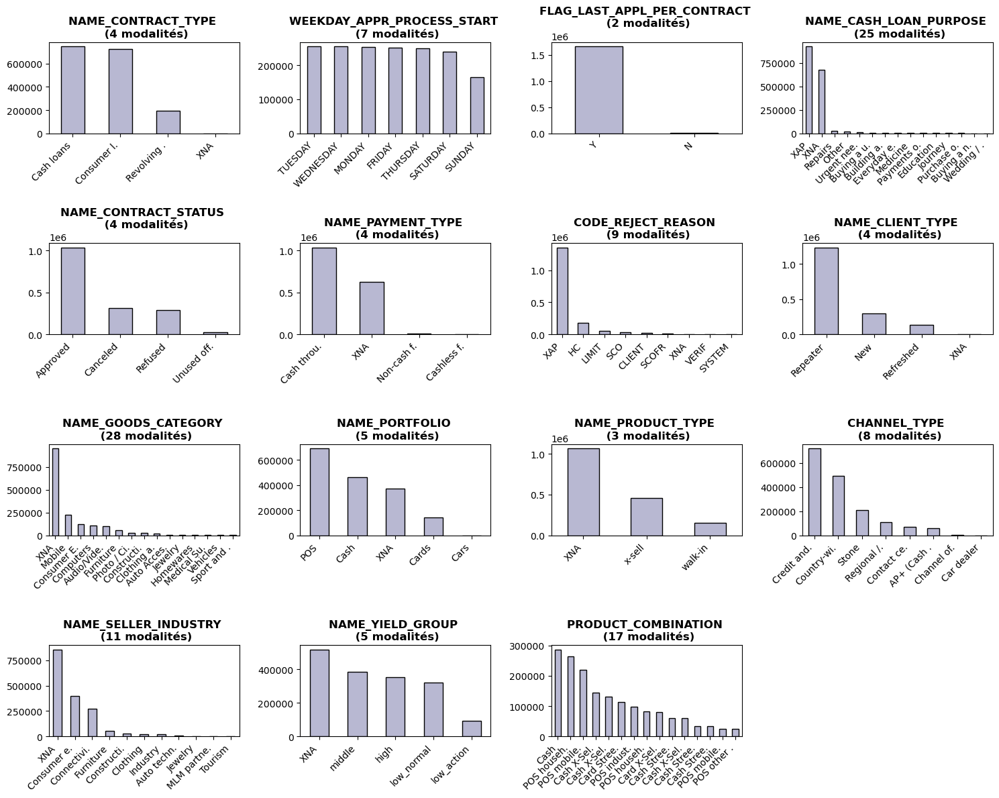

In [182]:
fig = plt.figure(figsize=(15, 12))
fct_eda.categ_distrib_plot(previous_app_desc, liste_col_quali, 4, 4, fig = fig)

La modalité XNA semble représenter les valeurs non affectées. Nous la conservons.

#### Analyses bivariées / multivariées

Nous allons intégrer la variable TARGET afin de mieux comprendre quelles variables ont une influence sur la capacité à rembourser l'emprunt.

In [183]:
previous_app_desc = previous_app_desc.merge(app_train_desc.reset_index()[['SK_ID_CURR', 'TARGET']],
                                            on = 'SK_ID_CURR',
                                            how = 'left')

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

In [184]:
liste_col_quanti = previous_app_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique().index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR', 'SK_ID_PREV']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

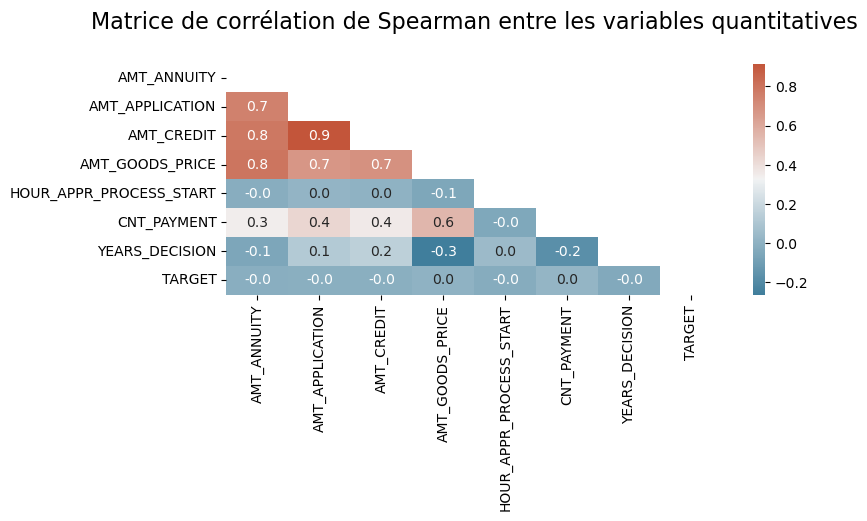

In [185]:
# Corrélation
corr = previous_app_desc[liste_col_quanti].corr('spearman')

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(8,3))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation de Spearman entre les variables quantitatives\n", fontsize=16);

Certaines variables sont très corrélées entre-elles. Nous tâcherons de ne pas les rajouter toutes dans le modèle ou d'en créer de nouvelles à l'aide du feature engineering.

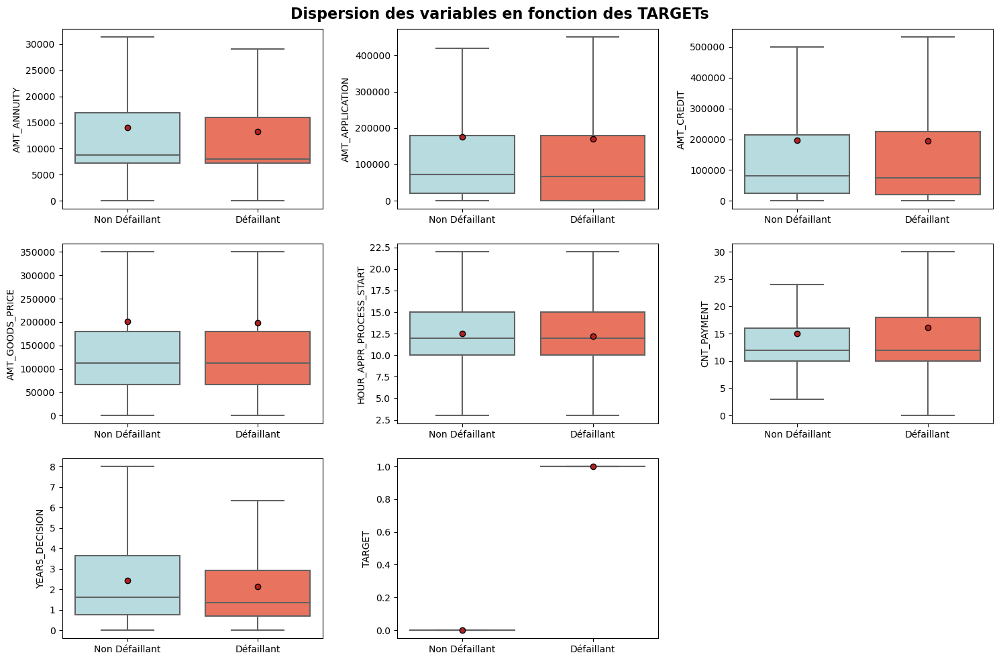

In [186]:
fig = plt.figure(figsize=(15,10))
fct_eda.bivariate_plots_box(previous_app_desc, 'TARGET', liste_col_quanti, 3, 3, fig)

Nous n'allons pas conserver les variables AMOUNT_APPLICATION, AMT_CREDIT, AMT_GOODS_PRICE qui sont fortement corrélées à la variable AMT_ANNUITY mais nous créerons de nouvelles variables dans la partie Feature Engineering.

In [187]:
Kruskal_Wallis_test(previous_app_desc, liste_col_quanti, 'TARGET')

Test non paramétrique de Kruskal Wallis: 

Variable AMT_ANNUITY par TARGET
pvaleur: 8.345035066326794e-87 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable AMT_APPLICATION par TARGET
pvaleur: 7.988578875072015e-58 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable AMT_CREDIT par TARGET
pvaleur: 8.913491204523379e-38 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable AMT_GOODS_PRICE par TARGET
pvaleur: 0.7999595610006303 > 0.05 => on accepte H0, les médianes entre les TARGET sont identiques
-----------------------------------------------------------------------------------
Variable HOUR_APPR_PROCESS_START par TARGET
pvaleur: 4.666384103853414e-222 < 

On ne peut pas dire que les médianes de la variable AMT_GOODS_PRICE par Target soient différentes. On ne conservera pas cette variable.

<div class="alert alert-block alert-warning">
    <p>Variables qualitatives et target</p>
</div>

NAME_CONTRACT_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


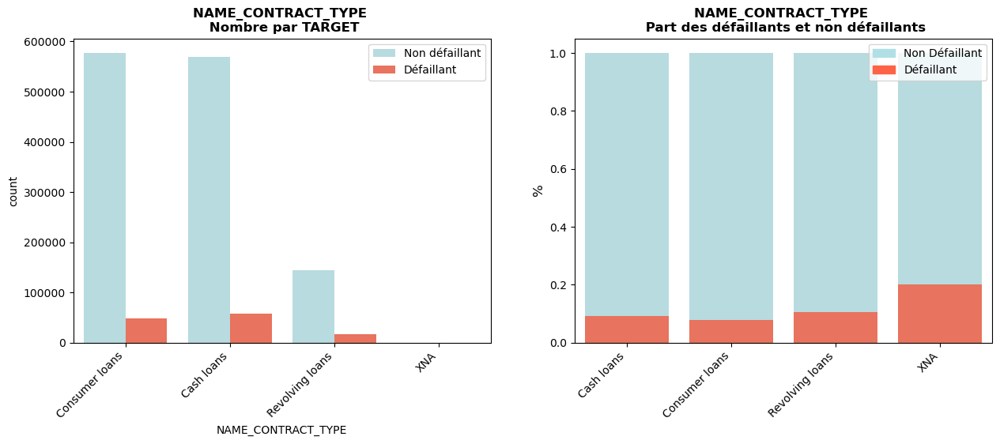

WEEKDAY_APPR_PROCESS_START vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.0949666054872996e-23 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


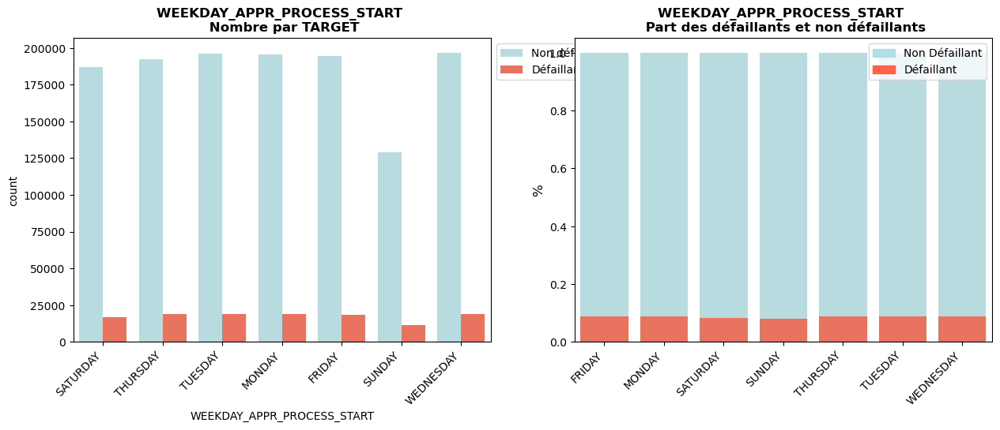

FLAG_LAST_APPL_PER_CONTRACT vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 4.711982898578498e-11 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


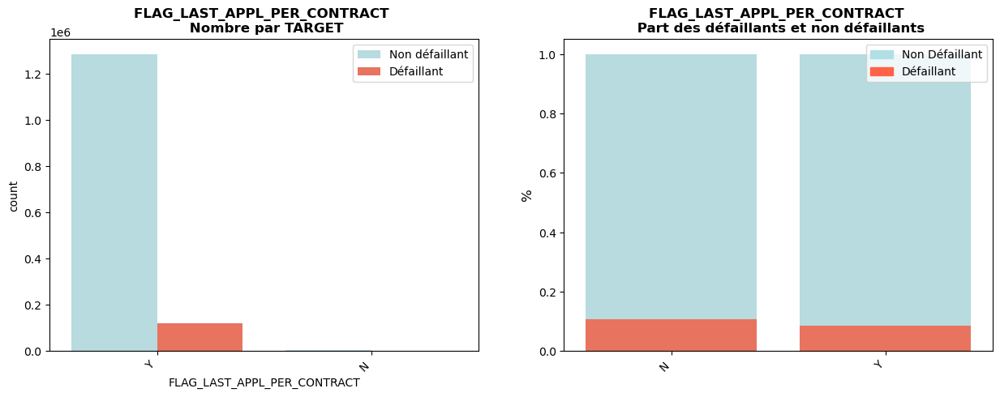

NAME_CASH_LOAN_PURPOSE vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


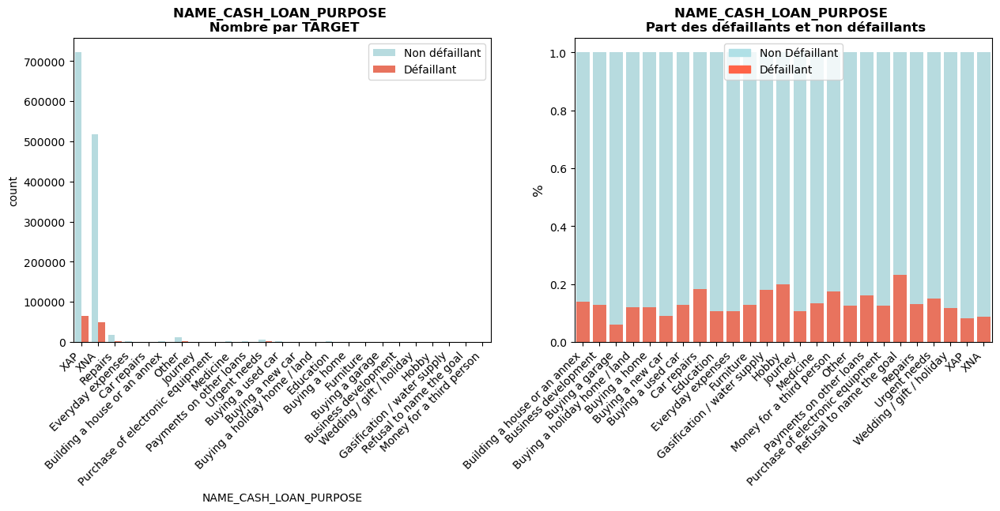

NAME_CONTRACT_STATUS vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


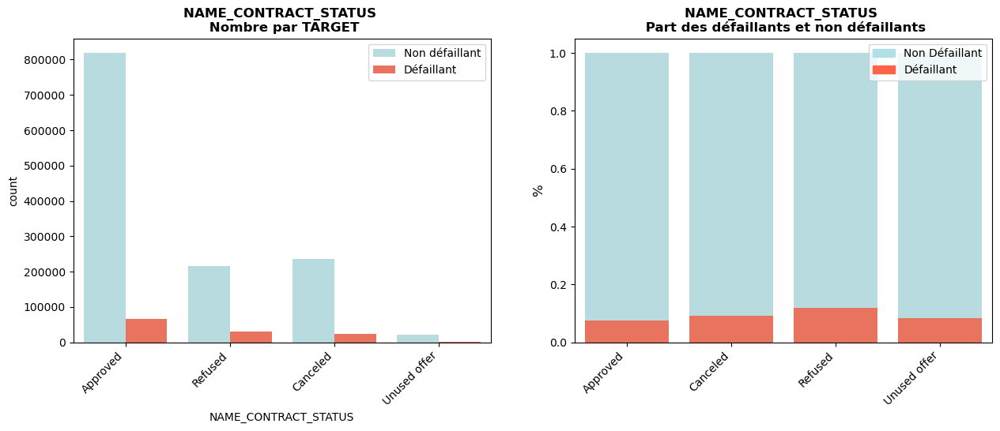

NAME_PAYMENT_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 1.477361225408243e-212 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


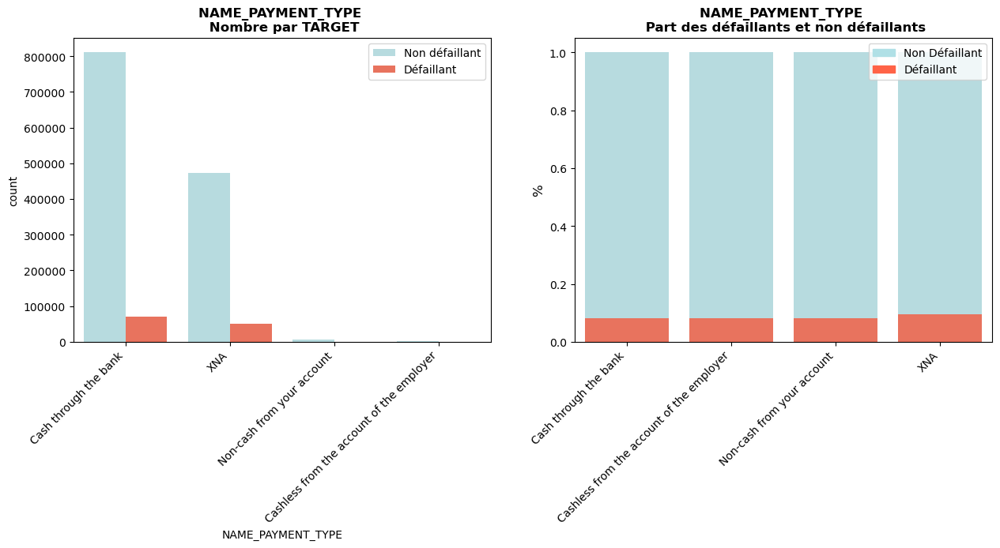

CODE_REJECT_REASON vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


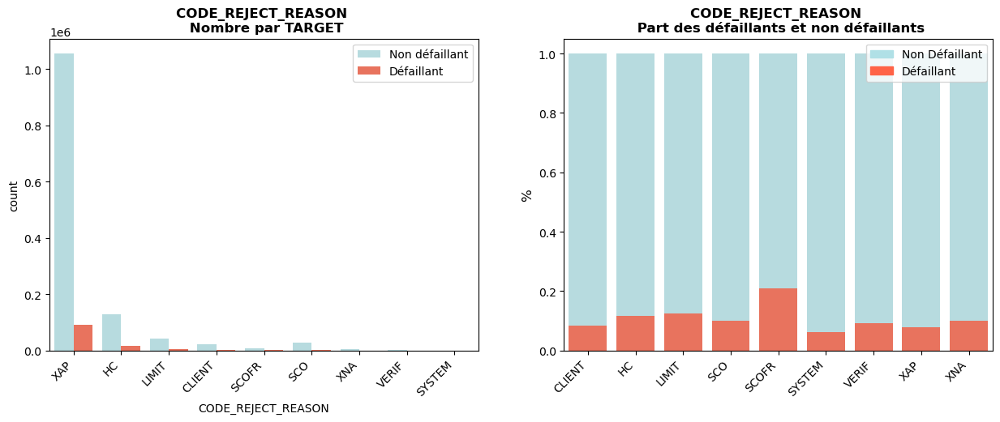

NAME_CLIENT_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 2.097910192575026e-64 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


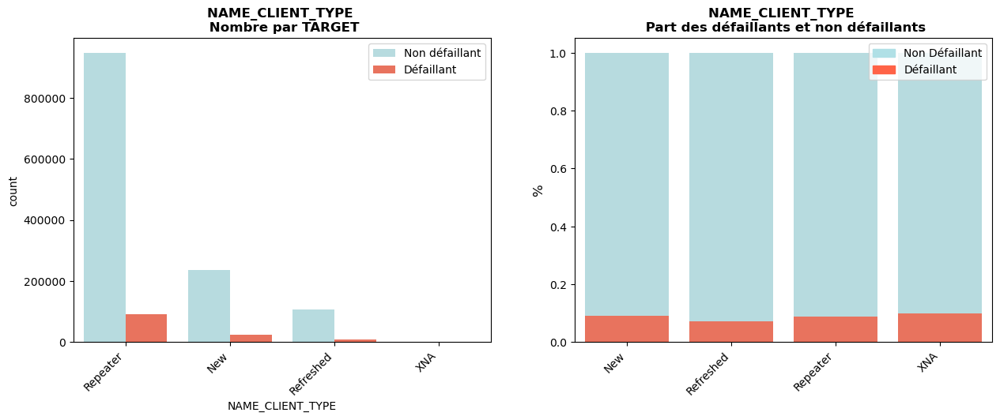

NAME_GOODS_CATEGORY vs TARGET
Au moins un effectif de la table de contingence < 5 => Test du Chi2 d'indépendance
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


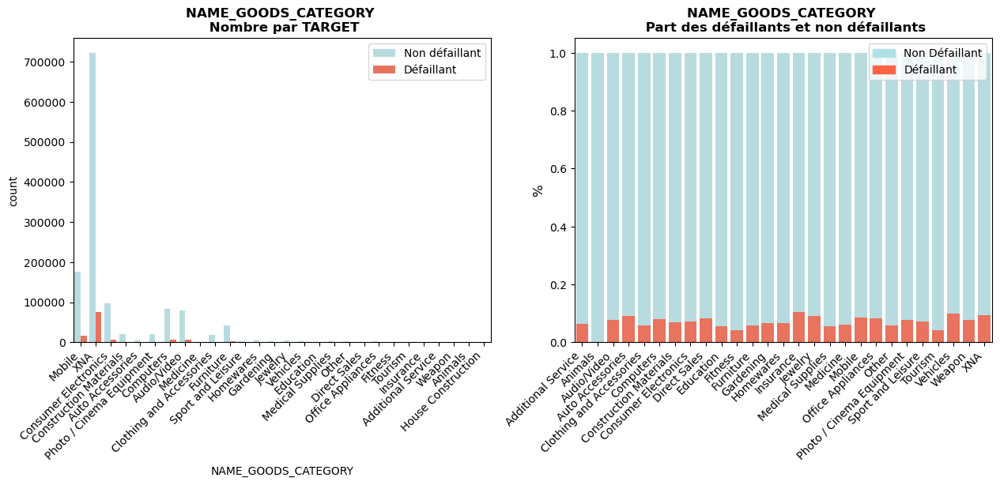

NAME_PORTFOLIO vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


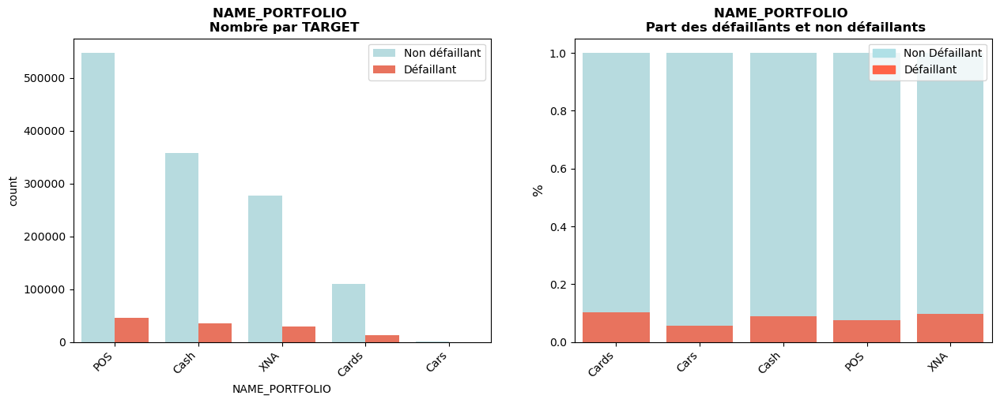

NAME_PRODUCT_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


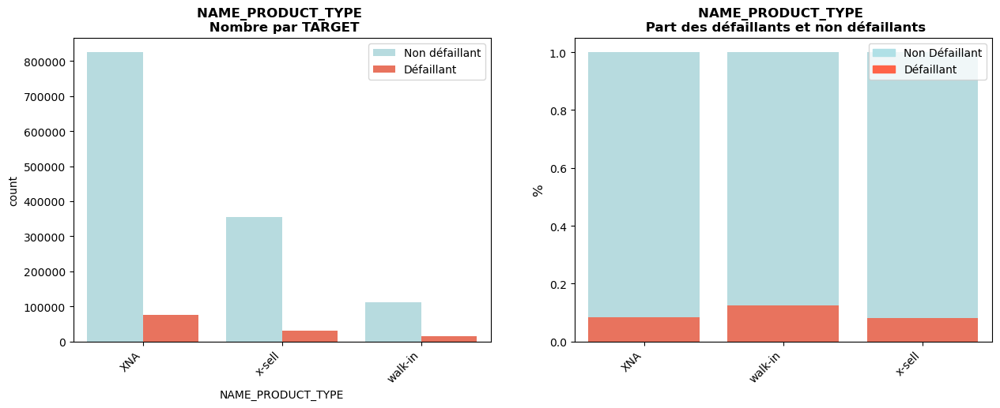

CHANNEL_TYPE vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


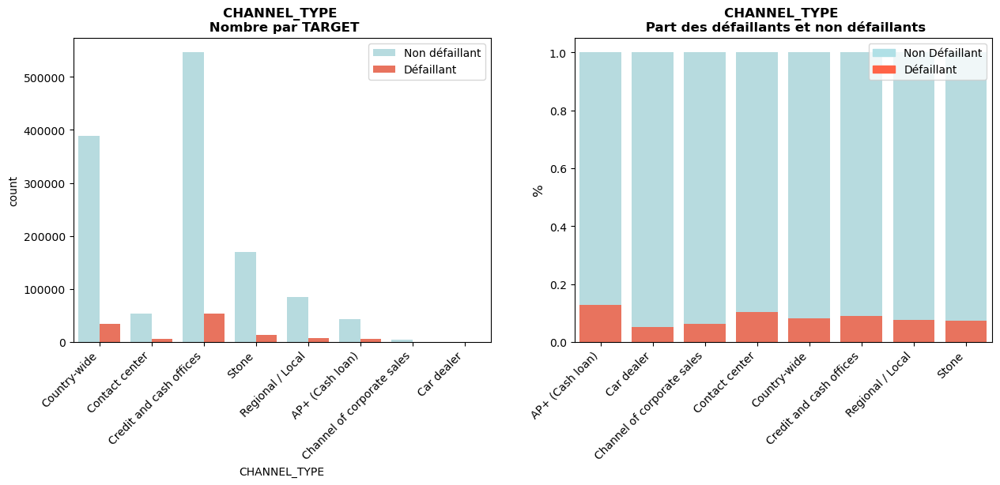

NAME_SELLER_INDUSTRY vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


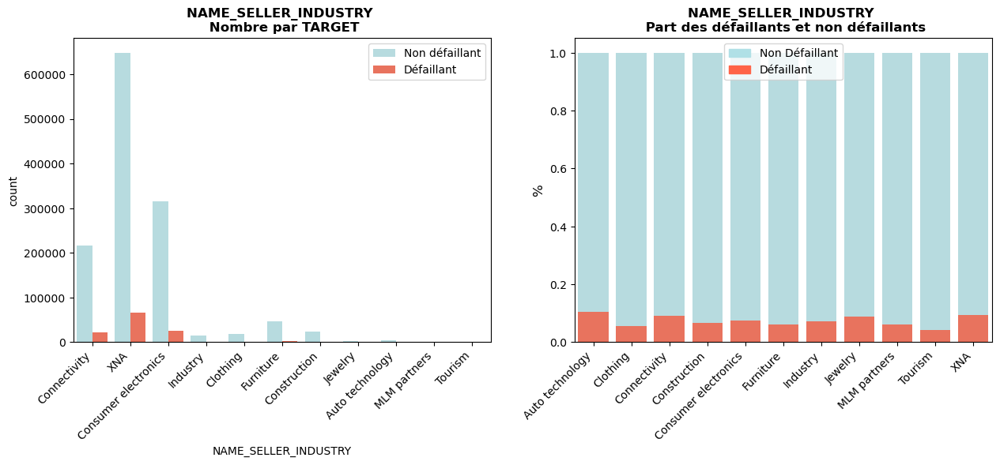

NAME_YIELD_GROUP vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


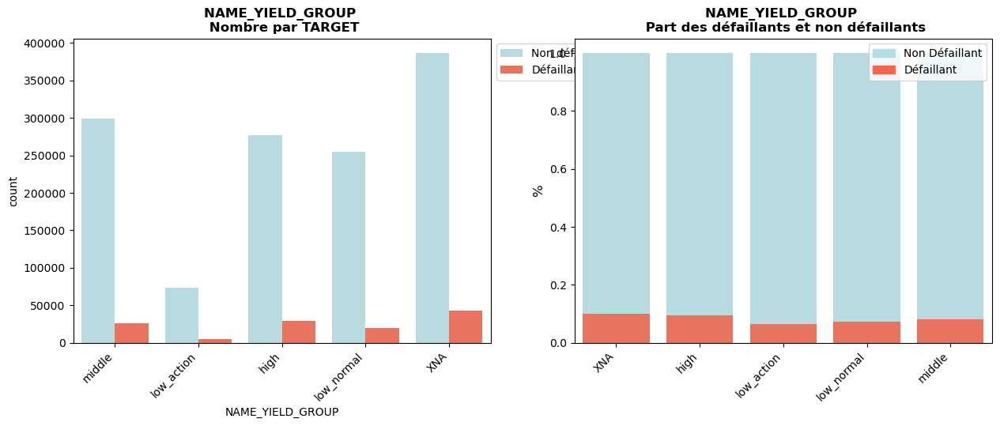

PRODUCT_COMBINATION vs TARGET
Chaque effectif de la table de contingence >= 5 => Test du Chi2 applicable
pvalue: 0.0 < 0.05 => on rejette H0, les variables sont dépendantes
-------------------------------------------------------------------


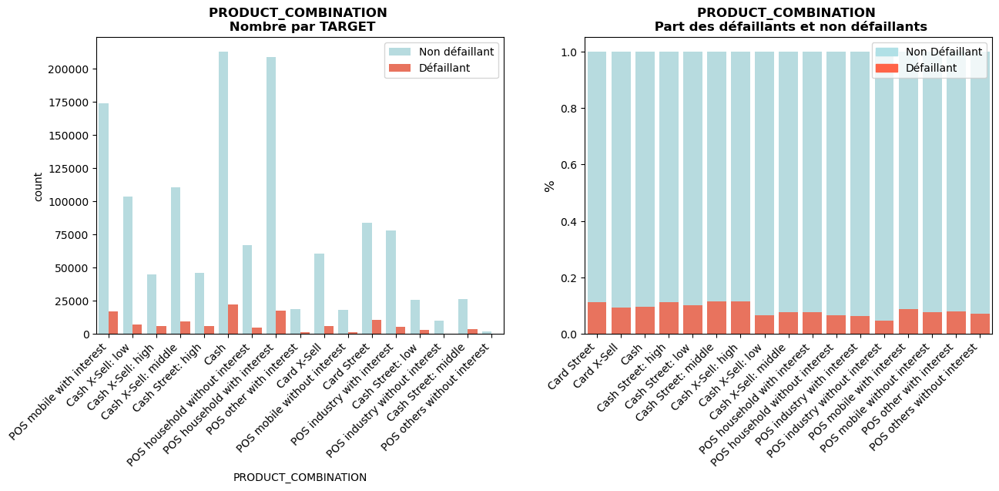

In [188]:
for var in liste_col_quali:
    fct_eda.bivariate_barplots_categ(previous_app_desc, var, 'TARGET')

L'association des variables qualitatives avec la target ayant été testée via Chi2, nous garderons pour le moment toutes les variables qualitatives.

In [189]:
previous_app_feat = previous_app_desc.copy()

#### Feature engineering

Ce dataset contient quelques variables identiques au dataset application_train. Nous allons créer lorsque c'est possible les mêmes ratios:
- **PREV_CREDIT_DURATION** durée du crédit. Plus on s'endette dans la durée, plus la banque prend un risque en prêtant de l’argent
- **PREV_CREDIT_GOODS_PERC**: pourcentage du crédit par rapport au montant du bien acheté
- **PREV_PAYMENT_RATE**: part de l'annuité dans le montant du crédit

Nous nous assurons auparavant de ne pas avoir de valeurs à 0 dans les variables utilisées pour le calcul de nos ratios.

In [190]:
previous_app_feat['CREDIT_DURATION'] = np.where(previous_app_feat['AMT_ANNUITY'] != 0, 
                                                previous_app_feat['AMT_CREDIT'] / previous_app_feat['AMT_ANNUITY'], 
                                                0)

In [191]:
previous_app_feat['CREDIT_GOODS_PERC'] = np.where(previous_app_feat['AMT_GOODS_PRICE'] != 0, 
                                                  previous_app_feat['AMT_CREDIT'] / previous_app_feat['AMT_GOODS_PRICE'], 
                                                  0)

In [192]:
previous_app_feat['PAYMENT_RATE'] = np.where(previous_app_feat['AMT_CREDIT'] != 0, 
                                             previous_app_feat['AMT_ANNUITY'] / previous_app_feat['AMT_CREDIT'],
                                             0)

Comme il y a **plusieurs lignes par SK_ID_CURR** correspondant aux anciens crédits, nous allons grouper notre table par SK_ID_CURR et agréger les variables pour obtenir la moyenne.

In [193]:
# Dictionnaire des agrégations pour les variables numériques
num_aggregations = {
    'SK_ID_PREV': ['count'],
    'YEARS_DECISION' : ['mean'],
    'CREDIT_DURATION': ['mean'],
    'CREDIT_GOODS_PERC': ['mean'],
    'PAYMENT_RATE' : ['mean'],
    }

Les variables catégorielles vont être encodées à l'aide du one-hot encoder:

In [194]:
previous_app_feat, previous_app_cat = fct_eda.categories_encoder(previous_app_feat, nan_as_category = False)
previous_app_feat.head()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,CNT_PAYMENT,YEARS_DECISION,TARGET,CREDIT_DURATION,CREDIT_GOODS_PERC,PAYMENT_RATE,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Consumer loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_CONTRACT_TYPE_XNA,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,NAME_CASH_LOAN_PURPOSE_Building a house or an annex,NAME_CASH_LOAN_PURPOSE_Business development,NAME_CASH_LOAN_PURPOSE_Buying a garage,NAME_CASH_LOAN_PURPOSE_Buying a holiday home / land,NAME_CASH_LOAN_PURPOSE_Buying a home,NAME_CASH_LOAN_PURPOSE_Buying a new car,NAME_CASH_LOAN_PURPOSE_Buying a used car,NAME_CASH_LOAN_PURPOSE_Car repairs,NAME_CASH_LOAN_PURPOSE_Education,NAME_CASH_LOAN_PURPOSE_Everyday expenses,NAME_CASH_LOAN_PURPOSE_Furniture,NAME_CASH_LOAN_PURPOSE_Gasification / water supply,NAME_CASH_LOAN_PURPOSE_Hobby,NAME_CASH_LOAN_PURPOSE_Journey,NAME_CASH_LOAN_PURPOSE_Medicine,NAME_CASH_LOAN_PURPOSE_Money for a third person,NAME_CASH_LOAN_PURPOSE_Other,NAME_CASH_LOAN_PURPOSE_Payments on other loans,NAME_CASH_LOAN_PURPOSE_Purchase of electronic equipment,NAME_CASH_LOAN_PURPOSE_Refusal to name the goal,NAME_CASH_LOAN_PURPOSE_Repairs,NAME_CASH_LOAN_PURPOSE_Urgent needs,NAME_CASH_LOAN_PURPOSE_Wedding / gift / holiday,NAME_CASH_LOAN_PURPOSE_XAP,NAME_CASH_LOAN_PURPOSE_XNA,NAME_CONTRACT_STATUS_Approved,NAME_CONTRACT_STATUS_Canceled,NAME_CONTRACT_STATUS_Refused,NAME_CONTRACT_STATUS_Unused offer,NAME_PAYMENT_TYPE_Cash through the bank,NAME_PAYMENT_TYPE_Cashless from the account of the employer,NAME_PAYMENT_TYPE_Non-cash from your account,NAME_PAYMENT_TYPE_XNA,CODE_REJECT_REASON_CLIENT,CODE_REJECT_REASON_HC,CODE_REJECT_REASON_LIMIT,CODE_REJECT_REASON_SCO,CODE_REJECT_REASON_SCOFR,CODE_REJECT_REASON_SYSTEM,CODE_REJECT_REASON_VERIF,CODE_REJECT_REASON_XAP,CODE_REJECT_REASON_XNA,NAME_CLIENT_TYPE_New,NAME_CLIENT_TYPE_Refreshed,NAME_CLIENT_TYPE_Repeater,NAME_CLIENT_TYPE_XNA,NAME_GOODS_CATEGORY_Additional Service,NAME_GOODS_CATEGORY_Animals,NAME_GOODS_CATEGORY_Audio/Video,NAME_GOODS_CATEGORY_Auto Accessories,NAME_GOODS_CATEGORY_Clothing and Accessories,NAME_GOODS_CATEGORY_Computers,NAME_GOODS_CATEGORY_Construction Materials,NAME_GOODS_CATEGORY_Consumer Electronics,NAME_GOODS_CATEGORY_Direct Sales,NAME_GOODS_CATEGORY_Education,NAME_GOODS_CATEGORY_Fitness,NAME_GOODS_CATEGORY_Furniture,NAME_GOODS_CATEGORY_Gardening,NAME_GOODS_CATEGORY_Homewares,NAME_GOODS_CATEGORY_House Construction,NAME_GOODS_CATEGORY_Insurance,NAME_GOODS_CATEGORY_Jewelry,NAME_GOODS_CATEGORY_Medical Supplies,NAME_GOODS_CATEGORY_Medicine,NAME_GOODS_CATEGORY_Mobile,NAME_GOODS_CATEGORY_Office Appliances,NAME_GOODS_CATEGORY_Other,NAME_GOODS_CATEGORY_Photo / Cinema Equipment,NAME_GOODS_CATEGORY_Sport and Leisure,NAME_GOODS_CATEGORY_Tourism,NAME_GOODS_CATEGORY_Vehicles,NAME_GOODS_CATEGORY_Weapon,NAME_GOODS_CATEGORY_XNA,NAME_PORTFOLIO_Cards,NAME_PORTFOLIO_Cars,NAME_PORTFOLIO_Cash,NAME_PORTFOLIO_POS,NAME_PORTFOLIO_XNA,NAME_PRODUCT_TYPE_XNA,NAME_PRODUCT_TYPE_walk-in,NAME_PRODUCT_TYPE_x-sell,CHANNEL_TYPE_AP+ (Cash loan),CHANNEL_TYPE_Car dealer,CHANNEL_TYPE_Channel of corporate sales,CHANNEL_TYPE_Contact center,CHANNEL_TYPE_Country-wide,CHANNEL_TYPE_Credit and cash offices,CHANNEL_TYPE_Regional / Local,CHANNEL_TYPE_Stone,NAME_SELLER_INDUSTRY_Auto technology,NAME_SELLER_INDUSTRY_Clothing,NAME_SELLER_INDUSTRY_Connectivity,NAME_SELLER_INDUSTRY_Construction,NAME_SELLER_INDUSTRY_Consumer electronics,NAME_SELLER_INDUSTRY_Furniture,NAME_SELLER_INDUSTRY_Industry,NAME_SELLER_INDUSTRY_Jewelry,NAME_SELLER_INDUSTRY_MLM partners,NAME_SELLER_INDUSTRY_Tourism,NAME_SELLER_INDUSTRY_XNA,NAME_YIELD_GROUP_XNA,NAME_YIELD_GROUP_high,NAME_YIELD_GROUP_low_action,NAME_YIELD_GROUP_low_normal,NAME_YIELD_GROUP_middle,PRODUCT_COMBINATION_Card St

In [195]:
# Dictionnaire des agrégations pour les variables catégorielles
cat_aggregations = {}
for cat in previous_app_cat:
    cat_aggregations[cat] = ['mean']

In [196]:
# Groupe par SK_ID_CURR + agrégation
previous_app_feat_gby = previous_app_feat.groupby('SK_ID_CURR').agg({**num_aggregations,
                                                                     **cat_aggregations})

In [197]:
# On renomme les colonnes pour supprimer le multiindex
previous_app_feat_gby.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() 
                                          for e in previous_app_feat_gby.columns.tolist()])

In [198]:
# On renomme SK_ID_PREV_COUNT en PREV_NB_CREDIT et YEARS_DECISION_MEAN en PREV_YEARS_DECISION_MEAN
previous_app_feat_gby = previous_app_feat_gby.rename(columns={'PREV_SK_ID_PREV_COUNT': 'PREV_NB_CREDIT'})

Nous allons calculer des indicateurs agrégés spécifiquement pour les statuts approuvés et refusés. Nous ne conserverons que les variables numériques et traiterons les valeurs manquantes selon la moyenne.

In [199]:
# Indicateurs agrégés crédits approuvés
cred_approuv = previous_app_feat[previous_app_feat['NAME_CONTRACT_STATUS_Approved'] == 1]
cred_approuv_agg = cred_approuv.groupby('SK_ID_CURR').agg(num_aggregations)
cred_approuv_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in cred_approuv_agg.columns.tolist()])
#cred_approuv_agg[~cred_approuv_agg.isin([np.inf, -np.inf]).any(1)]
previous_app_agg = previous_app_feat_gby.join(cred_approuv_agg, how = 'left', on = 'SK_ID_CURR')

# Indicateurs agrégés crédits refusés
cred_refus = previous_app_feat[previous_app_feat['NAME_CONTRACT_STATUS_Refused'] == 1]
cred_refus_agg = cred_refus.groupby('SK_ID_CURR').agg(num_aggregations)
cred_refus_agg.columns = pd.Index(['REFUSED' + e[0] + "_" + e[1].upper() for e in cred_refus_agg.columns.tolist()])
cred_refus_agg[~cred_refus_agg.isin([np.inf, -np.inf]).any(1)]
previous_app_agg = previous_app_agg.join(cred_refus_agg, how = 'left', on = 'SK_ID_CURR')

In [200]:
previous_app_agg.isna().sum().sort_values(ascending = False)

REFUSEDPAYMENT_RATE_MEAN                                                 220580
REFUSEDCREDIT_GOODS_PERC_MEAN                                            220580
REFUSEDCREDIT_DURATION_MEAN                                              220580
REFUSEDYEARS_DECISION_MEAN                                               220580
REFUSEDSK_ID_PREV_COUNT                                                  220580
APPROVED_YEARS_DECISION_MEAN                                               1159
APPROVED_SK_ID_PREV_COUNT                                                  1159
APPROVED_CREDIT_DURATION_MEAN                                              1159
APPROVED_CREDIT_GOODS_PERC_MEAN                                            1159
APPROVED_PAYMENT_RATE_MEAN                                                 1159
PREV_CHANNEL_TYPE_Channel of corporate sales_MEAN                             0
PREV_NAME_PORTFOLIO_XNA_MEAN                                                  0
PREV_NAME_PRODUCT_TYPE_XNA_MEAN         

Un crédit étant soit approuvé soit refusé, nous allons remplacer les valeurs manquantes de ces variables par la constante 0:

In [201]:
# Imputation des valeurs manquantes par la constante 0
for col in cred_approuv_agg.columns:
    previous_app_agg[col] = previous_app_agg[col].fillna(0)

for col in cred_refus_agg.columns:
    previous_app_agg[col] = previous_app_agg[col].fillna(0)

In [202]:
previous_app_agg.shape

(338857, 150)

#### Fonction de preprocessing

In [203]:
def preprocess_previous_app():
    '''Fonction de preprocessing du dataset previous application:
    traitement des données manquantes, feature engineering et 
    sélection de variables
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    
    # Chargement du dataset
    previous_app = pd.read_csv('data/previous_application.csv',
                           sep=',',
                           encoding='utf-8')
    
    
    # Traitement des données manquantes
    
    ## Suppression des variables avec 30% ou plus de NaN
    previous_app = fct_eda.tx_rempl_min(previous_app, 70)
    
    ##  Iterative imputer pour les variables corrélées entre-elles
    previous_app['AMT_CREDIT'] = fct_eda.iterative_imputer_function(
        previous_app[['AMT_CREDIT', 'AMT_APPLICATION']])[:,0]
    previous_app['AMT_ANNUITY'] = fct_eda.iterative_imputer_function(
        previous_app[['AMT_ANNUITY', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
                      'AMT_APPLICATION', 'CNT_PAYMENT']])[:,0]
    
    ##  Médiane et mode pour variables avec taux de NaN > 70% (hors variable TARGET)
    df_nan = fct_eda.nan_a_retraiter(previous_app)
    col_med = df_nan[(df_nan['Tx_rempl']>70) & 
                     (df_nan['dtypes'] == 'float64')].index.tolist()
    for col in col_med:
        previous_app[col] = previous_app[col].fillna(previous_app[col].median())
        # Imputation de la variable NAME_TYPE_SUITE par le mode
    previous_app['PRODUCT_COMBINATION'] = previous_app['PRODUCT_COMBINATION'].fillna(
        previous_app['PRODUCT_COMBINATION'].mode()[0])
    
    # Feature engineering
    previous_app_feat = previous_app.copy()
    del previous_app_feat['SELLERPLACE_AREA']
    del previous_app_feat['NFLAG_LAST_APPL_IN_DAY']

    ##  Nb d'années depuis la demande précédente
    previous_app_feat['YEARS_DECISION'] = round(previous_app_feat['DAYS_DECISION'] / 365 * -1, 2)
    del previous_app_feat['DAYS_DECISION']
    
    ##  Création des ratios
    previous_app_feat['CREDIT_DURATION'] = np.where(previous_app_feat['AMT_ANNUITY'] != 0, 
                                                previous_app_feat['AMT_CREDIT'] / previous_app_feat['AMT_ANNUITY'], 
                                                0)
    previous_app_feat['CREDIT_GOODS_PERC'] = np.where(previous_app_feat['AMT_GOODS_PRICE'] != 0, 
                                                  previous_app_feat['AMT_CREDIT'] / previous_app_feat['AMT_GOODS_PRICE'], 
                                                  0)
    previous_app_feat['PAYMENT_RATE'] = np.where(previous_app_feat['AMT_CREDIT'] != 0, 
                                             previous_app_feat['AMT_ANNUITY'] / previous_app_feat['AMT_CREDIT'],
                                             0)
    ##  Dictionnaire des agrégations pour les variables numériques
    num_aggregations = {
        'SK_ID_PREV': ['count'],
        'YEARS_DECISION' : ['mean'],
        'CREDIT_DURATION': ['mean'],
        'CREDIT_GOODS_PERC': ['mean'],
        'PAYMENT_RATE' : ['mean'],
        }
    
    ##  Aggrégations variables catégorielles
    previous_app_feat, previous_app_cat = fct_eda.categories_encoder(previous_app_feat, nan_as_category = False)
    cat_aggregations = {}
    for cat in previous_app_cat:
        cat_aggregations[cat] = ['mean']
        
    ##  Groupe par SK_ID_CURR + agrégation
    previous_app_feat_gby = previous_app_feat.groupby('SK_ID_CURR').agg({**num_aggregations,
                                                                         **cat_aggregations})
    
    ##  On renomme les colonnes pour supprimer le multiindex
    previous_app_feat_gby.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() 
                                              for e in previous_app_feat_gby.columns.tolist()])
    
    ##  On renomme SK_ID_PREV_COUNT en PREV_NB_CREDIT et YEARS_DECISION_MEAN en PREV_YEARS_DECISION_MEAN
    previous_app_feat_gby = previous_app_feat_gby.rename(columns={'PREV_SK_ID_PREV_COUNT': 'PREV_NB_CREDIT'})
    
    ##  Indicateurs agrégés crédits approuvés
    cred_approuv = previous_app_feat[previous_app_feat['NAME_CONTRACT_STATUS_Approved'] == 1]
    cred_approuv_agg = cred_approuv.groupby('SK_ID_CURR').agg(num_aggregations)
    cred_approuv_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in cred_approuv_agg.columns.tolist()])
    #cred_approuv_agg[~cred_approuv_agg.isin([np.inf, -np.inf]).any(1)]
    previous_app_agg = previous_app_feat_gby.join(cred_approuv_agg, how = 'left', on = 'SK_ID_CURR') 
    
    ##  Indicateurs agrégés crédits refusés
    cred_refus = previous_app_feat[previous_app_feat['NAME_CONTRACT_STATUS_Refused'] == 1]
    cred_refus_agg = cred_refus.groupby('SK_ID_CURR').agg(num_aggregations)
    cred_refus_agg.columns = pd.Index(['REFUSED' + e[0] + "_" + e[1].upper() for e in cred_refus_agg.columns.tolist()])
    cred_refus_agg[~cred_refus_agg.isin([np.inf, -np.inf]).any(1)]
    previous_app_agg = previous_app_agg.join(cred_refus_agg, how = 'left', on = 'SK_ID_CURR') 
    
    ##  Imputation des valeurs manquantes par la constante 0
    for col in cred_approuv_agg.columns:
        previous_app_agg[col] = previous_app_agg[col].fillna(0)
    for col in cred_refus_agg.columns:
        previous_app_agg[col] = previous_app_agg[col].fillna(0)
    
    del previous_app, previous_app_feat, previous_app_feat_gby, cred_approuv_agg, cred_refus_agg
    gc.collect()
    
    return previous_app_agg

In [204]:
preprocess_previous_app().shape

(338857, 150)

### POS_CASH_balance.csv <a class="anchor" id="cash"></a>

*Soldes mensuels des prêts précédents effectués en point de vente et des crédits de trésorerie (Prêt à dépenser)*

#### Principales statistiques

Cette table contient les **soldes mensuels des crédits antérieurs** effectués en point de vente (POS - point of sales) et des crédits de trésorerie que les clients ont contractés auprès de Home Credit.

Il y a **une ligne par mois d'historique** pour chaque crédit à la consommation et prêts au comptant antérieurs liés aux prêts de notre échantillon.

In [205]:
# Chargement du dataset
pos_cash = pd.read_csv('data/POS_CASH_balance.csv',
                       sep=',',
                       encoding='utf-8')

In [206]:
# Description des colonnes
col_desc[col_desc['Table'] == 'POS_CASH_balance.csv']

,Unnamed: 0,Table,Row,Description,Special
142,145,POS_CASH_balance.csv,SK_ID_PREV,"ID of previous credit in Home Credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit)",NaN
143,146,POS_CASH_balance.csv,SK_ID_CURR,ID of loan in our sample,NaN
144,147,POS_CASH_balance.csv,MONTHS_BALANCE,"Month of balance relative to application date (-1 means the information to the freshest monthly snapshot, 0 means the information at application - often it will be the same as -1 as many banks are not updating the information to Credit Bureau regularly )",time only relative to the application
145,148,POS_CASH_balance.csv,CNT_INSTALMENT,Term of previous credit (can change over time),NaN
146,149,POS_CASH_balance.csv,CNT_INSTALMENT_FUTURE,Installments left to pay on the previous credit,NaN
147,150,POS_CASH_balance.csv,NAME_CONTRACT_STATUS,Contract status during the month,NaN
148,151,POS_CASH_balance.csv,SK_DPD,DPD (days past due) during the month of previous credit,NaN
149,152,POS_CASH_balance.csv,SK_DPD_DEF,DPD during the month with tolerance (debts with low loan amounts are ignored) of the previous credit,NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.00,45.00,Active,0,0
1,1715348,367990,-33,36.00,35.00,Active,0,0
2,1784872,397406,-32,12.00,9.00,Active,0,0
3,1903291,269225,-35,48.00,42.00,Active,0,0
4,2341044,334279,-35,36.00,35.00,Active,0,0


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
10001353,2448283,226558,-20,6.00,0.00,Active,843,0
10001354,1717234,141565,-19,12.00,0.00,Active,602,0
10001355,1283126,315695,-21,10.00,0.00,Active,609,0
10001356,1082516,450255,-22,12.00,0.00,Active,614,0
10001357,1259607,174278,-52,16.00,0.00,Completed,0,0


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 10001358
Nombre de colonnes: 8
Nombre total de NaN du dataset: 52158
% total de NaN du dataset: 0.07%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


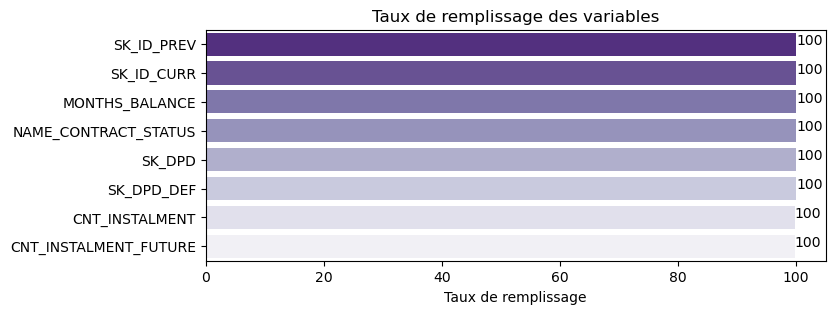

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_PREV,int64,1803195,10001358,936325,9.36,10001358,100.00,0,0.00
1,SK_ID_CURR,int64,182943,10001358,337252,3.37,10001358,100.00,0,0.00
2,MONTHS_BALANCE,int64,-31,10001358,96,0.00,10001358,100.00,0,0.00
3,CNT_INSTALMENT,float64,48.00,10001358,73,0.00,9975287,99.74,26071,0.26
4,CNT_INSTALMENT_FUTURE,float64,45.00,10001358,79,0.00,9975271,99.74,26087,0.26
5,NAME_CONTRACT_STATUS,object,Active,10001358,9,0.00,10001358,100.00,0,0.00
6,SK_DPD,int64,0,10001358,3400,0.03,10001358,100.00,0,0.00
7,SK_DPD_DEF,int64,0,10001358,2307,0.02,10001358,100.00,0,0.00


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [207]:
fig = plt.figure(figsize=(8,3))
previous_app_desc = fct_eda.describe_stat(pos_cash, fig = fig)

#### Traitement des données manquantes

Il y a peu de données manquantes dans ce dataset. Nous allons les compléter par la **médiane**.

In [208]:
pos_cash_nan = pos_cash.copy()

In [209]:
# Imputation des variables par la médiane
for col in ['CNT_INSTALMENT', 'CNT_INSTALMENT_FUTURE']:
    pos_cash_nan[col] = pos_cash_nan[col].fillna(pos_cash_nan[col].median())

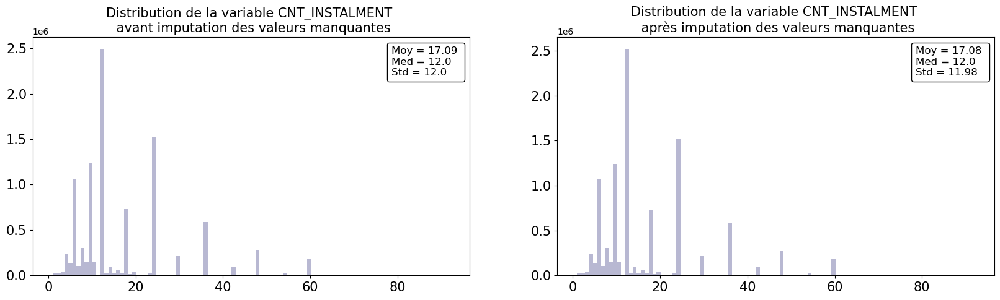

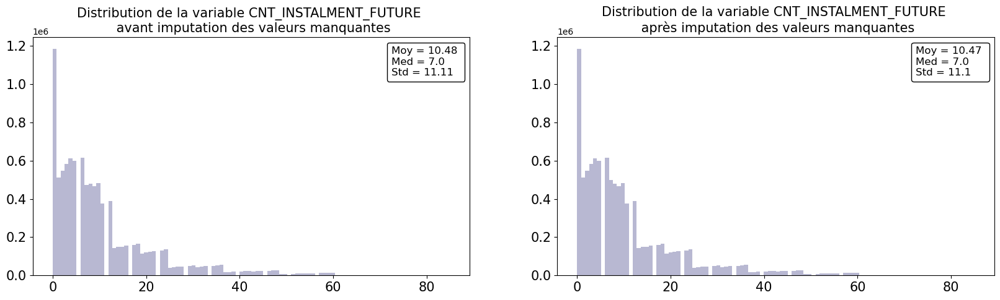

In [210]:
for var in ['CNT_INSTALMENT', 'CNT_INSTALMENT_FUTURE']:
    fct_eda.distrib_imput_nan_quanti(pos_cash, var, pos_cash_nan)

Les distributions sont quasiment identiques, nous validons la méthode.

#### Analyses univariées

In [211]:
pos_cash_desc = pos_cash_nan.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [212]:
liste_col_quanti = pos_cash_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique().index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR', 'SK_ID_PREV']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [213]:
len(liste_col_quanti)

5

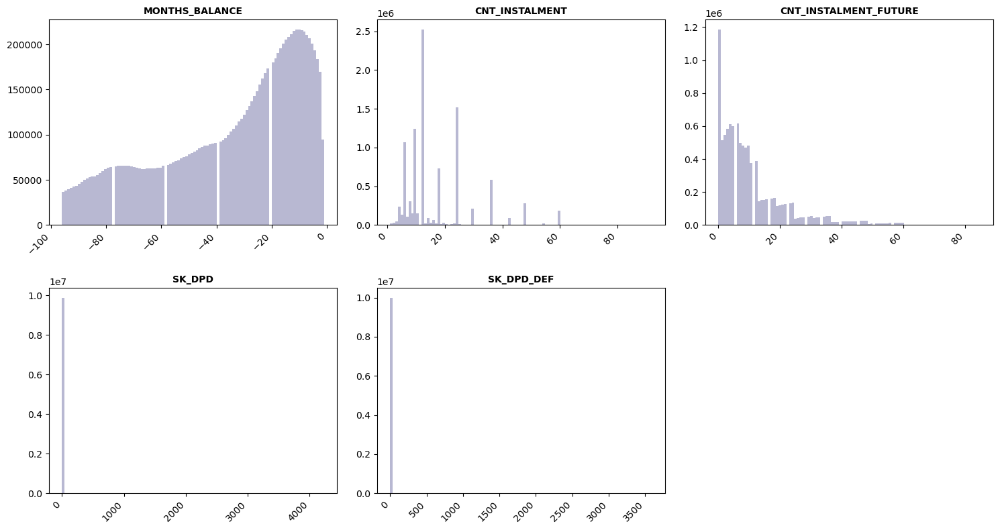

In [214]:
fig = plt.figure(figsize=(15,8))
fct_eda.univariate_plots_hist(pos_cash_desc, liste_col_quanti, 2, 3, 100, fig=fig)

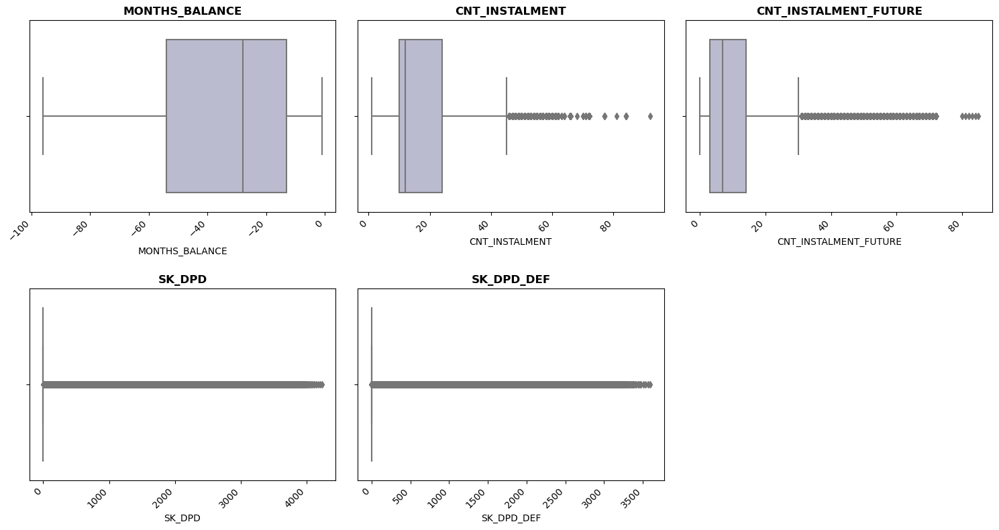

In [215]:
fig = plt.figure(figsize=(15,8))
fct_eda.univariate_plots_box(pos_cash_desc, liste_col_quanti, 2, 3, fig, True)

In [216]:
pos_cash_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
MONTHS_BALANCE,10001358.00,-35.01,26.07,-96.00,-54.00,-28.00,-13.00,-1.00
CNT_INSTALMENT,10001358.00,17.08,11.98,1.00,10.00,12.00,24.00,92.00
CNT_INSTALMENT_FUTURE,10001358.00,10.47,11.10,0.00,3.00,7.00,14.00,85.00
SK_DPD,10001358.00,11.61,132.71,0.00,0.00,0.00,0.00,4231.00
SK_DPD_DEF,10001358.00,0.65,32.76,0.00,0.00,0.00,0.00,3595.00


Nous supprimons les variables SK_DPD et SK_DPD_DEF:

In [217]:
del pos_cash_desc['SK_DPD']
del pos_cash_desc['SK_DPD_DEF']

In [218]:
liste_col_quanti_suppr = ['SK_DPD', 'SK_DPD_DEF']
liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [219]:
liste_col_quali = pos_cash_desc.select_dtypes(include='object').columns

In [220]:
len(liste_col_quali)

1

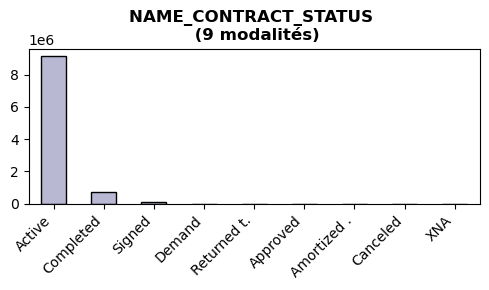

In [221]:
fig = plt.figure(figsize=(5, 3))
fct_eda.categ_distrib_plot(pos_cash_desc, liste_col_quali, 1, 1, fig = fig)

Quasi tous les contrats étant actifs, nous pouvons supprimer cette variable:

In [222]:
del pos_cash_desc['NAME_CONTRACT_STATUS']

#### Analyses bivariées / multivariées

Nous allons intégrer la variable TARGET afin de mieux comprendre quelles variables ont une influence sur la capacité à rembourser l'emprunt.

In [223]:
pos_cash_desc = pos_cash_desc.merge(app_train_desc.reset_index()[['SK_ID_CURR', 'TARGET']],
                                    on = 'SK_ID_CURR',
                                    how = 'left')

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

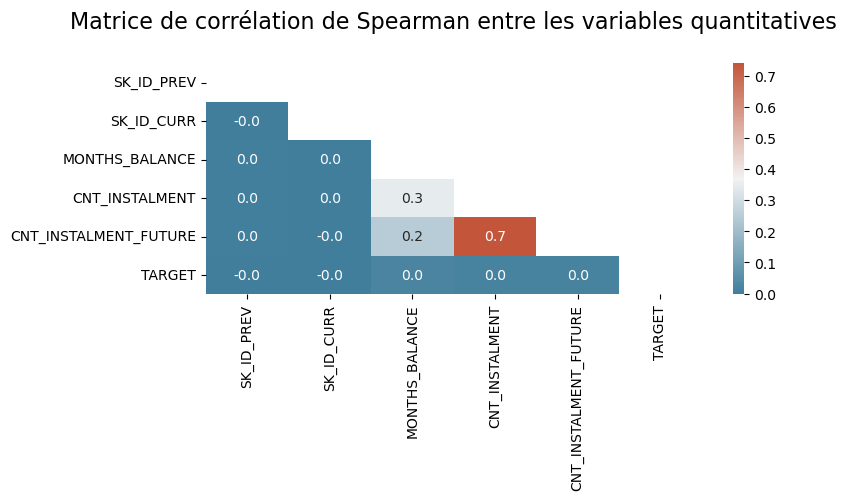

In [224]:
# Corrélation
corr = pos_cash_desc.corr('spearman')

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(8,3))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation de Spearman entre les variables quantitatives\n", fontsize=16);

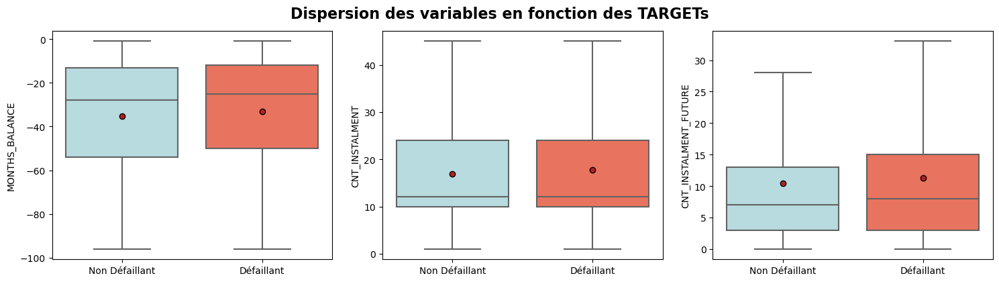

In [225]:
fig = plt.figure(figsize=(15,8))
fct_eda.bivariate_plots_box(pos_cash_desc, 'TARGET', liste_col_quanti, 2, 3, fig)

Les variables CNT_INSTALMENT_FUTURE et CNT_INSTALMENT sont extêmement corrélées, nous n'en garderons qu'une seule.
D'après les boxplots, nous conservons CNT_INSTALMENT_FUTURE qui est visuellement plus significative.

In [226]:
del pos_cash_desc['CNT_INSTALMENT']

In [227]:
liste_col_quanti_suppr = ['CNT_INSTALMENT']
liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [228]:
Kruskal_Wallis_test(pos_cash_desc, liste_col_quanti, 'TARGET')

Test non paramétrique de Kruskal Wallis: 

Variable MONTHS_BALANCE par TARGET
pvaleur: 0.0 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable CNT_INSTALMENT_FUTURE par TARGET
pvaleur: 0.0 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------


In [229]:
pos_cash_feat = pos_cash_desc.copy()

#### Feature engineering

Comme il y a **plusieurs lignes par SK_ID_CURR** correspondant mois d'historique, nous allons grouper notre table par SK_ID_CURR et agréger les variables pour obtenir la moyenne pour MONTHS_BALANCE et CNT_INSTALMENT_FUTURE ainsi que le nombre de mois d'historique).

In [230]:
# Dictionnaire des agrégations pour les variables numériques
aggregations = {
    'MONTHS_BALANCE': ['mean'],
    'CNT_INSTALMENT_FUTURE': ['mean'],
    'SK_ID_PREV': ['count']
}

In [231]:
# Groupe par SK_ID_CURR + agrégation
pos_cash_feat_gby = pos_cash_feat.groupby('SK_ID_CURR').agg(aggregations)

In [232]:
# On renomme les colonnes pour supprimer le multi-index
pos_cash_feat_gby.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() 
                                      for e in pos_cash_feat_gby.columns.tolist()])

In [233]:
# On renomme POS_SK_ID_PREV_COUNT en POS_NB_CREDIT
pos_cash_feat_gby = pos_cash_feat_gby.rename(columns={'POS_SK_ID_PREV_COUNT': 'POS_NB_CREDIT'})

In [234]:
pos_cash_feat_gby.head()

,POS_MONTHS_BALANCE_MEAN,POS_CNT_INSTALMENT_FUTURE_MEAN,POS_NB_CREDIT
SK_ID_CURR,,,
100001,-72.56,1.44,9
100002,-10.00,15.00,19
100003,-43.79,5.79,28
100004,-25.50,2.25,4
100005,-20.00,7.18,11


In [235]:
pos_cash_feat_gby.isna().sum().sort_values(ascending = False)

POS_MONTHS_BALANCE_MEAN           0
POS_CNT_INSTALMENT_FUTURE_MEAN    0
POS_NB_CREDIT                     0
dtype: int64

In [236]:
pos_cash_feat_gby.shape

(337252, 3)

#### Fonction de preprocessing

In [237]:
def preprocess_POS_CASH_balance():
    '''Fonction de preprocessing du dataset POS_CASH_balance:
    traitement des données manquantes, feature engineering et 
    sélection de variables
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    
    # Chargement du dataset
    pos_cash = pd.read_csv('data/POS_CASH_balance.csv',
                           sep=',',
                           encoding='utf-8')
    
    # Traitement des données manquantes (médiane)
    for col in ['CNT_INSTALMENT', 'CNT_INSTALMENT_FUTURE']:
        pos_cash[col] = pos_cash[col].fillna(pos_cash[col].median())

    # Feature engineering
    del pos_cash['SK_DPD']
    del pos_cash['SK_DPD_DEF']
    del pos_cash['NAME_CONTRACT_STATUS']
    del pos_cash['CNT_INSTALMENT']
    pos_cash_feat, pos_cash_cat = fct_eda.categories_encoder(pos_cash, nan_as_category = False)
    
    ## Dictionnaire des agrégations pour les variables numériques
    aggregations = {
    'MONTHS_BALANCE': ['mean'],
    'CNT_INSTALMENT_FUTURE': ['mean'],
    'SK_ID_PREV': ['count']
    }
    
    ## Groupe par SK_ID_CURR + agrégation
    pos_cash_feat_gby = pos_cash_feat.groupby('SK_ID_CURR').agg(aggregations)
    
    ## On renomme les colonnes pour supprimer le multi-index
    pos_cash_feat_gby.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() 
                                          for e in pos_cash_feat_gby.columns.tolist()])
    ## On renomme POS_SK_ID_PREV_COUNT en POS_NB_CREDIT
    pos_cash_feat_gby = pos_cash_feat_gby.rename(columns={'POS_SK_ID_PREV_COUNT': 'POS_NB_CREDIT'})

    del pos_cash, pos_cash_feat

    gc.collect()
    
    return pos_cash_feat_gby

In [238]:
preprocess_POS_CASH_balance().shape

(337252, 3)

### installments_payments.csv <a class="anchor" id="install"></a>

*Historique des remboursements de chaque prêt chez Prêt à dépenser*

#### Principales statistiques

Ce dataset contient **l'historique des remboursements de chaque prêt** des clients de Home Crédit présents dans notre échantillon.

Il y a:
- une ligne pour chaque paiement effectué
- une ligne pour chaque paiement manqué

Une ligne équivaut à un paiement d'une mensualité OU à une mensualité correspondant à un paiement d'un précédent crédit à domicile lié aux prêts de notre échantillon.

In [239]:
# Chargement du dataset
install_pay = pd.read_csv('data/installments_payments.csv',
                          sep=',',
                          encoding='utf-8')

In [240]:
# Description des colonnes
col_desc[col_desc['Table'] == 'installments_payments.csv']

,Unnamed: 0,Table,Row,Description,Special
211,214,installments_payments.csv,SK_ID_PREV,"ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit)",hashed
212,215,installments_payments.csv,SK_ID_CURR,ID of loan in our sample,hashed
213,216,installments_payments.csv,NUM_INSTALMENT_VERSION,Version of installment calendar (0 is for credit card) of previous credit. Change of installment version from month to month signifies that some parameter of payment calendar has changed,NaN
214,217,installments_payments.csv,NUM_INSTALMENT_NUMBER,On which installment we observe payment,NaN
215,218,installments_payments.csv,DAYS_INSTALMENT,When the installment of previous credit was supposed to be paid (relative to application date of current loan),time only relative to the application
216,219,installments_payments.csv,DAYS_ENTRY_PAYMENT,When was the installments of previous credit paid actually (relative to application date of current loan),time only relative to the application
217,220,installments_payments.csv,AMT_INSTALMENT,What was the prescribed installment amount of previous credit on this installment,NaN
218,221,installments_payments.csv,AMT_PAYMENT,What the client actually paid on previous credit on this installment,NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.00,6,-1180.00,-1187.00,6948.36,6948.36
1,1330831,151639,0.00,34,-2156.00,-2156.00,1716.53,1716.53
2,2085231,193053,2.00,1,-63.00,-63.00,25425.00,25425.00
3,2452527,199697,1.00,3,-2418.00,-2426.00,24350.13,24350.13
4,2714724,167756,1.00,2,-1383.00,-1366.00,2165.04,2160.59


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
13605396,2186857,428057,0.00,66,-1624.00,NaN,67.50,NaN
13605397,1310347,414406,0.00,47,-1539.00,NaN,67.50,NaN
13605398,1308766,402199,0.00,43,-7.00,NaN,43737.43,NaN
13605399,1062206,409297,0.00,43,-1986.00,NaN,67.50,NaN
13605400,2448869,434321,1.00,19,-27.00,NaN,11504.25,NaN


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 13605401
Nombre de colonnes: 8
Nombre total de NaN du dataset: 5810
% total de NaN du dataset: 0.01%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


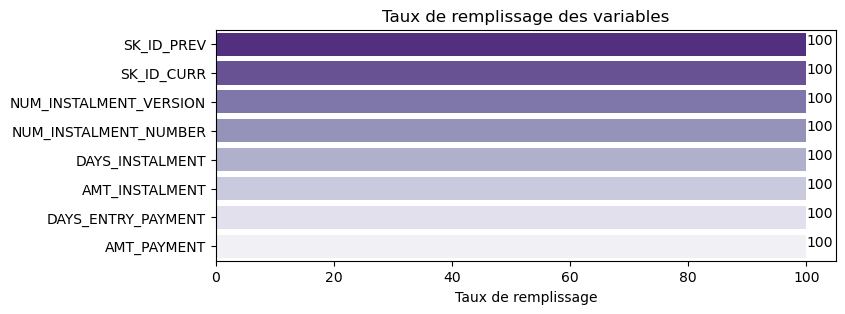

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_PREV,int64,1054186,13605401,997752,7.33,13605401,100.00,0,0.00
1,SK_ID_CURR,int64,161674,13605401,339587,2.50,13605401,100.00,0,0.00
2,NUM_INSTALMENT_VERSION,float64,1.00,13605401,65,0.00,13605401,100.00,0,0.00
3,NUM_INSTALMENT_NUMBER,int64,6,13605401,277,0.00,13605401,100.00,0,0.00
4,DAYS_INSTALMENT,float64,-1180.00,13605401,2922,0.02,13605401,100.00,0,0.00
5,DAYS_ENTRY_PAYMENT,float64,-1187.00,13605401,3039,0.02,13602496,99.98,2905,0.02
6,AMT_INSTALMENT,float64,6948.36,13605401,902539,6.63,13605401,100.00,0,0.00
7,AMT_PAYMENT,float64,6948.36,13605401,944235,6.94,13602496,99.98,2905,0.02


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [241]:
fig = plt.figure(figsize=(8,3))
install_pay_desc = fct_eda.describe_stat(install_pay, fig = fig)

#### Traitement des données manquantes

Il y a peu de données manquantes dans ce dataset. Nous allons les compléter par la **médiane**.

In [242]:
install_pay_nan = install_pay.copy()

In [243]:
# Imputation des variables par la médiane
for col in ['DAYS_ENTRY_PAYMENT', 'AMT_PAYMENT']:
    install_pay_nan[col] = install_pay_nan[col].fillna(install_pay_nan[col].median())

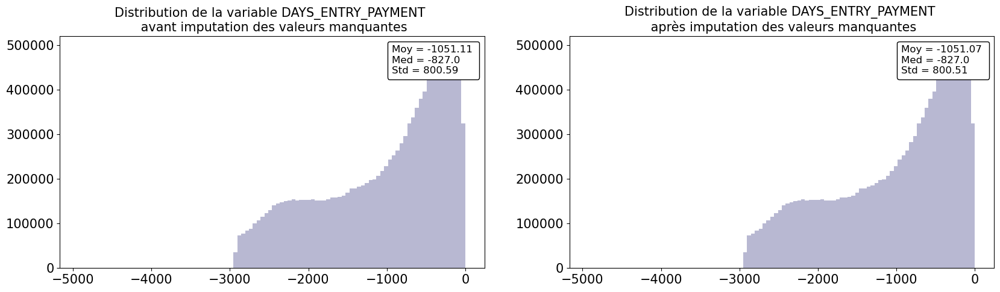

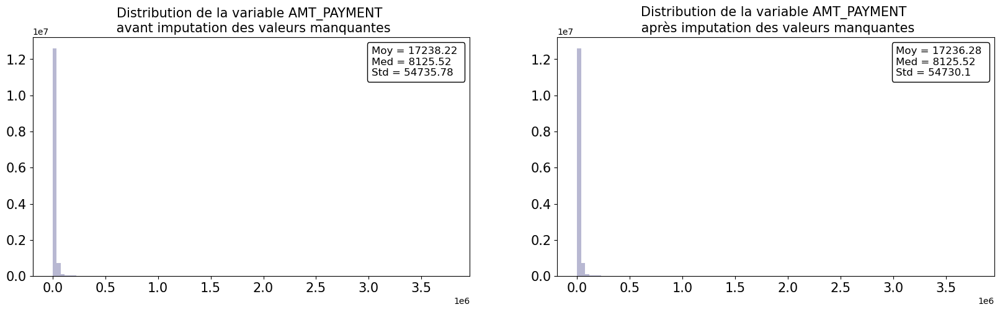

In [244]:
for var in ['DAYS_ENTRY_PAYMENT', 'AMT_PAYMENT']:
    fct_eda.distrib_imput_nan_quanti(install_pay, var, install_pay_nan)

Les distributions sont quasiment identiques, nous validons la méthode.

#### Analyses univariées

In [245]:
install_pay_desc = install_pay_nan.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [246]:
liste_col_quanti = install_pay_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique().index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR', 'SK_ID_PREV']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [247]:
len(liste_col_quanti)

6

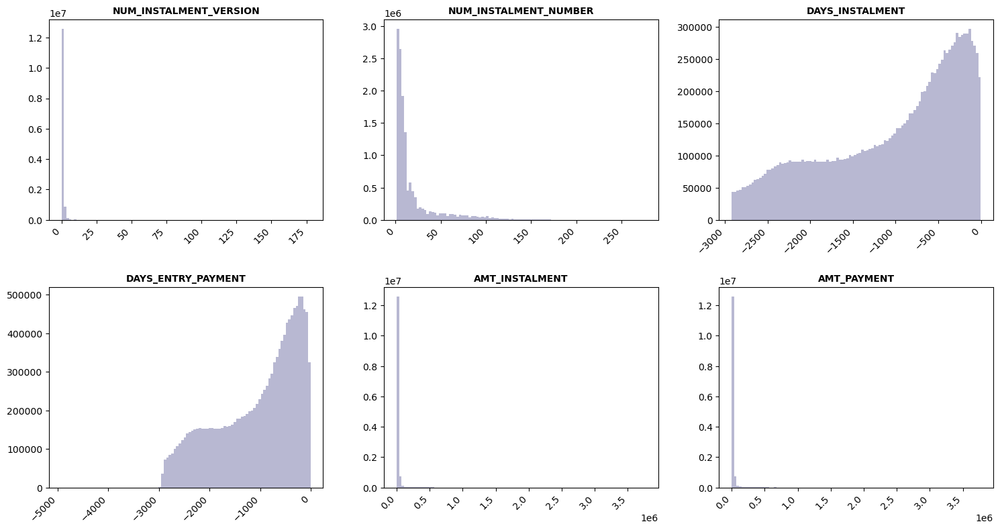

In [248]:
fig = plt.figure(figsize=(15,8))
fct_eda.univariate_plots_hist(install_pay_desc, liste_col_quanti, 2, 3, 100, fig=fig)

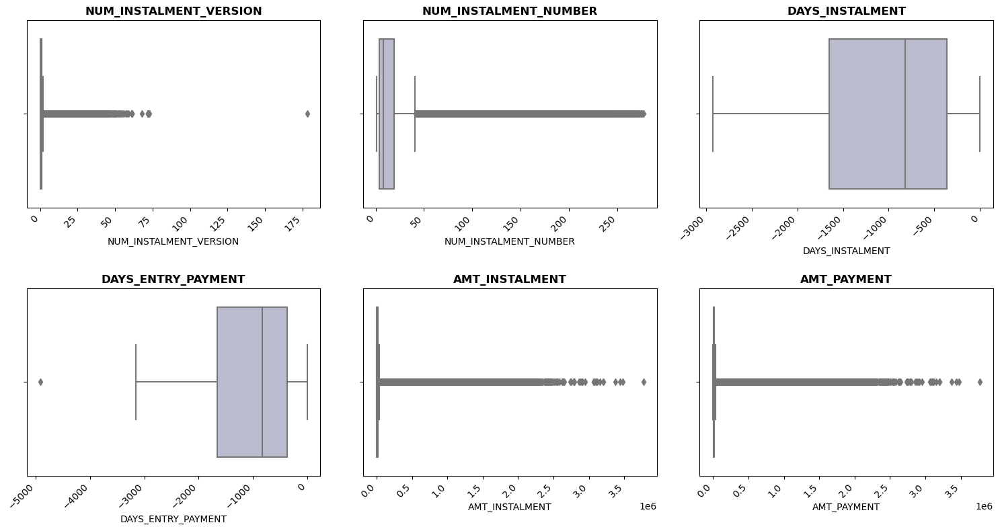

In [249]:
fig = plt.figure(figsize=(15,8))
fct_eda.univariate_plots_box(install_pay_desc, liste_col_quanti, 2, 3, fig, True)

In [250]:
install_pay_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
NUM_INSTALMENT_VERSION,13605401.00,0.86,1.04,0.00,0.00,1.00,1.00,178.00
NUM_INSTALMENT_NUMBER,13605401.00,18.87,26.66,1.00,4.00,8.00,19.00,277.00
DAYS_INSTALMENT,13605401.00,-1042.27,800.95,-2922.00,-1654.00,-818.00,-361.00,-1.00
DAYS_ENTRY_PAYMENT,13605401.00,-1051.07,800.51,-4921.00,-1662.00,-827.00,-370.00,-1.00
AMT_INSTALMENT,13605401.00,17050.91,50570.25,0.00,4226.09,8884.08,16710.21,3771487.85
AMT_PAYMENT,13605401.00,17236.28,54730.10,0.00,3399.30,8125.52,16105.91,3771487.85


#### Analyses bivariées / multivariées

Nous allons intégrer la variable TARGET afin de mieux comprendre quelles variables ont une influence sur la capacité à rembourser l'emprunt.

In [251]:
install_pay_desc = install_pay_desc.merge(app_train_desc.reset_index()[['SK_ID_CURR', 'TARGET']],
                                          on = 'SK_ID_CURR',
                                          how = 'left')

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

In [252]:
liste_target = ['TARGET']
liste_corr = liste_col_quanti + liste_target

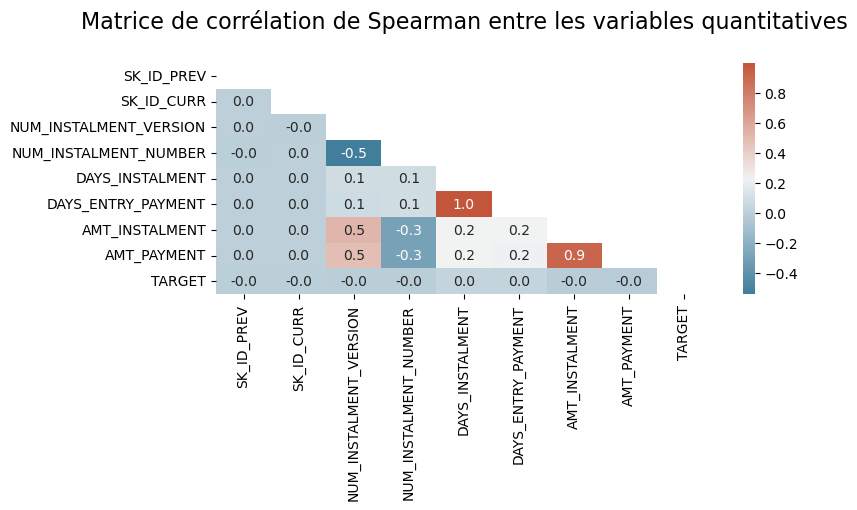

In [253]:
# Corrélation
corr = install_pay_desc.corr('spearman')

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(8,3))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation de Spearman entre les variables quantitatives\n", fontsize=16);

In [254]:
liste_col_quanti_suppr = ['SK_ID_CURR', 'TARGET']
liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

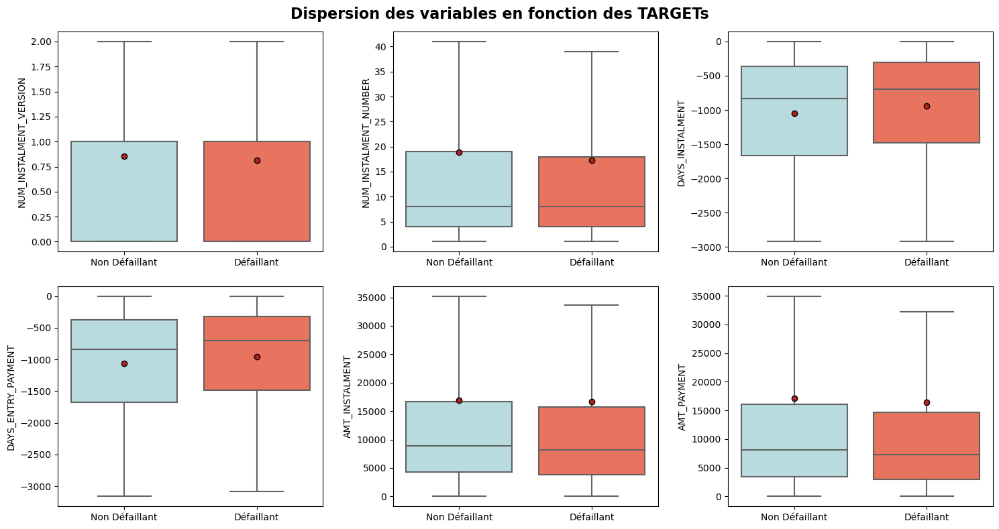

In [255]:
fig = plt.figure(figsize=(15,8))
fct_eda.bivariate_plots_box(install_pay_desc, 'TARGET', liste_col_quanti, 2, 3, fig)

Les variables DAYS_ENTRY_PAYMENT et DAYS_INSTALMENT sont extêmement corrélées ainsi que les variables AMT_PAYMENT et AMT_INSTALMENT. Nous ne les prendrons pas toutes dans notre modèle. Nous allons supprimer la variable NUM_INSTALMENT_VERSION qui est corrélée à 0.5 sur plusieurs variables:

In [256]:
Kruskal_Wallis_test(install_pay_desc, liste_col_quanti, 'TARGET')

Test non paramétrique de Kruskal Wallis: 

Variable NUM_INSTALMENT_VERSION par TARGET
pvaleur: 2.3171045939165656e-134 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable NUM_INSTALMENT_NUMBER par TARGET
pvaleur: 1.3583385202273958e-154 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable DAYS_INSTALMENT par TARGET
pvaleur: 0.0 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable DAYS_ENTRY_PAYMENT par TARGET
pvaleur: 0.0 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable AMT_INSTALMENT par TARGET
pvaleur: 0.0 < 0.05 => on rejette H0, les médi

In [257]:
del install_pay_desc['NUM_INSTALMENT_VERSION']

In [258]:
install_pay_feat = install_pay_desc.copy()

#### Feature engineering

Nous allons créer de nouveaux indicateurs à l'aide de ceux que nous avons:
- **PAYMENT_DIFF**: restant dû entre la mensualité et ce qui a été payé
- **DAYS_PAST_DUE**: nombre de jours de retard entre le paiement de la mensualité et quand la mensualité devait être payée (pas de valeurs négatives, sinon DAYS_BEFORE_DUE)
- **DAYS_BEFORE_DUE**: nombre de jours d'avance entre le paiement de la mensualité et quand la mensualité devait être payée (pas de valeurs négatives, sinon DAYS_PAST_DUE)

In [259]:
install_pay_feat['PAYMENT_DIFF'] = install_pay_feat['AMT_INSTALMENT'] - install_pay_feat['AMT_PAYMENT']
install_pay_feat['DAYS_PAST_DUE'] = install_pay_feat['DAYS_ENTRY_PAYMENT'] - install_pay_feat['DAYS_INSTALMENT']
install_pay_feat['DAYS_PAST_DUE'] = install_pay_feat['DAYS_PAST_DUE'].apply(lambda x: x if x > 0 else 0)
install_pay_feat['DAYS_BEFORE_DUE'] = install_pay_feat['DAYS_INSTALMENT'] - install_pay_feat['DAYS_ENTRY_PAYMENT']
install_pay_feat['DAYS_BEFORE_DUE'] = install_pay_feat['DAYS_BEFORE_DUE'].apply(lambda x: x if x > 0 else 0)

Comme il y a plusieurs lignes par SK_ID_CURR correspondant aux paiements effectués ou manqués, nous allons grouper notre table par SK_ID_CURR et agréger les variables nouvellement créées selon les agrégations suivantes:

In [260]:
# Dictionnaire des agrégations pour les variables numériques
aggregations = {
    'DAYS_PAST_DUE': ['mean'],
    'DAYS_BEFORE_DUE': ['mean'],
    'PAYMENT_DIFF': ['mean'],
    'SK_ID_PREV': ['count']
}

In [261]:
# Groupe par SK_ID_CURR + agrégation
install_pay_feat_gby = install_pay_feat.groupby('SK_ID_CURR').agg(aggregations)

In [262]:
# On renomme les colonnes pour supprimer le multi-index
install_pay_feat_gby.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() 
                                         for e in install_pay_feat_gby.columns.tolist()])

In [263]:
# On renomme INSTAL_SK_ID_PREV_COUNT en INSTAL_NB_INSTAL
pos_cash_feat_gby = install_pay_feat_gby.rename(columns={'INSTAL_SK_ID_PREV_COUNT': 'INSTAL_NB_INSTAL'})

In [264]:
install_pay_feat_gby.isna().sum().sort_values(ascending = False)

INSTAL_DAYS_PAST_DUE_MEAN      0
INSTAL_DAYS_BEFORE_DUE_MEAN    0
INSTAL_PAYMENT_DIFF_MEAN       0
INSTAL_SK_ID_PREV_COUNT        0
dtype: int64

In [265]:
install_pay_feat_gby.shape

(339587, 4)

#### Fonction de preprocessing

In [266]:
def preprocess_installments_payments():
    '''Fonction de preprocessing du dataset installments_payments:
    traitement des données manquantes, feature engineering et 
    sélection de variables
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    
    # Chargement du dataset
    install_pay = pd.read_csv('data/installments_payments.csv',
                              sep=',',
                              encoding='utf-8')
    
    # Traitement des données manquantes (médiane)
    for col in ['DAYS_ENTRY_PAYMENT', 'AMT_PAYMENT']:
        install_pay[col] = install_pay[col].fillna(install_pay[col].median())

    # Feature engineering
    del install_pay['NUM_INSTALMENT_VERSION']
    install_pay['PAYMENT_DIFF'] = install_pay['AMT_INSTALMENT'] - install_pay['AMT_PAYMENT']
    install_pay['DAYS_PAST_DUE'] = install_pay['DAYS_ENTRY_PAYMENT'] - install_pay['DAYS_INSTALMENT']
    install_pay['DAYS_PAST_DUE'] = install_pay['DAYS_PAST_DUE'].apply(lambda x: x if x > 0 else 0)
    install_pay['DAYS_BEFORE_DUE'] = install_pay['DAYS_INSTALMENT'] - install_pay['DAYS_ENTRY_PAYMENT']
    install_pay['DAYS_BEFORE_DUE'] = install_pay['DAYS_BEFORE_DUE'].apply(lambda x: x if x > 0 else 0)
        
    ## Dictionnaire des agrégations pour les variables numériques
    aggregations = {
        'DAYS_PAST_DUE': ['mean'],
        'DAYS_BEFORE_DUE': ['mean'],
        'PAYMENT_DIFF': ['mean'],
        'SK_ID_PREV': ['count']
    }
   
    ## Groupe par SK_ID_CURR + agrégation
    install_pay_feat_gby = install_pay.groupby('SK_ID_CURR').agg(aggregations)

    ## On renomme les colonnes pour supprimer le multi-index
    install_pay_feat_gby.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() 
                                             for e in install_pay_feat_gby.columns.tolist()])

    ## On renomme INSTAL_SK_ID_PREV_COUNT en INSTAL_NB_INSTAL
    pos_cash_feat_gby = install_pay_feat_gby.rename(columns={'INSTAL_SK_ID_PREV_COUNT': 'INSTAL_NB_INSTAL'})

    del install_pay

    gc.collect()
    
    return install_pay_feat_gby

In [267]:
preprocess_installments_payments().shape

(339587, 4)

### credit_card_balance.csv <a class="anchor" id="credit_card"></a>

*Soldes mensuels des cartes de crédit précédentes (Prêt à dépenser)*

#### Principales statistiques

Ce dataset contient **les soldes mensuels des cartes de crédit précédentes** que le demandeur possède auprès de Home Credit.

Il comporte une ligne pour chaque mois de l'historique de chaque crédit antérieur auprès de Home Credit (crédit à la consommation et prêts de trésorerie) lié aux prêts de notre échantillon.

In [268]:
# Chargement du dataset
cc_balance = pd.read_csv('data/credit_card_balance.csv',
                         sep=',',
                         encoding='utf-8')

In [269]:
# Description des colonnes
col_desc[col_desc['Table'] == 'credit_card_balance.csv']

,Unnamed: 0,Table,Row,Description,Special
150,153,credit_card_balance.csv,SK_ID_PREV,"ID of previous credit in Home credit related to loan in our sample. (One loan in our sample can have 0,1,2 or more previous loans in Home Credit)",hashed
151,154,credit_card_balance.csv,SK_ID_CURR,ID of loan in our sample,hashed
152,155,credit_card_balance.csv,MONTHS_BALANCE,Month of balance relative to application date (-1 means the freshest balance date),time only relative to the application
153,156,credit_card_balance.csv,AMT_BALANCE,Balance during the month of previous credit,NaN
154,157,credit_card_balance.csv,AMT_CREDIT_LIMIT_ACTUAL,Credit card limit during the month of the previous credit,NaN
155,158,credit_card_balance.csv,AMT_DRAWINGS_ATM_CURRENT,Amount drawing at ATM during the month of the previous credit,NaN
156,159,credit_card_balance.csv,AMT_DRAWINGS_CURRENT,Amount drawing during the month of the previous credit,NaN
157,160,credit_card_balance.csv,AMT_DRAWINGS_OTHER_CURRENT,Amount of other drawings during the month of the previous credit,NaN
158,161,credit_card_balance.csv,AMT_DRAWINGS_POS_CURRENT,Amount drawing or buying goods during the month of the previous credit,NaN
159,162,credit_card_balance.csv,AMT_INST_MIN_REGULARITY,Minimal installment for this month of the previous credit,NaN


-------------------------------------------------
Visualisation des 5 premières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.97,135000,0.00,877.50,0.00,877.50,1700.33,1800.00,1800.00,0.00,0.00,0.00,0.00,1,0.00,1.00,35.00,Active,0,0
1,2582071,363914,-1,63975.56,45000,2250.00,2250.00,0.00,0.00,2250.00,2250.00,2250.00,60175.08,64875.56,64875.56,1.00,1,0.00,0.00,69.00,Active,0,0
2,1740877,371185,-7,31815.22,450000,0.00,0.00,0.00,0.00,2250.00,2250.00,2250.00,26926.42,31460.08,31460.08,0.00,0,0.00,0.00,30.00,Active,0,0
3,1389973,337855,-4,236572.11,225000,2250.00,2250.00,0.00,0.00,11795.76,11925.00,11925.00,224949.29,233048.97,233048.97,1.00,1,0.00,0.00,10.00,Active,0,0
4,1891521,126868,-1,453919.46,450000,0.00,11547.00,0.00,11547.00,22924.89,27000.00,27000.00,443044.40,453919.46,453919.46,0.00,1,0.00,1.00,101.00,Active,0,0


-------------------------------------------------
Visualisation des 5 dernières lignes du dataset
-------------------------------------------------


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
3840307,1036507,328243,-9,0.00,45000,NaN,0.00,NaN,NaN,0.00,NaN,0.00,0.00,0.00,0.00,NaN,0,NaN,NaN,0.00,Active,0,0
3840308,1714892,347207,-9,0.00,45000,0.00,0.00,0.00,0.00,0.00,1879.11,0.00,0.00,0.00,0.00,0.00,0,0.00,0.00,23.00,Active,0,0
3840309,1302323,215757,-9,275784.97,585000,270000.00,270000.00,0.00,0.00,2250.00,375750.00,356994.67,269356.14,273093.97,273093.97,2.00,2,0.00,0.00,18.00,Active,0,0
3840310,1624872,430337,-10,0.00,450000,NaN,0.00,NaN,NaN,0.00,NaN,0.00,0.00,0.00,0.00,NaN,0,NaN,NaN,0.00,Active,0,0
3840311,2411345,236760,-10,0.00,157500,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0,0.00,0.00,21.00,Completed,0,0


-------------------------------------------------
Dimensions du dataset
-------------------------------------------------

Nombre de lignes: 3840312
Nombre de colonnes: 23
Nombre total de NaN du dataset: 5877356
% total de NaN du dataset: 6.65%

-------------------------------------------------
Taux de remplissage
-------------------------------------------------


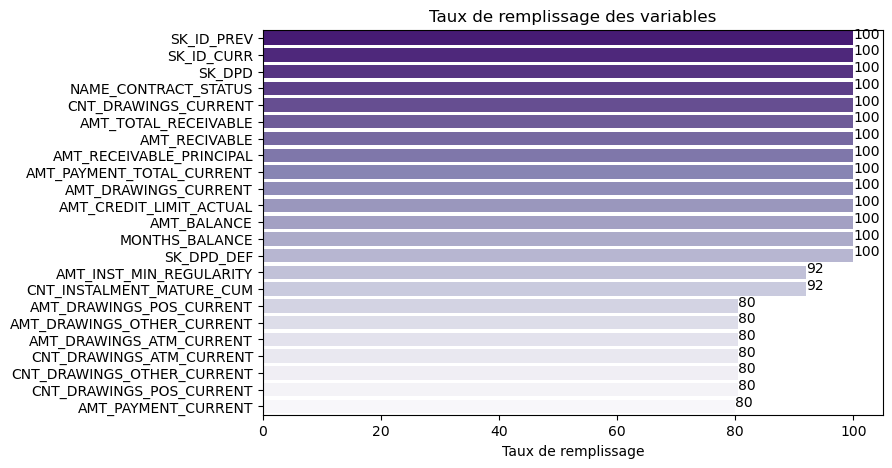

-------------------------------------------------
Principales statistiques du jeu de données
-------------------------------------------------


,Variable name,Variable type,Example,Raws,Distinct,% distinct,Not NaN,% Not NaN,NaN,% NaN
0,SK_ID_PREV,int64,2562384,3840312,104307,2.72,3840312,100.00,0,0.00
1,SK_ID_CURR,int64,378907,3840312,103558,2.70,3840312,100.00,0,0.00
2,MONTHS_BALANCE,int64,-6,3840312,96,0.00,3840312,100.00,0,0.00
3,AMT_BALANCE,float64,56.97,3840312,1347904,35.10,3840312,100.00,0,0.00
4,AMT_CREDIT_LIMIT_ACTUAL,int64,135000,3840312,181,0.00,3840312,100.00,0,0.00
5,AMT_DRAWINGS_ATM_CURRENT,float64,0.00,3840312,2267,0.06,3090496,80.48,749816,19.52
6,AMT_DRAWINGS_CURRENT,float64,877.50,3840312,187005,4.87,3840312,100.00,0,0.00
7,AMT_DRAWINGS_OTHER_CURRENT,float64,0.00,3840312,1832,0.05,3090496,80.48,749816,19.52
8,AMT_DRAWINGS_POS_CURRENT,float64,877.50,3840312,168748,4.39,3090496,80.48,749816,19.52
9,AMT_INST_MIN_REGULARITY,float64,1700.33,3840312,312266,8.13,3535076,92.05,305236,7.95


-------------------------------------------------
Lignes dupliquées
-------------------------------------------------

Lignes en doublons: 0


In [270]:
fig = plt.figure(figsize=(8,5))
cc_balance_desc = fct_eda.describe_stat(cc_balance, fig = fig)

#### Traitement des données manquantes

Le taux de remplissage étant de 80% minimum, nous allons compléter les valeurs manquantes par la **médiane** et vérifier la distribution de nos variables avant et après retraitements.

In [271]:
cc_balance_nan = cc_balance.copy()

In [272]:
df_nan = fct_eda.nan_a_retraiter(cc_balance_nan)

In [273]:
# Colonnes impactées
col_med = df_nan[(df_nan['Tx_rempl']>=80)].index.tolist()

# Imputation des variables par la médiane
for col in col_med:
    cc_balance_nan[col] = cc_balance_nan[col].fillna(cc_balance_nan[col].median())

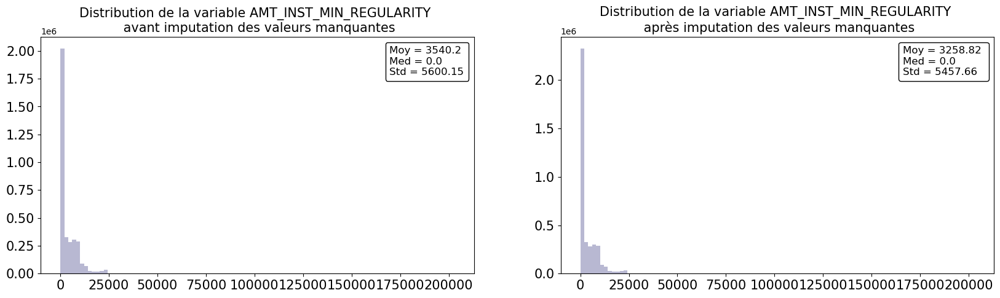

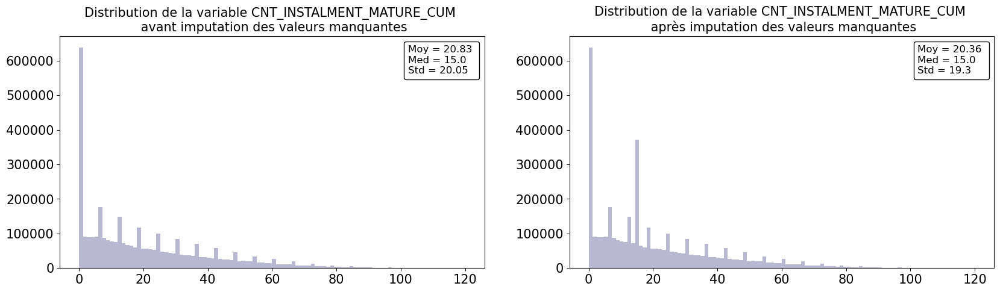

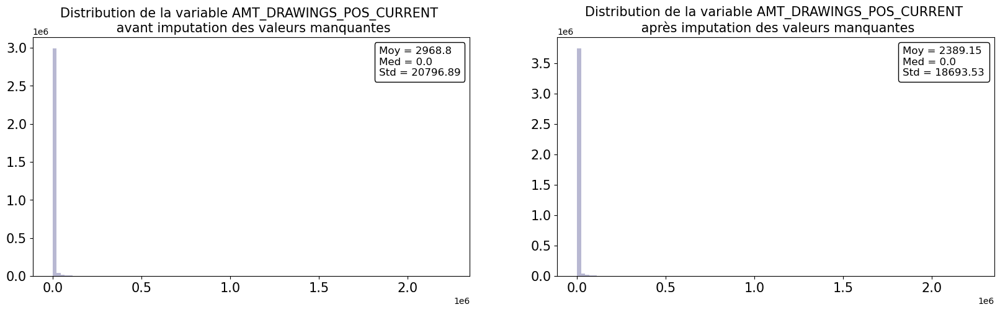

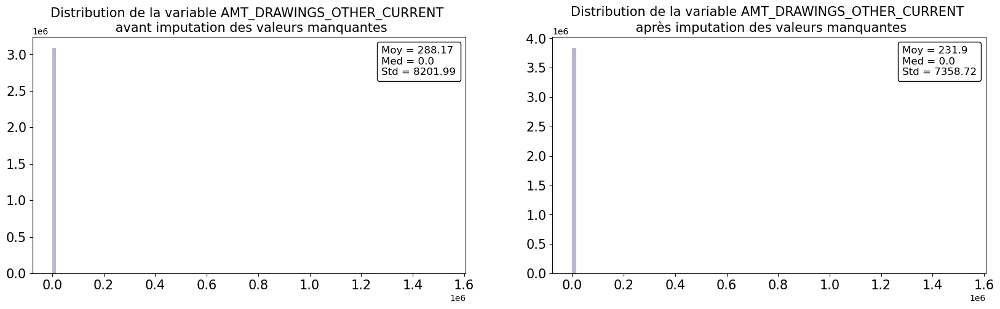

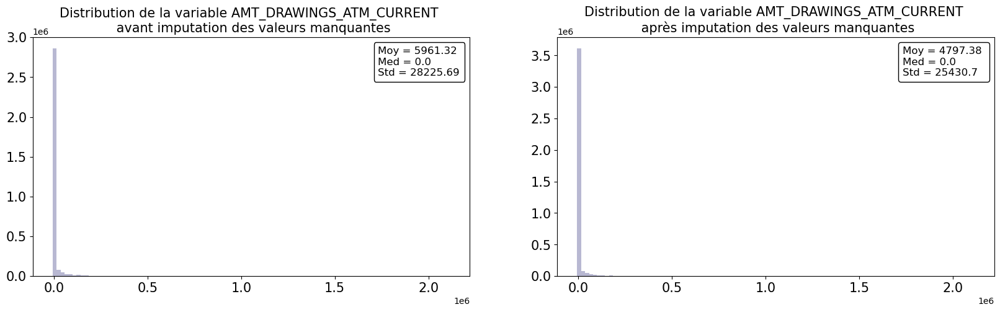

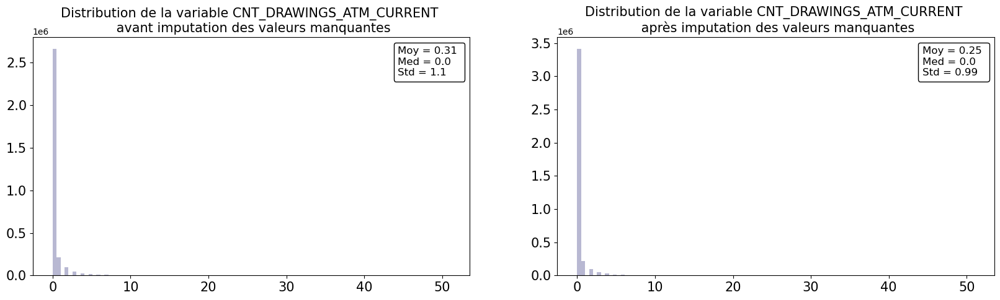

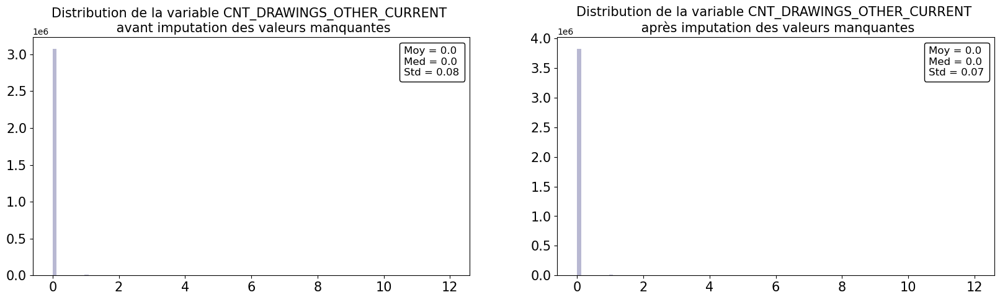

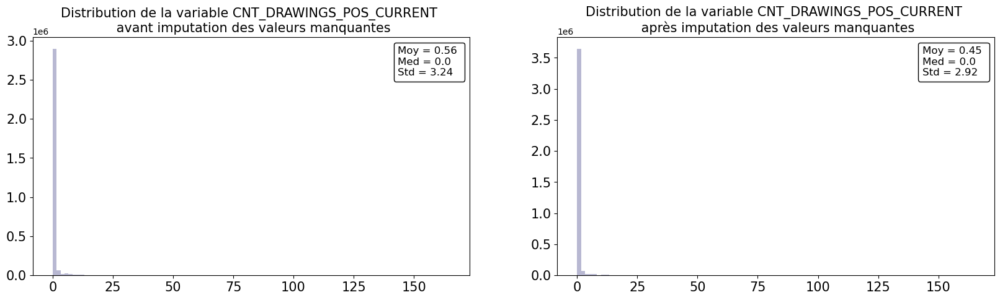

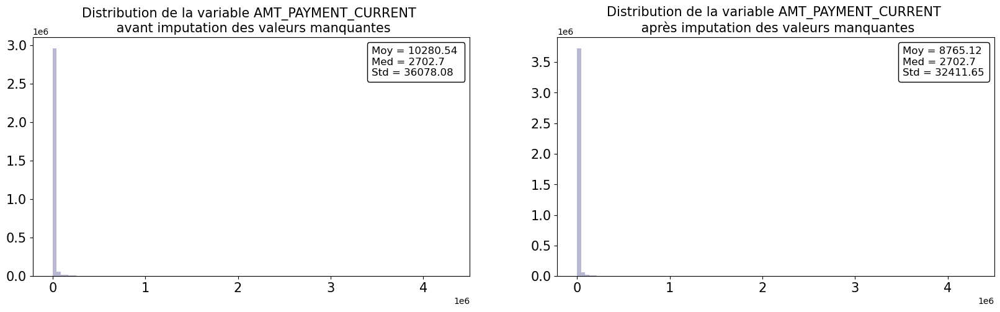

In [274]:
for var in col_med:
    fct_eda.distrib_imput_nan_quanti(cc_balance, var, cc_balance_nan)

Les distributions sont relativement similaires, nous validons la méthode.

#### Analyses univariées

In [275]:
cc_balance_desc = cc_balance_nan.copy()

<div class="alert alert-block alert-warning">
    <p>Variables indépendantes</p>
</div>

In [276]:
liste_col_quanti = cc_balance_desc.select_dtypes(exclude ='object')
liste_col_quanti = liste_col_quanti.nunique().index.tolist()
liste_col_quanti_suppr = ['SK_ID_CURR', 'SK_ID_PREV']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

In [277]:
len(liste_col_quanti)

20

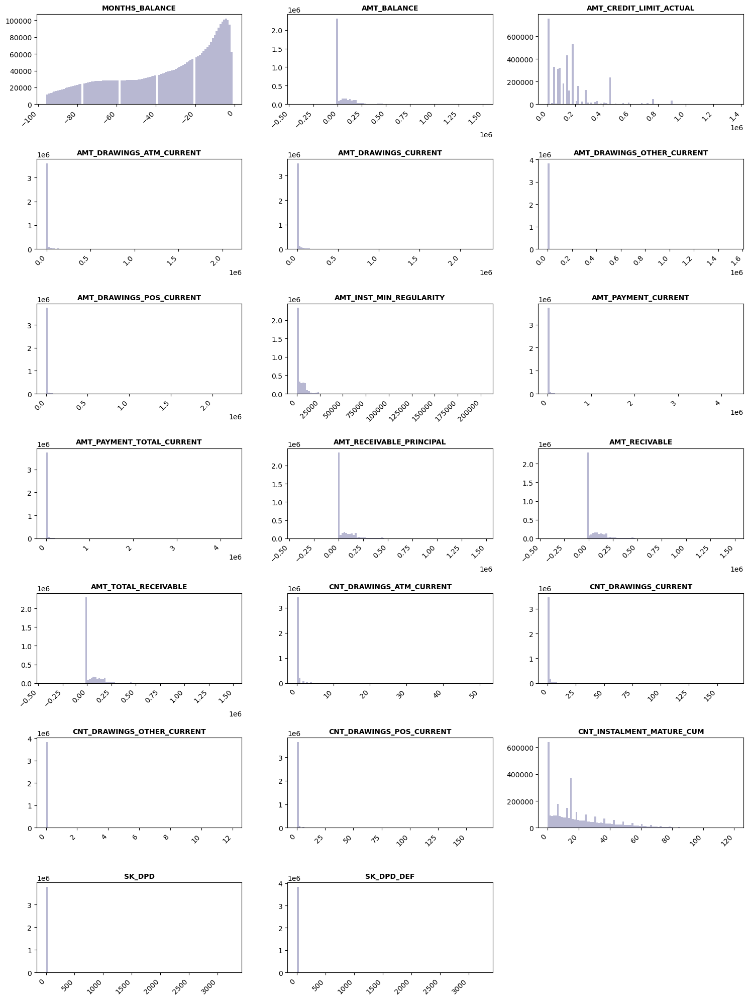

In [278]:
fig = plt.figure(figsize=(15,20))
fct_eda.univariate_plots_hist(cc_balance_desc, liste_col_quanti, 7, 3, 100, fig=fig)

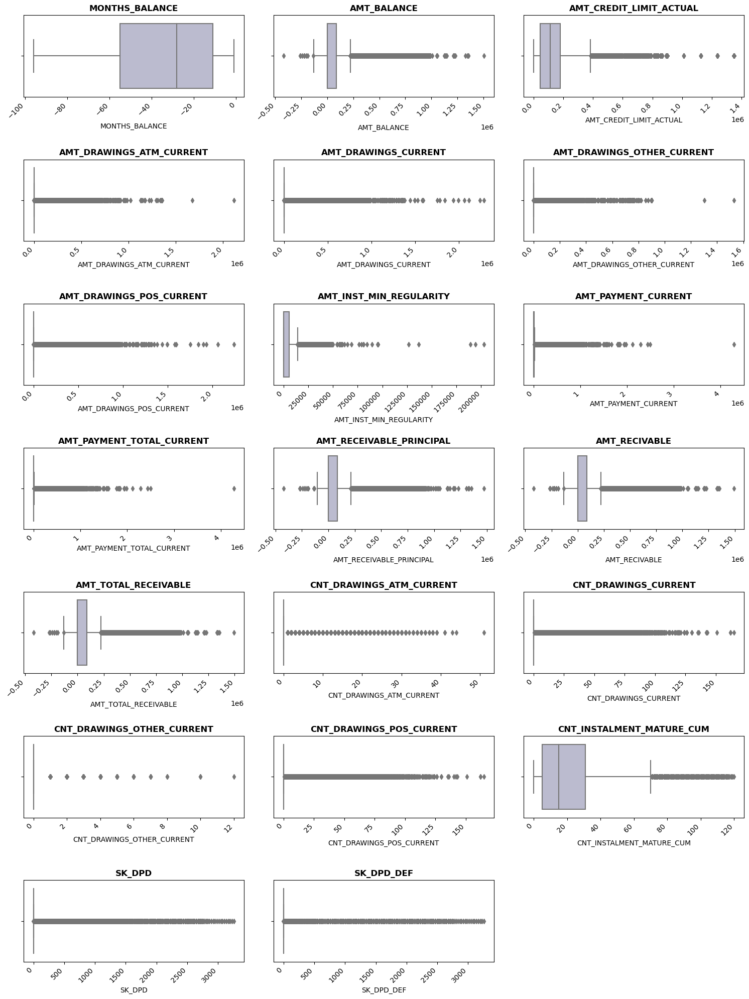

In [279]:
fig = plt.figure(figsize=(15,20))
fct_eda.univariate_plots_box(cc_balance_desc, liste_col_quanti, 7, 3, fig, True)

In [280]:
cc_balance_desc[liste_col_quanti].describe().T

,count,mean,std,min,25%,50%,75%,max
MONTHS_BALANCE,3840312.00,-34.52,26.67,-96.00,-55.00,-28.00,-11.00,-1.00
AMT_BALANCE,3840312.00,58300.16,106307.03,-420250.18,0.00,0.00,89046.69,1505902.19
AMT_CREDIT_LIMIT_ACTUAL,3840312.00,153807.96,165145.70,0.00,45000.00,112500.00,180000.00,1350000.00
AMT_DRAWINGS_ATM_CURRENT,3840312.00,4797.38,25430.70,-6827.31,0.00,0.00,0.00,2115000.00
AMT_DRAWINGS_CURRENT,3840312.00,7433.39,33846.08,-6211.62,0.00,0.00,0.00,2287098.31
AMT_DRAWINGS_OTHER_CURRENT,3840312.00,231.90,7358.72,0.00,0.00,0.00,0.00,1529847.00
AMT_DRAWINGS_POS_CURRENT,3840312.00,2389.15,18693.53,0.00,0.00,0.00,0.00,2239274.16
AMT_INST_MIN_REGULARITY,3840312.00,3258.82,5457.66,0.00,0.00,0.00,5625.00,202882.01
AMT_PAYMENT_CURRENT,3840312.00,8765.12,32411.65,0.00,247.95,2702.70,7875.00,4289207.45
AMT_PAYMENT_TOTAL_CURRENT,3840312.00,7588.86,32005.99,0.00,0.00,0.00,6750.00,4278315.69


Nous allons supprimer les variables dont les quartiles sont à 0:

In [281]:
cc_balance_desc.drop(['AMT_DRAWINGS_ATM_CURRENT', 'AMT_DRAWINGS_CURRENT', 'AMT_DRAWINGS_OTHER_CURRENT',
                      'AMT_DRAWINGS_POS_CURRENT', 'CNT_DRAWINGS_ATM_CURRENT', 'CNT_DRAWINGS_CURRENT',
                      'CNT_DRAWINGS_OTHER_CURRENT', 'CNT_DRAWINGS_POS_CURRENT', 'SK_DPD', 'SK_DPD_DEF'],
                     axis=1, inplace = True)

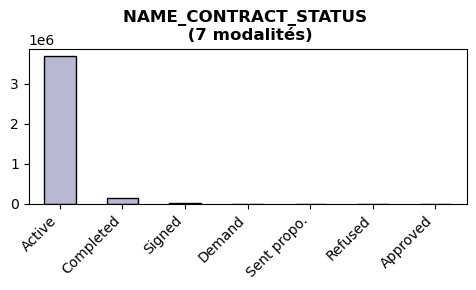

In [282]:
fig = plt.figure(figsize=(5, 3))
fct_eda.categ_distrib_plot(cc_balance_desc, ['NAME_CONTRACT_STATUS'], 1, 1, fig = fig)

Cette variable sera supprimée car quasi tous les status sont actifs:

In [283]:
del cc_balance_desc['NAME_CONTRACT_STATUS']

#### Analyses bivariées / multivariées

Nous allons intégrer la variable TARGET afin de mieux comprendre quelles variables ont une influence sur la capacité à rembourser l'emprunt.

In [284]:
cc_balance_desc = cc_balance_desc.merge(app_train_desc.reset_index()[['SK_ID_CURR', 'TARGET']],
                                        on = 'SK_ID_CURR',
                                        how = 'left')

<div class="alert alert-block alert-warning">
    <p>Variables quantitatives et target</p>
</div>

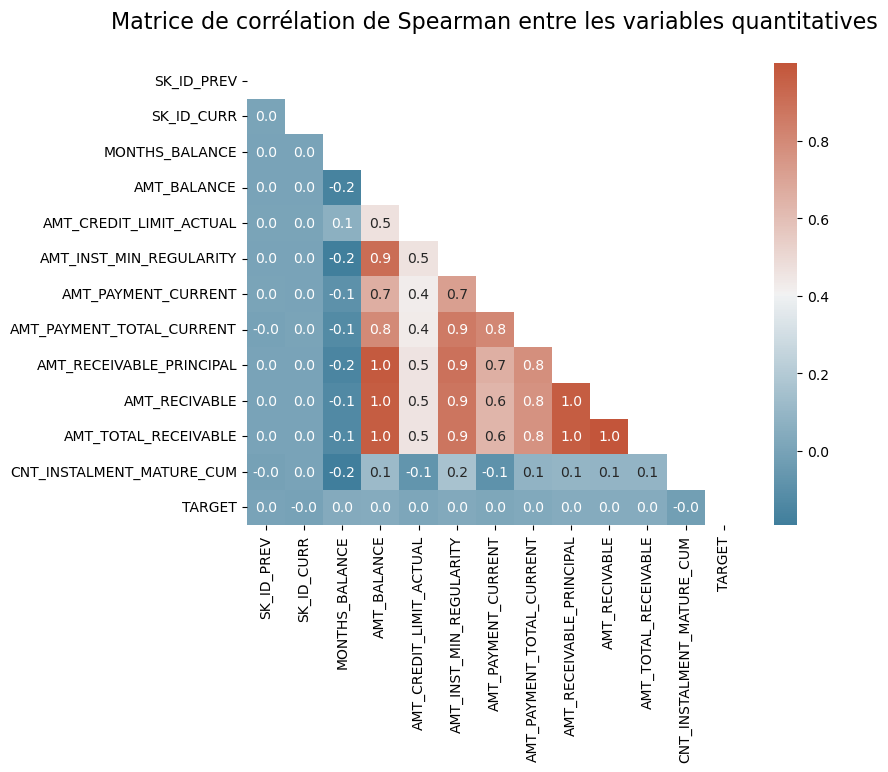

In [285]:
# Corrélation
corr = cc_balance_desc.corr('spearman')

# Création d'un masque
mask = np.triu(corr)

# Taille du graph
plt.subplots(figsize=(8,6))

# Colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Heatmap avec masque
sns.heatmap(corr, annot = True, mask = mask, cmap=cmap, fmt='.1f')
plt.title("Matrice de corrélation de Spearman entre les variables quantitatives\n", fontsize=16);

In [286]:
liste_col_quanti_suppr = ['AMT_DRAWINGS_ATM_CURRENT', 'AMT_DRAWINGS_CURRENT', 'AMT_DRAWINGS_OTHER_CURRENT',
                          'AMT_DRAWINGS_POS_CURRENT', 'CNT_DRAWINGS_ATM_CURRENT', 'CNT_DRAWINGS_CURRENT',
                          'CNT_DRAWINGS_OTHER_CURRENT', 'CNT_DRAWINGS_POS_CURRENT', 'SK_DPD', 'SK_DPD_DEF']

liste_col_quanti = [elem for elem in liste_col_quanti if elem not in liste_col_quanti_suppr]

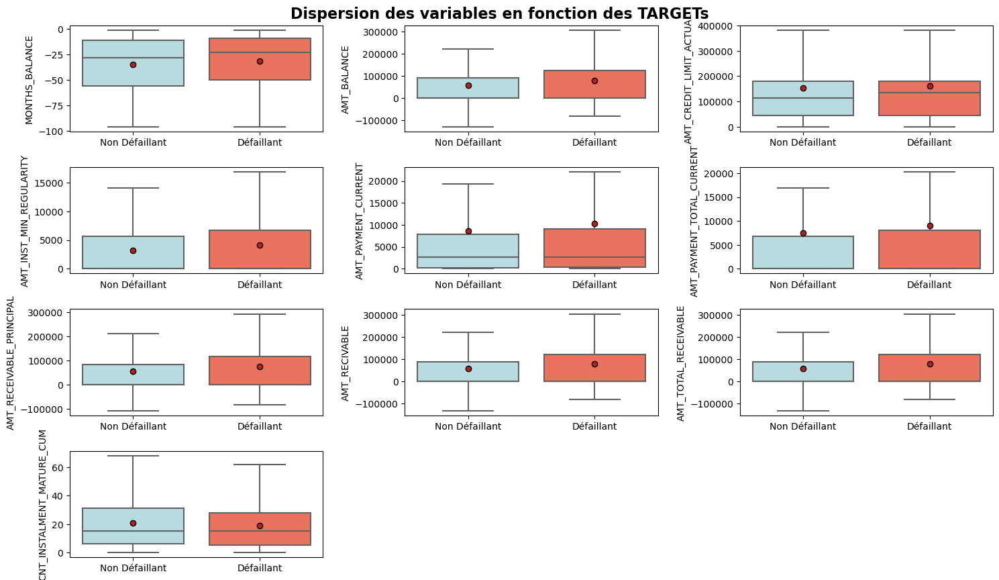

In [287]:
fig = plt.figure(figsize=(15,15))
fct_eda.bivariate_plots_box(cc_balance_desc, 'TARGET', liste_col_quanti, 7, 3, fig)

In [288]:
Kruskal_Wallis_test(cc_balance_desc, liste_col_quanti, 'TARGET')

Test non paramétrique de Kruskal Wallis: 

Variable MONTHS_BALANCE par TARGET
pvaleur: 0.0 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable AMT_BALANCE par TARGET
pvaleur: 0.0 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable AMT_CREDIT_LIMIT_ACTUAL par TARGET
pvaleur: 2.6202510707354264e-165 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable AMT_INST_MIN_REGULARITY par TARGET
pvaleur: 0.0 < 0.05 => on rejette H0, les médianes entre les TARGET sont différentes
-----------------------------------------------------------------------------------
Variable AMT_PAYMENT_CURRENT par TARGET
pvaleur: 0.0 < 0.05 => on rejette H0, les médianes entre les TARGE

De nombreuses variables sont très corrélées entre elles. Il ne faut pas les rajouter toutes dans le modèle. Nous allons les supprimer:

- AMT_INST_MIN_REGULARITY
- AMT_PAYMENT_CURRENT
- AMT_PAYMENT_TOTAL_CURRENT
- AMT_RECEIVABLE_PRINCIPAL
- AMT_RECIVABLE
- AMT_TOTAL_RECEIVABLE 

In [289]:
cc_balance_desc.drop(['AMT_INST_MIN_REGULARITY', 'AMT_PAYMENT_CURRENT',
                      'AMT_PAYMENT_TOTAL_CURRENT', 'AMT_RECEIVABLE_PRINCIPAL',
                      'AMT_RECIVABLE', 'AMT_RECIVABLE',
                      'AMT_TOTAL_RECEIVABLE', 'AMT_TOTAL_RECEIVABLE'],
                     axis=1, inplace = True)

In [290]:
del cc_balance_desc['TARGET']

In [291]:
cc_balance_feat = cc_balance_desc.copy()

#### Feature engineering

Comme il y a plusieurs lignes par SK_ID_CURR nous allons grouper notre table par SK_ID_CURR et agréger les variables.

In [292]:
# Dictionnaire des agrégations pour les variables numériques
num_aggregations = {
    'SK_ID_PREV': ['count'],
    'MONTHS_BALANCE' : ['mean'],
    'AMT_BALANCE': ['mean'],
    'AMT_CREDIT_LIMIT_ACTUAL': ['mean'],
    'CNT_INSTALMENT_MATURE_CUM' : ['mean'],
    }

In [293]:
# Groupe par SK_ID_PREV + agrégations
cc_balance_feat_gby = cc_balance_feat.groupby('SK_ID_CURR').agg(num_aggregations)

In [294]:
# On renomme les colonnes pour supprimer le multi-index
cc_balance_feat_gby.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() 
                                        for e in cc_balance_feat_gby.columns.tolist()])

In [295]:
# On renomme CC_SK_ID_PREV_COUNT en PREV_NB_CREDIT
cc_balance_feat_gby = cc_balance_feat_gby.rename(columns={'CC_SK_ID_PREV_COUNT': 'CC_NB_CREDIT'})

In [296]:
cc_balance_feat_gby.isna().sum().sort_values(ascending = False)

CC_NB_CREDIT                         0
CC_MONTHS_BALANCE_MEAN               0
CC_AMT_BALANCE_MEAN                  0
CC_AMT_CREDIT_LIMIT_ACTUAL_MEAN      0
CC_CNT_INSTALMENT_MATURE_CUM_MEAN    0
dtype: int64

In [297]:
cc_balance_feat_gby.shape

(103558, 5)

#### Fonction de preprocessing

In [298]:
def preprocess_credit_card_balance():
    '''Fonction de preprocessing du dataset credit_card_balance:
    traitement des données manquantes, feature engineering et 
    sélection de variables
    
    Arguments:
    --------------------------------
    
    
    return:
    --------------------------------
    Dataframe preprocessé'''
    
    
    # Chargement du dataset
    cc_balance = pd.read_csv('data/credit_card_balance.csv', sep=',', encoding='utf-8')
    
    # Traitement des données manquantes (médiane)
    df_nan = fct_eda.nan_a_retraiter(cc_balance)
    col_med = df_nan[(df_nan['Tx_rempl']>=80)].index.tolist()
    for col in col_med:
        cc_balance[col] = cc_balance[col].fillna(cc_balance[col].median())

    # Suppression variables suite analyses
    cc_balance.drop(['AMT_DRAWINGS_ATM_CURRENT', 'AMT_DRAWINGS_CURRENT', 'AMT_DRAWINGS_OTHER_CURRENT',
                     'AMT_DRAWINGS_POS_CURRENT', 'CNT_DRAWINGS_ATM_CURRENT', 'CNT_DRAWINGS_CURRENT',
                     'CNT_DRAWINGS_OTHER_CURRENT', 'CNT_DRAWINGS_POS_CURRENT', 'SK_DPD', 'SK_DPD_DEF',
                     'NAME_CONTRACT_STATUS', 'AMT_INST_MIN_REGULARITY', 'AMT_PAYMENT_CURRENT',
                     'AMT_PAYMENT_TOTAL_CURRENT', 'AMT_RECEIVABLE_PRINCIPAL', 'AMT_RECIVABLE',
                     'AMT_RECIVABLE', 'AMT_TOTAL_RECEIVABLE', 'AMT_TOTAL_RECEIVABLE'],
                    axis=1, inplace = True)

    # Feature engineering

    ## Groupe par SK_ID_PREV + agrégations
    num_aggregations = {
        'SK_ID_PREV': ['count'],
        'MONTHS_BALANCE' : ['mean'],
        'AMT_BALANCE': ['mean'],
        'AMT_CREDIT_LIMIT_ACTUAL': ['mean'],
        'CNT_INSTALMENT_MATURE_CUM' : ['mean'],
    }

    cc_balance_feat_gby = cc_balance.groupby('SK_ID_CURR').agg(num_aggregations)

    ## On renomme les colonnes pour supprimer le multi-index
    cc_balance_feat_gby.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() 
                                            for e in cc_balance_feat_gby.columns.tolist()])

    ## On renomme CC_SK_ID_PREV_COUNT en PREV_NB_CREDIT
    cc_balance_feat_gby = cc_balance_feat_gby.rename(columns={'CC_SK_ID_PREV_COUNT': 'CC_NB_CREDIT'})

    del cc_balance

    gc.collect()
    
    return cc_balance_feat_gby

In [299]:
preprocess_credit_card_balance().shape

(103558, 5)

## Fonction de preprocessing et assemblage des datasets <a class="anchor" id="preprocess"></a>

In [300]:
@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print(f"{title} fait en {np.round(time.time() - t0, 0)}s ")

In [301]:
def preprocessing():
    with timer("Processing application_train"):
        df = preprocess_app_train()
        print("Application_train shape:", df.shape)
    with timer("Processing bureau et bureau_balance"):
        bureau = preprocess_bureau_balance()
        print("Bureau shape:", bureau.shape)
        df = df.join(bureau, how='left', on='SK_ID_CURR')
        del bureau
        gc.collect()
    with timer("Processing previous_applications"):
        prev = preprocess_previous_app()
        print("Previous applications shape:", prev.shape)
        df = df.join(prev, how='left', on='SK_ID_CURR')
        del prev
        gc.collect()
    with timer("Processing POS-CASH balance"):
        pos = preprocess_POS_CASH_balance()
        print("Pos-cash balance shape:", pos.shape)
        df = df.join(pos, how='left', on='SK_ID_CURR')
        del pos
        gc.collect()
    with timer("Processing installments payments"):
        ins = preprocess_installments_payments()
        print("Installments payments shape:", ins.shape)
        df = df.join(ins, how='left', on='SK_ID_CURR')
        del ins
        gc.collect()
    with timer("Processing credit card balance"):
        cc = preprocess_credit_card_balance()
        print("Credit card balance shape:", cc.shape)
        df = df.join(cc, how='left', on='SK_ID_CURR')
        del cc
        gc.collect()
    return df

In [302]:
df_conso = preprocessing()

Application_train shape: (307505, 64)
Processing application_train fait en 10.0s 
Bureau shape: (305811, 19)
Processing bureau et bureau_balance fait en 26.0s 
Previous applications shape: (338857, 150)
Processing previous_applications fait en 55.0s 
Pos-cash balance shape: (337252, 3)
Processing POS-CASH balance fait en 12.0s 
Installments payments shape: (339587, 4)
Processing installments payments fait en 22.0s 
Credit card balance shape: (103558, 5)
Processing credit card balance fait en 12.0s 


In [303]:
df_conso.shape

(307505, 245)

### Derniers retraitements <a class="anchor" id="retraitements"></a>

In [304]:
fct_eda.shape_total_nan(df_conso)

Nombre de lignes: 307505
Nombre de colonnes: 245
Nombre total de NaN du dataset: 4524820
% total de NaN du dataset: 6.01%


In [305]:
fct_eda.nan_a_retraiter(df_conso)

,Tx_rempl,nb_NaN,dtypes
INSTAL_DAYS_BEFORE_DUE_MEAN,94.84,15866,float64
INSTAL_DAYS_PAST_DUE_MEAN,94.84,15866,float64
INSTAL_PAYMENT_DIFF_MEAN,94.84,15866,float64
INSTAL_SK_ID_PREV_COUNT,94.84,15866,float64
PREV_NAME_PORTFOLIO_Cash_MEAN,94.65,16452,float64
PREV_NAME_PORTFOLIO_Cars_MEAN,94.65,16452,float64
PREV_NAME_PORTFOLIO_POS_MEAN,94.65,16452,float64
PREV_NAME_PORTFOLIO_XNA_MEAN,94.65,16452,float64
PREV_NAME_PRODUCT_TYPE_XNA_MEAN,94.65,16452,float64
PREV_CHANNEL_TYPE_AP+ (Cash loan)_MEAN,94.65,16452,float64


Le regroupement des différents datasets entre eux a généré des valeurs manquantes. Afin de pouvoir comparer nos modèles, nous allons retraiter les valeurs manquantes de différentes manières:
- **supprimer les variables** du dataset **credit_card_balance** (nombre de clients qui n'avaient pas de cartes de crédit chez Prêt à dépenser avant trop important)
- compléter les autres par la **médiane**

<div class="alert alert-block alert-warning">
    <p>Suppression des variables issues du dataset credit_card_balance</p>
</div>

In [306]:
# Suppression des variables avec 20% ou plus de NaN
df_conso_nan = fct_eda.tx_rempl_min(df_conso, 80)

<div class="alert alert-block alert-warning">
    <p>Médiane pour les variables restantes</p>
</div>

In [307]:
df_conso_med = df_conso_nan.copy()

In [308]:
df_nan = fct_eda.nan_a_retraiter(df_conso_med)

In [309]:
# Colonnes impactées
col_med = df_nan[(df_nan['Tx_rempl']>80) & 
                 (df_nan['dtypes'] == 'float64') &
                 (~ df_nan.index.str.contains('TARGET'))].index.tolist()

# Imputation des variables par la médiane
for col in col_med:
    df_conso_med[col] = df_conso_med[col].fillna(df_conso_med[col].median())

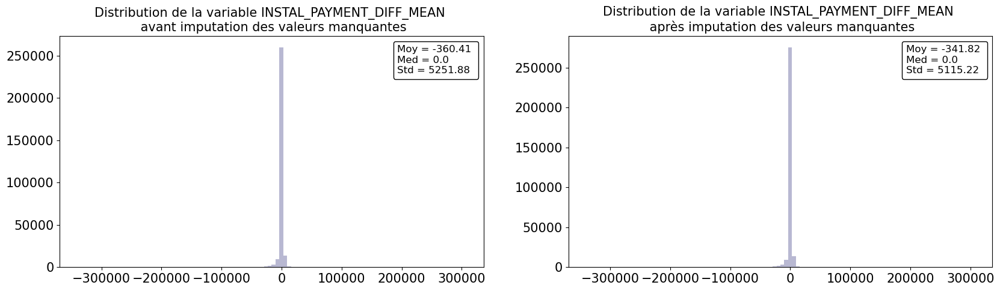

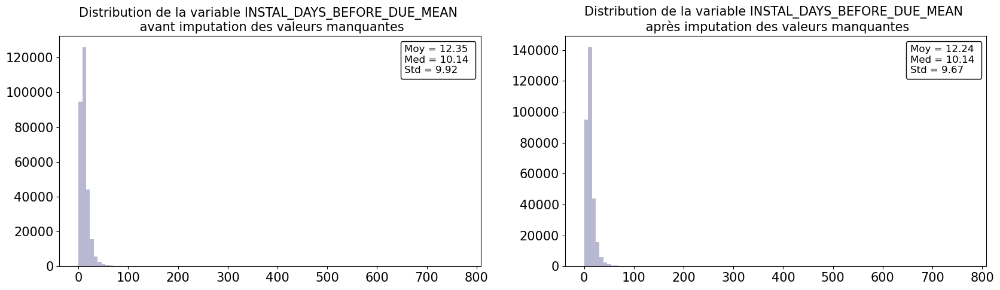

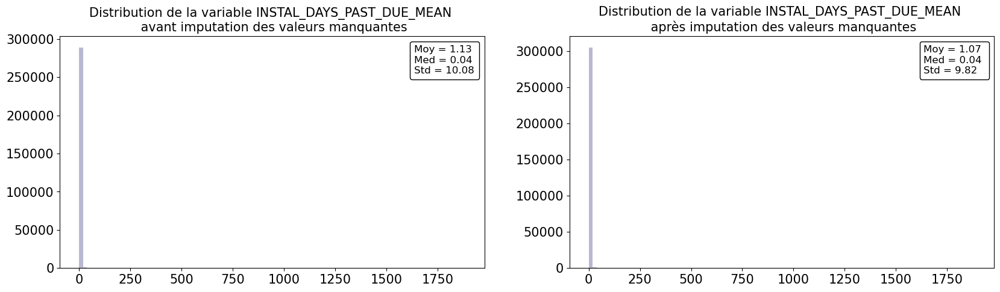

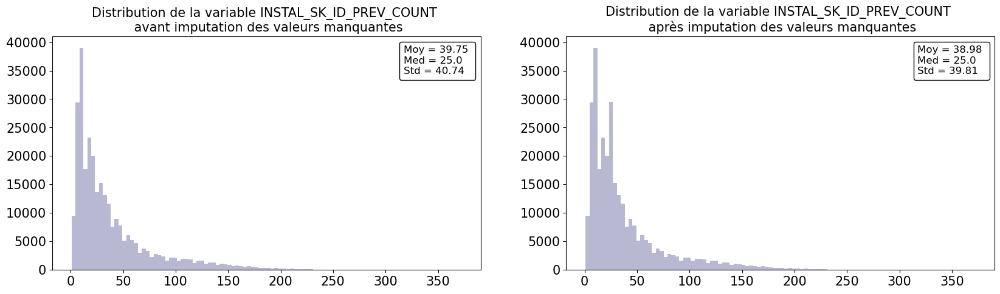

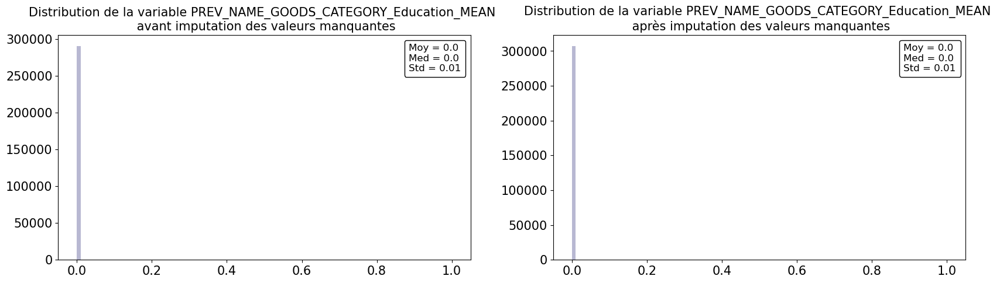

...

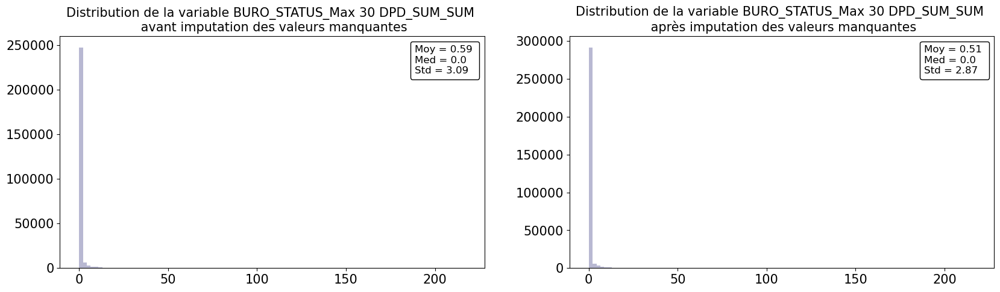

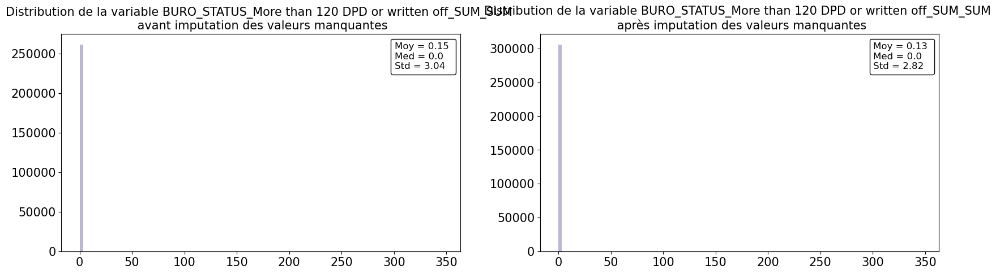

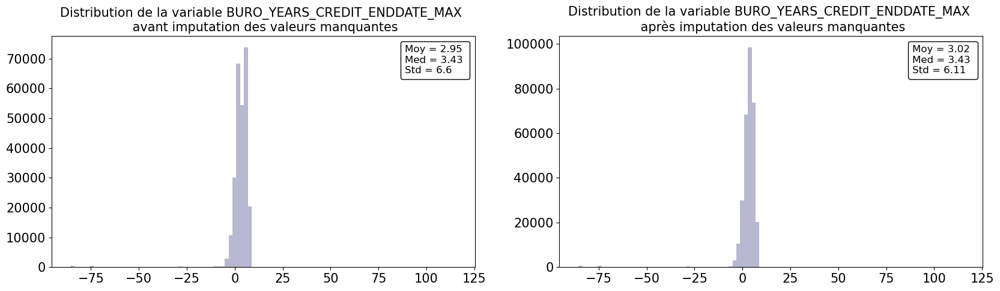

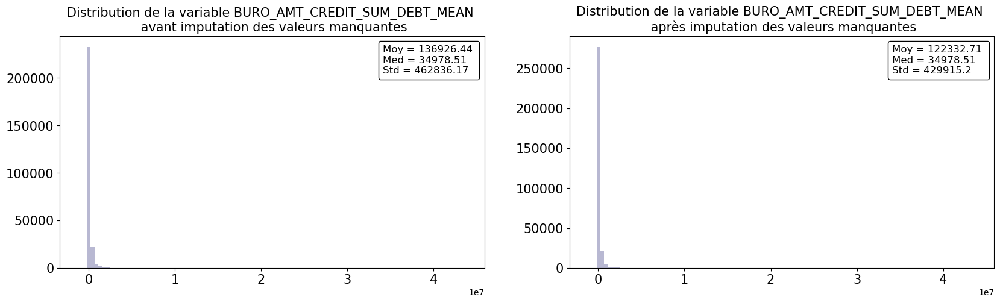

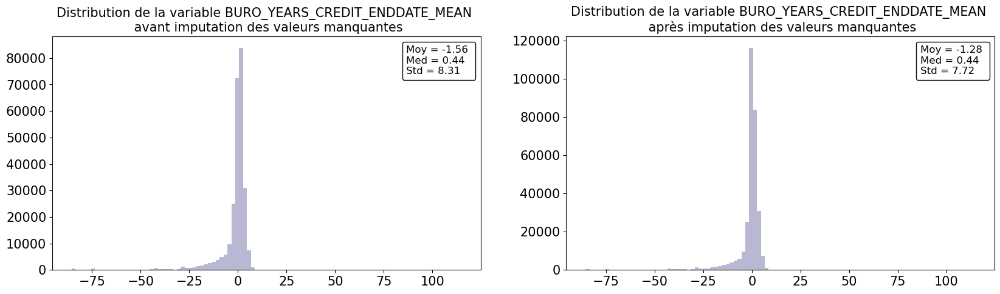

In [310]:
for var in col_med:
    fct_eda.distrib_imput_nan_quanti(df_conso_nan, var, df_conso_med)

La distribution de nos variables après imputation des données manquantes par la médiane étant similaire, nous validons cette méthode.

In [311]:
df_conso_nan.shape

(307505, 240)

### Fonction avec retraitement des NaN <a class="anchor" id="main_nan"></a>

In [312]:
@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print(f"{title} fait en {np.round(time.time() - t0, 0)}s ")

In [313]:
def preprocessing_no_NaN():
    with timer("Processing application_train"):
        df = preprocess_app_train()
        print("Application_train shape:", df.shape)
    with timer("Processing bureau et bureau_balance"):
        bureau = preprocess_bureau_balance()
        print("Bureau shape:", bureau.shape)
        df = df.join(bureau, how='left', on='SK_ID_CURR')
        del bureau
        gc.collect()
    with timer("Processing previous_applications"):
        prev = preprocess_previous_app()
        print("Previous applications shape:", prev.shape)
        df = df.join(prev, how='left', on='SK_ID_CURR')
        del prev
        gc.collect()
    with timer("Processing POS-CASH balance"):
        pos = preprocess_POS_CASH_balance()
        print("Pos-cash balance shape:", pos.shape)
        df = df.join(pos, how='left', on='SK_ID_CURR')
        del pos
        gc.collect()
    with timer("Processing installments payments"):
        ins = preprocess_installments_payments()
        print("Installments payments shape:", ins.shape)
        df = df.join(ins, how='left', on='SK_ID_CURR')
        del ins
        gc.collect()
    with timer("Processing credit card balance"):
        cc = preprocess_credit_card_balance()
        print("Credit card balance shape:", cc.shape)
        df = df.join(cc, how='left', on='SK_ID_CURR')
        df = fct_eda.tx_rempl_min(df, 80)
        df_nan = fct_eda.nan_a_retraiter(df)
        col_med = df_nan[(df_nan['Tx_rempl']>80) & 
                 (df_nan['dtypes'] == 'float64') &
                 (~ df_nan.index.str.contains('TARGET'))].index.tolist()
        for col in col_med:
            df[col] = df[col].fillna(df[col].median())
        del cc, df_nan, col_med
        gc.collect()
    return df

In [314]:
df = preprocessing_no_NaN()

Application_train shape: (307505, 64)
Processing application_train fait en 10.0s 
Bureau shape: (305811, 19)
Processing bureau et bureau_balance fait en 26.0s 
Previous applications shape: (338857, 150)
Processing previous_applications fait en 53.0s 
Pos-cash balance shape: (337252, 3)
Processing POS-CASH balance fait en 9.0s 
Installments payments shape: (339587, 4)
Processing installments payments fait en 23.0s 
Credit card balance shape: (103558, 5)
Processing credit card balance fait en 31.0s 


In [315]:
fct_eda.shape_total_nan(df)

Nombre de lignes: 307505
Nombre de colonnes: 240
Nombre total de NaN du dataset: 0
% total de NaN du dataset: 0.0%


In [316]:
# Test fonction du fichier .py
fct_preprocessing.preprocessing_no_NaN()

Application_train shape: (307505, 64)
Processing application_train fait en 10.0s 
Bureau shape: (305811, 19)
Processing bureau et bureau_balance fait en 26.0s 
Previous applications shape: (338857, 150)
Processing previous_applications fait en 54.0s 
Pos-cash balance shape: (337252, 3)
Processing POS-CASH balance fait en 9.0s 
Installments payments shape: (339587, 4)
Processing installments payments fait en 22.0s 
Credit card balance shape: (103558, 5)
Processing credit card balance fait en 30.0s 


,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_PHONE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_11,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_18,CNT_FAM_MEMBERS_RANGE,AGE,AGE_RANGE,YEARS_EMPLOYED,YEARS_EMPLOYED_RANGE,YEARS_REGISTRATION,YEARS_REGISTRATION_RANGE,HOUR_APPR_PROCESS_START_RANGE,YEARS_ID_PUBLISH,YEARS_ID_PUBLISH_RANGE,YEARS_LAST_PHONE_CHANGE,YEARS_LAST_PHONE_CHANGE_RANGE,CREDIT_DURATION,DEBT_RATIO,PAYMENT_RATE,INCOME_PER_PERSON,INCOME_CREDIT_PERC,CREDIT_GOODS_PERC,CREDIT_DURATION_RANGE,DEBT_RATIO_RANGE,INCOME_PER_PERSON_RANGE,BURO_AMT_CREDIT_SUM_SUM,BURO_AMT_CREDIT_SUM_MEAN,BURO_AMT_CREDIT_SUM_DEBT_SUM,BURO_AMT_CREDIT_SUM_DEBT_MEAN,BURO_YEARS_CREDIT_ENDDATE_MEAN,BURO_YEARS_CREDIT_ENDDATE_MAX,BURO_CREDIT_ACTIVE_Active_SUM,BURO_CREDIT_ACTIVE_Closed_SUM,BURO_CREDIT_ACTIVE_Sold / Bad Debt_SUM,BURO_CREDIT_TYPE_Car loan_SUM,BURO_CREDIT_TYPE_Consumer credit_SUM,BURO_CREDIT_TYPE_Credit card_SUM,BURO_CREDIT_TYPE_Microloan_SUM,BURO_CREDIT_TYPE_Mortgage_SUM,BURO_CREDIT_TYPE_Other_SUM,BURO_STATUS_Between 31 and 120 DPD_SUM_SUM,BURO_STATUS_Closed_SUM_SUM,BURO_STATUS_Max 30 DPD_SUM_SUM,BURO_STATUS_More than 120 DPD or written off_SUM_SUM,PREV_NB_CREDIT,PREV_YEARS_DECISION_MEAN,PREV_CREDIT_DURATION_MEAN,PREV_CREDIT_GOODS_PERC_MEAN,PREV_PAYMENT_RATE_MEAN,PREV_NAME_CONTRACT_TYPE_Cash loans_MEAN,PREV_NAME_CONTRACT_TYPE_Consumer loans_MEAN,PREV_NAME_CONTRACT_TYPE_Revolving loans_MEAN,PREV_NAME_CONTRACT_TYPE_XNA_MEAN,PREV_WEEKDAY_APPR_PROCESS_START_FRIDAY_MEAN,PREV_WEEKDAY_APPR_PROCESS_START_MONDAY_MEAN,PREV_WEEKDAY_APPR_PROCESS_START_SATURDAY_MEAN,PREV_WEEKDAY_APPR_PROCESS_START_SUNDAY_MEAN,PREV_WEEKDAY_APPR_PROCESS_START_THURSDAY_MEAN,PREV_WEEKDAY_APPR_PROCESS_START_TUESDAY_MEAN,PREV_WEEKDAY_APPR_PROCESS_START_WEDNESDAY_MEAN,PREV_NAME_CASH_LOAN_PURPOSE_Building a house or an annex_MEAN,...,PREV_CODE_REJECT_REASON_XNA_MEAN,PREV_NAME_CLIENT_TYPE_New_MEAN,PREV_NAME_CLIENT_TYPE_Refreshed_MEAN,PREV_NAME_CLIENT_TYPE_Repeater_MEAN,PREV_NAME_CLIENT_TYPE_XNA_MEAN,PREV_NAME_GOODS_CATEGORY_Additional Service_MEAN,PREV_NAME_GOODS_CATEGORY_Animals_MEAN,PREV_NAME_GOODS_CATEGORY_Audio/Video_MEAN,PREV_NAME_GOODS_CATEGORY_Auto Accessories_MEAN,PREV_NAME_GOODS_CATEGORY_Clothing and Accessories_MEAN,PREV_NAME_GOODS_CATEGORY_Computers_MEAN,PREV_NAME_GOODS_CATEGORY_Construction Materials_MEAN,PREV_NAME_GOODS_CATEGORY_Consumer Electronics_MEAN,PREV_NAME_GOODS_CATEGORY_Direct Sales_MEAN,PREV_NAME_GOODS_CATEGORY_Education_MEAN,PREV_NAME_GOODS_CATEGORY_Fitness_MEAN,PREV_NAME_GOODS_CATEGORY_Furniture_MEAN,PREV_NAME_GOODS_CATEGORY_Gardening_MEAN,PREV_NAME_GOODS_CATEGORY_Homewares_MEAN,PREV_NAME_GOODS_CATEGORY_House Construction_MEAN,PREV_NAME_GOODS_CATEGORY_Insurance_MEAN,PREV_NAME_GOODS_CATEGORY_Jewelry_MEAN,PREV_NAME_GOODS_CATEGORY_Medical Supplies_MEAN,PREV_NAME_GOODS_CATEGORY_Medicine_MEAN,PREV_NAME_GOODS_CATEGORY_Mobile_MEAN,PREV_NAME_GOODS_CATEGORY_Office Appliances_MEAN,PREV_NAME_GOODS_CATEGORY_Other_MEAN,PREV_NAME_GOODS_CATEGORY_Photo / Cinema Equipment_MEAN,PREV_NAME_GOODS_CATEGORY_Sport and Leisure_MEAN,PREV_NAME_GOODS_CATEGORY_Tourism_MEAN,PREV_NAME_GOODS_CATEGORY_Vehicles_MEAN,PREV_NAME_GOODS_CATEGORY_Weapon_MEAN,PREV_NAME_GOODS_CATEGORY_XNA_MEAN,PREV_NAME_PORTFOLIO_Cards_MEAN,PREV_NAME_PORTFOLIO_Cars_MEAN,PREV_NAME_PORTFOLIO_Cash_MEAN,PREV_NAME_PORTFOLIO_POS_MEAN,PREV_NAME_PORTFOLIO_XNA_MEAN,PREV_NAME_PRODUCT_TYPE_XNA_MEAN,PREV_NAME